# Count Good & Bad Data


In [1]:
import matplotlib.pyplot as plt
import networkx as nx
import os 
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import random
import numpy as np
import h5py
import time
from tqdm import tqdm
from collections import defaultdict

from sklearn.cluster import OPTICS, Birch, DBSCAN
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import normalize, minmax_scale


master_file = "./file_list.log"

filepaths = []

with open(master_file) as files:
    filepaths = files.read().split('\n')

good_data, bad_data = 0, 0
    
for filepath in filepaths:
    if 'good' in filepath: good_data+=1
    if 'bad'  in filepath: bad_data +=1
        
print(f'There are in total of {len(filepaths)-1} files: {good_data} good datasets & {bad_data} bad datasets.')

There are in total of 1702 files: 1632 good datasets & 70 bad datasets.


# Count Time-Series Data Length across Samples

In [2]:
numfiles_to_parse = int(len(filepaths))-1
d_length = defaultdict(int)
d_filename = defaultdict(list)

filename = []

for numfile in tqdm(range(numfiles_to_parse), 
                    desc="Loading…",
                    ascii=False, ncols=75):
    path = filepaths[numfile]
    df = pd.DataFrame(h5py.File(filepaths[numfile],'r')['vibration_data'])
    length = df.shape[0]
    d_length[length]+=1
    d_filename[length]+= [filepaths[numfile].split('/')[-1][:-3]+'_'+filepaths[numfile].split('/')[-2]]

file_length = [[length, count] for length, count in zip(d_length.keys(), d_length.values())]
file_length

Loading…: 100%|███████████████████████| 1702/1702 [00:12<00:00, 140.02it/s]


[[268288, 24],
 [270000, 1],
 [267264, 4],
 [269312, 7],
 [271360, 1],
 [273408, 5],
 [265200, 2],
 [264000, 1],
 [266400, 2],
 [263168, 10],
 [264192, 7],
 [207024, 1],
 [210000, 1],
 [219136, 5],
 [220160, 2],
 [218112, 3],
 [214016, 4],
 [212992, 6],
 [213600, 2],
 [212400, 1],
 [214800, 1],
 [210944, 10],
 [206848, 10],
 [213048, 1],
 [207952, 1],
 [213644, 2],
 [212024, 1],
 [213120, 2],
 [214144, 1],
 [206904, 3],
 [203904, 1],
 [208896, 2],
 [193906, 1],
 [180000, 1],
 [160000, 1],
 [176000, 1],
 [170156, 1],
 [192512, 1],
 [190464, 6],
 [191488, 2],
 [189440, 8],
 [186000, 1],
 [190800, 1],
 [188400, 1],
 [162816, 1],
 [165888, 2],
 [159744, 15],
 [158720, 6],
 [177152, 7],
 [179200, 4],
 [178176, 9],
 [156000, 1],
 [162000, 3],
 [164864, 1],
 [176128, 2],
 [139653, 1],
 [137216, 16],
 [136192, 5],
 [140000, 2],
 [137392, 1],
 [135600, 4],
 [133200, 1],
 [138000, 1],
 [138240, 6],
 [99328, 12],
 [124781, 1],
 [67730, 1],
 [90000, 4],
 [107151, 1],
 [107551, 1],
 [107161, 1],
 [

In [3]:
file_name = [[length, name] for length, name in zip(d_filename.keys(), d_filename.values())]
file_name

[[268288,
  ['M01_Feb_2021_OP00_009_good',
   'M01_Feb_2021_OP00_008_good',
   'M01_Feb_2021_OP00_006_good',
   'M01_Aug_2021_OP00_002_good',
   'M01_Aug_2019_OP00_013_good',
   'M01_Aug_2019_OP00_011_good',
   'M01_Aug_2019_OP00_010_good',
   'M01_Aug_2019_OP00_008_good',
   'M01_Aug_2019_OP00_006_good',
   'M01_Aug_2019_OP00_005_good',
   'M01_Aug_2019_OP00_003_good',
   'M01_Aug_2019_OP00_001_good',
   'M01_Aug_2019_OP00_000_good',
   'M02_Feb_2020_OP00_005_good',
   'M02_Feb_2020_OP00_003_good',
   'M02_Feb_2020_OP00_000_good',
   'M02_Aug_2021_OP00_002_good',
   'M02_Aug_2019_OP00_009_good',
   'M02_Aug_2019_OP00_008_good',
   'M02_Aug_2019_OP00_007_good',
   'M02_Aug_2019_OP00_006_good',
   'M02_Aug_2019_OP00_001_good',
   'M02_Aug_2019_OP00_000_good',
   'M03_Feb_2020_OP00_004_good']],
 [270000, ['M01_Feb_2021_OP00_007_good']],
 [267264,
  ['M01_Feb_2021_OP00_005_good',
   'M01_Feb_2021_OP00_004_good',
   'M02_Aug_2019_OP00_005_good',
   'M02_Aug_2019_OP00_003_good']],
 [269312,

In [4]:
print(f'Min count: {min(d_filename.keys())},\tFilename: {d_filename[min(d_filename.keys())]}')
print(f'Max count: {max(d_filename.keys())},\tFilename: {d_filename[max(d_filename.keys())]}')


Min count: 26793,	Filename: ['M01_Aug_2019_OP05_000_bad']
Max count: 317440,	Filename: ['M02_Aug_2021_OP00_003_good']


# Consolidate Normalized Data into DataFrame
Data normalization is done through MinMaxScaling

In [5]:
numfiles_to_parse = int(len(filepaths))-1 #Need to substract by one since the last element is an empty path 
ref_axis = 'xaxis'
final_df = pd.DataFrame()

for numfile in tqdm(range(numfiles_to_parse), 
                    desc="Loading…",
                    ascii=False, ncols=75):
    path = filepaths[numfile]
    df = pd.DataFrame(h5py.File(filepaths[numfile],'r')['vibration_data'])
    df.columns = ['xaxis', 'yaxis','zaxis']
    
    aux = pd.DataFrame(df.values.T)
    aux['axis'] = [str(col) for col in df.columns]
    aux['label']= 'good' if 'good' in filepaths[numfile] else 'bad' 
    aux.index = [filepaths[numfile].split('/')[-1][:-3]+'_'+filepaths[numfile].split('/')[-2]]*3
    
    scaled_matrix = minmax_scale(aux[aux.columns[:-2]].T).T
    df = pd.DataFrame(scaled_matrix)
    df.index = aux.index
    df['axis'] = aux['axis']
    df['label']= aux['label']
    
    df = df[df.axis==ref_axis]
    final_df = pd.concat([final_df, df], axis=0)
    del df, aux
    

final_df

Loading…: 100%|████████████████████████| 1702/1702 [28:29<00:00,  1.00s/it]


,0,1,2,3,4,5,6,7,8,9,...,317430,317431,317432,317433,317434,317435,317436,317437,317438,317439
M01_Feb_2021_OP00_009_good,0.491250,0.496179,0.492236,0.494208,0.491250,0.493222,0.494701,0.490264,0.491743,0.492729,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_008_good,0.489961,0.486533,0.490695,0.487512,0.486533,0.488981,0.485064,0.488492,0.482615,0.484574,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_007_good,0.471729,0.474036,0.470805,0.474036,0.475421,0.475421,0.476806,0.474960,0.473113,0.474036,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_006_good,0.481500,0.479065,0.480039,0.481013,0.477118,0.477605,0.478092,0.480526,0.480039,0.482473,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_005_good,0.473849,0.470475,0.471439,0.469993,0.474813,0.473849,0.471439,0.473849,0.472403,0.473367,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,0.468919,0.469820,0.467117,0.470721,0.468919,0.468919,0.468468,0.468018,0.468919,0.470721,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M03_Aug_2019_OP05_003_good,0.525844,0.525844,0.526316,0.525844,0.527260,0.527732,0.523956,0.527260,0.525372,0.528204,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M03_Aug_2019_OP05_002_good,0.533639,0.531710,0.533156,0.532192,0.533156,0.532192,0.532674,0.529781,0.529298,0.530745,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M03_Aug_2019_OP05_001_good,0.516478,0.515217,0.516297,0.515757,0.515937,0.515577,0.516658,0.515577,0.516117,0.516297,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Place columns 'axis' and 'label' as first 2 columns

In [6]:
aux = pd.DataFrame()
aux = pd.concat([final_df['axis'],final_df['label'],final_df.loc[:,0:268287],final_df.loc[:,268288:]],axis=1)
final_df = pd.DataFrame()
final_df = aux
final_df.to_hdf('final_df.h5', key='stage', mode='w')
final_df


/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/1631420404.py:5: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed-integer,key->axis0] [items->None]

  final_df.to_hdf('final_df.h5', key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/1631420404.py:5: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->integer,key->block0_items] [items->None]

  final_df.to_hdf('final_df.h5', key='stage', mode='w')


,axis,label,0,1,2,3,4,5,6,7,...,317430,317431,317432,317433,317434,317435,317436,317437,317438,317439
M01_Feb_2021_OP00_009_good,xaxis,good,0.491250,0.496179,0.492236,0.494208,0.491250,0.493222,0.494701,0.490264,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_008_good,xaxis,good,0.489961,0.486533,0.490695,0.487512,0.486533,0.488981,0.485064,0.488492,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_007_good,xaxis,good,0.471729,0.474036,0.470805,0.474036,0.475421,0.475421,0.476806,0.474960,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_006_good,xaxis,good,0.481500,0.479065,0.480039,0.481013,0.477118,0.477605,0.478092,0.480526,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M01_Feb_2021_OP00_005_good,xaxis,good,0.473849,0.470475,0.471439,0.469993,0.474813,0.473849,0.471439,0.473849,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,xaxis,good,0.468919,0.469820,0.467117,0.470721,0.468919,0.468919,0.468468,0.468018,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M03_Aug_2019_OP05_003_good,xaxis,good,0.525844,0.525844,0.526316,0.525844,0.527260,0.527732,0.523956,0.527260,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M03_Aug_2019_OP05_002_good,xaxis,good,0.533639,0.531710,0.533156,0.532192,0.533156,0.532192,0.532674,0.529781,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
M03_Aug_2019_OP05_001_good,xaxis,good,0.516478,0.515217,0.516297,0.515757,0.515937,0.515577,0.516658,0.515577,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Data Imputation for NaN Cells
We need to backfill the NaN cells by following ways:
- Prune to maximum 26793 data points (i.e. final_df_1)
- Replicate last 1000 data points (i.e. final_df_2)
- Replicate the dataset from the beginning (i.e. final_df_3)

### Prune to maximum 26793 data points (i.e. final_df_1)

In [7]:
final_df_1 = pd.concat([final_df['axis'],final_df['label'],final_df.loc[:,0:26792]],axis=1)
final_df_1.isnull().sum().sum()

0

In [8]:
final_df_1.to_hdf('final_df_1.h5', key='stage', mode='w')
final_df_1

/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/1440316007.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed-integer,key->axis0] [items->None]

  final_df_1.to_hdf('final_df_1.h5', key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/1440316007.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->integer,key->block0_items] [items->None]

  final_df_1.to_hdf('final_df_1.h5', key='stage', mode='w')


,axis,label,0,1,2,3,4,5,6,7,...,26783,26784,26785,26786,26787,26788,26789,26790,26791,26792
M01_Feb_2021_OP00_009_good,xaxis,good,0.491250,0.496179,0.492236,0.494208,0.491250,0.493222,0.494701,0.490264,...,0.524772,0.516884,0.495193,0.511708,0.503081,0.524772,0.504560,0.525265,0.512694,0.522800
M01_Feb_2021_OP00_008_good,xaxis,good,0.489961,0.486533,0.490695,0.487512,0.486533,0.488981,0.485064,0.488492,...,0.163810,0.202008,0.258570,0.252204,0.254652,0.271058,0.268609,0.297258,0.331538,0.292360
M01_Feb_2021_OP00_007_good,xaxis,good,0.471729,0.474036,0.470805,0.474036,0.475421,0.475421,0.476806,0.474960,...,0.468959,0.483268,0.464113,0.460882,0.475883,0.472652,0.449111,0.438264,0.453727,0.463189
M01_Feb_2021_OP00_006_good,xaxis,good,0.481500,0.479065,0.480039,0.481013,0.477118,0.477605,0.478092,0.480526,...,0.489289,0.469085,0.464460,0.468111,0.488315,0.478092,0.485394,0.492210,0.488315,0.476144
M01_Feb_2021_OP00_005_good,xaxis,good,0.473849,0.470475,0.471439,0.469993,0.474813,0.473849,0.471439,0.473849,...,0.494818,0.516269,0.531935,0.430465,0.464449,0.457219,0.453603,0.449265,0.424440,0.449747
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,xaxis,good,0.468919,0.469820,0.467117,0.470721,0.468919,0.468919,0.468468,0.468018,...,0.459459,0.482883,0.469369,0.472072,0.473198,0.463964,0.469369,0.455856,0.464865,0.458108
M03_Aug_2019_OP05_003_good,xaxis,good,0.525844,0.525844,0.526316,0.525844,0.527260,0.527732,0.523956,0.527260,...,0.522540,0.515459,0.522068,0.520651,0.531744,0.529620,0.523012,0.523012,0.523956,0.520415
M03_Aug_2019_OP05_002_good,xaxis,good,0.533639,0.531710,0.533156,0.532192,0.533156,0.532192,0.532674,0.529781,...,0.533639,0.535568,0.523993,0.525440,0.517000,0.530745,0.521100,0.521100,0.536774,0.527851
M03_Aug_2019_OP05_001_good,xaxis,good,0.516478,0.515217,0.516297,0.515757,0.515937,0.515577,0.516658,0.515577,...,0.509364,0.512516,0.514677,0.513776,0.514857,0.510715,0.513866,0.509724,0.510265,0.511795


### Replicate last 1000 data points (i.e. final_df_2)

In [9]:
numrows = final_df.shape[0]
num_replicate = 1000

final_df_2 = final_df.copy()

for row in tqdm(range(numrows), 
                desc="Loading…",
                ascii=False, ncols=75):
    temp = final_df_2.iloc[row, 2:]
    nan_idx = -1
    for idx, val in enumerate(temp):
        if np.isnan(val):
            nan_idx = idx
            break
    if nan_idx!=-1:
        for idx in range(nan_idx,int(len(temp))):
            temp[idx] = temp[idx-1000]
    final_df_2.iloc[row, 2:] = temp

final_df_2


Loading…: 100%|██████████████████████| 1702/1702 [4:17:14<00:00,  9.07s/it]


,axis,label,0,1,2,3,4,5,6,7,...,317430,317431,317432,317433,317434,317435,317436,317437,317438,317439
M01_Feb_2021_OP00_009_good,xaxis,good,0.491250,0.496179,0.492236,0.494208,0.491250,0.493222,0.494701,0.490264,...,0.490264,0.490757,0.490757,0.491250,0.490264,0.490264,0.494701,0.493222,0.495440,0.494208
M01_Feb_2021_OP00_008_good,xaxis,good,0.489961,0.486533,0.490695,0.487512,0.486533,0.488981,0.485064,0.488492,...,0.643487,0.689030,0.645935,0.693683,0.595250,0.667973,0.624878,0.639814,0.654995,0.658913
M01_Feb_2021_OP00_007_good,xaxis,good,0.471729,0.474036,0.470805,0.474036,0.475421,0.475421,0.476806,0.474960,...,0.470805,0.472652,0.468036,0.473113,0.471267,0.473575,0.471729,0.472652,0.468959,0.468036
M01_Feb_2021_OP00_006_good,xaxis,good,0.481500,0.479065,0.480039,0.481013,0.477118,0.477605,0.478092,0.480526,...,0.159688,0.154090,0.070351,0.118306,0.153603,0.160175,0.108812,0.161149,0.154090,0.170156
M01_Feb_2021_OP00_005_good,xaxis,good,0.473849,0.470475,0.471439,0.469993,0.474813,0.473849,0.471439,0.473849,...,0.474331,0.471921,0.473849,0.471921,0.473849,0.472403,0.473849,0.473849,0.474813,0.471439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,xaxis,good,0.468919,0.469820,0.467117,0.470721,0.468919,0.468919,0.468468,0.468018,...,0.473649,0.473649,0.472297,0.473198,0.472297,0.475000,0.474099,0.475450,0.471622,0.474550
M03_Aug_2019_OP05_003_good,xaxis,good,0.525844,0.525844,0.526316,0.525844,0.527260,0.527732,0.523956,0.527260,...,0.525844,0.524900,0.523956,0.529856,0.523012,0.532216,0.513571,0.532688,0.520179,0.528676
M03_Aug_2019_OP05_002_good,xaxis,good,0.533639,0.531710,0.533156,0.532192,0.533156,0.532192,0.532674,0.529781,...,0.596094,0.463226,0.540150,0.499879,0.537256,0.479142,0.476489,0.499879,0.519653,0.596094
M03_Aug_2019_OP05_001_good,xaxis,good,0.516478,0.515217,0.516297,0.515757,0.515937,0.515577,0.516658,0.515577,...,0.519089,0.519089,0.522060,0.520890,0.521070,0.522420,0.519629,0.520890,0.519809,0.518729


In [10]:
final_df_2.to_hdf('final_df_2.h5', key='stage', mode='w')

/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/2442841312.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed-integer,key->axis0] [items->None]

  final_df_2.to_hdf('final_df_2.h5', key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/2442841312.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->integer,key->block0_items] [items->None]

  final_df_2.to_hdf('final_df_2.h5', key='stage', mode='w')


### Replicate the dataset from the beginning (i.e. final_df_3)

In [11]:
numrows = final_df.shape[0]
num_replicate = 1000

final_df_3 = final_df.copy()

for row in tqdm(range(numrows), 
                desc="Loading…",
                ascii=False, ncols=75):
    temp = final_df_3.iloc[row, 2:]
    nan_idx = -1
    for idx, val in enumerate(temp):
        if np.isnan(val):
            nan_idx = idx
            break
    if nan_idx!=-1:
        for idx in range(nan_idx,int(len(temp))):
            temp[idx] = temp[idx-nan_idx]
    final_df_3.iloc[row, 2:] = temp

final_df_3

Loading…: 100%|██████████████████████| 1702/1702 [2:31:33<00:00,  5.34s/it]


,axis,label,0,1,2,3,4,5,6,7,...,317430,317431,317432,317433,317434,317435,317436,317437,317438,317439
M01_Feb_2021_OP00_009_good,xaxis,good,0.491250,0.496179,0.492236,0.494208,0.491250,0.493222,0.494701,0.490264,...,0.513187,0.477693,0.481144,0.491250,0.511708,0.487306,0.497165,0.505299,0.511215,0.479172
M01_Feb_2021_OP00_008_good,xaxis,good,0.489961,0.486533,0.490695,0.487512,0.486533,0.488981,0.485064,0.488492,...,0.680705,0.713761,0.707640,0.735309,0.660137,0.671645,0.697600,0.721841,0.669931,0.653036
M01_Feb_2021_OP00_007_good,xaxis,good,0.471729,0.474036,0.470805,0.474036,0.475421,0.475421,0.476806,0.474960,...,0.494346,0.458112,0.458574,0.467574,0.468498,0.468036,0.465497,0.493653,0.486268,0.465497
M01_Feb_2021_OP00_006_good,xaxis,good,0.481500,0.479065,0.480039,0.481013,0.477118,0.477605,0.478092,0.480526,...,0.457157,0.475170,0.485394,0.488802,0.468111,0.482473,0.506816,0.482960,0.454479,0.473466
M01_Feb_2021_OP00_005_good,xaxis,good,0.473849,0.470475,0.471439,0.469993,0.474813,0.473849,0.471439,0.473849,...,0.083876,0.106773,0.140757,0.171849,0.064112,0.149193,0.141721,0.233309,0.102675,0.136418
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,xaxis,good,0.468919,0.469820,0.467117,0.470721,0.468919,0.468919,0.468468,0.468018,...,0.434009,0.459459,0.465315,0.457658,0.476802,0.474099,0.457658,0.475000,0.464414,0.459910
M03_Aug_2019_OP05_003_good,xaxis,good,0.525844,0.525844,0.526316,0.525844,0.527260,0.527732,0.523956,0.527260,...,0.527260,0.528676,0.526316,0.525372,0.526316,0.522540,0.525844,0.527260,0.528676,0.526316
M03_Aug_2019_OP05_002_good,xaxis,good,0.533639,0.531710,0.533156,0.532192,0.533156,0.532192,0.532674,0.529781,...,0.192669,0.201109,0.215578,0.266940,0.238727,0.254642,0.259947,0.317338,0.302146,0.326742
M03_Aug_2019_OP05_001_good,xaxis,good,0.516478,0.515217,0.516297,0.515757,0.515937,0.515577,0.516658,0.515577,...,0.513236,0.514677,0.513866,0.514497,0.514317,0.515217,0.516117,0.516478,0.516478,0.515937


In [12]:
final_df_3.to_hdf('final_df_3.h5', key='stage', mode='w')

/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/638225086.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed-integer,key->axis0] [items->None]

  final_df_3.to_hdf('final_df_3.h5', key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/638225086.py:1: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->integer,key->block0_items] [items->None]

  final_df_3.to_hdf('final_df_3.h5', key='stage', mode='w')


# Euclidean Distance DataFrame
How to read h5 file:
<code>
    final_df   = pd.read_hdf('final_df.h5'  ,'stage')
    final_df_1 = pd.read_hdf('final_df_1.h5','stage')
    final_df_2 = pd.read_hdf('final_df_2.h5','stage')
    final_df_3 = pd.read_hdf('final_df_3.h5','stage')
</code>

In [13]:
final_df   = pd.read_hdf('final_df.h5'  ,'stage')
final_df_1 = pd.read_hdf('final_df_1.h5','stage')
final_df_2 = pd.read_hdf('final_df_2.h5','stage')
final_df_3 = pd.read_hdf('final_df_3.h5','stage')
label_series = final_df.label.to_list()
print(f'good_count={sum([1 for val in label_series if val=="good"])}')
print(f' bad_count={sum([1 for val in label_series if val== "bad"])}')
print(type(label_series))

good_count=1632
 bad_count=70
<class 'list'>


In [14]:
cmap = []
for val in label_series: 
    cmap += [1] if val=='good' else [0]

In [15]:
X = final_df_1.drop('axis', axis=1).drop('label',axis=1).values
dist_1 = euclidean_distances(X, X)
dist_1 = pd.DataFrame(dist_1)
dist_1.index = final_df_1.index
dist_1.columns = dist_1.index
print(f"Shape of euclidean distances of final_df_1: {dist_1.shape}")

X = final_df_2.drop('axis', axis=1).drop('label',axis=1).values
dist_2 = euclidean_distances(X, X)
dist_2 = pd.DataFrame(dist_2)
dist_2.index = final_df_2.index
dist_2.columns = dist_2.index
print(f"Shape of euclidean distances of final_df_2: {dist_2.shape}")

X = final_df_3.drop('axis', axis=1).drop('label',axis=1).values
dist_3 = euclidean_distances(X, X)
dist_3 = pd.DataFrame(dist_3)
dist_3.index = final_df_3.index
dist_3.columns = dist_3.index
print(f"Shape of euclidean distances of final_df_3: {dist_3.shape}")

Shape of euclidean distances of final_df_1: (1702, 1702)
Shape of euclidean distances of final_df_2: (1702, 1702)
Shape of euclidean distances of final_df_3: (1702, 1702)


In [16]:
dist_1

,M01_Feb_2021_OP00_009_good,M01_Feb_2021_OP00_008_good,M01_Feb_2021_OP00_007_good,M01_Feb_2021_OP00_006_good,M01_Feb_2021_OP00_005_good,M01_Feb_2021_OP00_004_good,M01_Feb_2021_OP00_003_good,M01_Feb_2020_OP00_002_good,M01_Feb_2020_OP00_001_good,M01_Feb_2019_OP00_004_good,...,M03_Aug_2019_OP05_009_good,M03_Aug_2019_OP05_008_good,M03_Aug_2019_OP05_007_good,M03_Aug_2019_OP05_006_good,M03_Aug_2019_OP05_005_good,M03_Aug_2019_OP05_004_good,M03_Aug_2019_OP05_003_good,M03_Aug_2019_OP05_002_good,M03_Aug_2019_OP05_001_good,M03_Aug_2019_OP05_000_good
M01_Feb_2021_OP00_009_good,0.000000,28.234979,18.394071,27.105928,26.041924,27.065077,21.927518,26.296559,25.916206,26.133797,...,23.248798,21.712168,22.929322,20.225333,21.595290,21.540844,22.271996,22.491039,19.490970,20.649945
M01_Feb_2021_OP00_008_good,28.234979,0.000000,28.262887,26.357062,26.955872,27.148179,21.802971,25.575103,26.649161,26.083350,...,22.698058,21.383362,21.294039,20.039044,22.060237,20.868732,22.434304,23.463170,19.646054,20.757002
M01_Feb_2021_OP00_007_good,18.394071,28.262887,0.000000,26.553443,26.520542,27.045228,23.295831,25.184558,25.014549,24.824781,...,23.336056,20.350202,20.830537,20.264226,21.908564,20.109263,22.949517,22.789070,19.132550,21.164573
M01_Feb_2021_OP00_006_good,27.105928,26.357062,26.553443,0.000000,27.686597,19.684709,27.084881,19.548060,21.657285,26.174031,...,23.923645,21.410661,22.008082,20.494689,22.364061,21.603588,22.482698,22.790443,19.680639,21.259386
M01_Feb_2021_OP00_005_good,26.041924,26.955872,26.520542,27.686597,0.000000,28.888841,25.102032,27.196197,27.318471,26.562084,...,23.435381,21.380475,22.057239,21.071521,22.484106,21.506163,22.268517,24.128892,19.971831,21.436470
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,21.540844,20.868732,20.109263,21.603588,21.506163,21.950918,21.053091,19.621113,19.900242,20.785806,...,18.719053,15.942468,10.501925,15.167018,17.555447,0.000000,18.005122,19.575551,13.880286,16.269944
M03_Aug_2019_OP05_003_good,22.271996,22.434304,22.949517,22.482698,22.268517,22.185581,20.621320,21.939582,22.615430,22.780672,...,15.949025,17.044583,19.041920,11.587968,13.663236,18.005122,0.000000,16.193959,11.989602,11.879643
M03_Aug_2019_OP05_002_good,22.491039,23.463170,22.789070,22.790443,24.128892,22.347866,22.283817,22.544601,22.941685,22.349690,...,16.179645,15.895244,20.816698,12.761251,14.244235,19.575551,16.193959,0.000000,12.302968,12.178753
M03_Aug_2019_OP05_001_good,19.490970,19.646054,19.132550,19.680639,19.971831,19.790298,18.544563,19.248678,19.938784,19.557947,...,12.321606,12.252875,15.353571,6.743343,9.372153,13.880286,11.989602,12.302968,0.000000,6.799733


In [17]:
dist_2

,M01_Feb_2021_OP00_009_good,M01_Feb_2021_OP00_008_good,M01_Feb_2021_OP00_007_good,M01_Feb_2021_OP00_006_good,M01_Feb_2021_OP00_005_good,M01_Feb_2021_OP00_004_good,M01_Feb_2021_OP00_003_good,M01_Feb_2020_OP00_002_good,M01_Feb_2020_OP00_001_good,M01_Feb_2019_OP00_004_good,...,M03_Aug_2019_OP05_009_good,M03_Aug_2019_OP05_008_good,M03_Aug_2019_OP05_007_good,M03_Aug_2019_OP05_006_good,M03_Aug_2019_OP05_005_good,M03_Aug_2019_OP05_004_good,M03_Aug_2019_OP05_003_good,M03_Aug_2019_OP05_002_good,M03_Aug_2019_OP05_001_good,M03_Aug_2019_OP05_000_good
M01_Feb_2021_OP00_009_good,0.000000,98.293929,88.767980,97.523048,95.704489,101.260449,91.939129,82.279682,93.613666,99.063328,...,98.171400,83.362311,91.900370,75.103569,92.339826,96.283548,99.400098,105.368188,73.463346,74.412861
M01_Feb_2021_OP00_008_good,98.293929,0.000000,91.894160,91.948377,95.353912,97.323697,96.911060,91.137039,92.678693,97.513635,...,98.775716,82.691341,91.464490,78.349031,92.769211,100.073459,102.060178,96.346915,76.503927,75.143634
M01_Feb_2021_OP00_007_good,88.767980,91.894160,0.000000,87.852527,89.930067,89.964158,87.173739,83.286308,82.730279,85.934346,...,93.845015,76.410724,82.534927,69.422705,85.309393,87.855107,97.003797,99.596462,66.189541,69.716902
M01_Feb_2021_OP00_006_good,97.523048,91.948377,87.852527,0.000000,95.214317,93.704560,89.428007,90.870852,82.592166,91.724624,...,97.496308,82.778054,89.403448,78.100497,88.368544,95.707476,104.730258,102.082448,75.340479,76.579962
M01_Feb_2021_OP00_005_good,95.704489,95.353912,89.930067,95.214317,0.000000,99.814924,93.013757,92.094327,90.320971,92.717602,...,103.268763,82.721588,91.557905,78.532986,92.368386,97.348762,102.716410,106.082380,75.815888,77.148939
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,96.283548,100.073459,87.855107,95.707476,97.348762,98.151059,95.122626,92.371559,92.421750,93.650425,...,95.319366,100.780332,70.630761,67.642436,95.145027,0.000000,105.118276,121.439763,59.947983,82.644143
M03_Aug_2019_OP05_003_good,99.400098,102.060178,97.003797,104.730258,102.716410,103.488881,102.641285,96.015934,102.633524,102.423022,...,99.865033,87.306291,100.380519,78.753113,101.707085,105.118276,0.000000,112.180890,78.758844,75.698687
M03_Aug_2019_OP05_002_good,105.368188,96.346915,99.596462,102.082448,106.082380,102.694992,103.800931,102.678955,103.353526,108.490333,...,102.247098,89.863142,104.987349,91.394655,102.919953,121.439763,112.180890,0.000000,91.312225,77.727234
M03_Aug_2019_OP05_001_good,73.463346,76.503927,66.189541,75.340479,75.815888,74.055935,70.441923,71.055621,71.586449,73.474501,...,78.709964,67.200738,74.849273,16.166900,60.846529,59.947983,78.758844,91.312225,0.000000,34.204022


In [18]:
dist_3

,M01_Feb_2021_OP00_009_good,M01_Feb_2021_OP00_008_good,M01_Feb_2021_OP00_007_good,M01_Feb_2021_OP00_006_good,M01_Feb_2021_OP00_005_good,M01_Feb_2021_OP00_004_good,M01_Feb_2021_OP00_003_good,M01_Feb_2020_OP00_002_good,M01_Feb_2020_OP00_001_good,M01_Feb_2019_OP00_004_good,...,M03_Aug_2019_OP05_009_good,M03_Aug_2019_OP05_008_good,M03_Aug_2019_OP05_007_good,M03_Aug_2019_OP05_006_good,M03_Aug_2019_OP05_005_good,M03_Aug_2019_OP05_004_good,M03_Aug_2019_OP05_003_good,M03_Aug_2019_OP05_002_good,M03_Aug_2019_OP05_001_good,M03_Aug_2019_OP05_000_good
M01_Feb_2021_OP00_009_good,0.000000,95.862728,90.143531,93.018601,91.933851,93.954943,85.606737,88.502904,89.024442,91.645027,...,79.780402,76.702127,79.522935,70.067006,75.962578,76.816671,79.277443,80.090598,68.228605,72.153520
M01_Feb_2021_OP00_008_good,95.862728,0.000000,92.698105,89.139352,91.625666,93.483691,90.034007,87.216606,87.558991,88.932793,...,80.679400,75.404202,78.291385,70.073316,76.180910,76.825914,79.333051,81.015973,68.605920,72.239795
M01_Feb_2021_OP00_007_good,90.143531,92.698105,0.000000,88.555614,90.610548,90.890863,88.771268,84.611255,84.131623,87.161170,...,80.773259,73.018459,74.229332,69.855207,76.524007,72.565106,78.757344,80.553533,67.261801,72.545202
M01_Feb_2021_OP00_006_good,93.018601,89.139352,88.555614,0.000000,91.575598,89.891165,92.538465,85.826546,87.163239,89.990081,...,81.380988,75.236619,76.832325,71.333156,77.409310,75.459779,79.783180,82.571826,68.856367,73.515322
M01_Feb_2021_OP00_005_good,91.933851,91.625666,90.610548,91.575598,0.000000,91.551686,89.232008,88.254488,87.363451,89.012570,...,83.638549,75.612417,76.290862,72.603586,78.681441,74.882033,80.175984,83.828781,69.556847,75.121920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,76.816671,76.825914,72.565106,75.459779,74.882033,77.594036,75.490321,70.607187,71.443739,72.592299,...,68.748994,55.789680,41.127795,55.177445,63.636702,0.000000,65.161796,68.735190,50.437138,58.673686
M03_Aug_2019_OP05_003_good,79.277443,79.333051,78.757344,79.783180,80.175984,77.931740,75.887678,76.220159,78.303986,79.584292,...,58.985780,60.833316,69.454163,44.565718,50.155385,65.161796,0.000000,60.183574,45.457499,45.409004
M03_Aug_2019_OP05_002_good,80.090598,81.015973,80.553533,82.571826,83.828781,80.184247,78.661455,78.627089,80.467916,81.320036,...,59.488477,63.405958,73.421876,46.834421,51.942525,68.735190,60.183574,0.000000,47.036761,47.015385
M03_Aug_2019_OP05_001_good,68.228605,68.605920,67.261801,68.856367,69.556847,67.443965,64.739494,65.536337,66.698287,67.697005,...,45.318540,45.739261,55.433371,23.959102,34.679519,50.437138,45.457499,47.036761,0.000000,26.057407


In [19]:
def tsne_func(dist, pc_count=2, perplexity=10):
    X_embedded = pd.DataFrame(TSNE(n_components=pc_count, learning_rate='auto',
                      init='random', perplexity=perplexity).fit_transform(dist.values))
    X_embedded.index = dist.index
    X_embedded.columns = ["pc1", "pc2"] if pc_count==2 else ["pc1", "pc2", "pc3"]


    if pc_count==2:
        row, col, plot_inc = 2, 2, 1
        fig = plt.figure(figsize=(7,7))
        
        #'Actual Label':
        plt.subplot(row, col, plot_inc)
        plt.scatter(X_embedded.loc[:,"pc1"], X_embedded.loc[:,"pc2"], c=cmap)
        plt.xlabel("Principal Component 1")
        plt.ylabel("Principal Component 2")
        plt.title("Actual Label")
        plot_inc+=1
        
        clustering      = [Birch(            n_clusters=2).fit(X_embedded.values), 
                           OPTICS(         min_samples=10).fit(X_embedded.values), 
                           DBSCAN(eps=0.3, min_samples=10).fit(X_embedded.values)]
        clustering_name = ["Birch",
                           "OPTICS",
                           "DBSCAN"]

        for i, model in enumerate(clustering):
            plt.subplot(row, col, plot_inc)
            plt.scatter(X_embedded["pc1"], X_embedded["pc2"], c=model.labels_)
            plt.xlabel("Principal Component 1")
            plt.ylabel("Principal Component 2")
            plt.title(clustering_name[i]+" Label")
            plot_inc+=1        
        
        fig.tight_layout()
        plt.show()

    if pc_count==3:
        fig = plt.figure(figsize=(12,12))
        ax  = fig.add_subplot(projection='3d')
        ax.scatter(X_embedded.loc[:,"pc1"], X_embedded.loc[:,"pc2"], X_embedded.loc[:,"pc3"], c=cmap)
        ax.set_zlabel("Principal Component 3")
        plt.xlabel("Principal Component 1")
        plt.ylabel("Principal Component 2")
        
    

Prune to maximum 26793 data points (i.e. final_df_1)


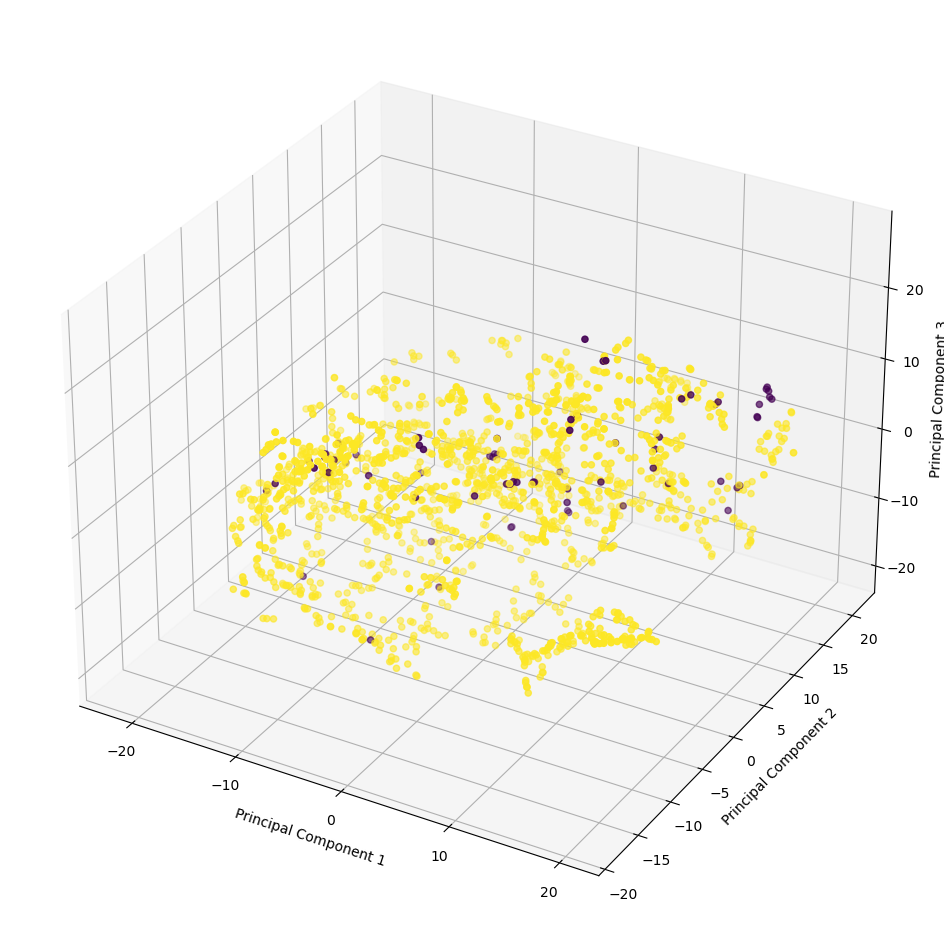

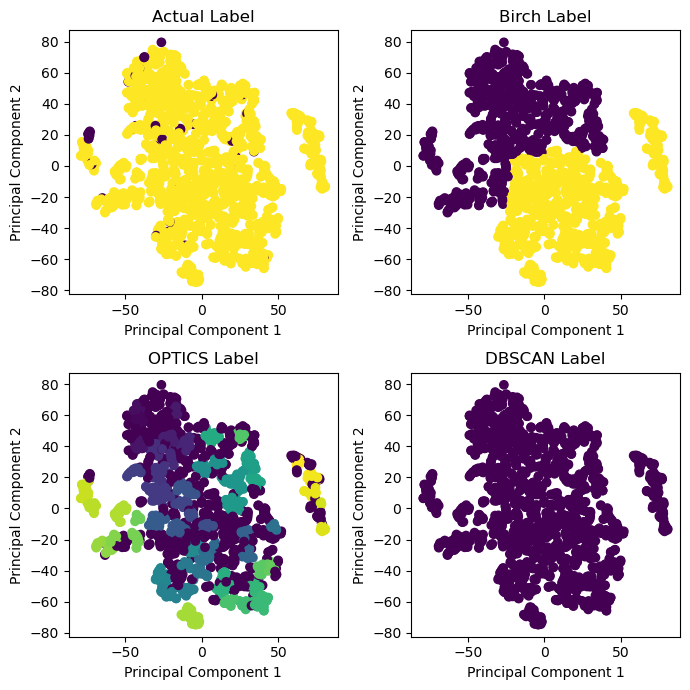

Replicate last 1000 data points (i.e. final_df_2)


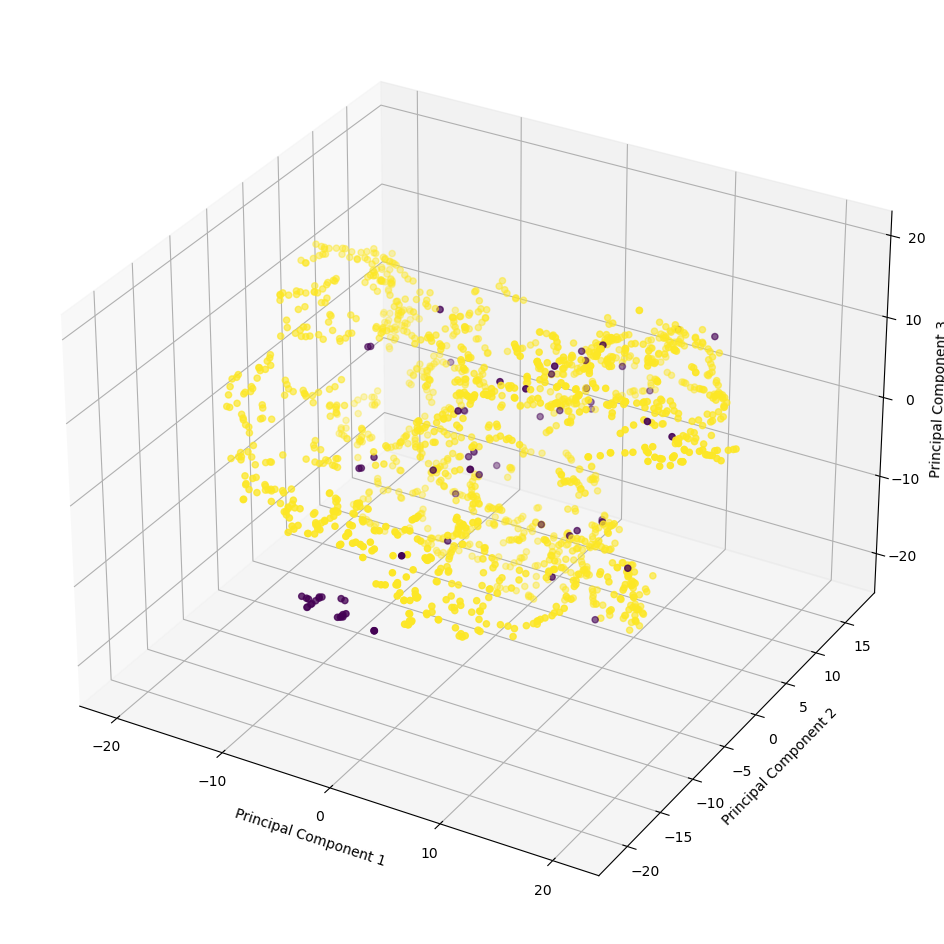

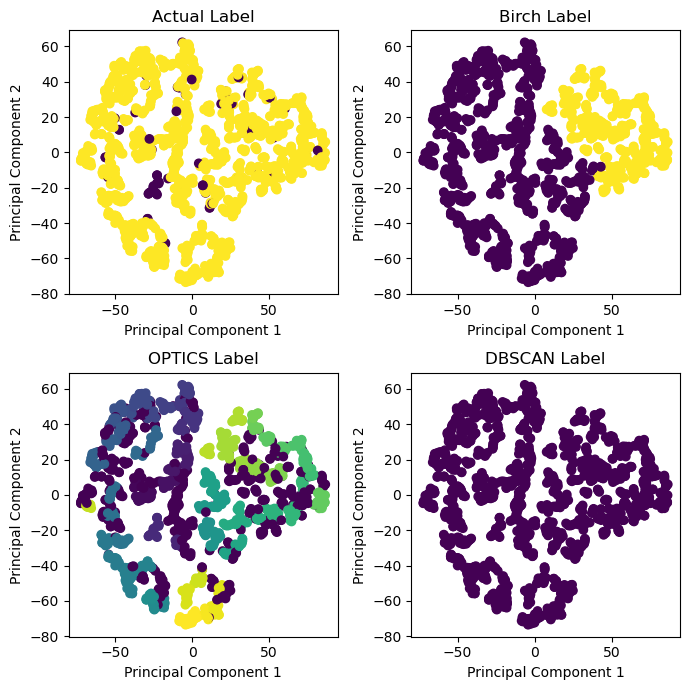

Replicate the dataset from the beginning (i.e. final_df_3)


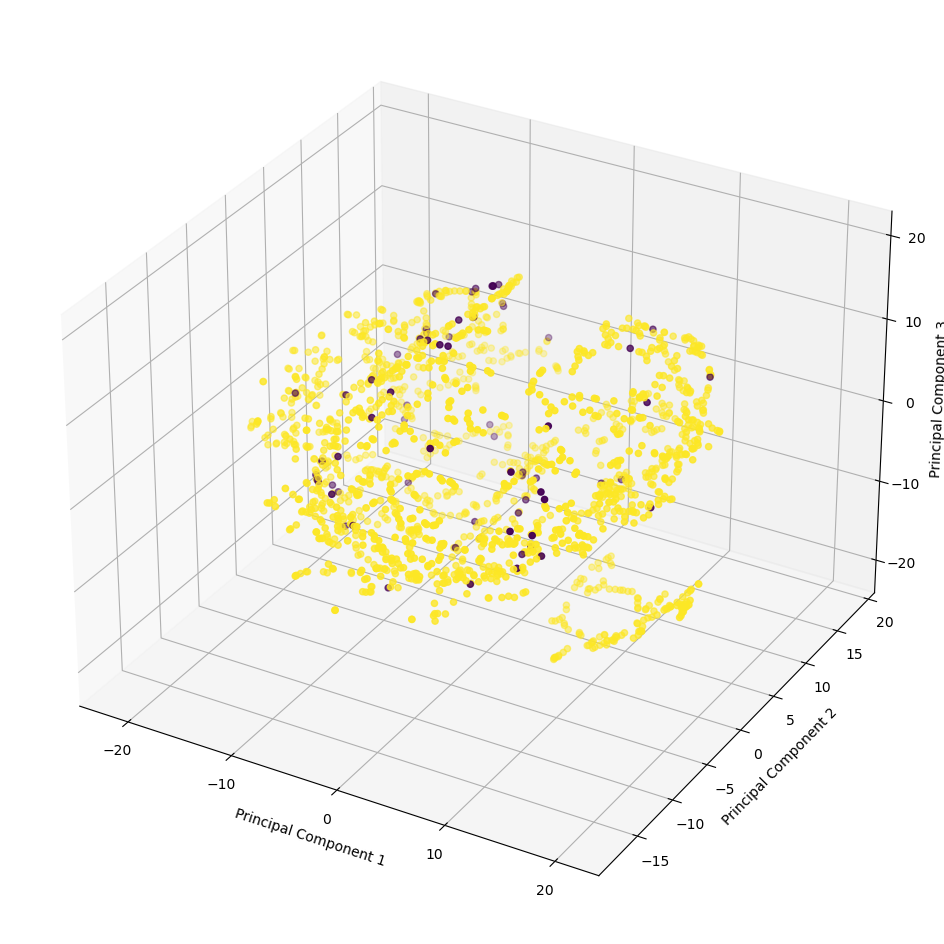

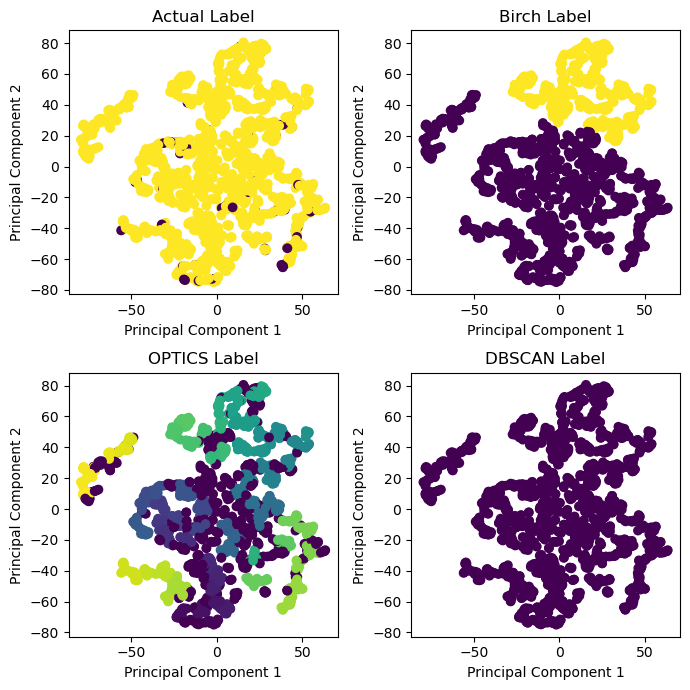

In [20]:
print("Prune to maximum 26793 data points (i.e. final_df_1)")
tsne_func(dist_1, pc_count=3)
tsne_func(dist_1)

print("Replicate last 1000 data points (i.e. final_df_2)")
tsne_func(dist_2, pc_count=3)
tsne_func(dist_2)

print("Replicate the dataset from the beginning (i.e. final_df_3)")
tsne_func(dist_3, pc_count=3)
tsne_func(dist_3)


# Granularity by Process

In [21]:
def add_process_granularity(df_ref, df_ref_name):
    def get_machine(x):
        name = x.split("_")
        return name[0]

    def get_process(x):
        name = x.split("_")
        return name[3]


    aux = pd.DataFrame()
    aux['Machine'] = df_ref.index
    aux['Machine'] = aux['Machine'].apply(get_machine)
    aux['Process'] = df_ref.index
    aux['Process'] = aux['Process'].apply(get_process)
    df_ref.insert(loc=0, column='Machine', value=aux.Machine.to_list())
    df_ref.insert(loc=1, column='Process', value=aux.Process.to_list())
    
    df_ref.to_hdf(df_ref_name, key='stage', mode='w')
    del aux
    
    
    
add_process_granularity(final_df_1, 'final_df_1_process.h5')
add_process_granularity(final_df_2, 'final_df_2_process.h5')
add_process_granularity(final_df_3, 'final_df_3_process.h5')

/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/2133379937.py:19: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed-integer,key->axis0] [items->None]

  df_ref.to_hdf(df_ref_name, key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/2133379937.py:19: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->integer,key->block0_items] [items->None]

  df_ref.to_hdf(df_ref_name, key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_97120/2133379937.py:19: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed-integer,key->axis0] [items->None]

  df_ref.to_hdf(df_ref_name, key='stage', mode='w')
/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T

# Generate, save, read, & calculate Euclidean Distance Matrix 
# Plot tSNE-based data clustering on 

In [1]:
%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import networkx as nx
import os 
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import random
import numpy as np
import h5py
import time
from tqdm import tqdm
from collections import defaultdict

from sklearn.cluster import OPTICS, Birch, DBSCAN
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import normalize, minmax_scale

import seaborn as sns

import tensorflow as tf
from sklearn.datasets import make_classification
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix




def data_processing(master_file, ref_axis, filename, skip=0, normalize=1):
    #skip = 0 --> Extract data, Save data, Read data, Euclidean data
    #skip = 1 --> Read data, Euclidean data
    
    def get_machine(x):
        name = x.split("_")
        return name[0]

    def get_process(x):
        name = x.split("_")
        return name[3]
    
    #----------------------------------------------------------------------------------------------------------------------------
    if skip==0:
        # Consolidate all filepaths to each dataset
        filepaths = []
        with open(master_file) as files:
            filepaths = files.read().split('\n')
        numfiles_to_parse = int(len(filepaths))-1 #Need to substract by one since the last element is an empty path 
        final_df = pd.DataFrame()


        # Consolidate Normalized Data into DataFrame
        for numfile in tqdm(range(numfiles_to_parse), desc=axis_name+": Consolidate Normalized Data into DataFrame…", ascii=False, ncols=75):
            path = filepaths[numfile]
            df = pd.DataFrame(h5py.File(filepaths[numfile],'r')['vibration_data'])
            df.columns = ['xaxis', 'yaxis','zaxis']
            aux = pd.DataFrame(df.values.T)
            aux['axis'] = [str(col) for col in df.columns]
            aux['label']= 'good' if 'good' in filepaths[numfile] else 'bad' 
            aux.index = [filepaths[numfile].split('/')[-1][:-3]+'_'+filepaths[numfile].split('/')[-2]]*3
            scaled_matrix = minmax_scale(aux[aux.columns[:-2]].T).T if normalize else aux[aux.columns[:-2]]
            df = pd.DataFrame(scaled_matrix)
            df.index = aux.index
            df['axis'] = aux['axis']
            df['label']= aux['label']
            df = df[df.axis==ref_axis]
            final_df = pd.concat([final_df, df], axis=0)
            del df, aux

        # Place columns 'axis' and 'label' as first 2 columns
        aux = pd.DataFrame()
        aux = pd.concat([final_df['axis'],final_df['label'],final_df.loc[:,0:268287],final_df.loc[:,268288:]],axis=1)
        final_df = pd.DataFrame()
        final_df = aux
        #final_df.to_hdf('final_df.h5', key='stage', mode='w')

        # Replicate last 1000 data points
        numrows = final_df.shape[0]
        num_replicate = 1000
        for row in tqdm(range(numrows), desc=axis_name+": Replicate last 1000 data points…", ascii=False, ncols=75):
            temp = final_df.iloc[row, 2:]
            nan_idx = -1
            for idx, val in enumerate(temp):
                if np.isnan(val):
                    nan_idx = idx
                    break
            if nan_idx!=-1:
                for idx in range(nan_idx,int(len(temp))):
                    temp[idx] = temp[idx-1000]
            final_df.iloc[row, 2:] = temp

        # Granularize by Process
        aux = pd.DataFrame()
        aux['Machine'] = final_df.index
        aux['Machine'] = aux['Machine'].apply(get_machine)
        aux['Process'] = final_df.index
        aux['Process'] = aux['Process'].apply(get_process)
        final_df.insert(loc=0, column='Machine', value=aux.Machine.to_list())
        final_df.insert(loc=1, column='Process', value=aux.Process.to_list())
            
        # Save file
        final_df.to_hdf(filename, key='stage', mode='w')
        del aux
    #----------------------------------------------------------------------------------------------------------------------------
    
    # Read file
    final_df   = pd.read_hdf(filename,'stage')
    
    return final_df



def get_euclidean_data(final_df):
    # Calculate Euclidean Data
    X = final_df.drop('axis', axis=1).drop('label',axis=1).drop('Machine',axis=1).drop('Process',axis=1).values
    dist = euclidean_distances(X, X)
    dist = pd.DataFrame(dist)
    dist.index = final_df.index
    dist.columns = dist.index
    
    return dist

    
        
def tsne_func(final_df, dist, axis_name, pc_count=2, perplexity=10):
    X_embedded = pd.DataFrame(TSNE(n_components=pc_count, learning_rate='auto',
                      init='random', perplexity=perplexity).fit_transform(dist.values))
    X_embedded.index = dist.index
    X_embedded.columns = ["pc1", "pc2"] if pc_count==2 else ["pc1", "pc2", "pc3"]

    cmap = []
    for val in final_df.label.to_list(): 
        cmap += [1] if val=='good' else [0]

    if pc_count==2:
        row, col, plot_inc = 2, 2, 1
        fig = plt.figure(figsize=(7,7))
        
        #'Actual Label':
        plt.subplot(row, col, plot_inc)
        plt.scatter(X_embedded.loc[:,"pc1"], X_embedded.loc[:,"pc2"], c=cmap)
        plt.xlabel("Principal Component 1")
        plt.ylabel("Principal Component 2")
        plt.title(axis_name + ": Actual Label")
        plot_inc+=1
        
        clustering      = [Birch(          n_clusters=2).fit(X_embedded.values), 
                           OPTICS(       min_samples=10).fit(X_embedded.values), 
                           DBSCAN(eps=3, min_samples=10).fit(X_embedded.values)]
        clustering_name = ["Birch",
                           "OPTICS",
                           "DBSCAN"]

        for i, model in enumerate(clustering):
            plt.subplot(row, col, plot_inc)
            plt.scatter(X_embedded["pc1"], X_embedded["pc2"], c=model.labels_)
            plt.xlabel("Principal Component 1")
            plt.ylabel("Principal Component 2")
            plt.title(axis_name + ": " + clustering_name[i]+" Label")
            plot_inc+=1        

    if pc_count==3:
        fig = plt.figure(figsize=(6,6))
        ax  = fig.add_subplot(projection='3d')
        ax.scatter(X_embedded.loc[:,"pc1"], X_embedded.loc[:,"pc2"], X_embedded.loc[:,"pc3"], c=cmap)
        ax.set_zlabel("Principal Component 3")
        plt.xlabel("Principal Component 1")
        plt.ylabel("Principal Component 2") 
        plt.title(axis_name + ": Actual Label")
        
    fig.tight_layout()
    plt.show()
    


# [No Frequency Filtering] Clustering Plots per Axis 

<IPython.core.display.Javascript object>


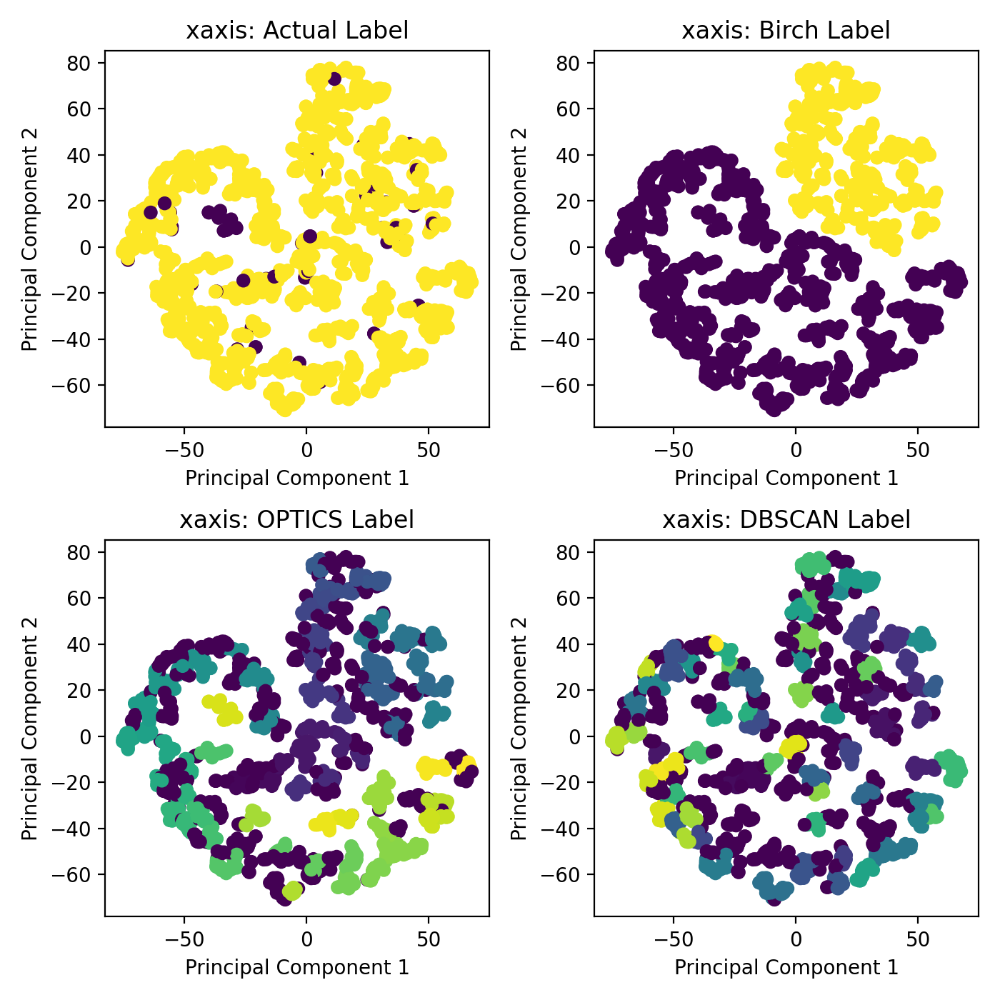

<IPython.core.display.Javascript object>


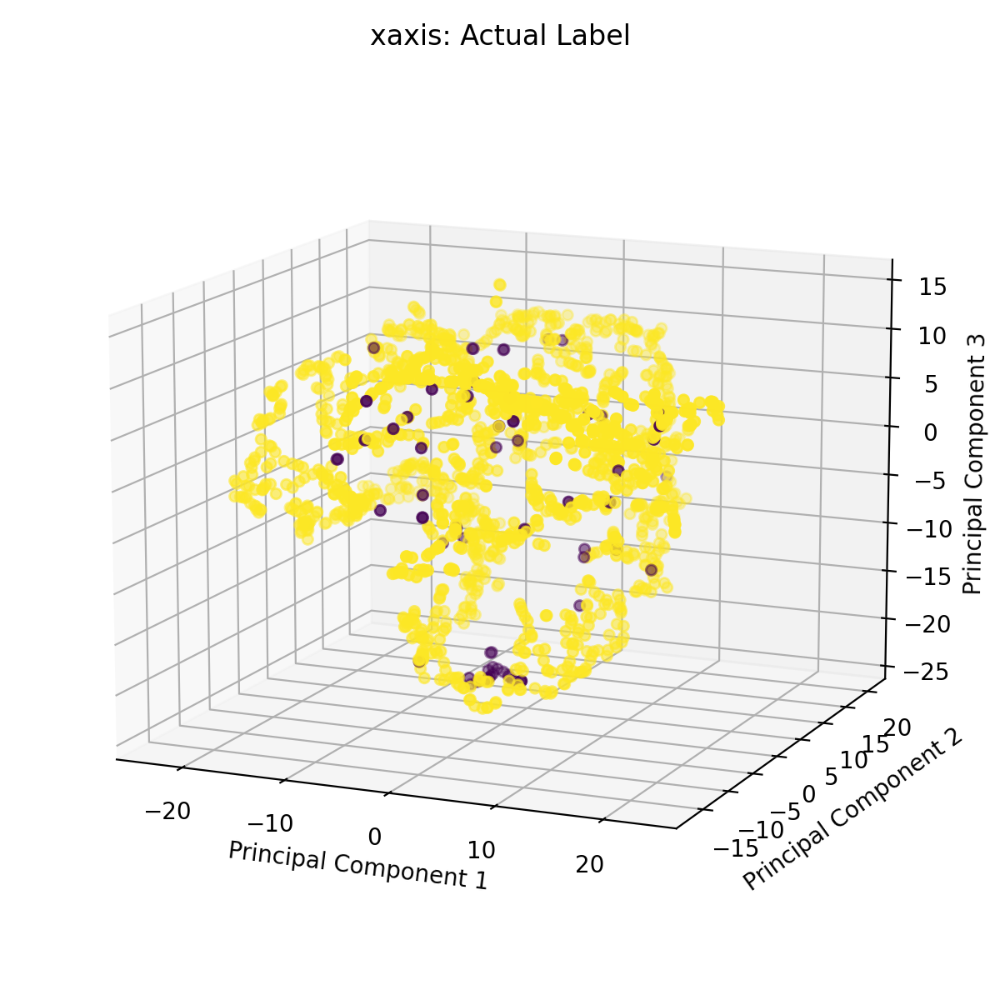

<IPython.core.display.Javascript object>


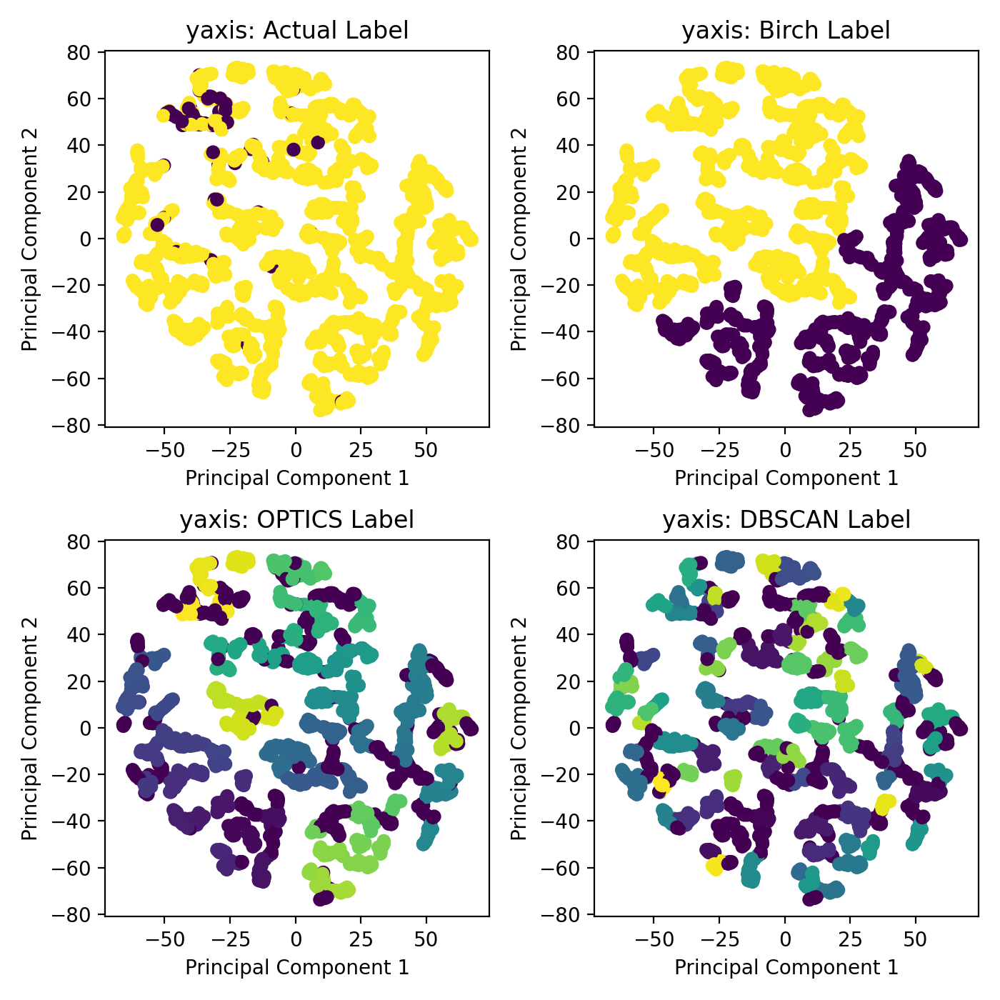

<IPython.core.display.Javascript object>


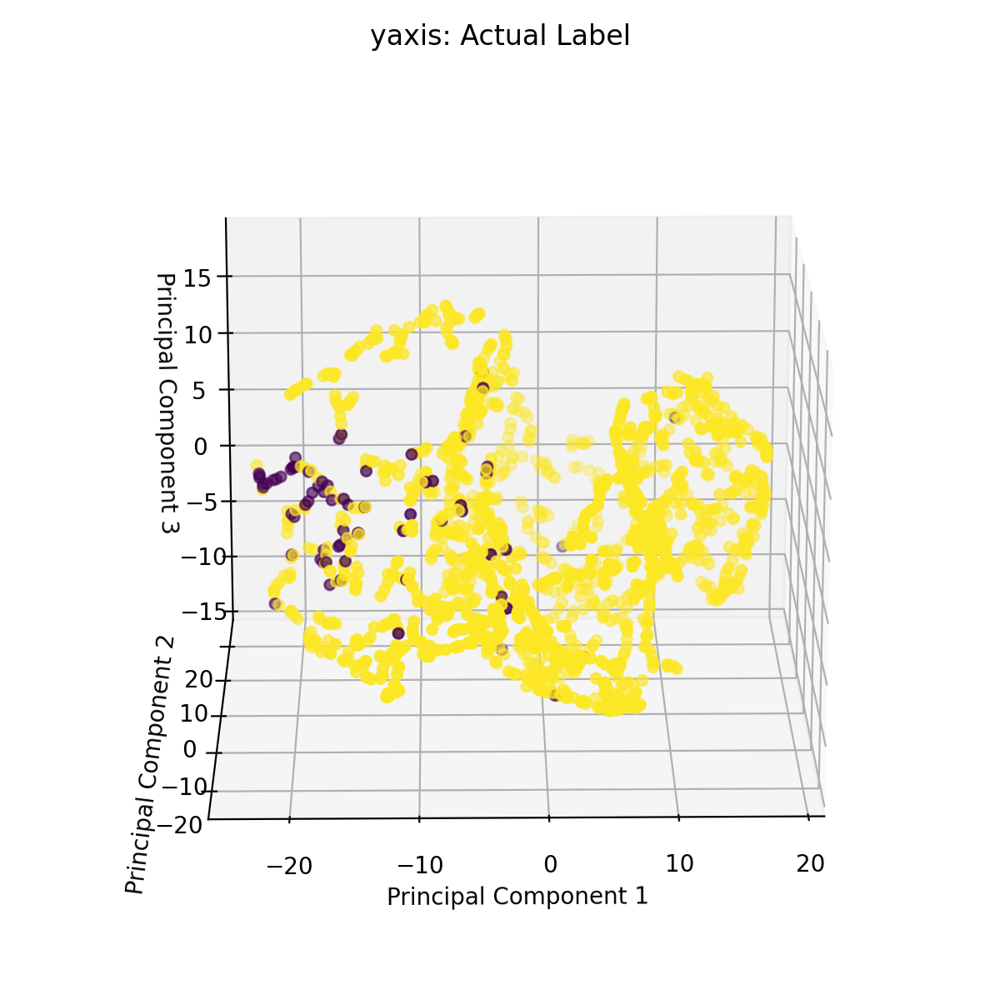

<IPython.core.display.Javascript object>


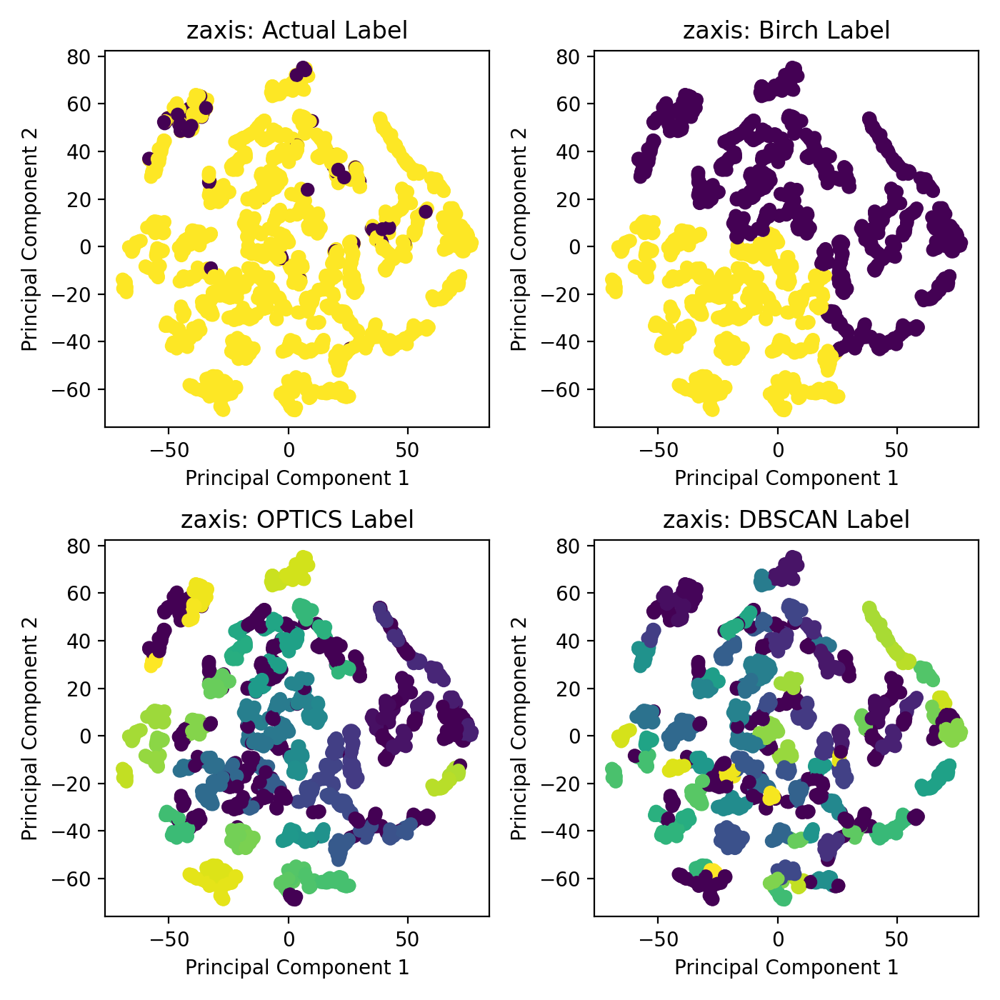

<IPython.core.display.Javascript object>


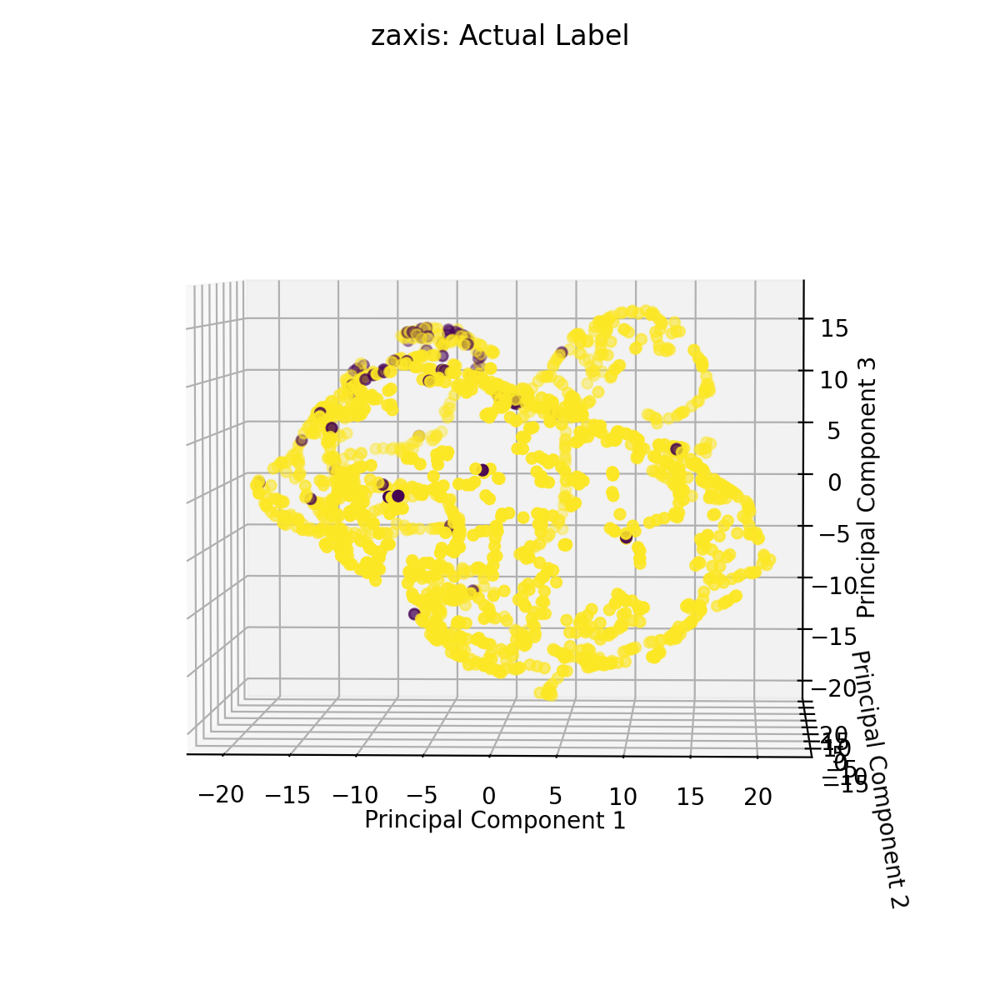

In [11]:
master_file = "./file_list.log"    
axis_names  = ['xaxis', 'yaxis', 'zaxis']

for axis_name in axis_names:
    print("====================================================================================")
    filename    = "final_df_"+axis_name+"_process.h5"
    final_df = data_processing(master_file, axis_name, filename, skip=1)
    dist = get_euclidean_data(final_df)
    tsne_func(final_df, dist, axis_name, pc_count=2, perplexity=10)
    tsne_func(final_df, dist, axis_name, pc_count=3, perplexity=10)
    print("\n\n")

# [No Frequency Filtering] Clustering Plots per Axis per Process 

xaxis: OP00


<IPython.core.display.Javascript object>


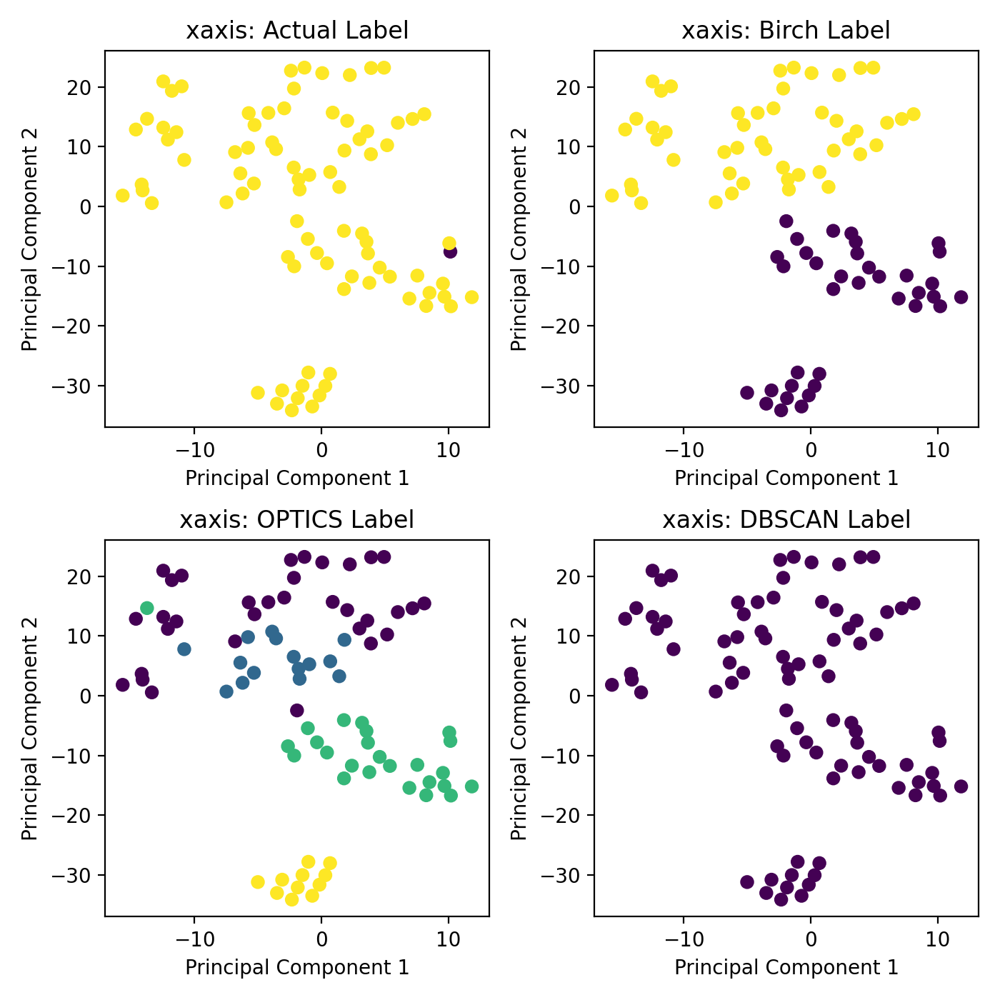

<IPython.core.display.Javascript object>


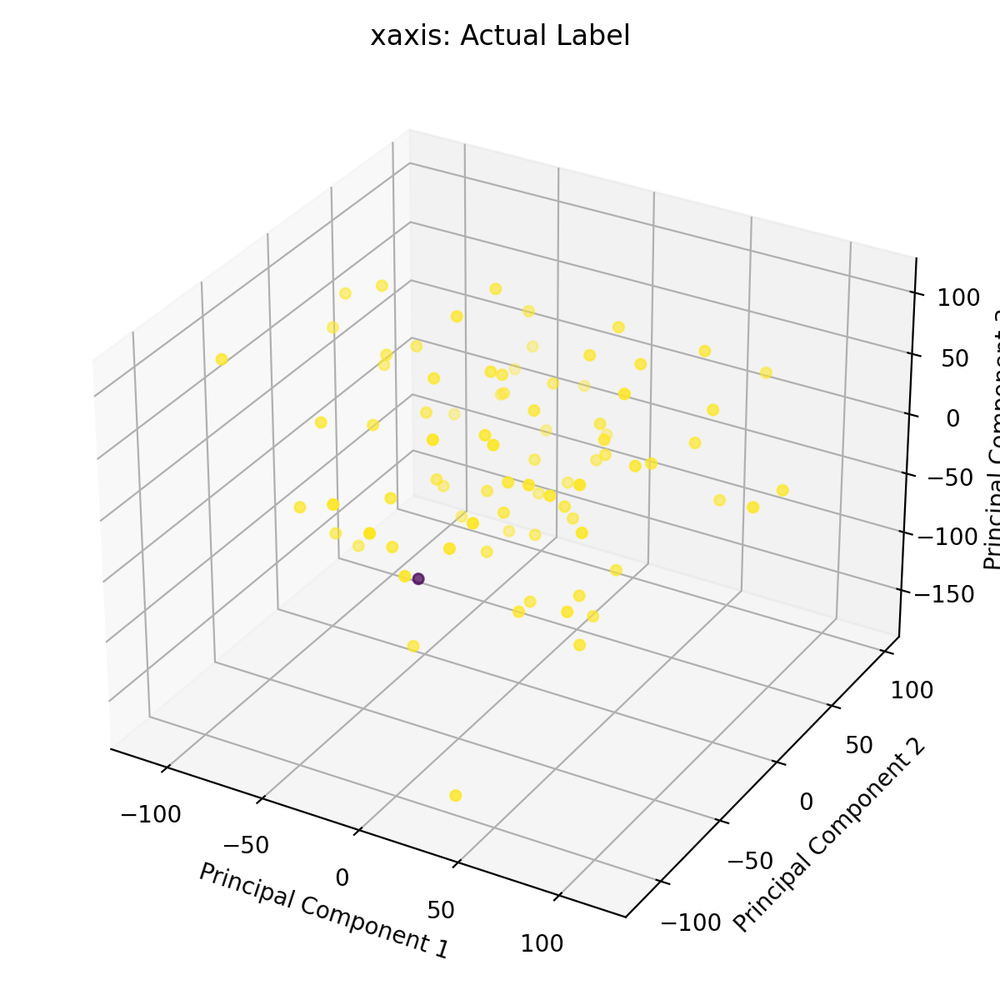




xaxis: OP01


<IPython.core.display.Javascript object>


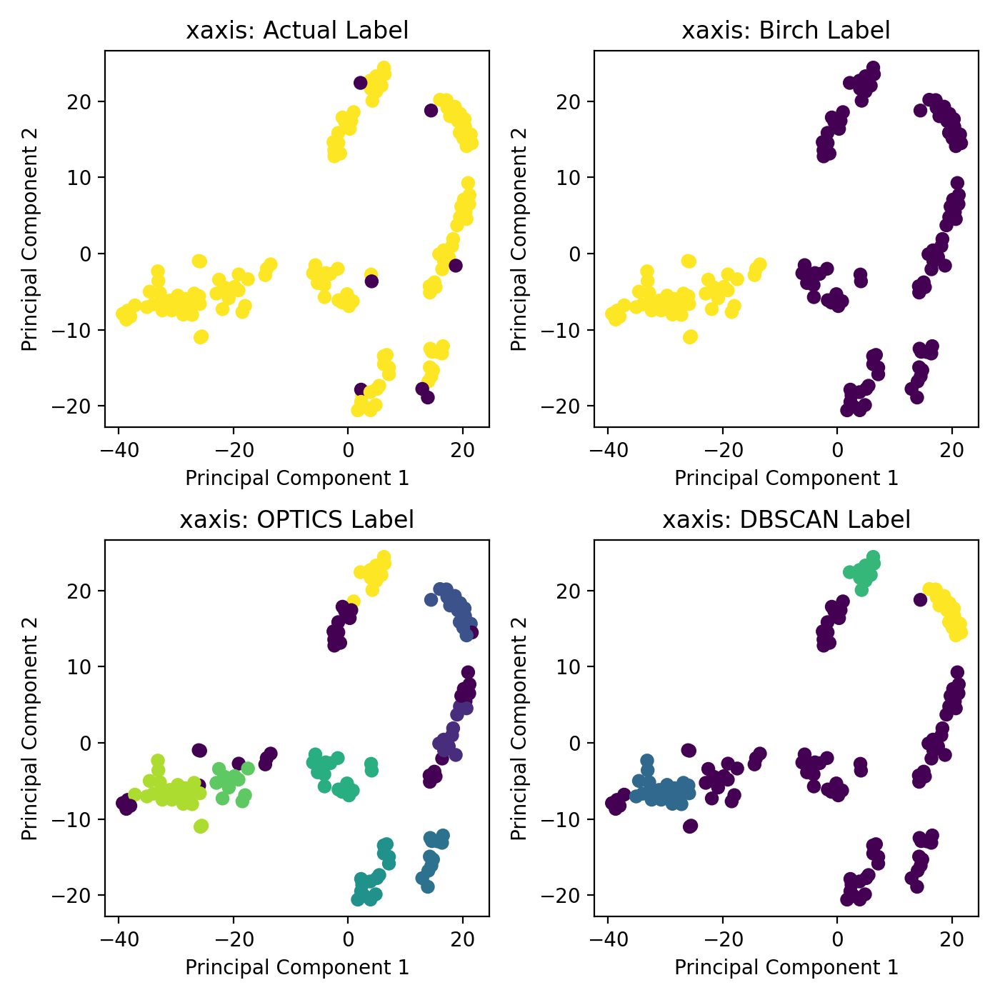

<IPython.core.display.Javascript object>


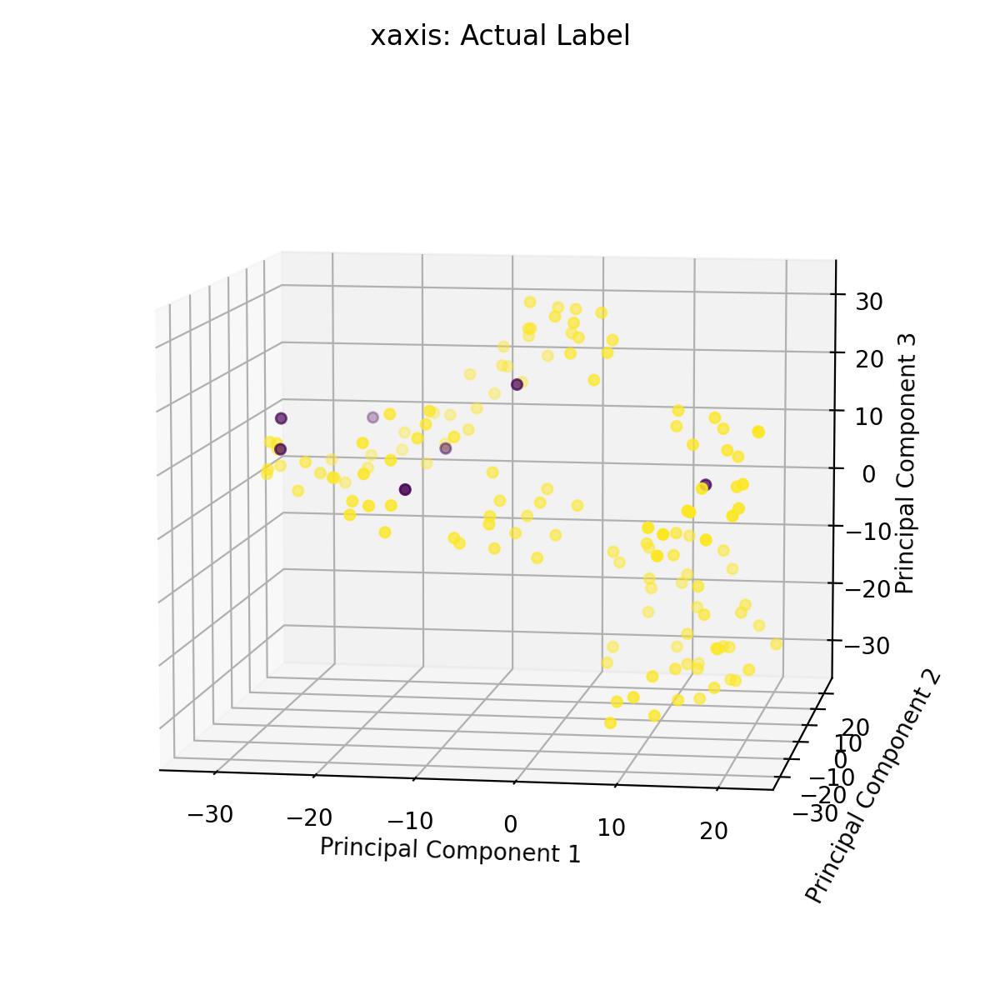




xaxis: OP02


<IPython.core.display.Javascript object>


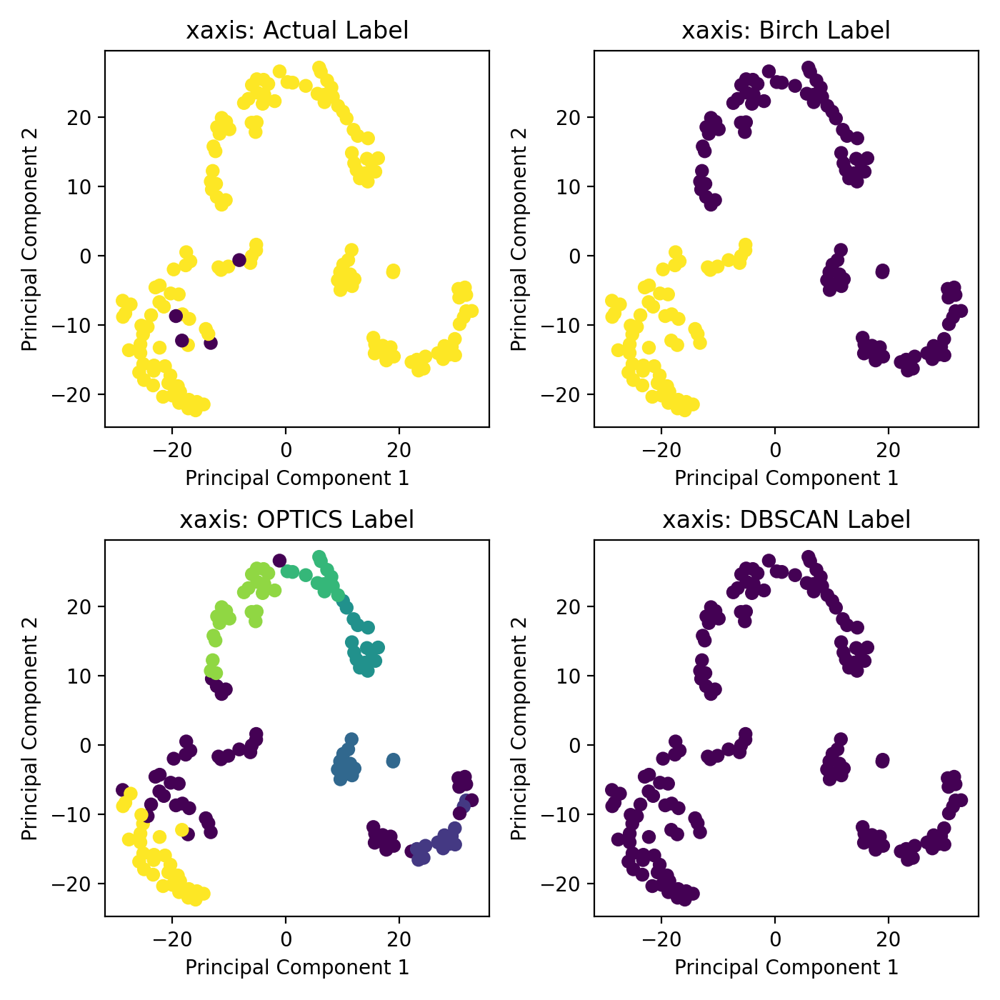

<IPython.core.display.Javascript object>


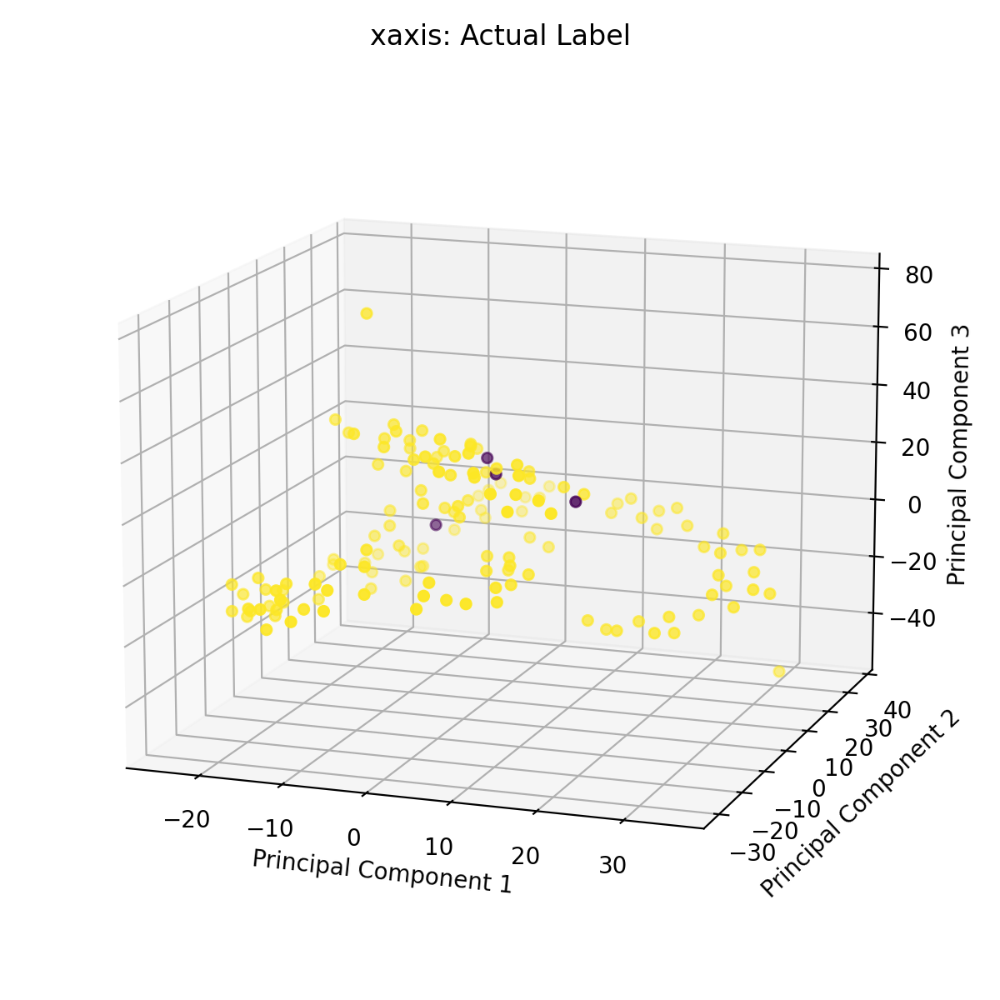




xaxis: OP03


<IPython.core.display.Javascript object>


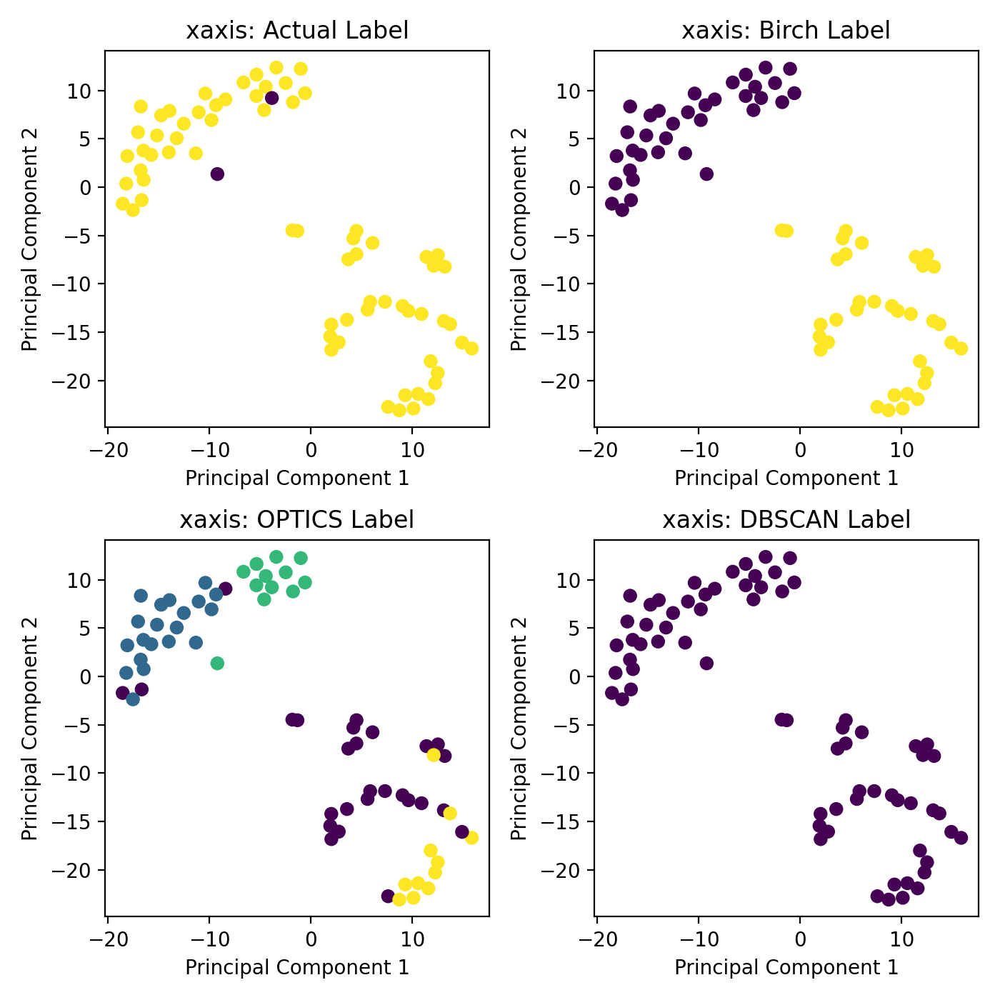

<IPython.core.display.Javascript object>


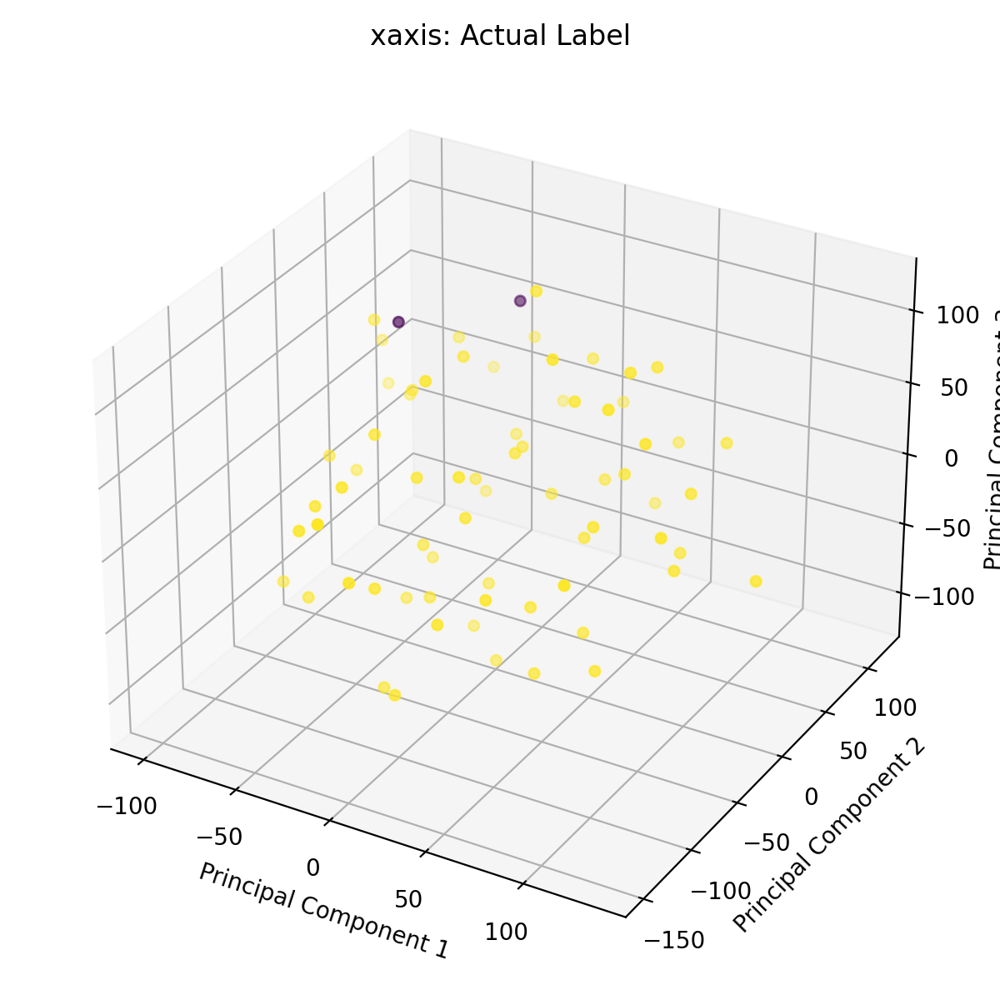




xaxis: OP04


<IPython.core.display.Javascript object>


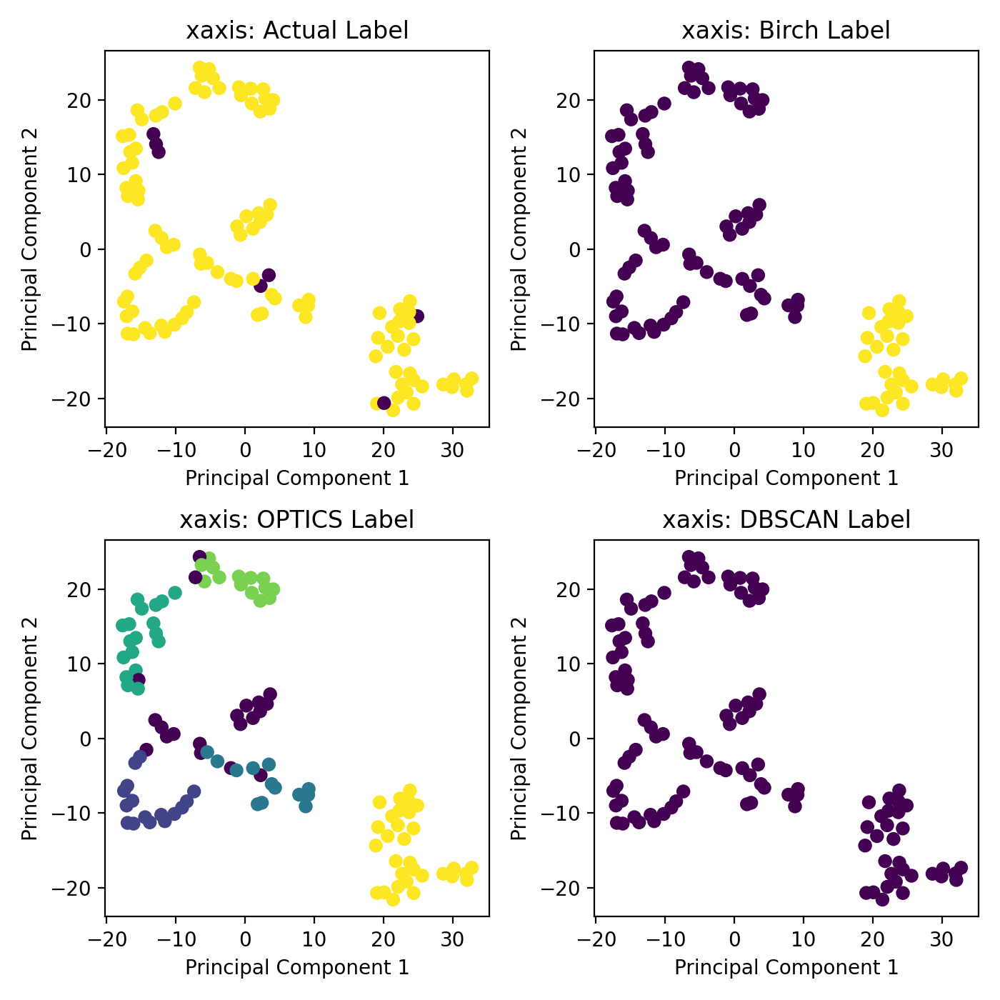

<IPython.core.display.Javascript object>


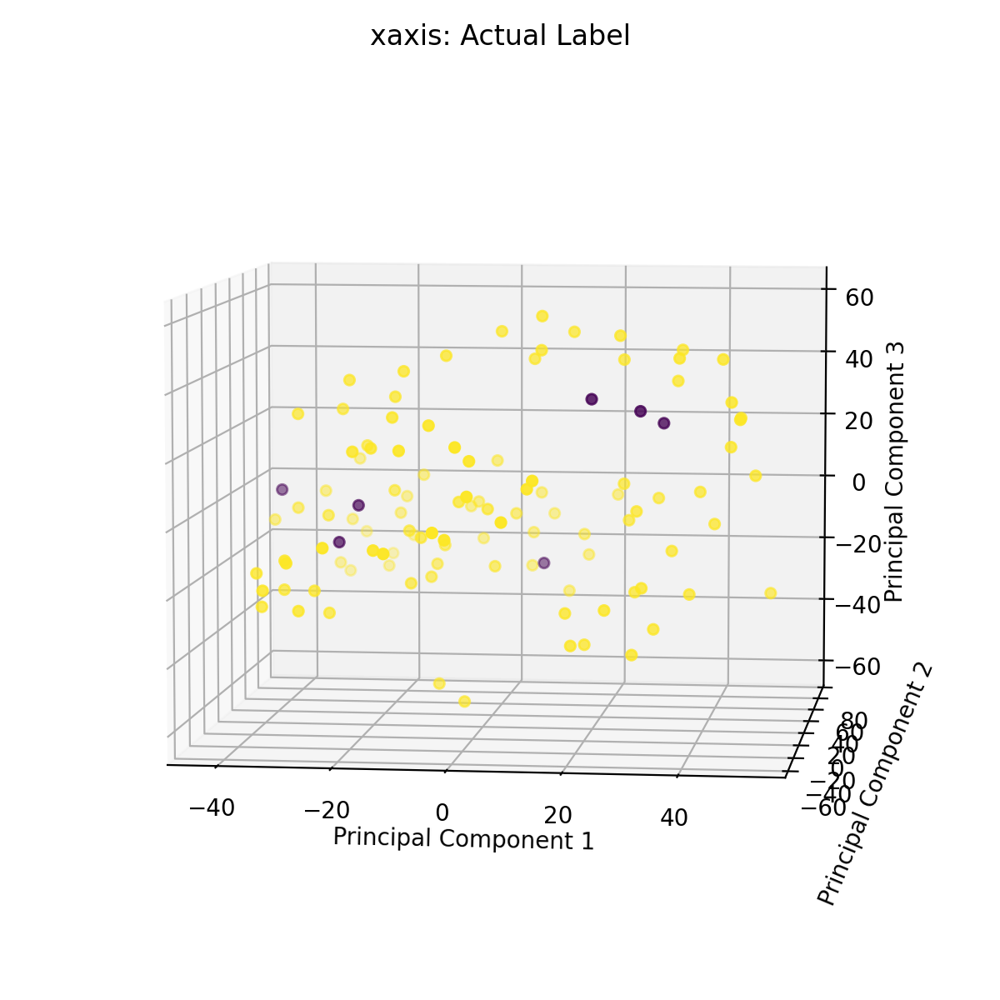




xaxis: OP05


<IPython.core.display.Javascript object>


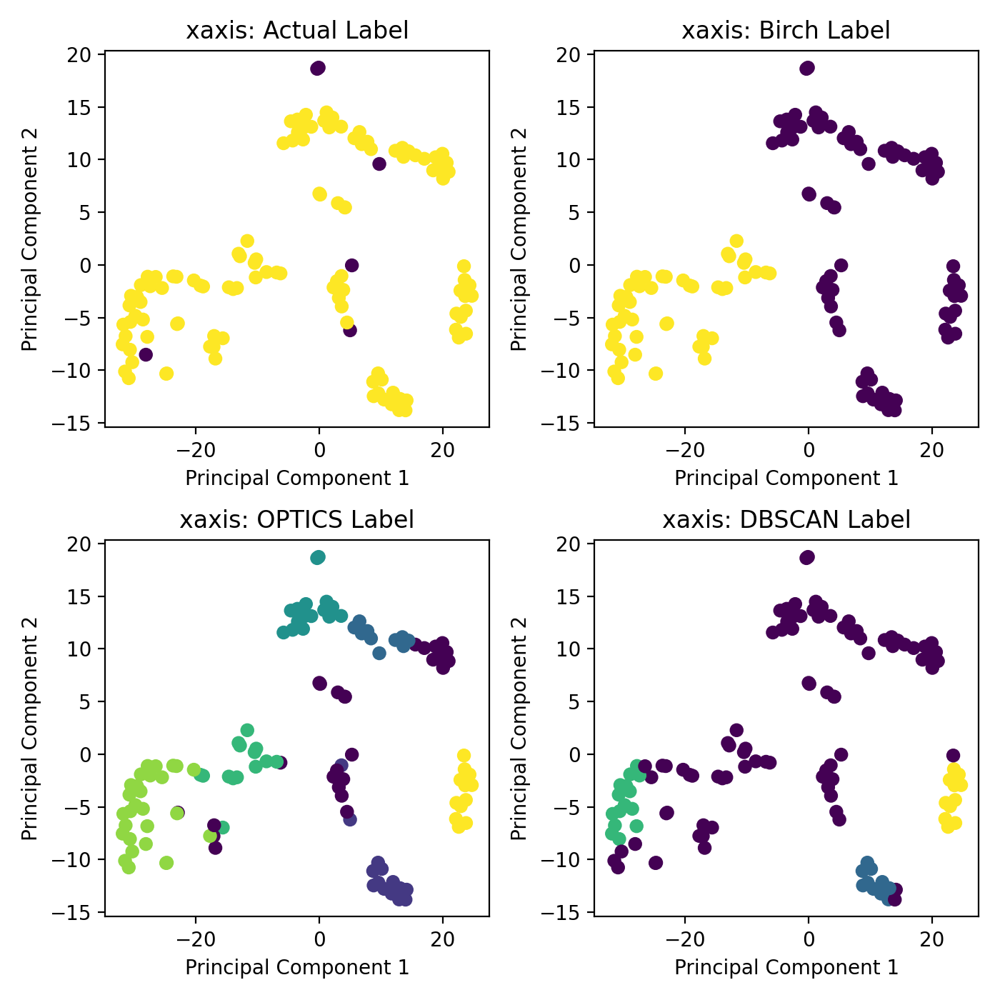

<IPython.core.display.Javascript object>


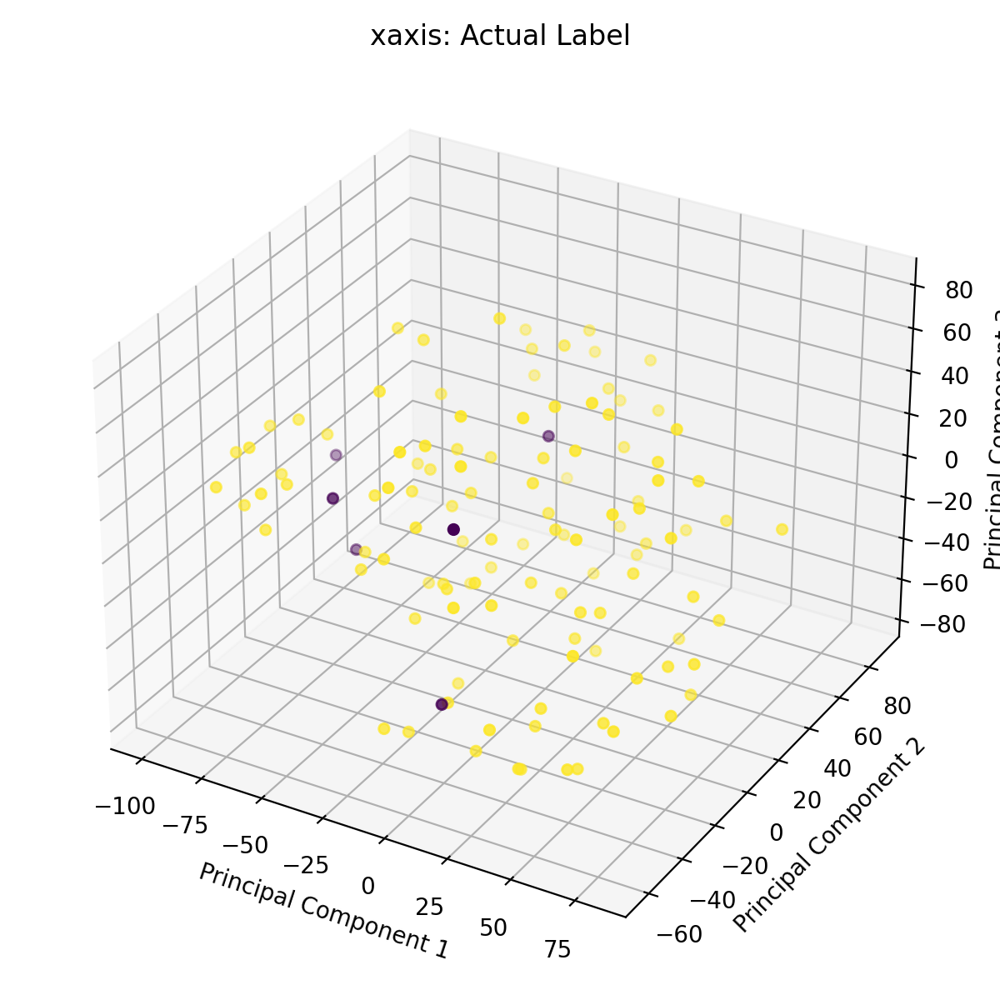




xaxis: OP06


/var/folders/t6/9vjf__793ng85g1zl9v66zy40000gn/T/ipykernel_7299/1896790739.py:132: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(7,7))


<IPython.core.display.Javascript object>


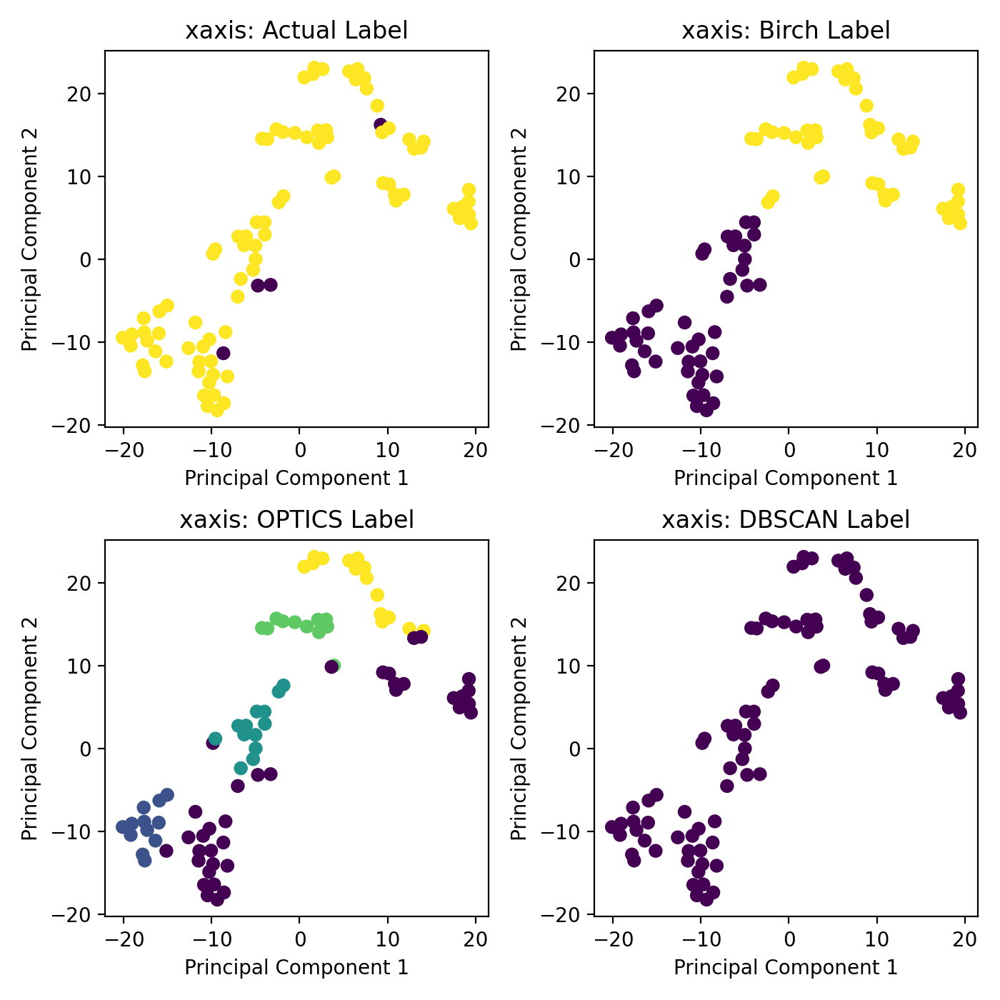

<IPython.core.display.Javascript object>


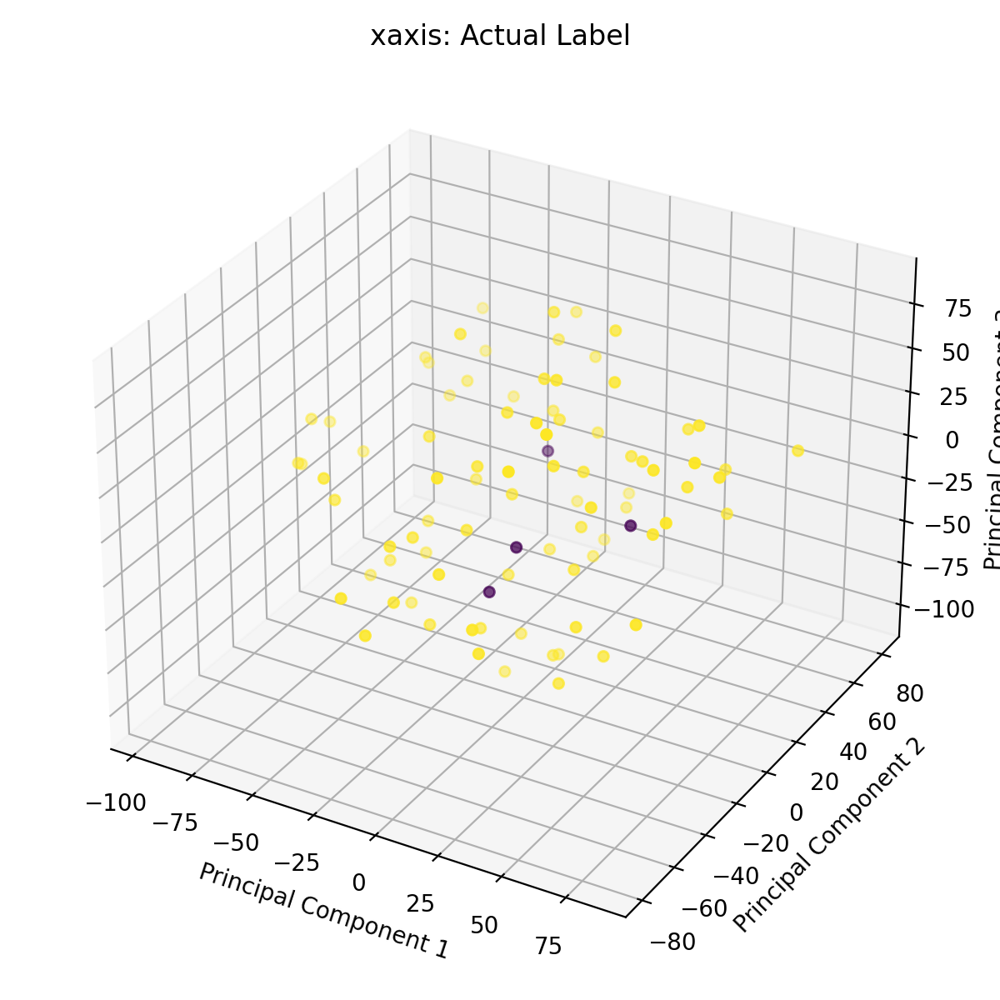




xaxis: OP07


<IPython.core.display.Javascript object>


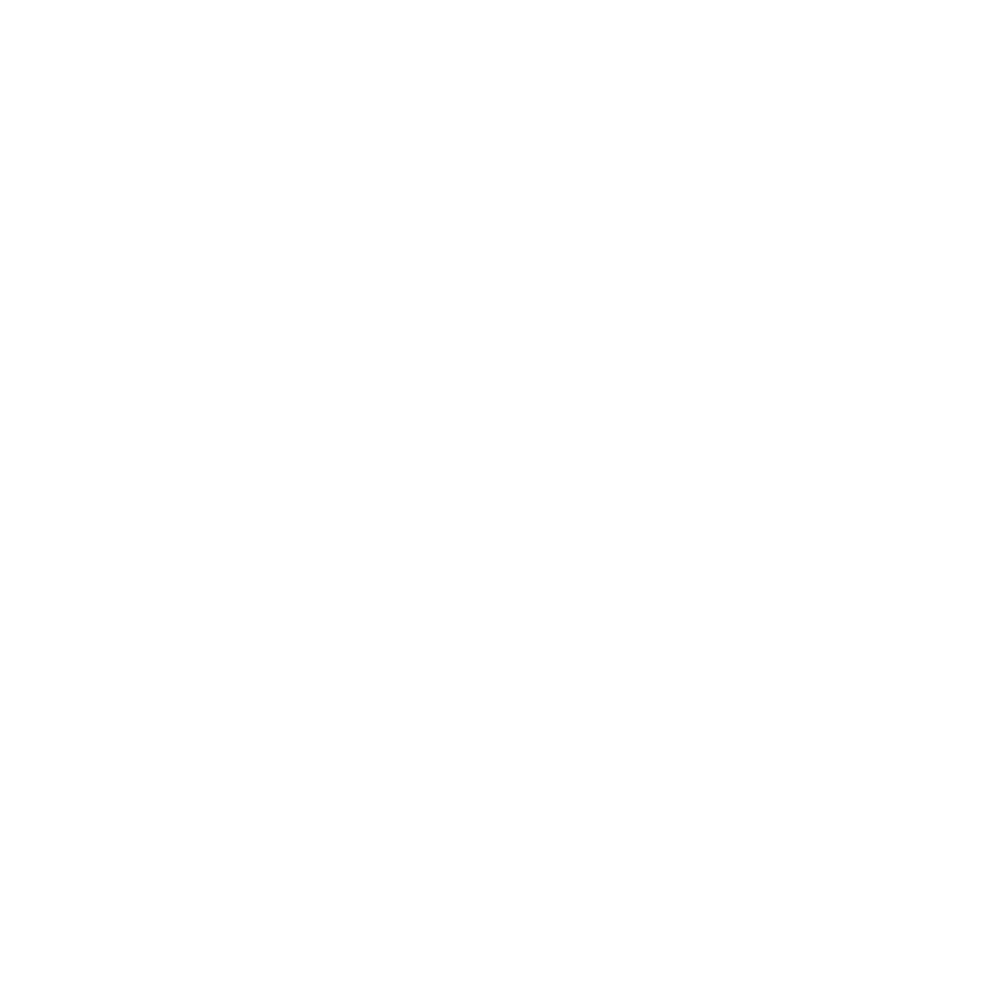

<IPython.core.display.Javascript object>


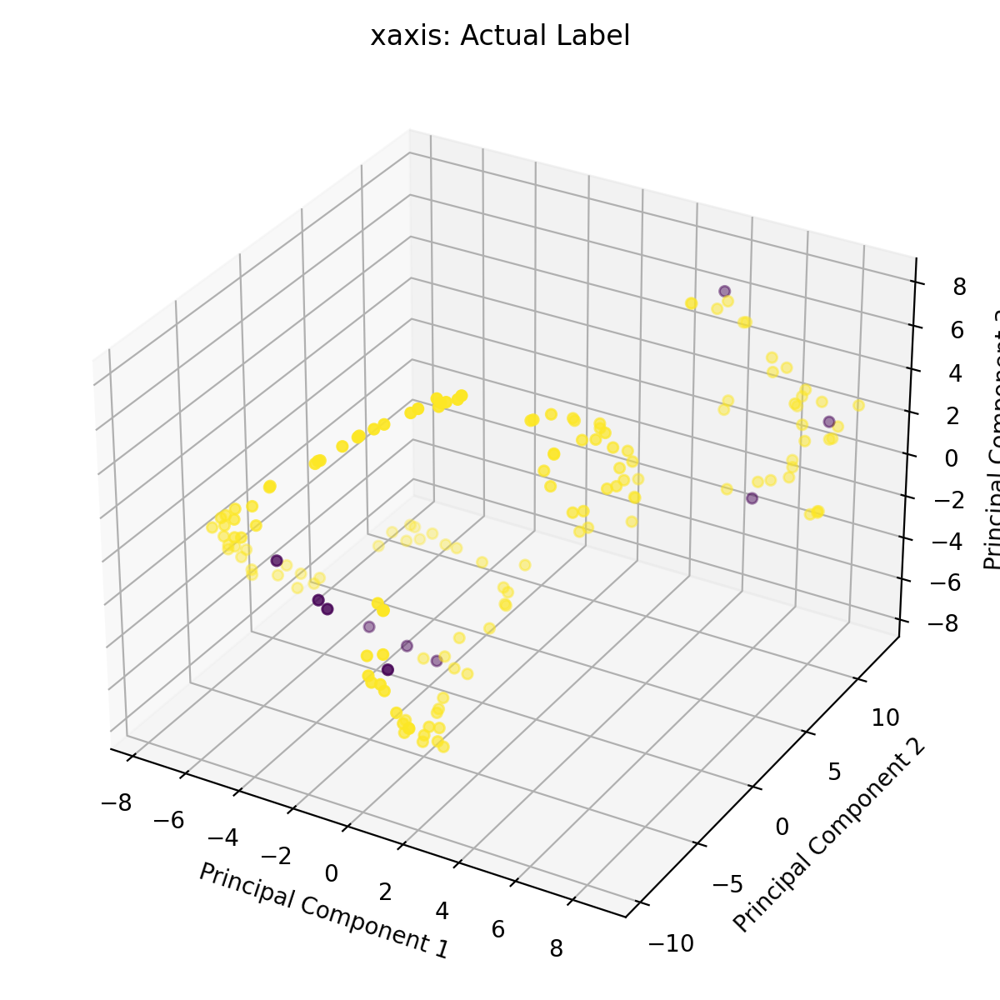




xaxis: OP08


<IPython.core.display.Javascript object>


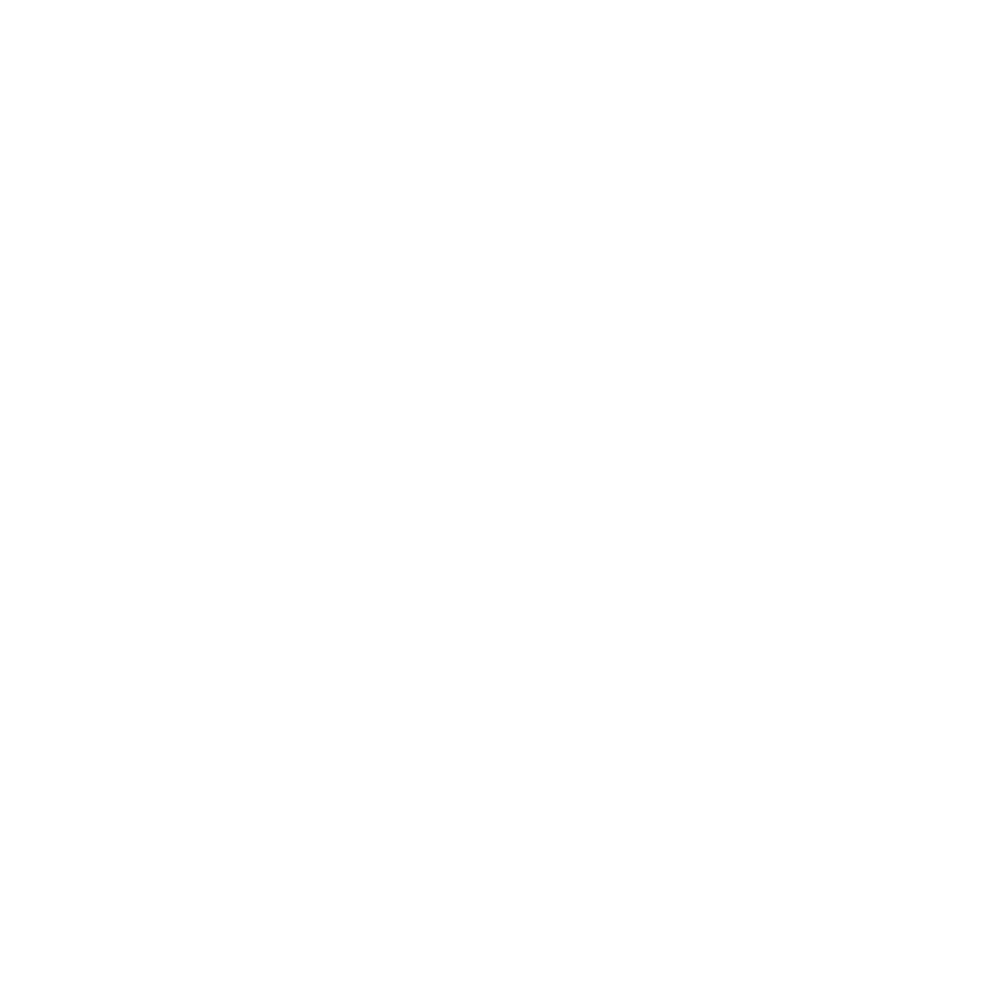

<IPython.core.display.Javascript object>


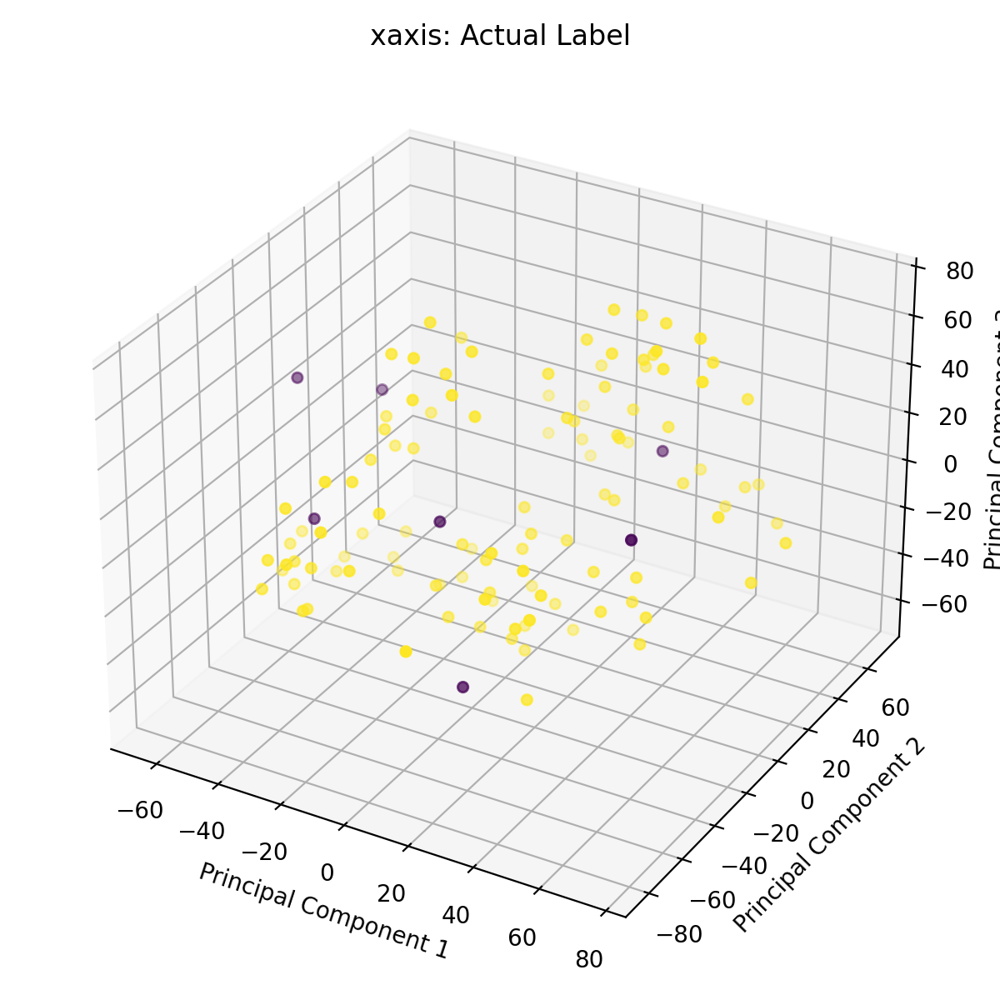




xaxis: OP09


<IPython.core.display.Javascript object>


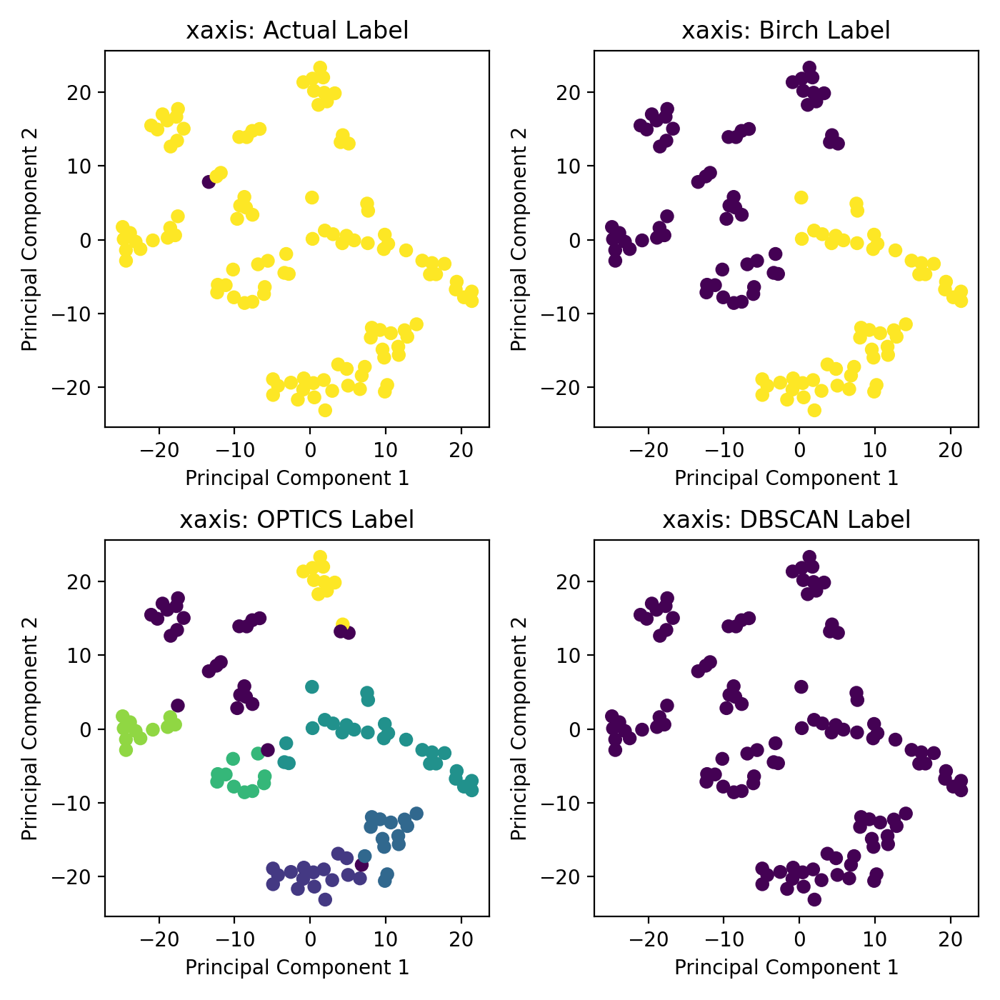

<IPython.core.display.Javascript object>


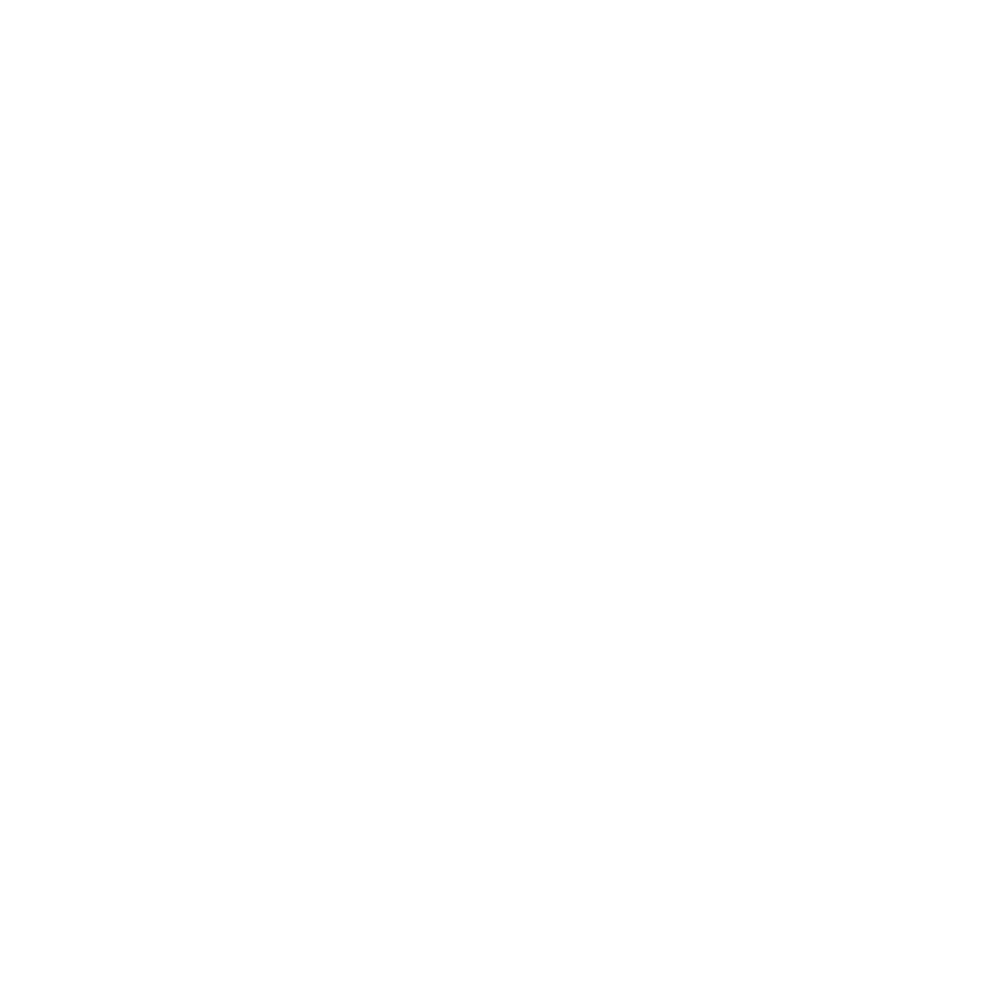




xaxis: OP10


<IPython.core.display.Javascript object>


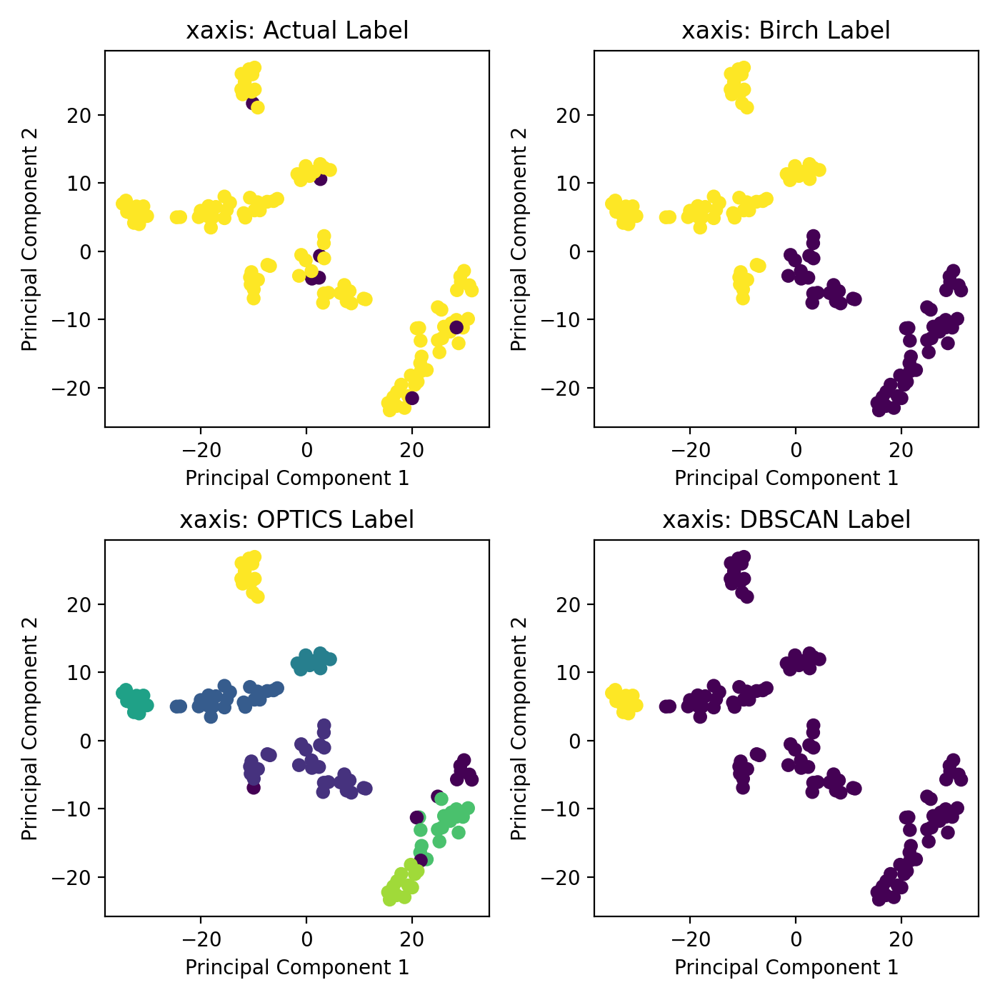

<IPython.core.display.Javascript object>


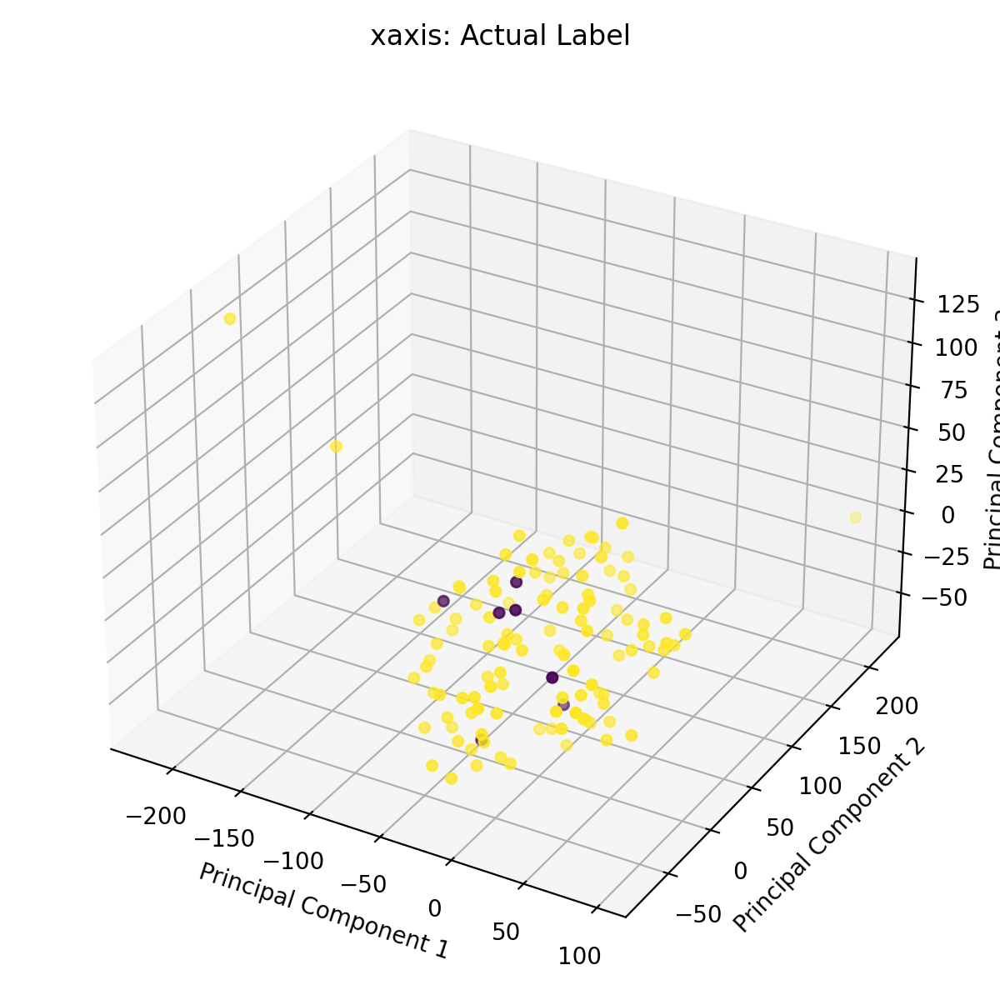




xaxis: OP11


<IPython.core.display.Javascript object>


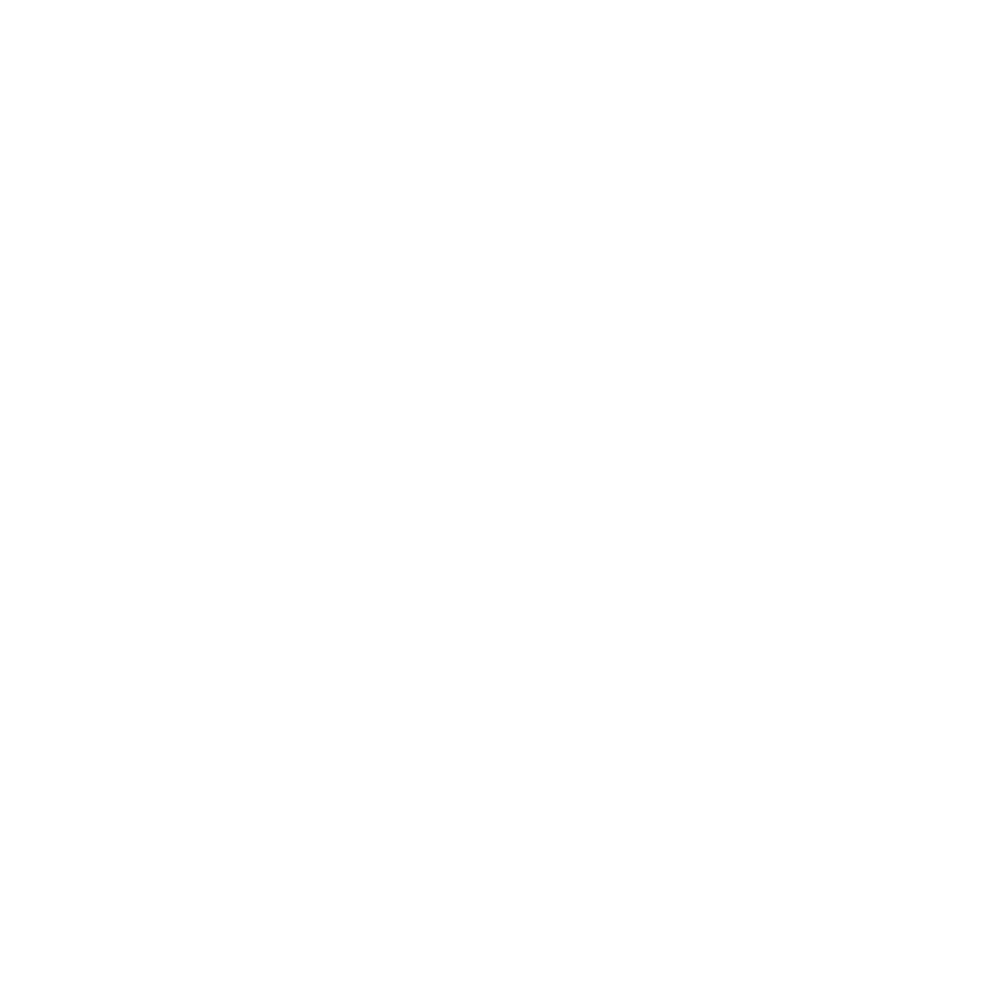

<IPython.core.display.Javascript object>


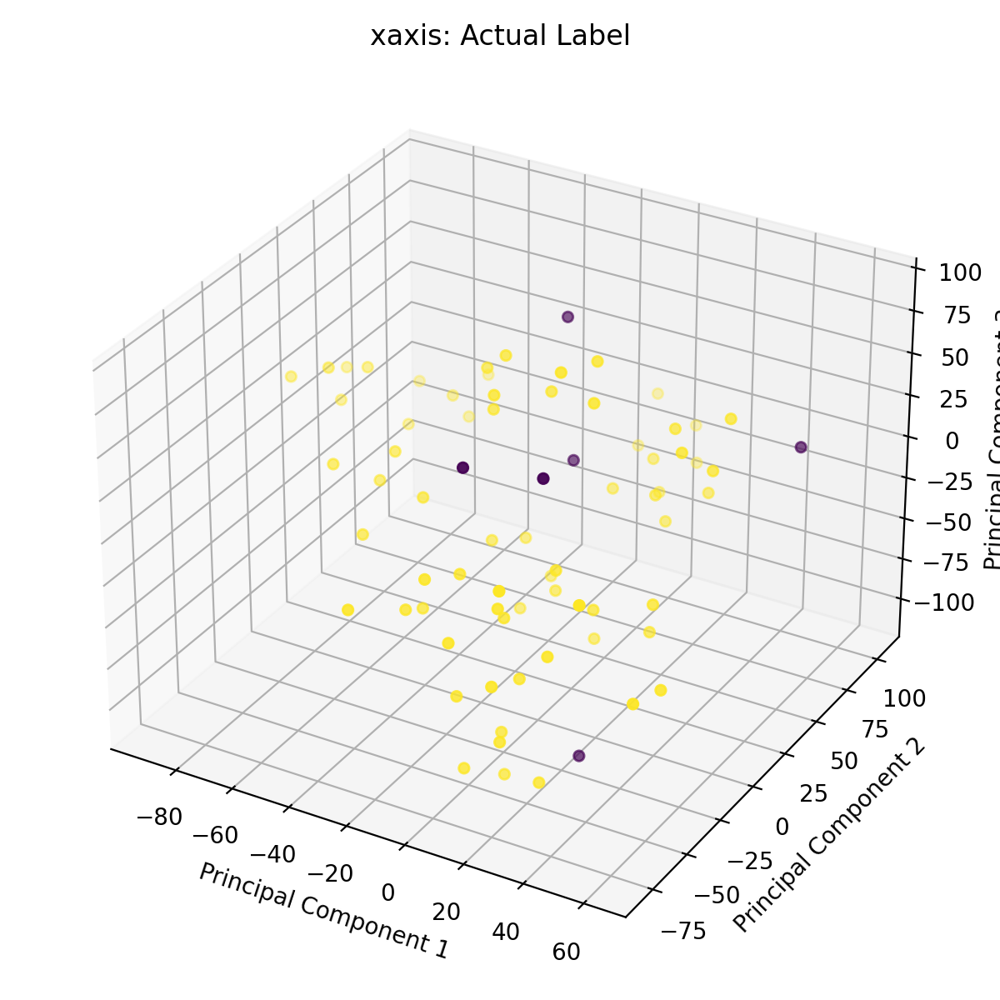




xaxis: OP12


<IPython.core.display.Javascript object>


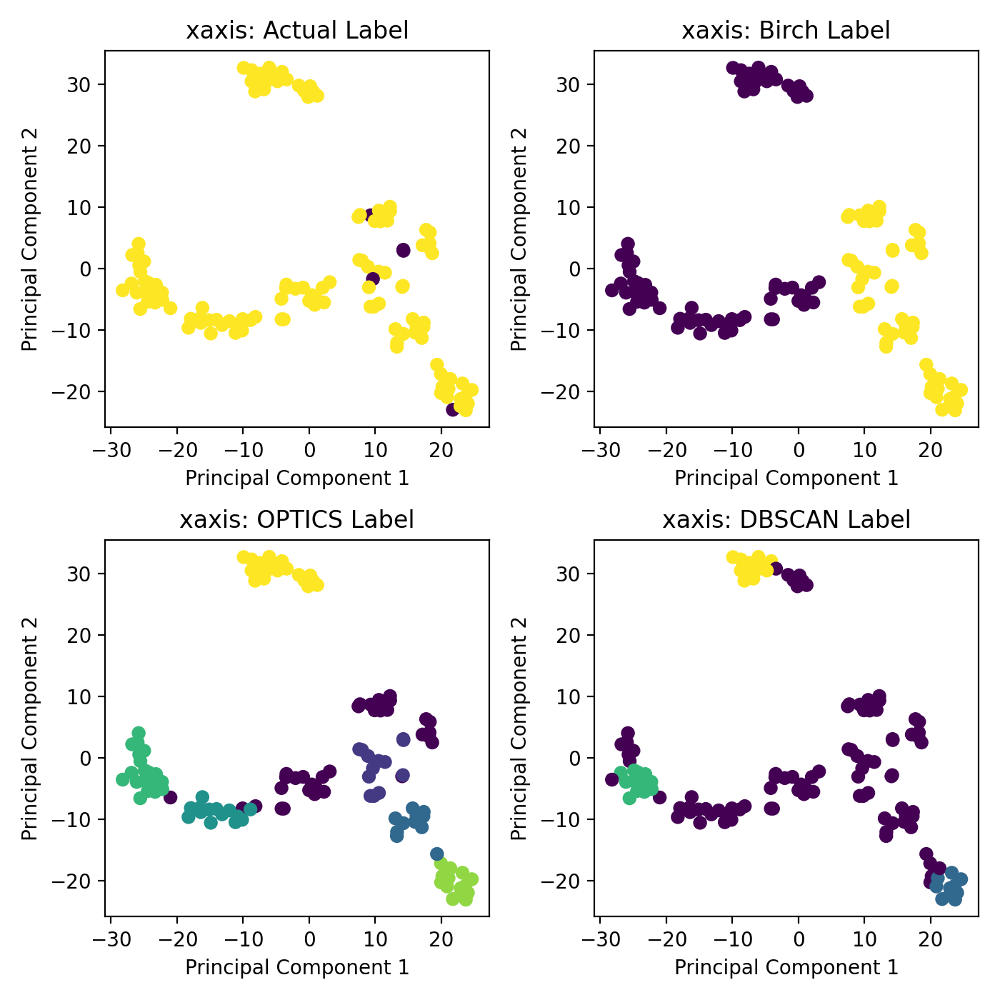

<IPython.core.display.Javascript object>


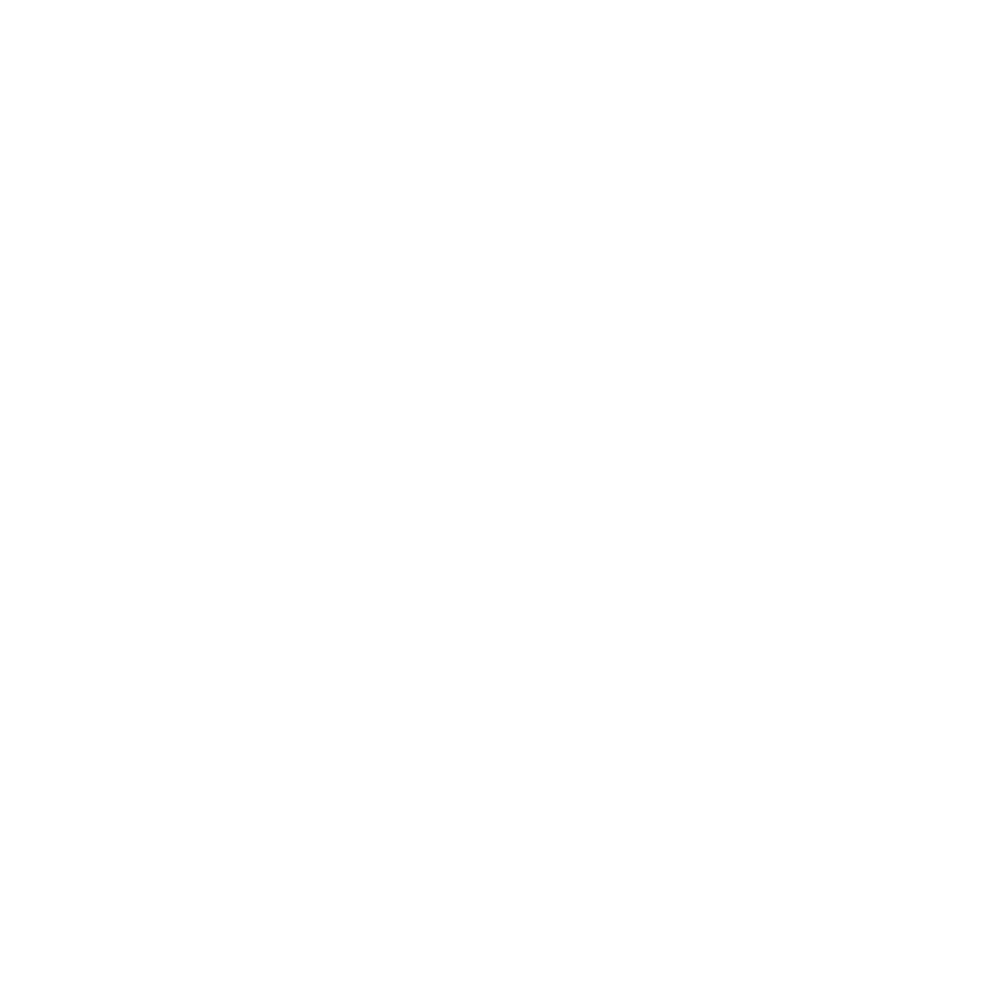




xaxis: OP13


<IPython.core.display.Javascript object>


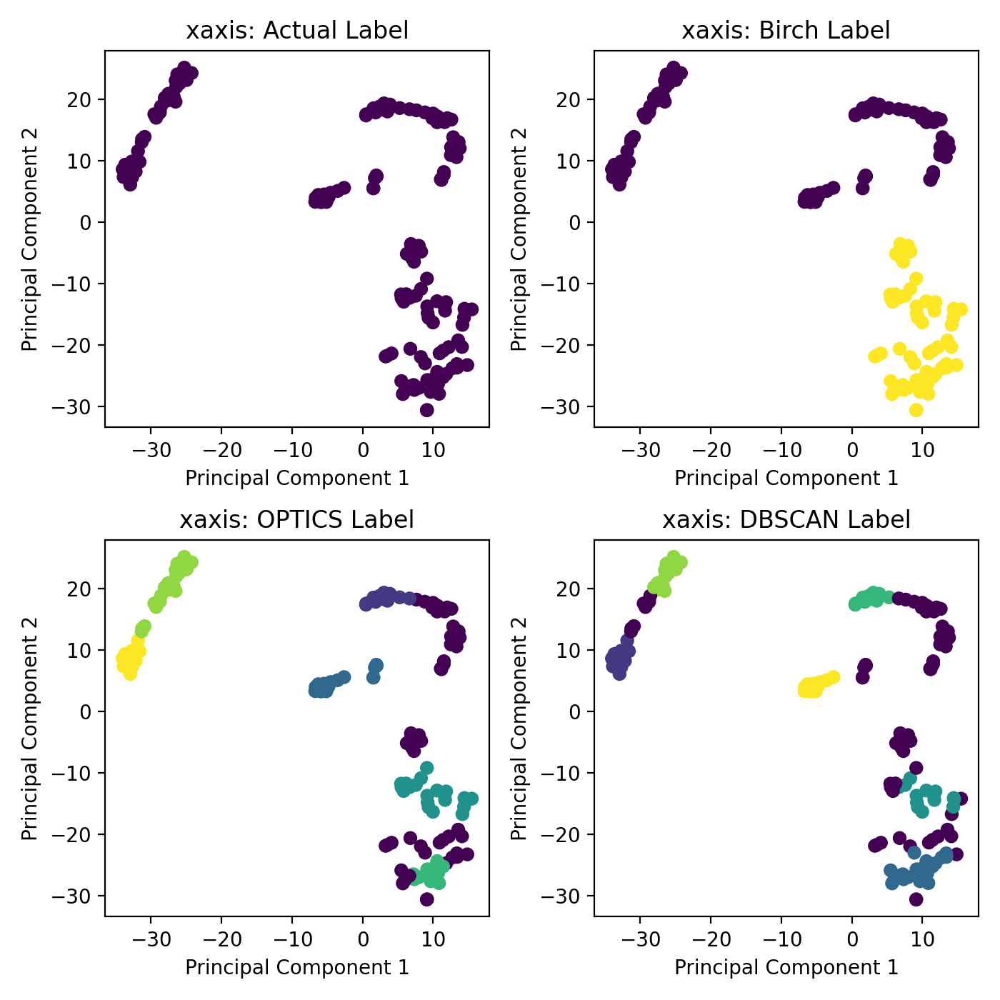

<IPython.core.display.Javascript object>


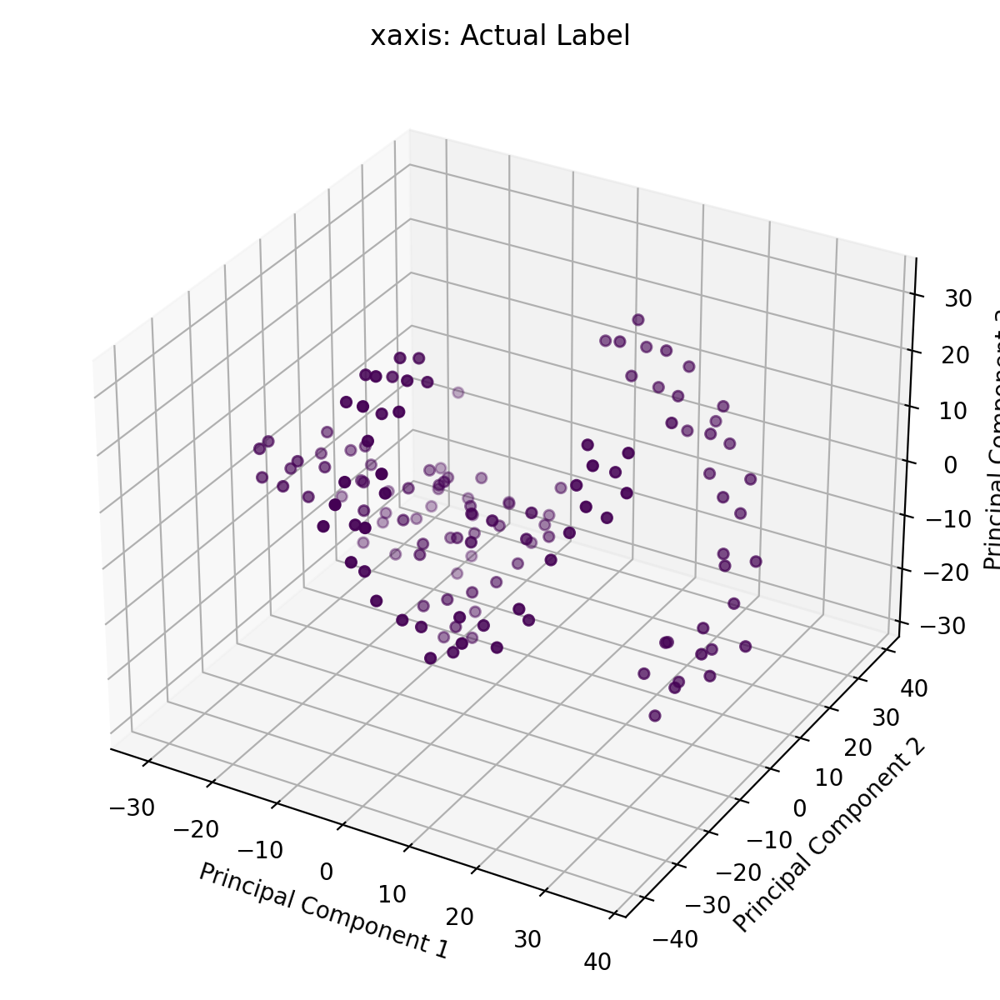




xaxis: OP14


<IPython.core.display.Javascript object>


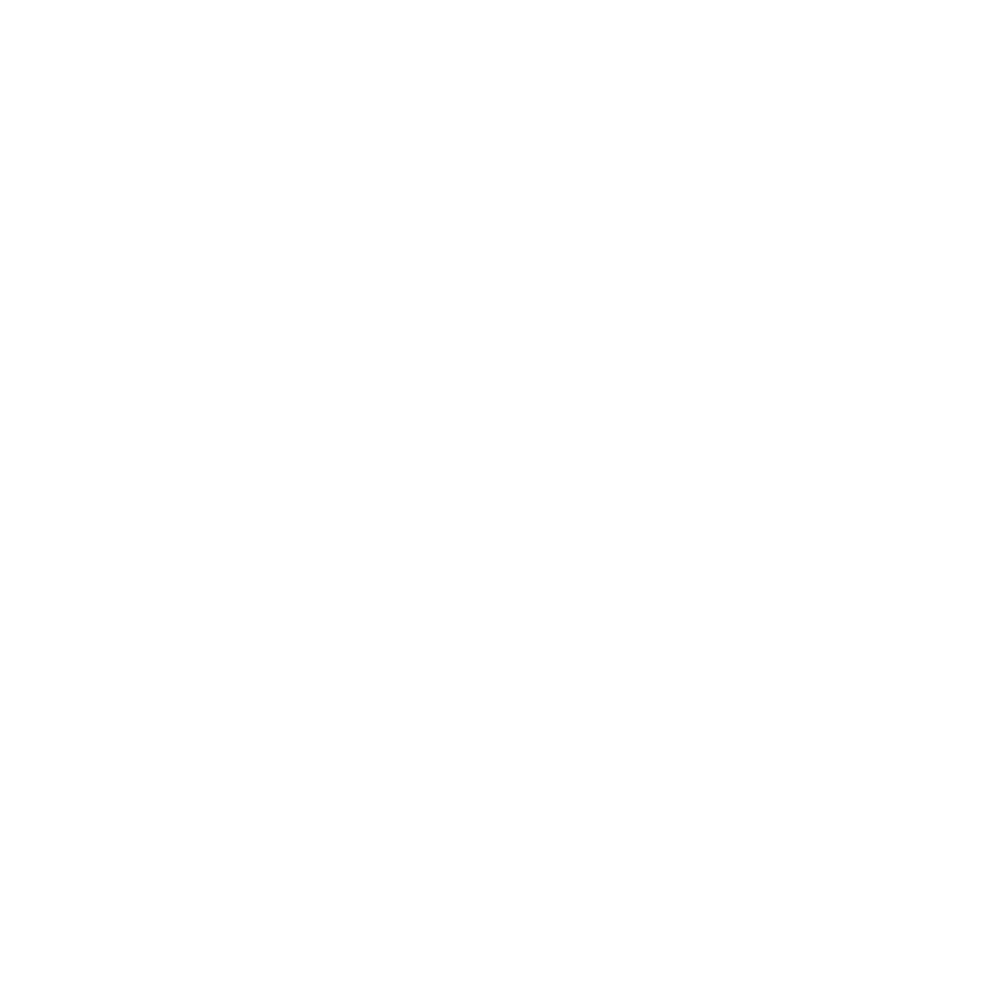

<IPython.core.display.Javascript object>


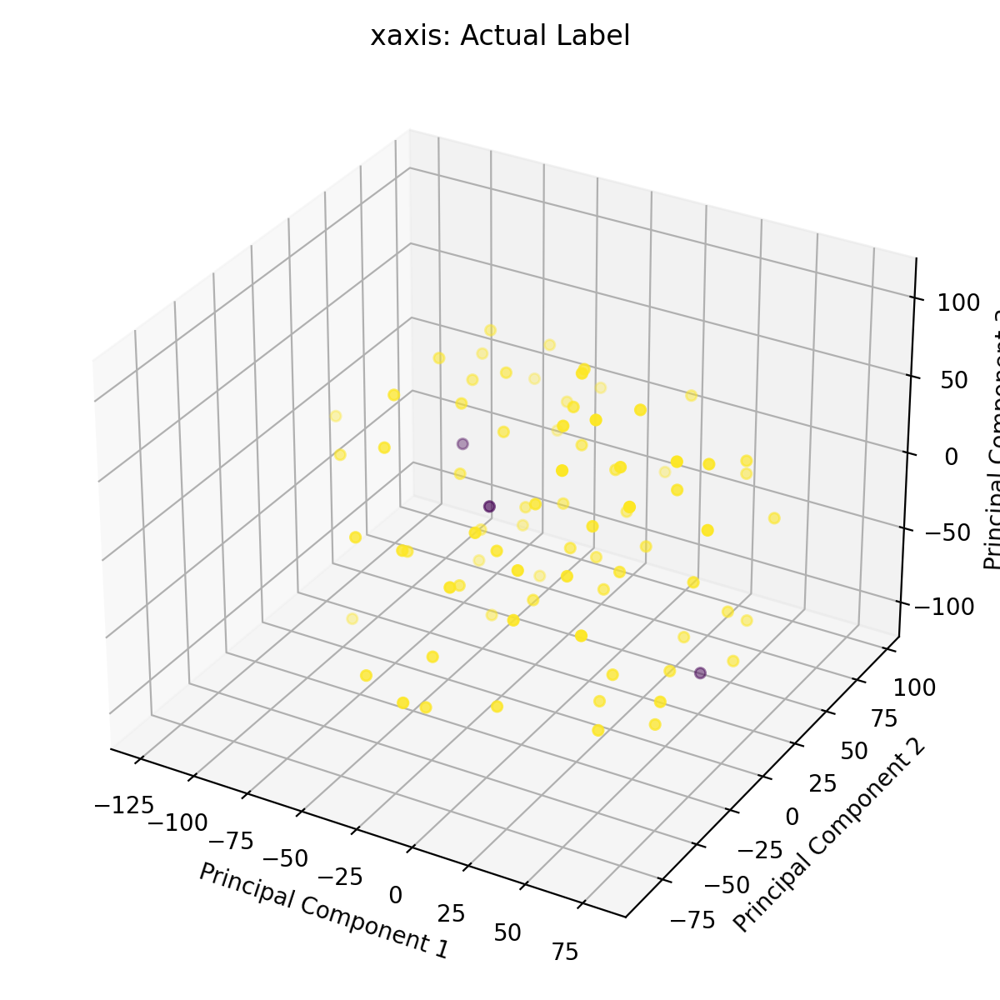




yaxis: OP00


<IPython.core.display.Javascript object>


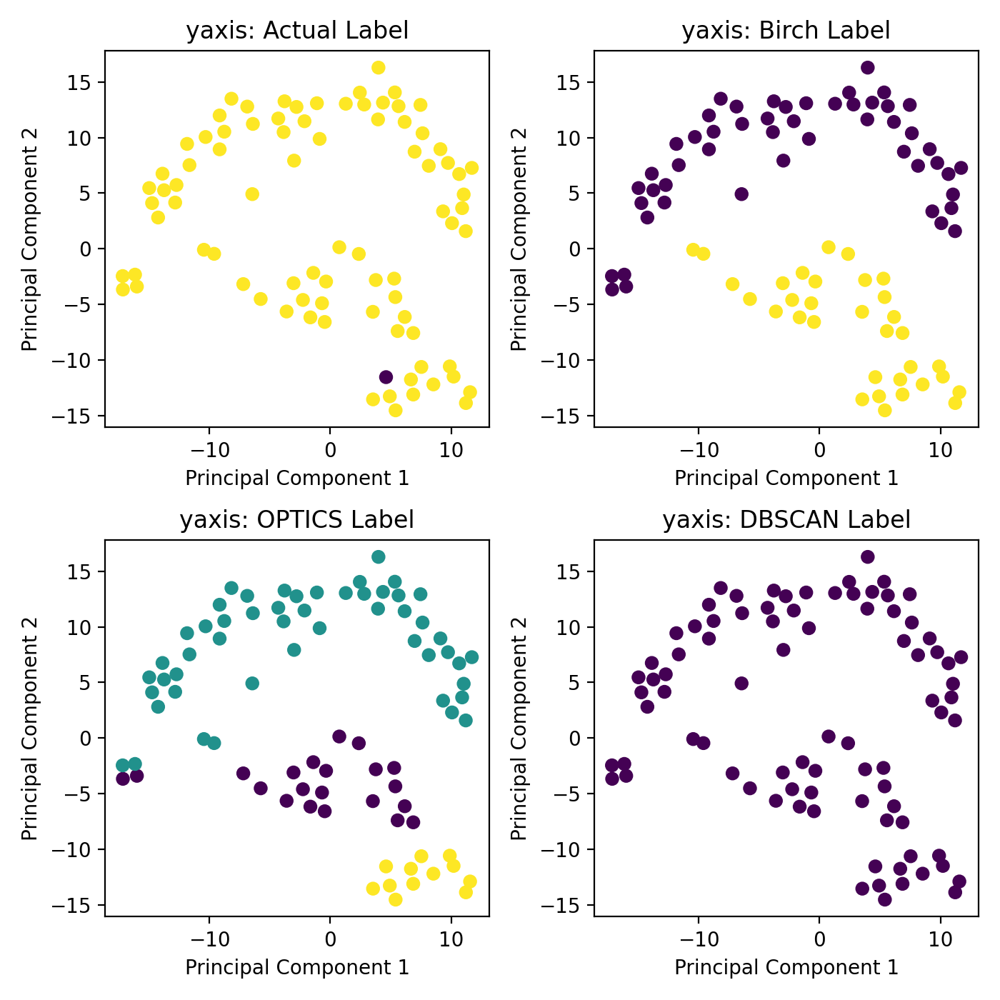

<IPython.core.display.Javascript object>


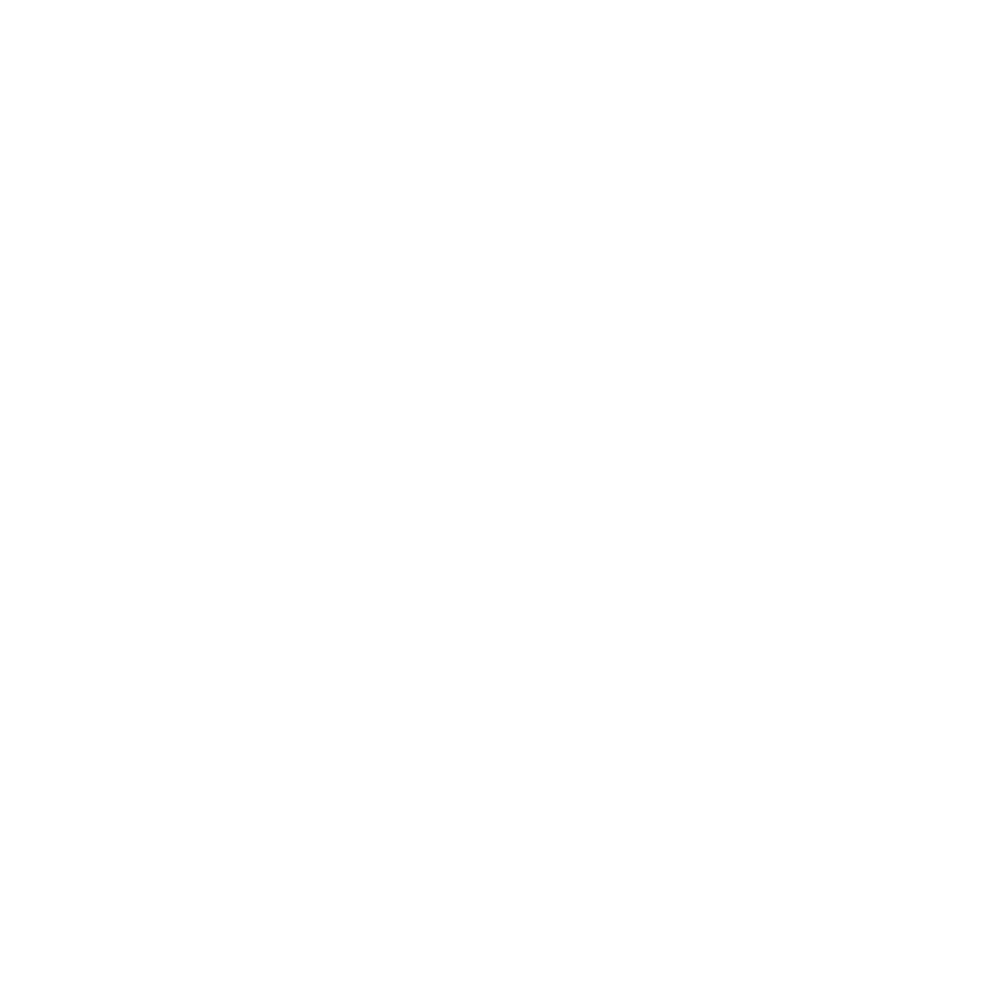




yaxis: OP01


<IPython.core.display.Javascript object>


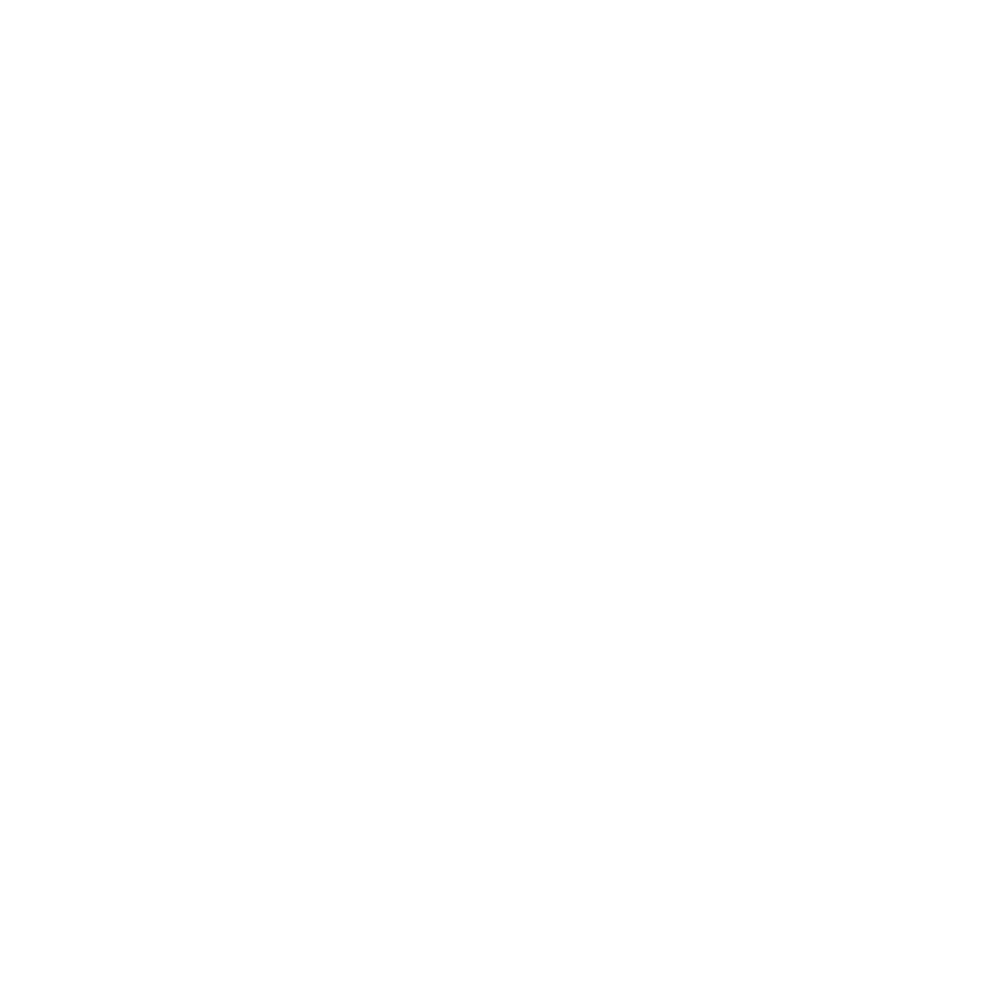

<IPython.core.display.Javascript object>


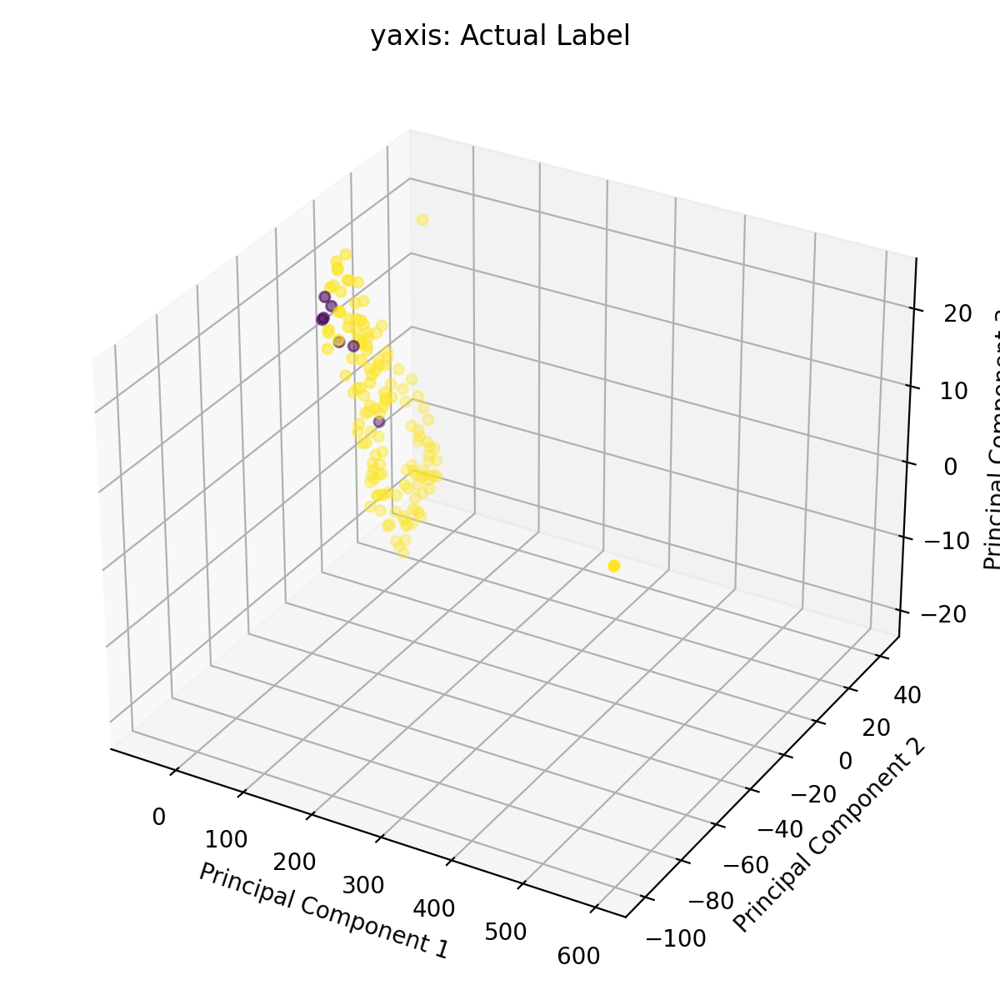




yaxis: OP02


<IPython.core.display.Javascript object>


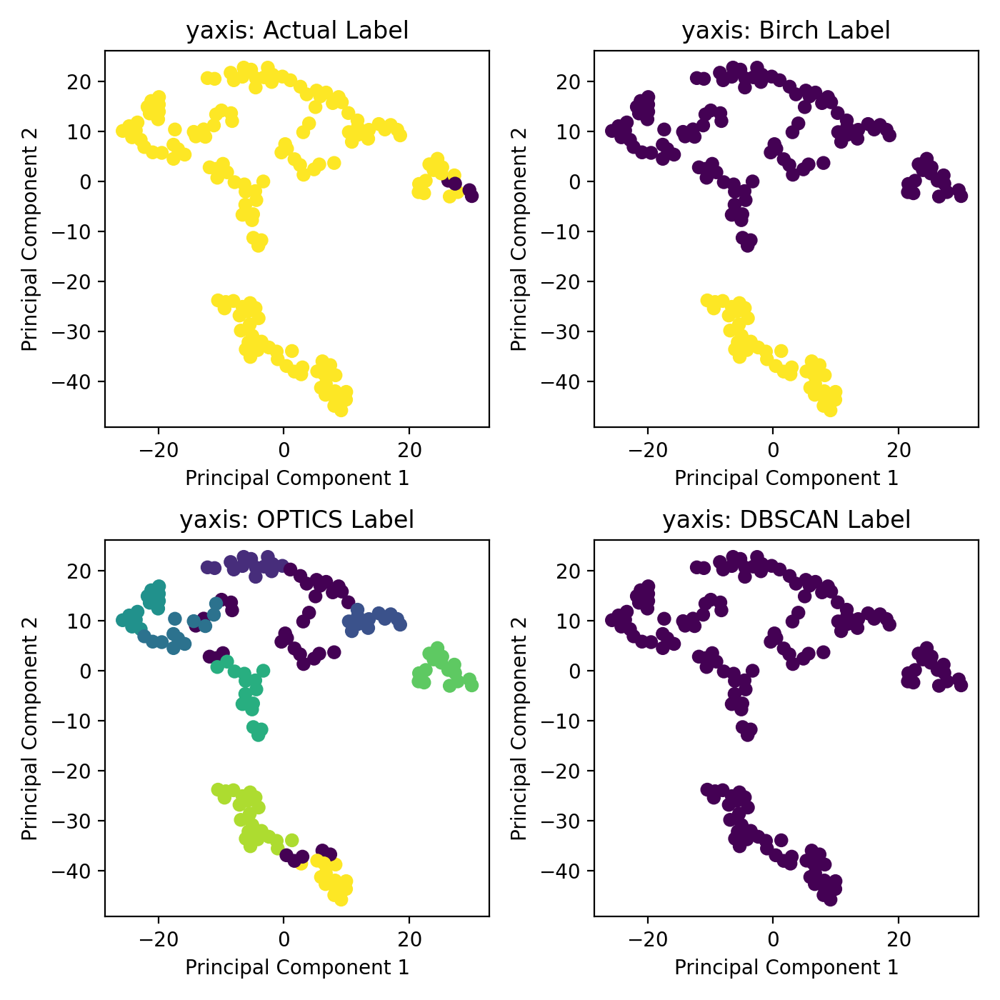

<IPython.core.display.Javascript object>


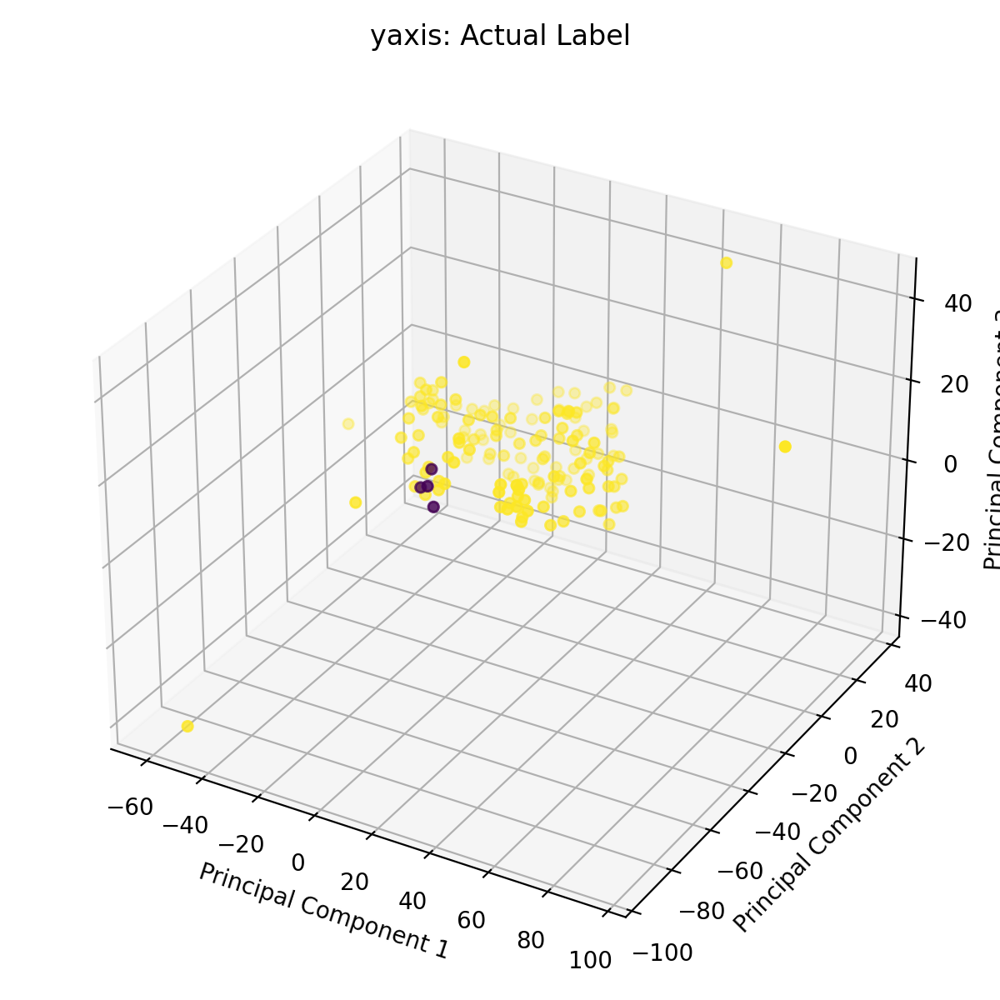




yaxis: OP03


<IPython.core.display.Javascript object>


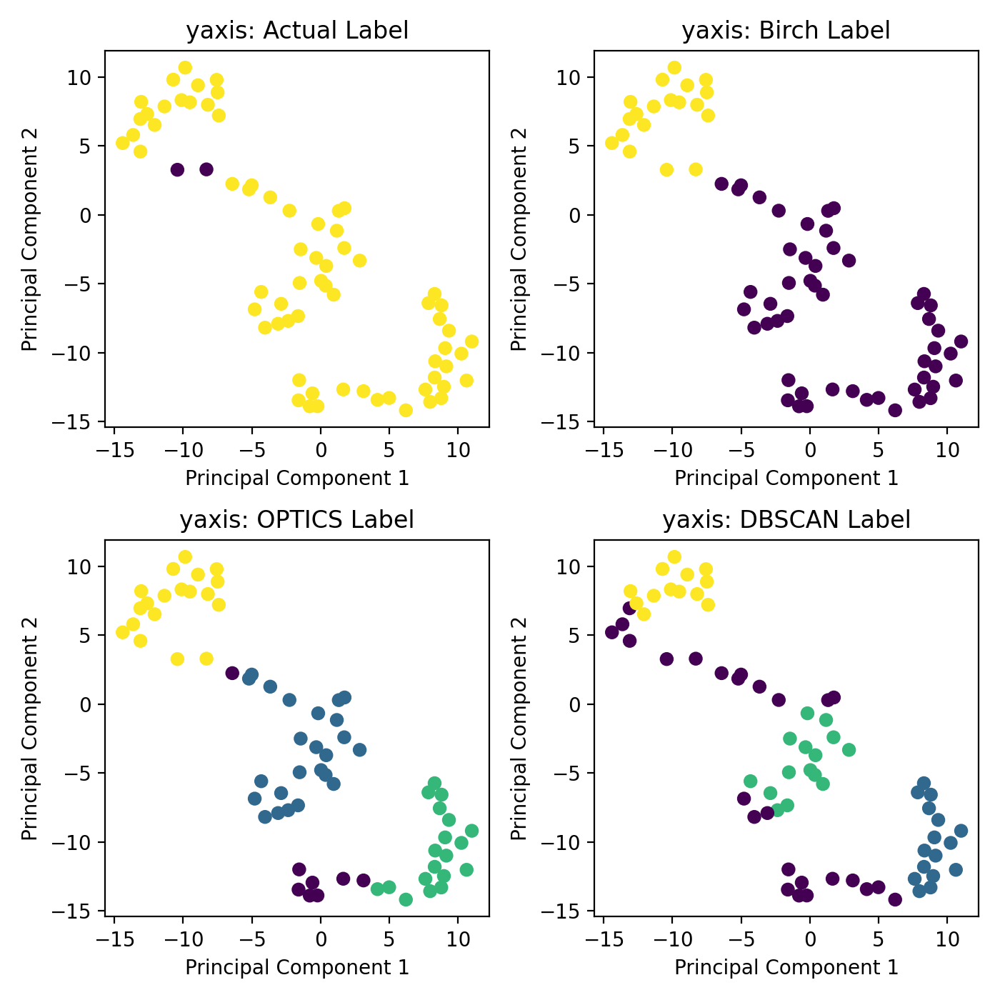

<IPython.core.display.Javascript object>


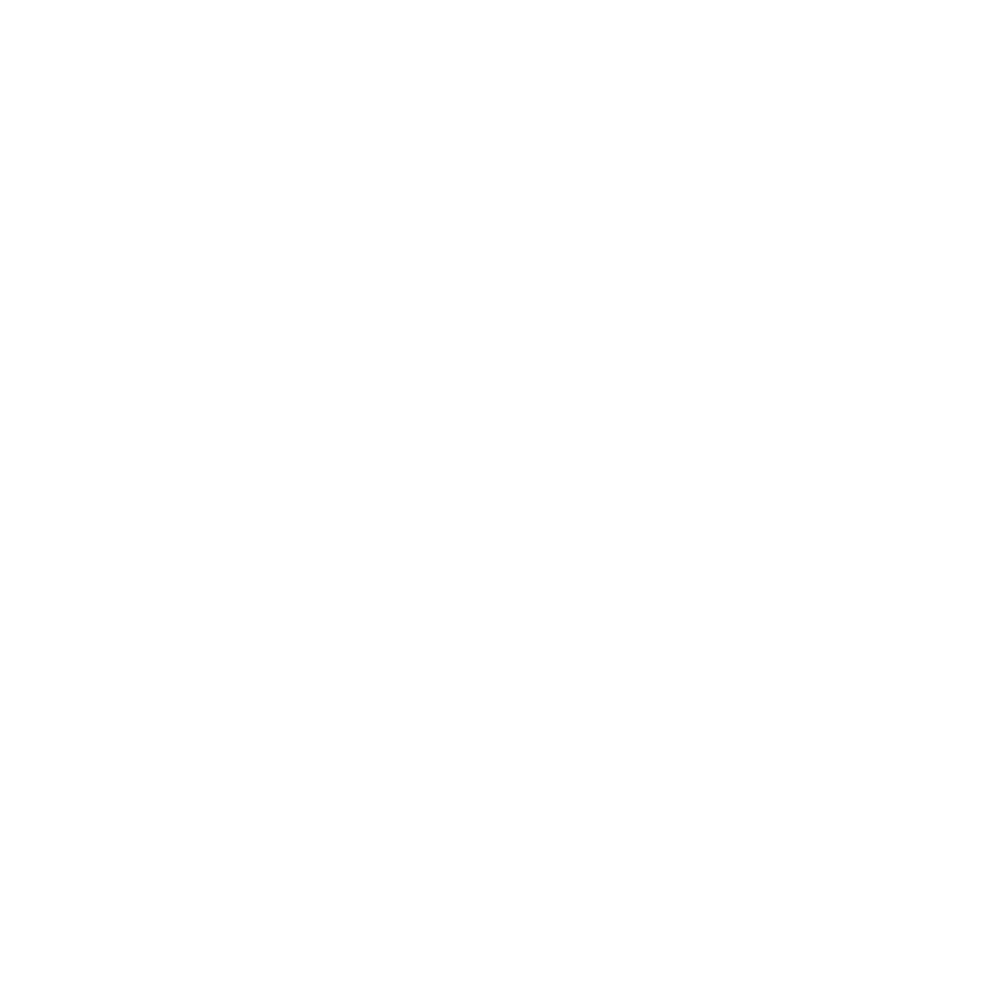




yaxis: OP04


<IPython.core.display.Javascript object>


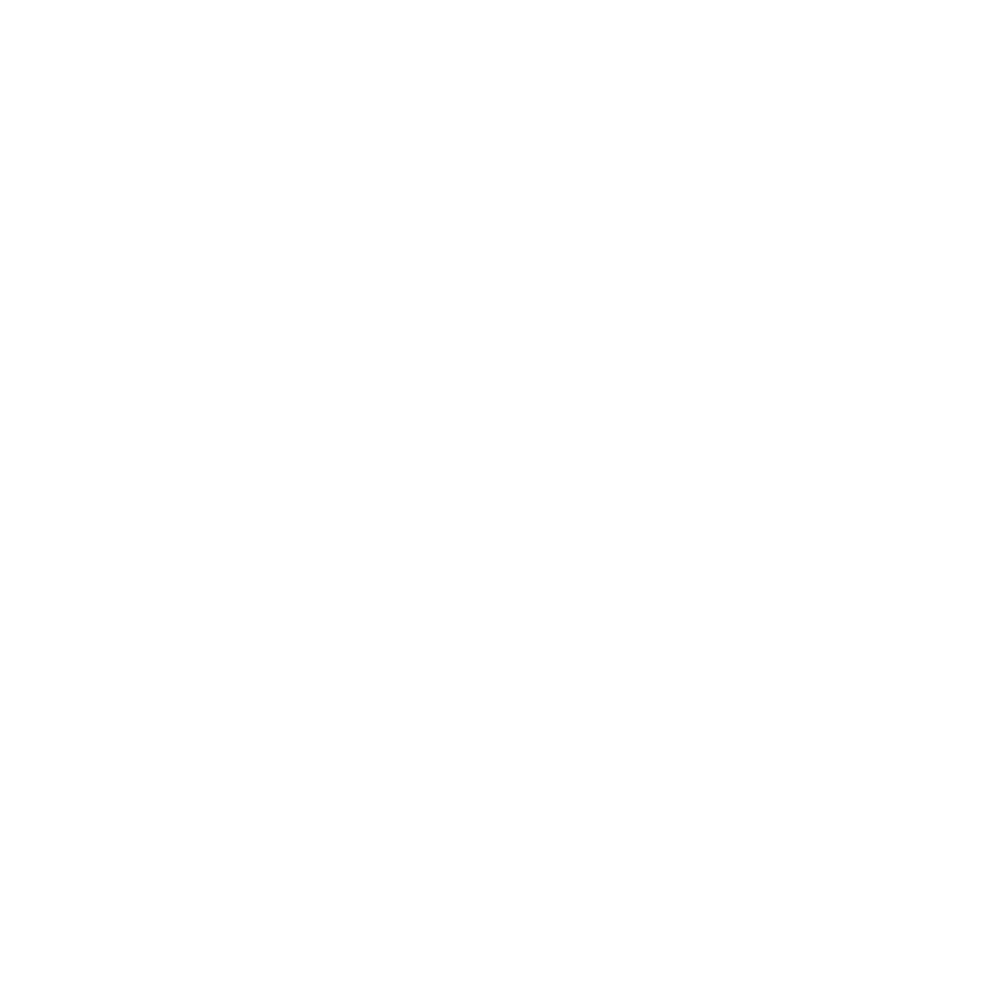

<IPython.core.display.Javascript object>


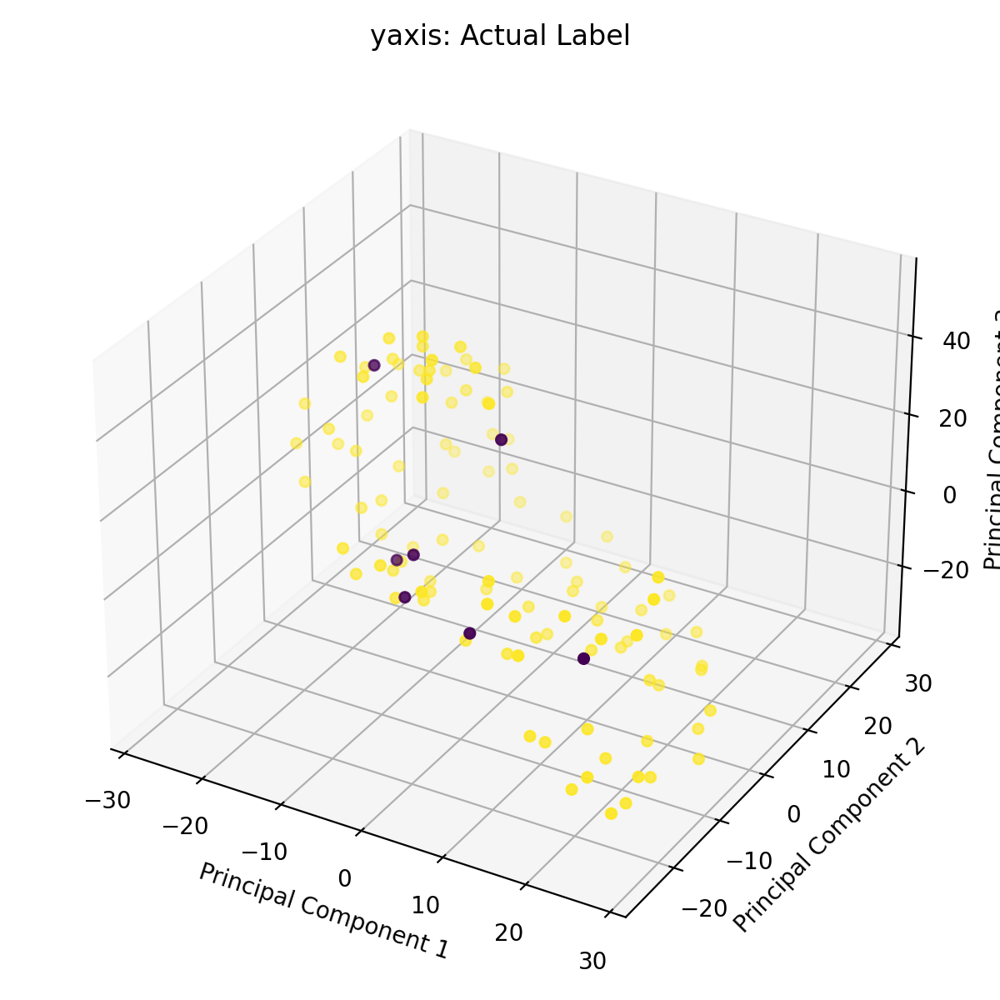




yaxis: OP05


<IPython.core.display.Javascript object>


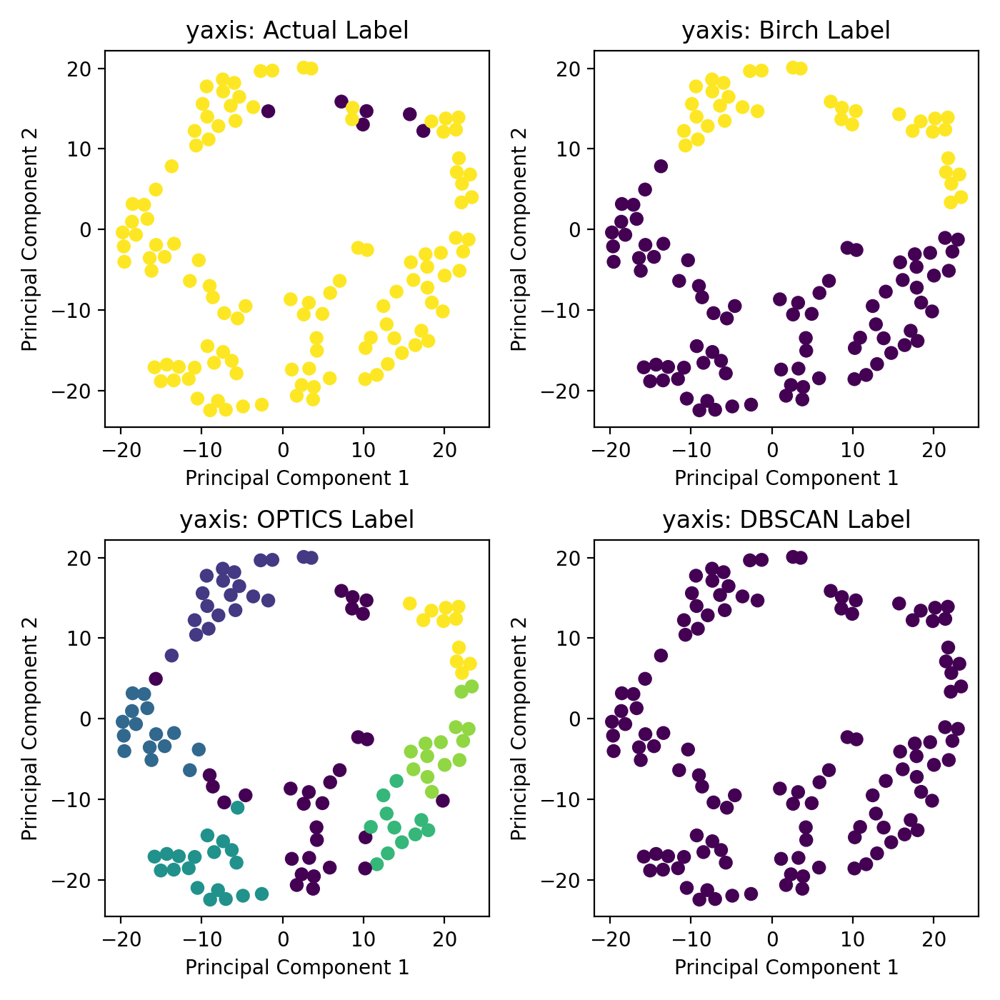

<IPython.core.display.Javascript object>


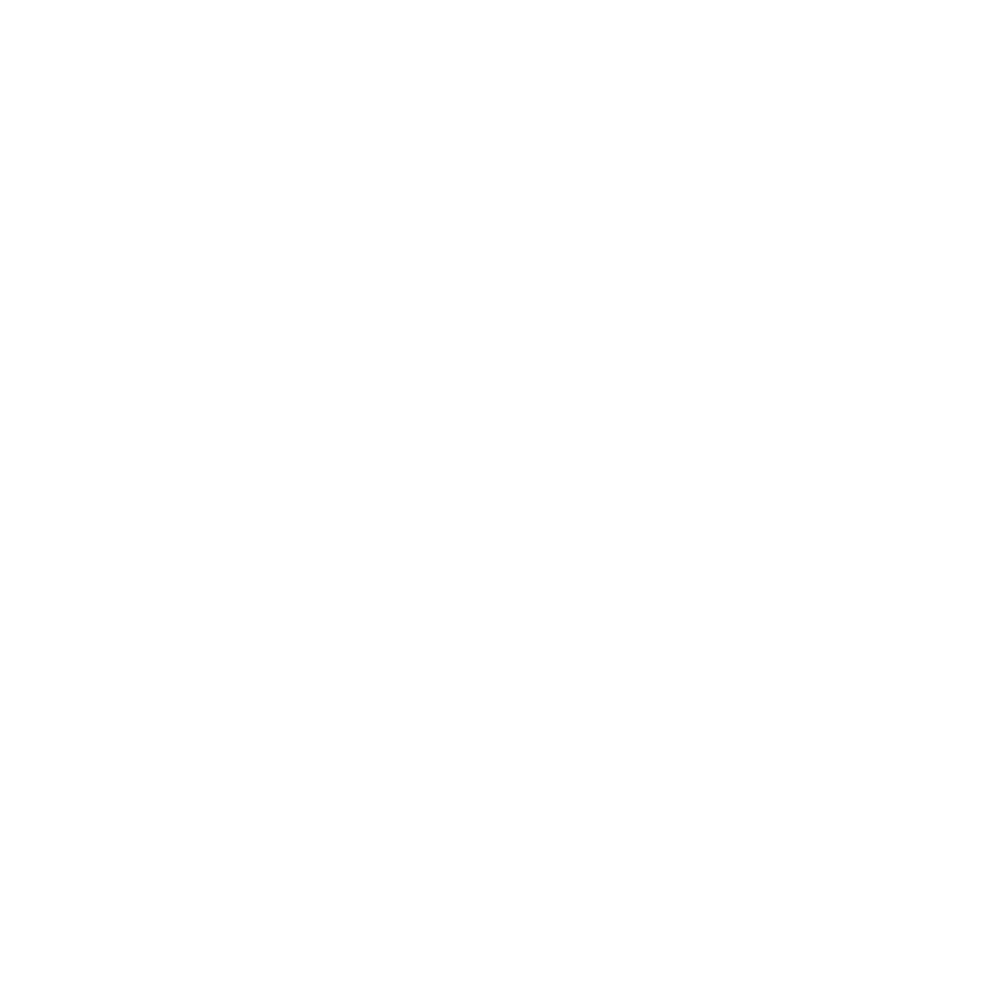




yaxis: OP06


<IPython.core.display.Javascript object>


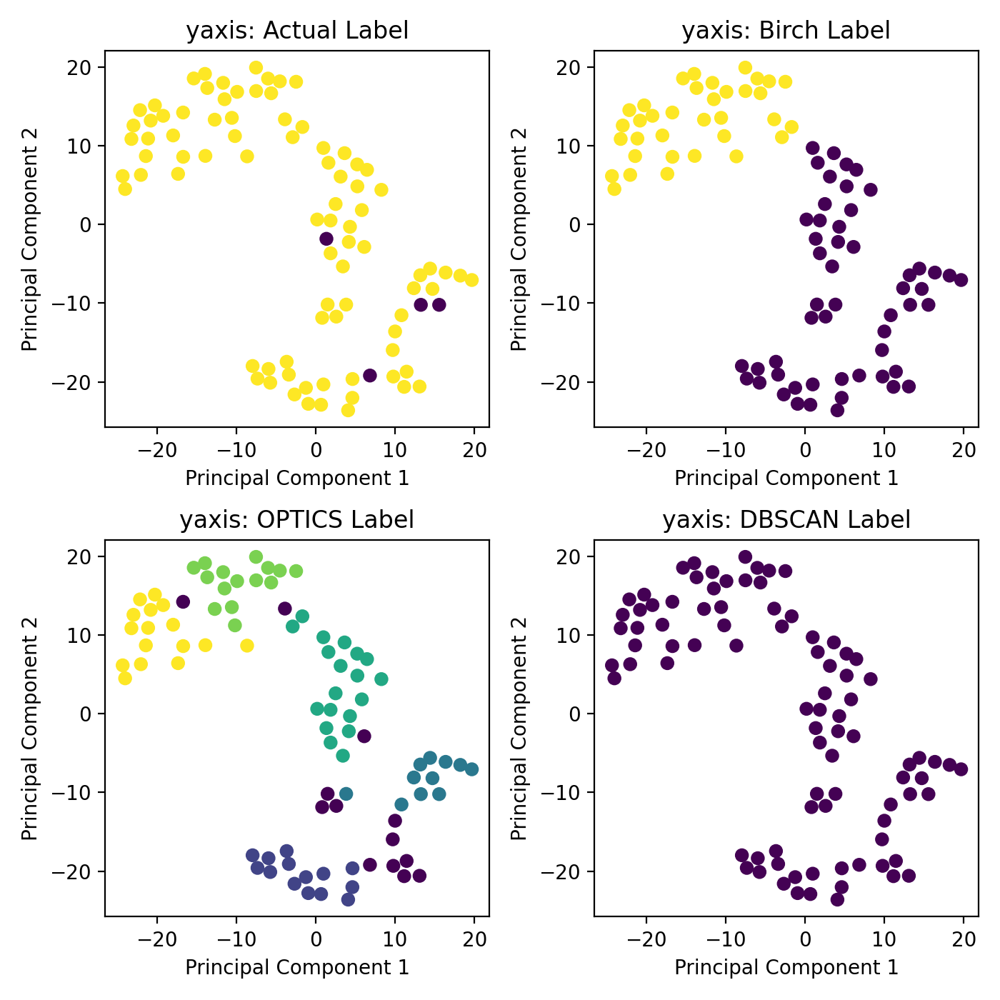

<IPython.core.display.Javascript object>


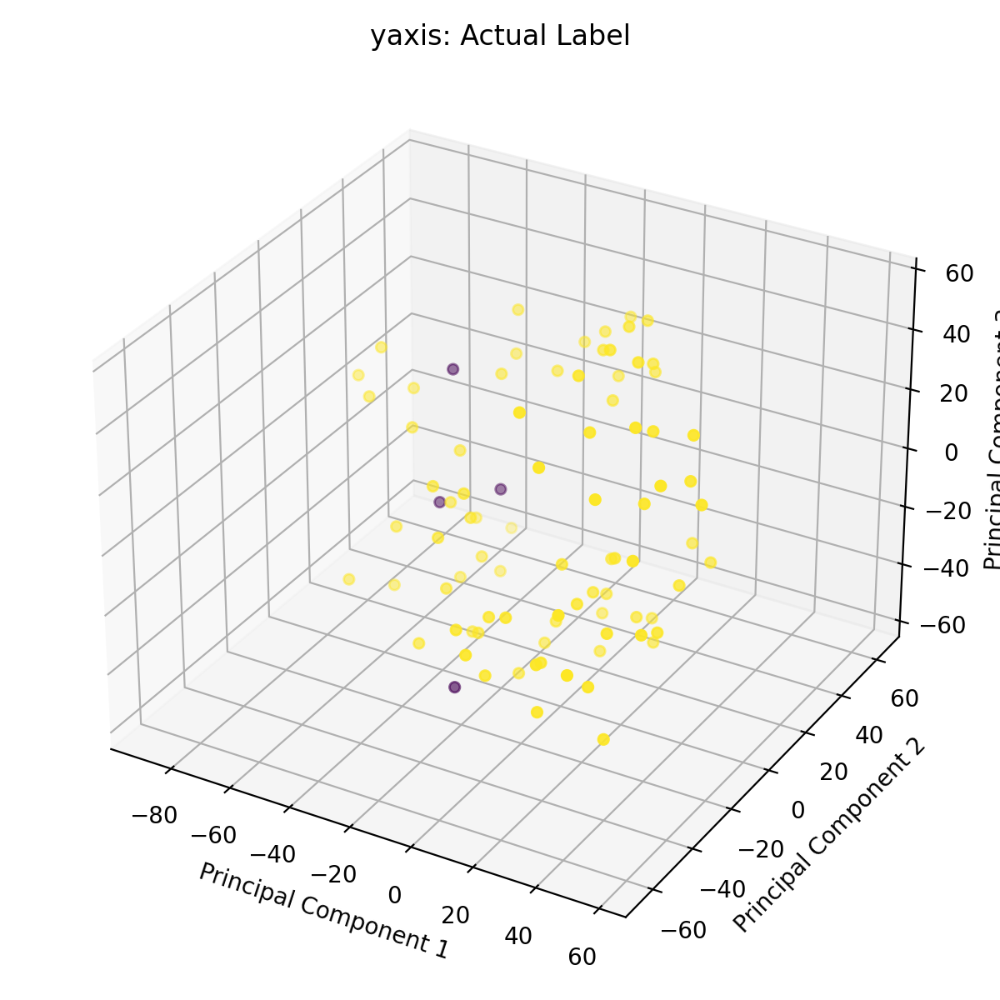




yaxis: OP07


<IPython.core.display.Javascript object>


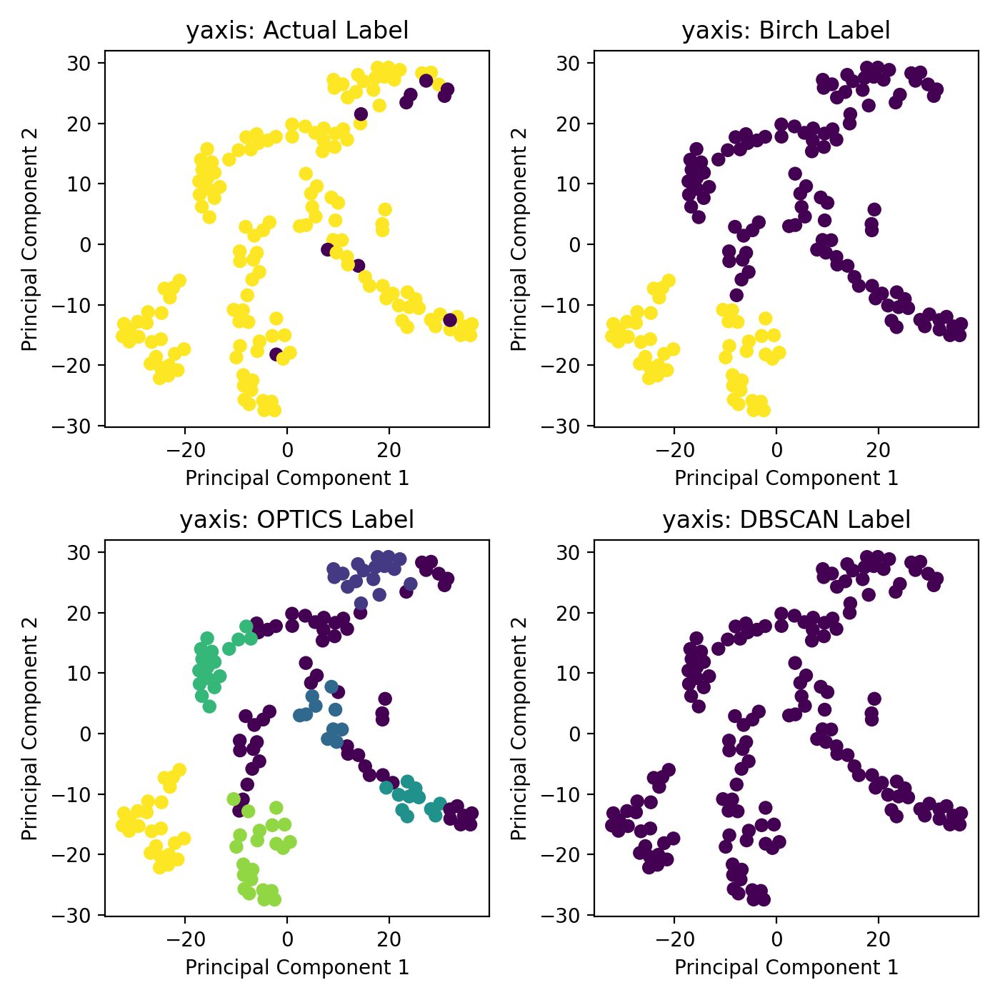

<IPython.core.display.Javascript object>


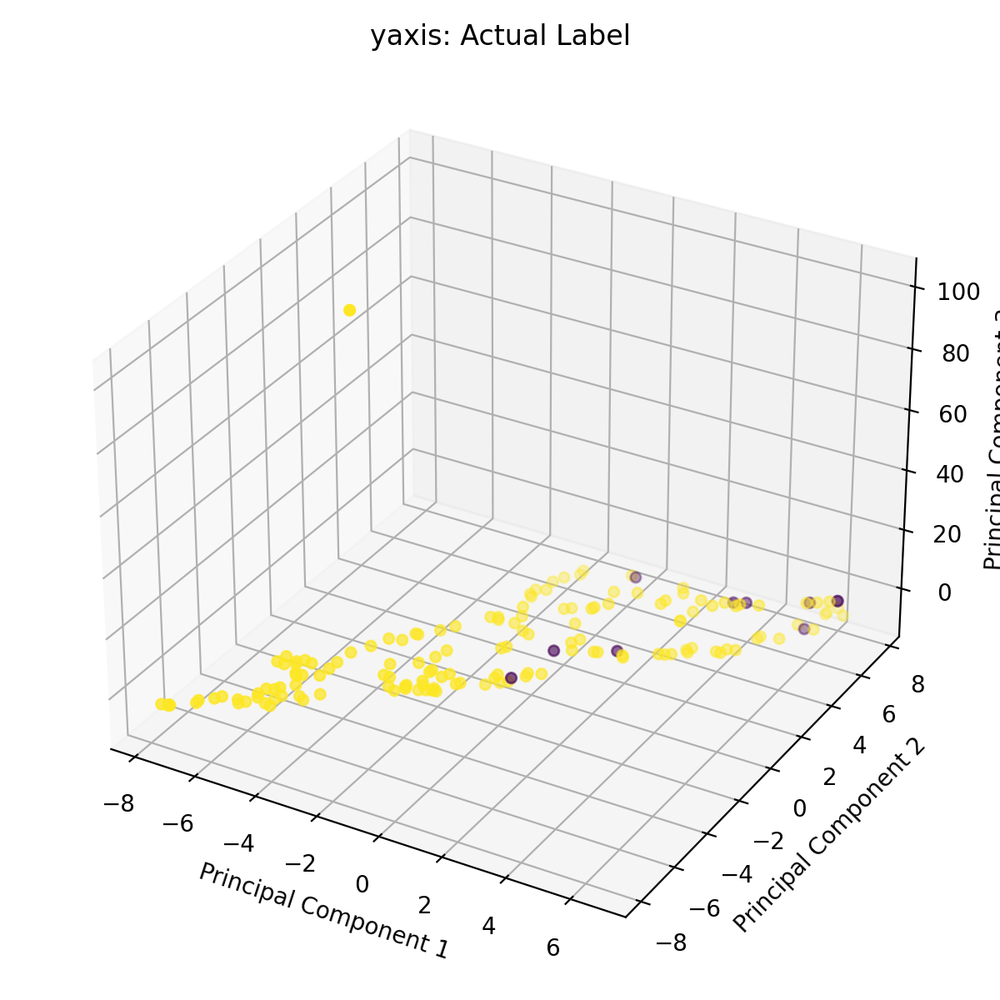




yaxis: OP08


<IPython.core.display.Javascript object>


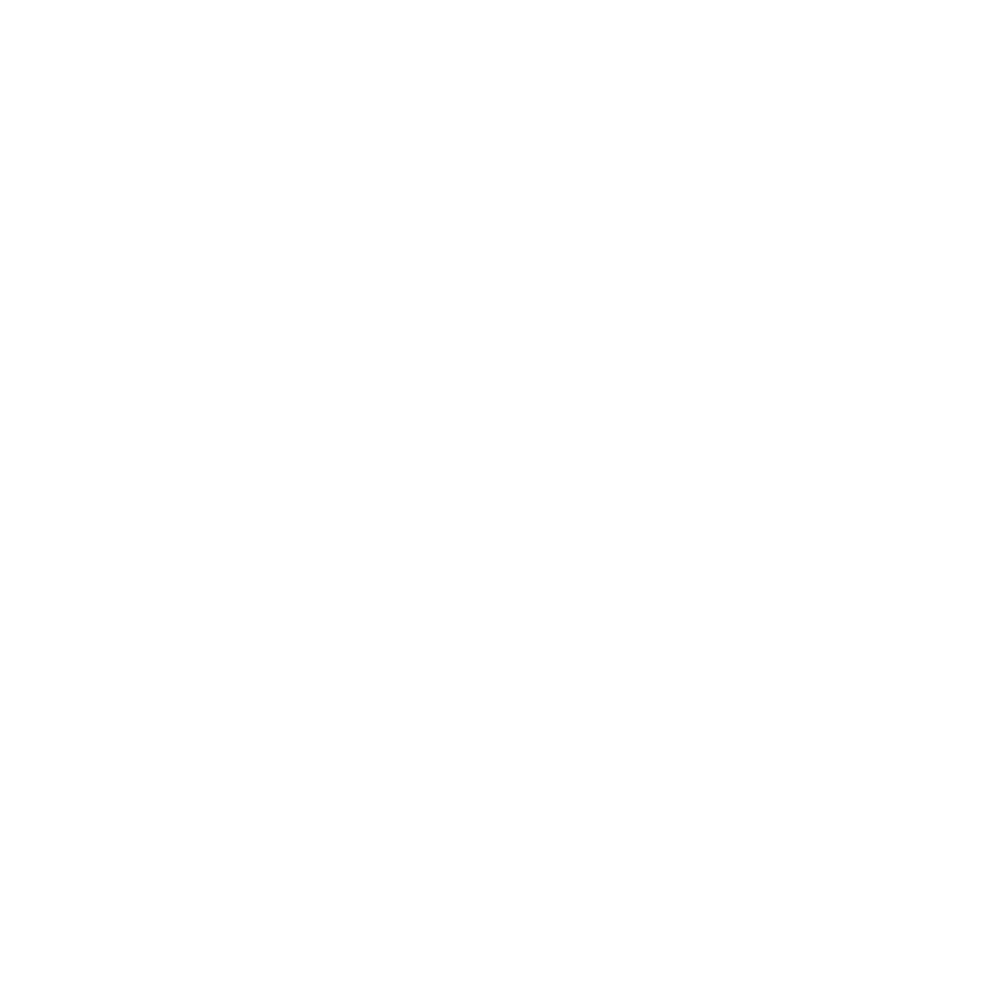

<IPython.core.display.Javascript object>


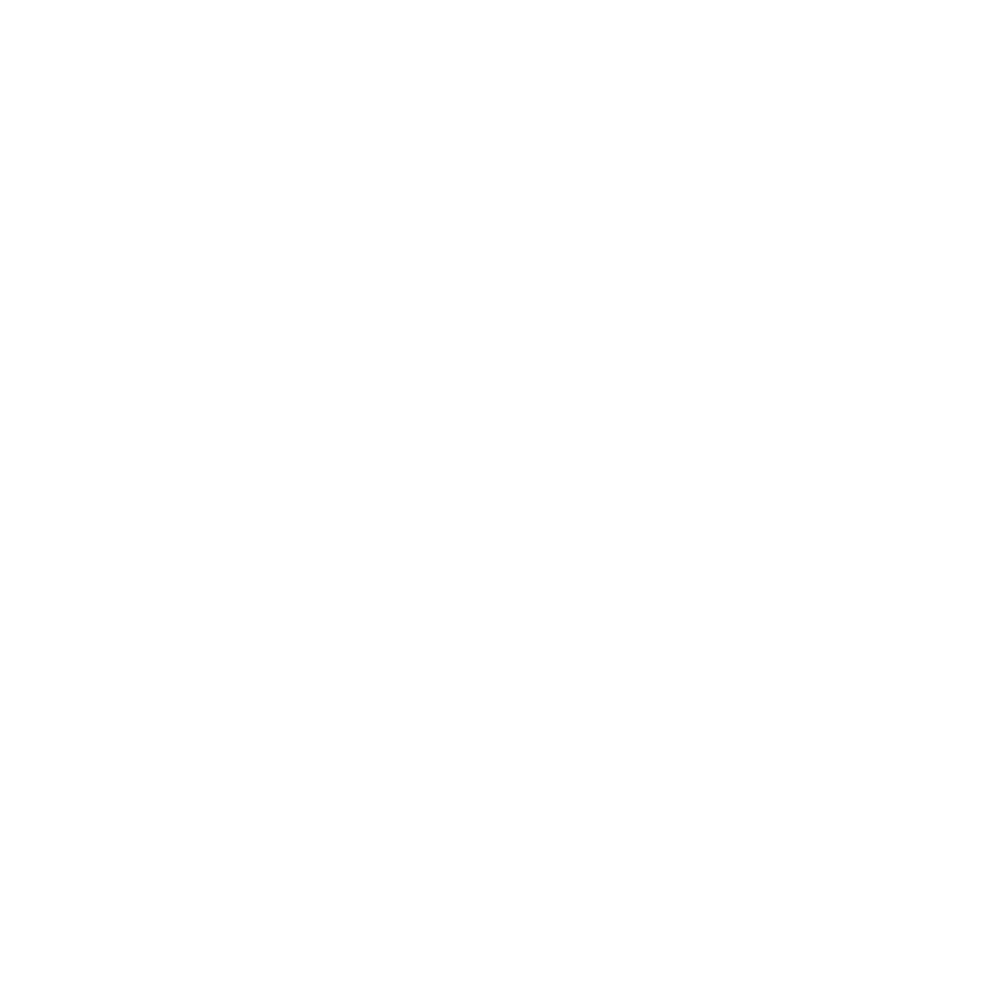




yaxis: OP09


<IPython.core.display.Javascript object>


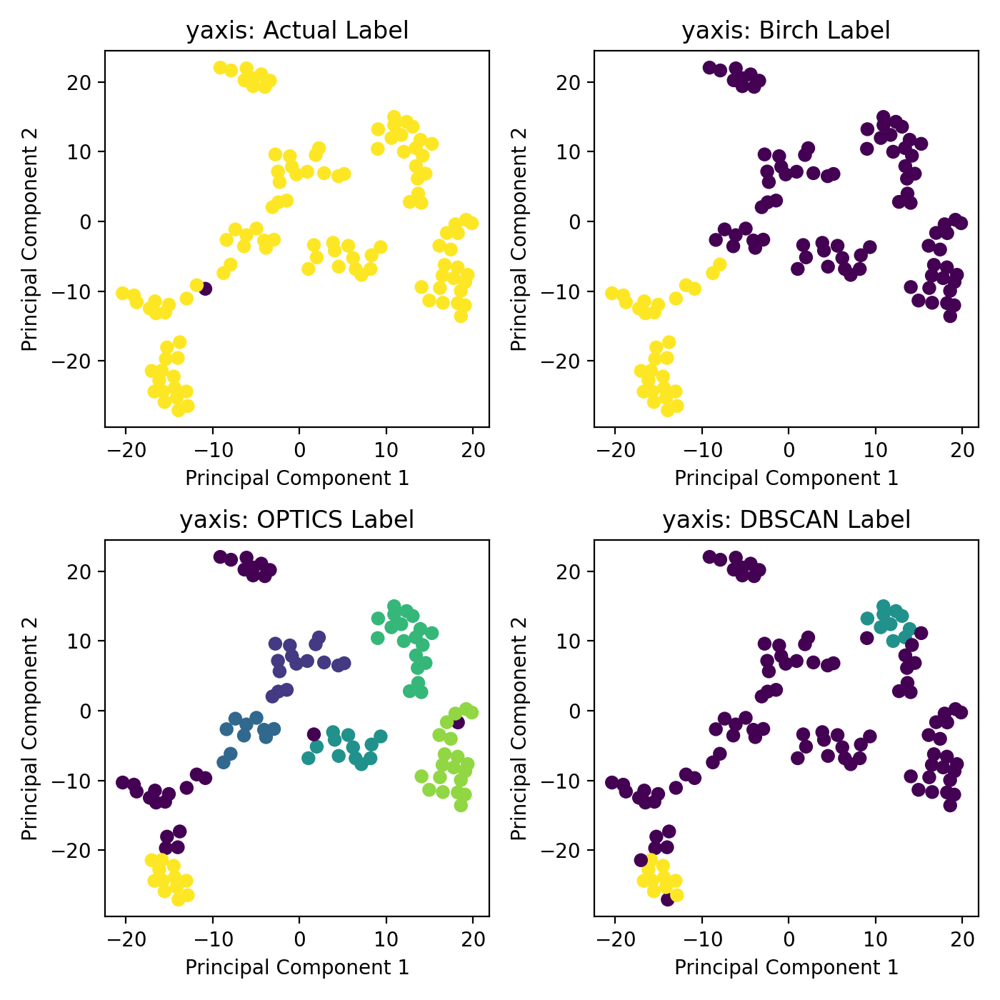

<IPython.core.display.Javascript object>


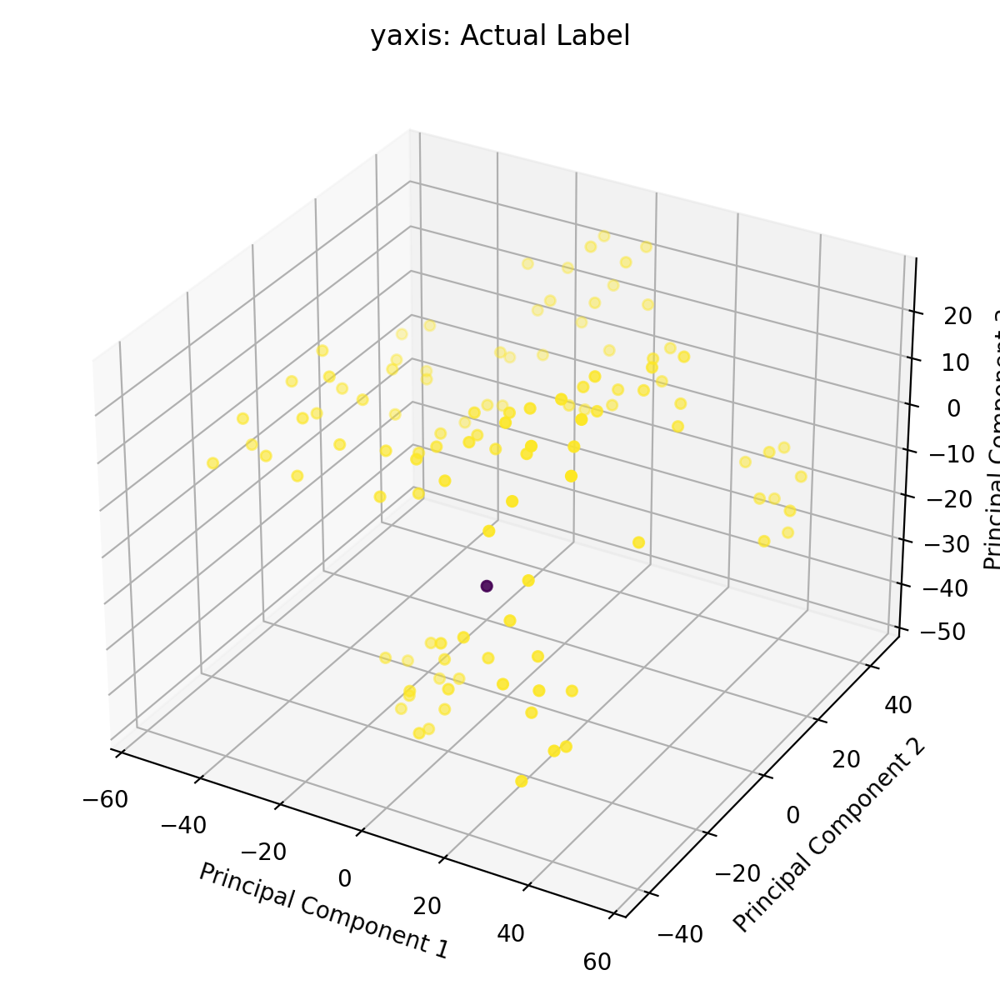




yaxis: OP10


<IPython.core.display.Javascript object>


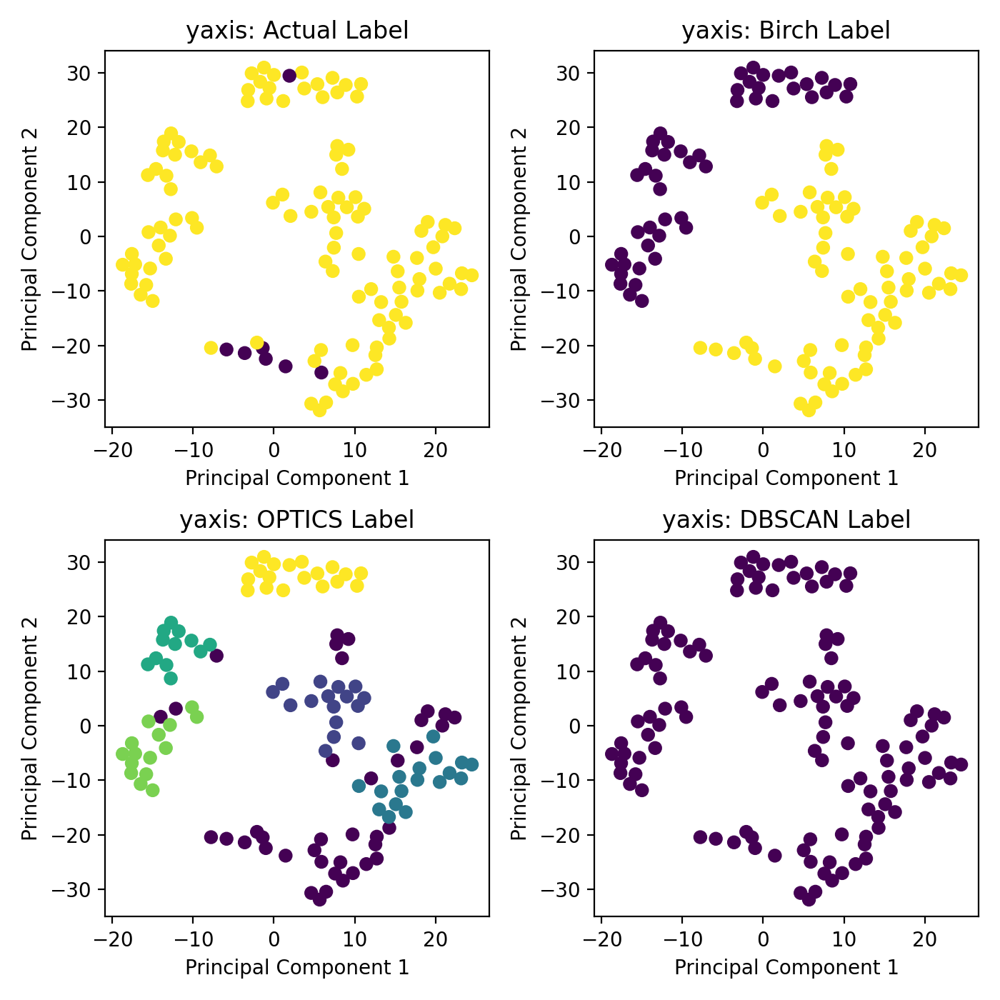

<IPython.core.display.Javascript object>


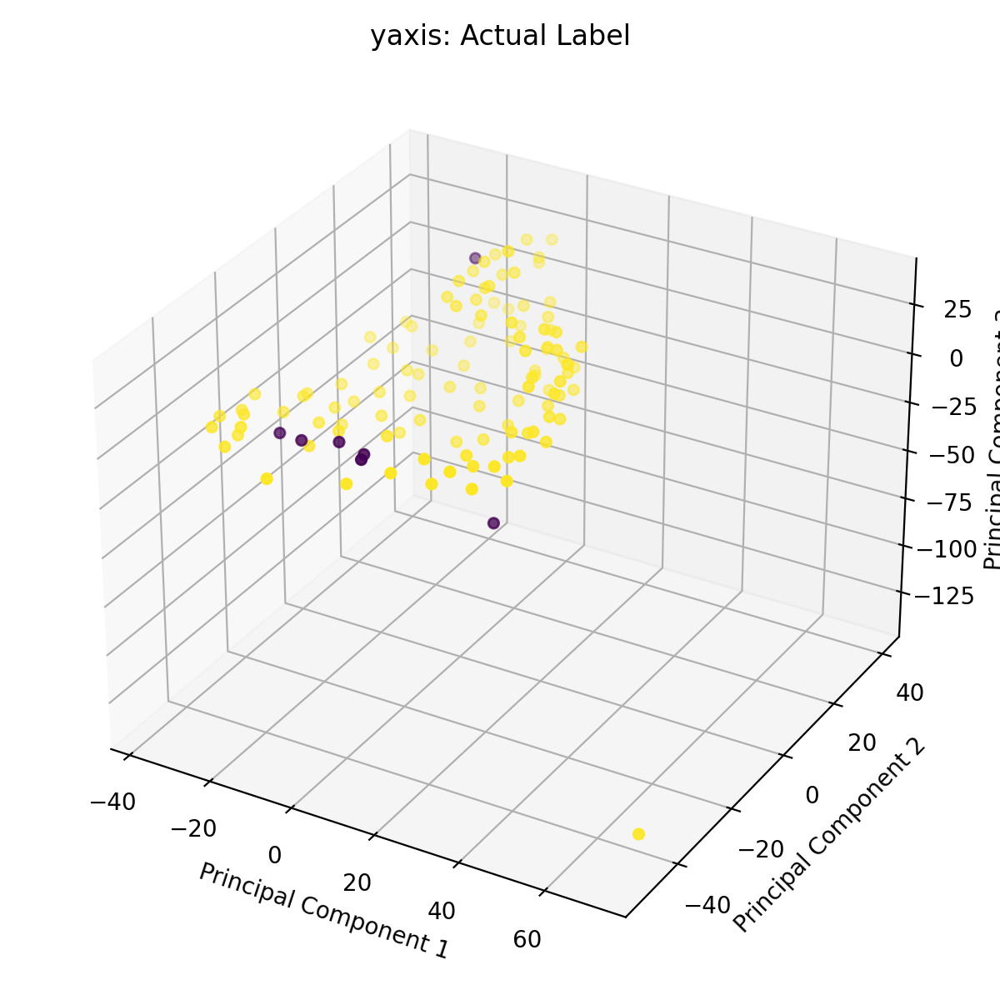




yaxis: OP11


<IPython.core.display.Javascript object>


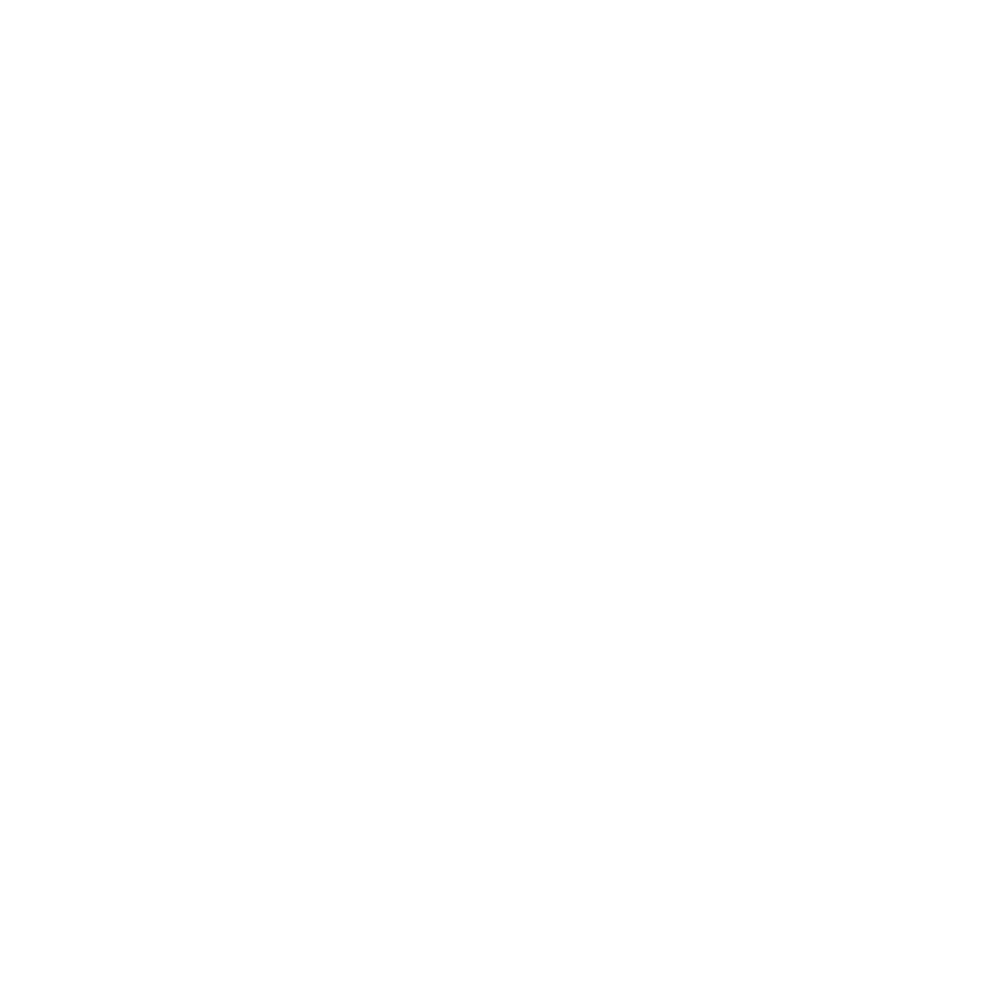

<IPython.core.display.Javascript object>


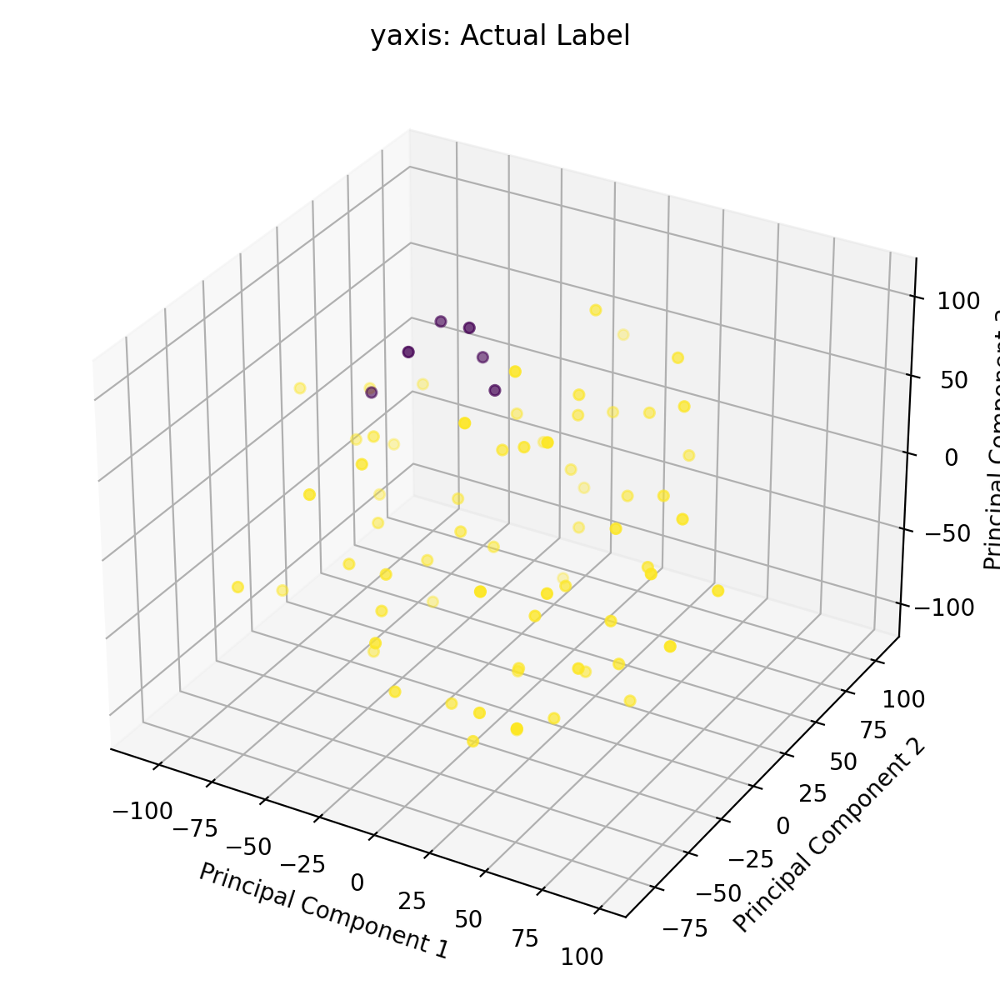




yaxis: OP12


<IPython.core.display.Javascript object>


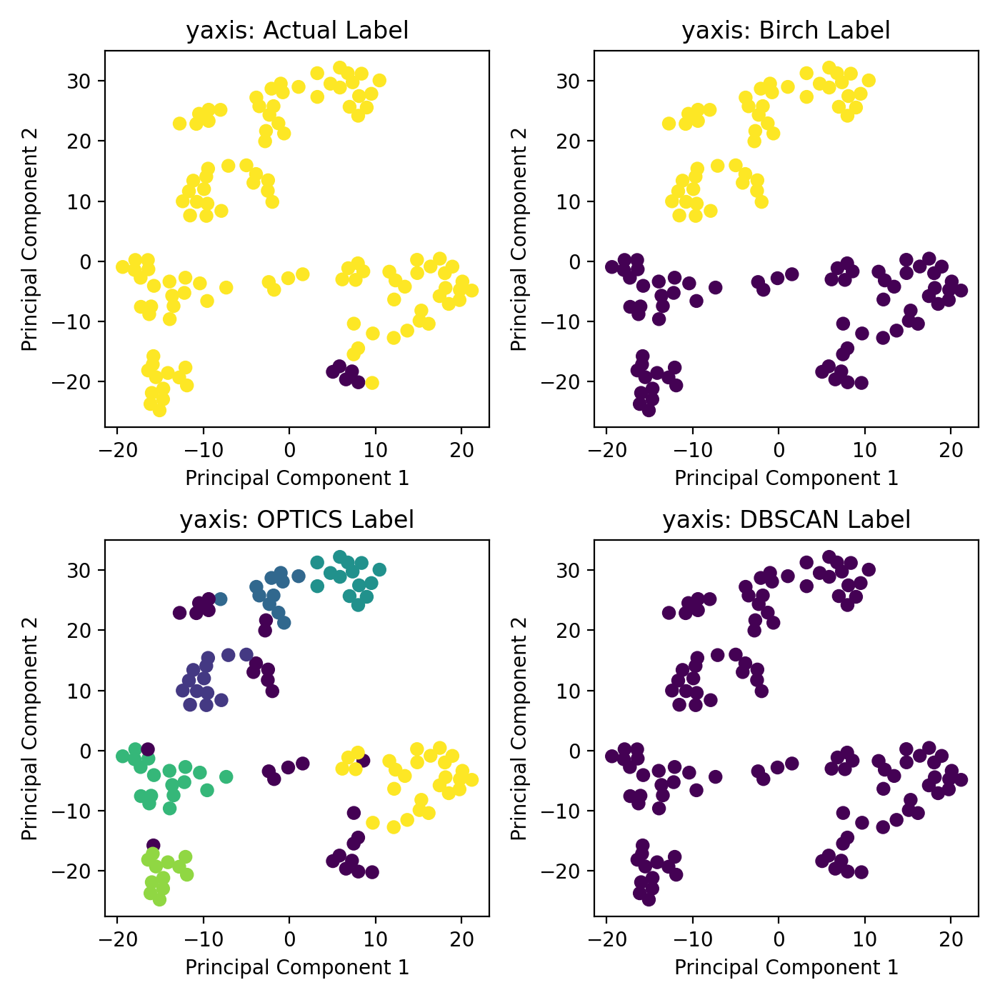

<IPython.core.display.Javascript object>


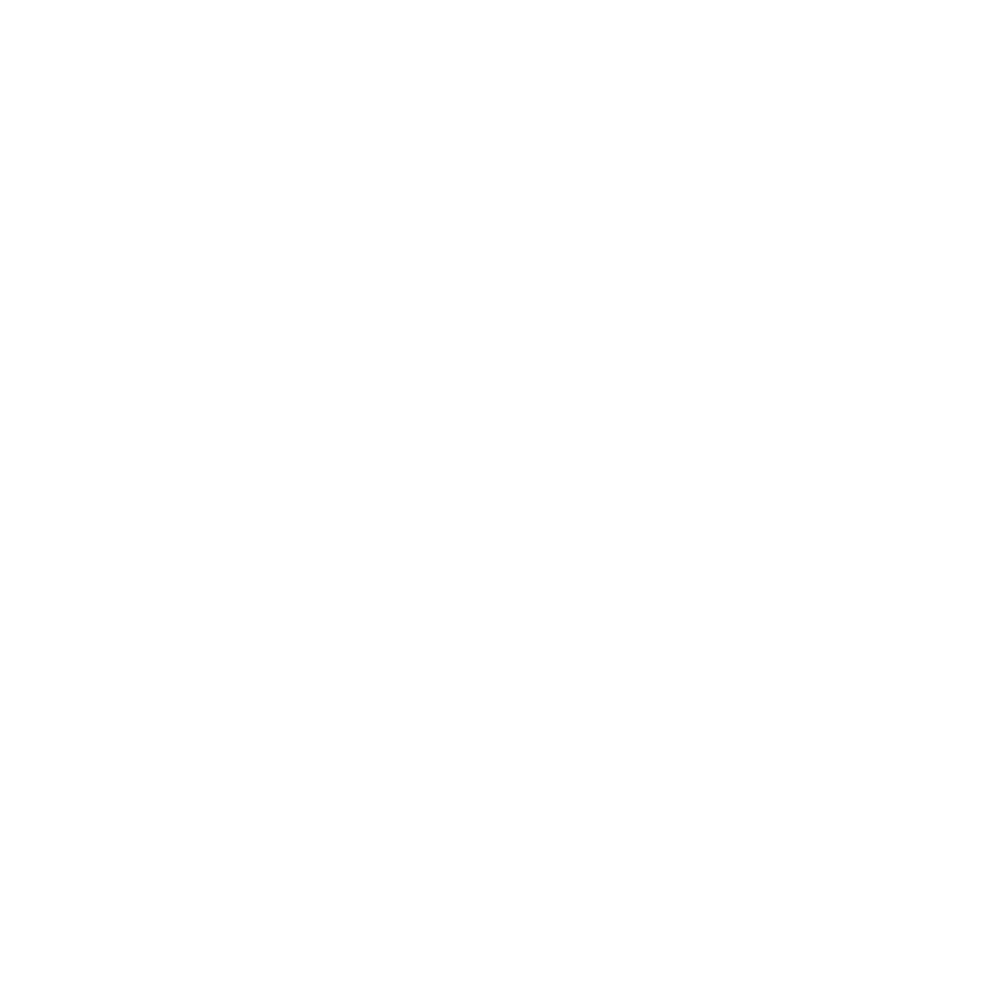




yaxis: OP13


<IPython.core.display.Javascript object>


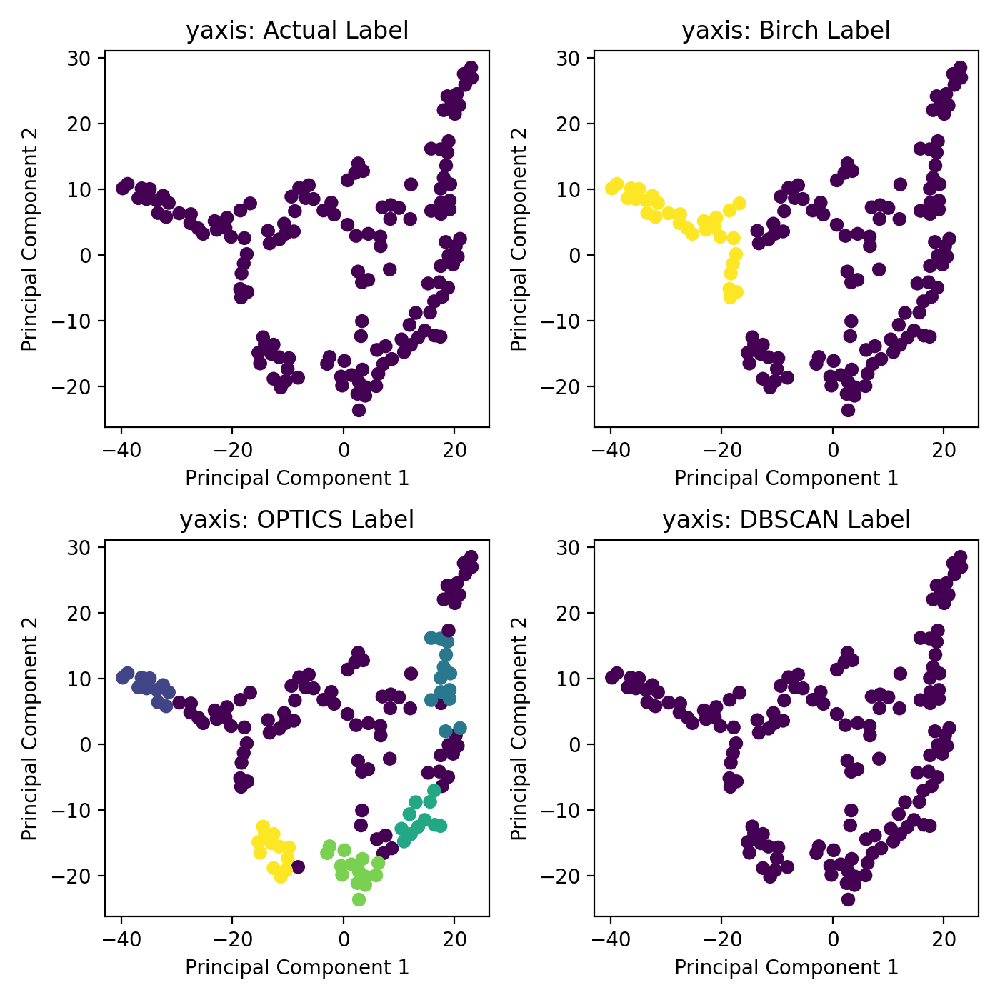

<IPython.core.display.Javascript object>


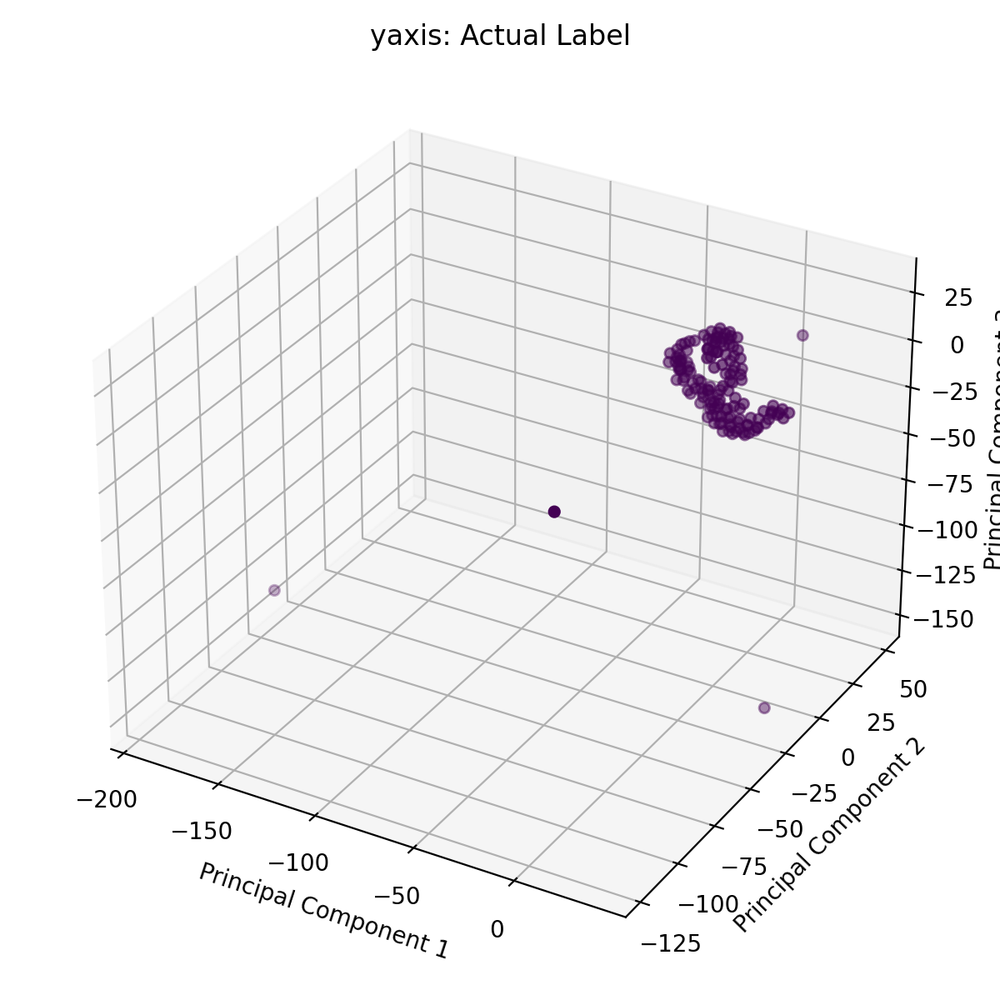




yaxis: OP14


<IPython.core.display.Javascript object>


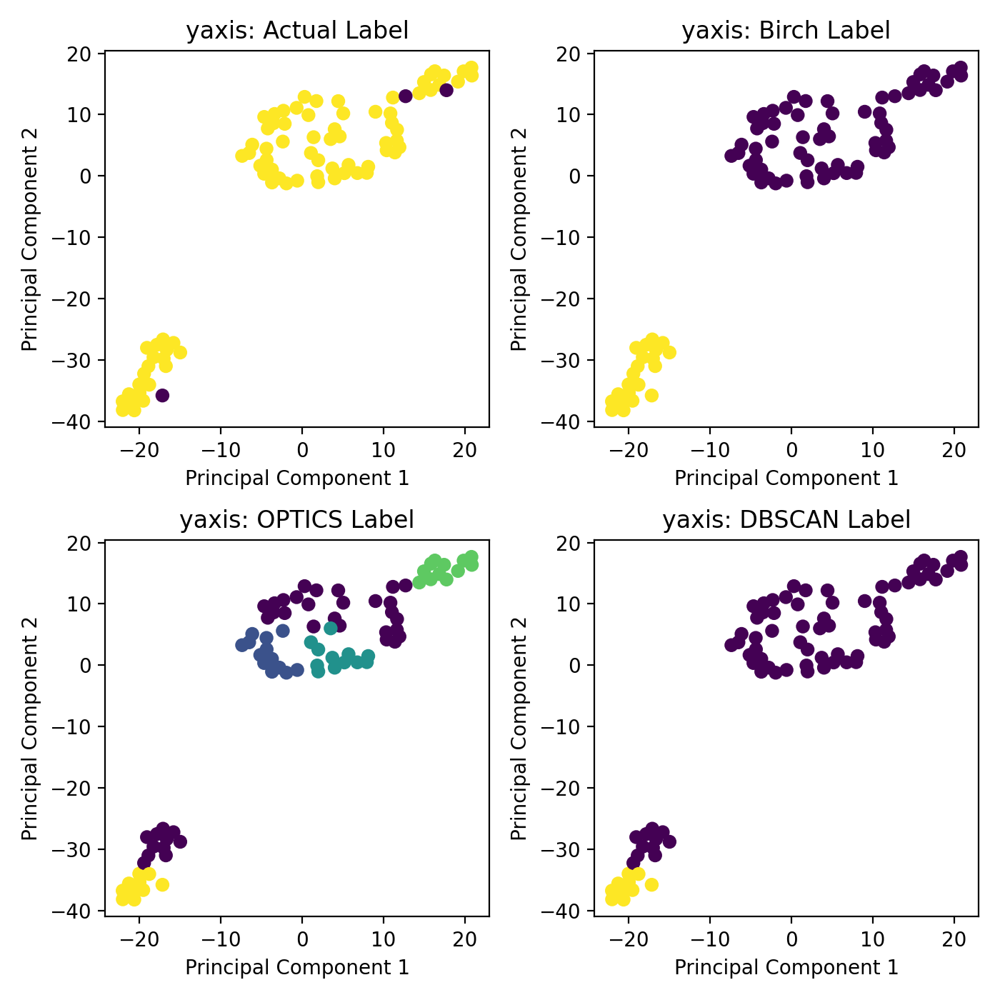

<IPython.core.display.Javascript object>


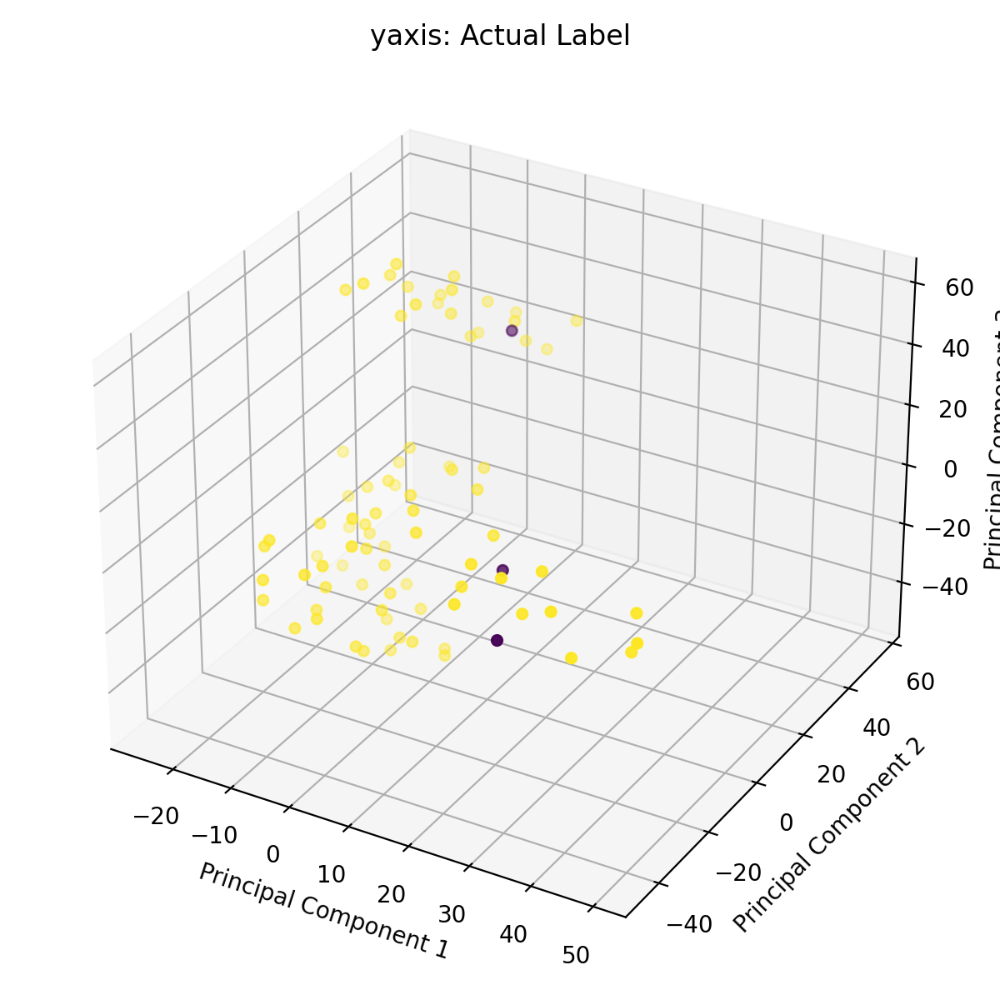




zaxis: OP00


<IPython.core.display.Javascript object>


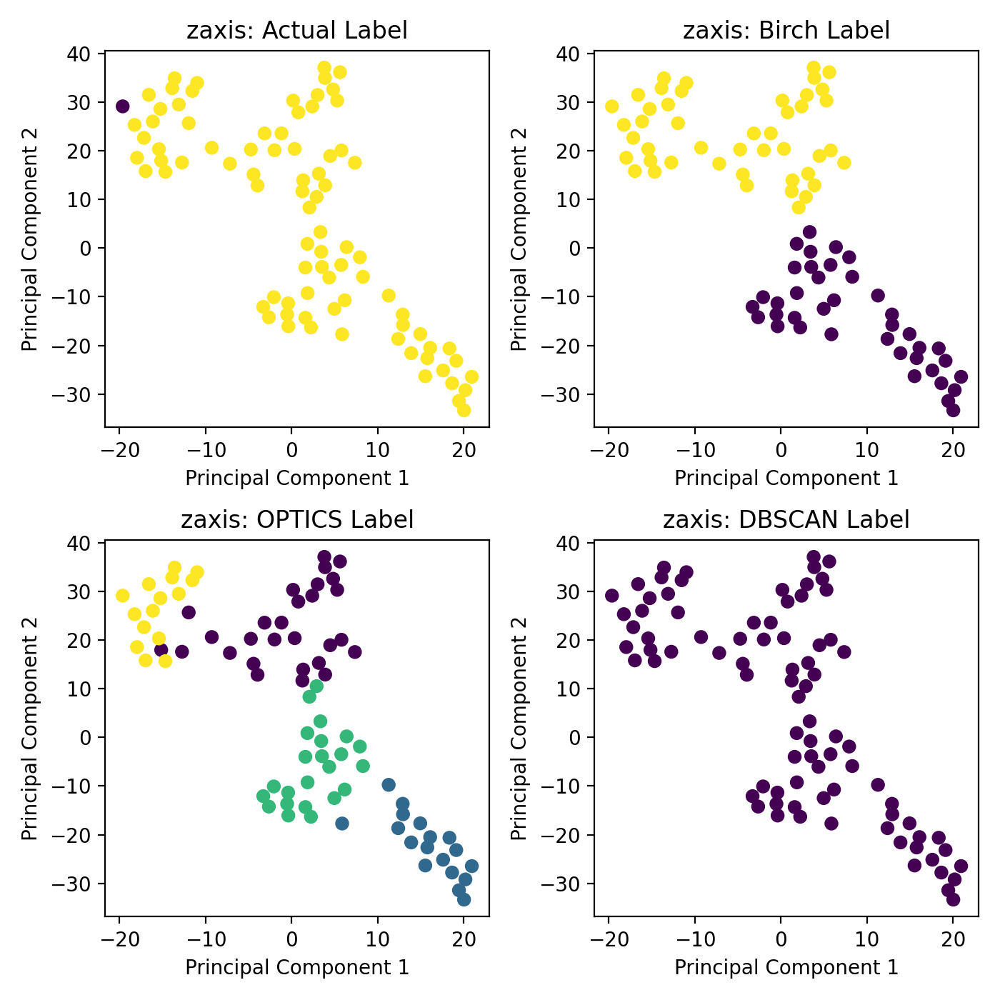

<IPython.core.display.Javascript object>


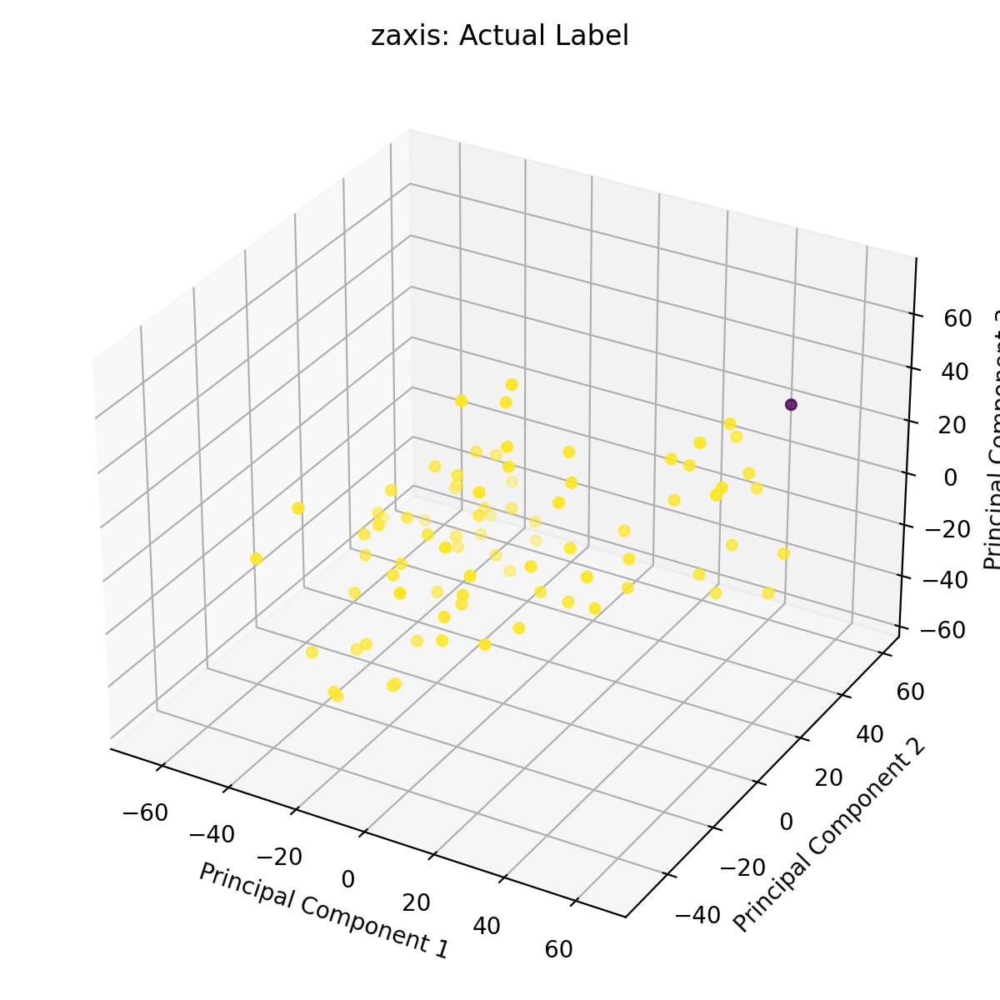




zaxis: OP01


<IPython.core.display.Javascript object>


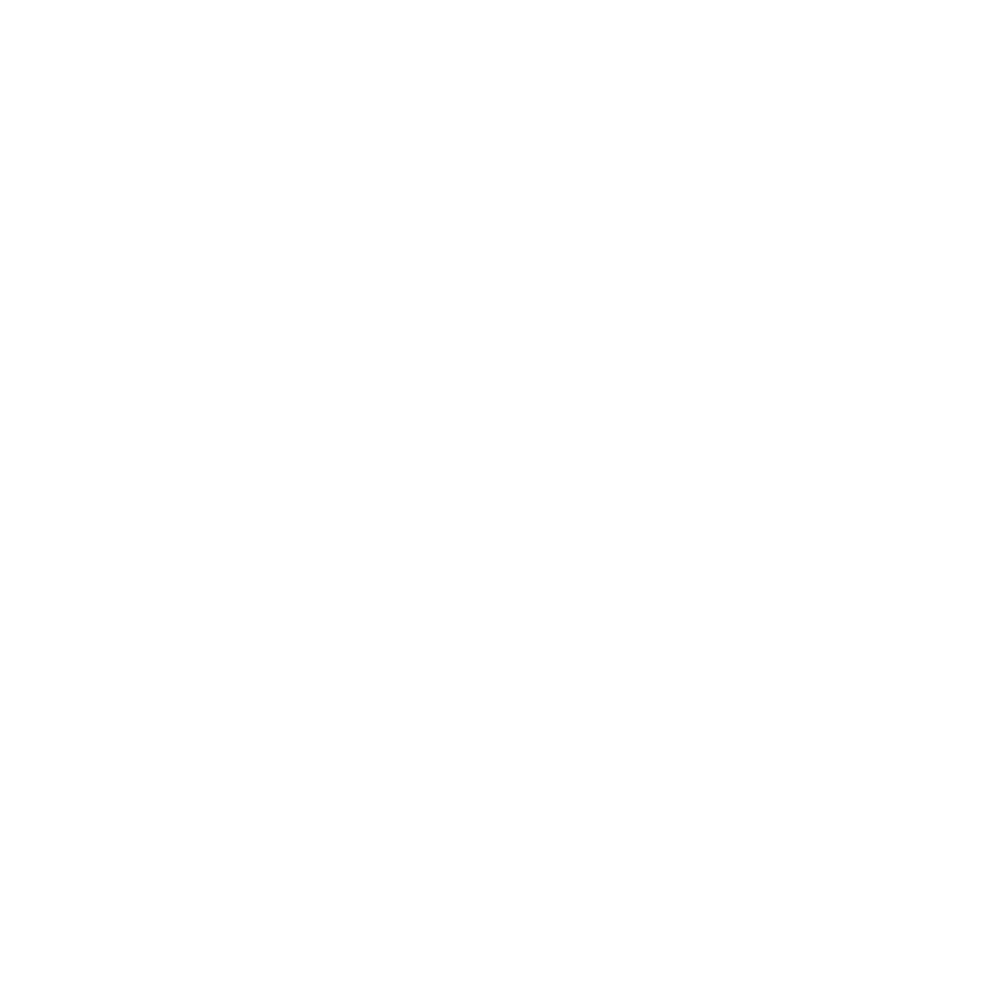

<IPython.core.display.Javascript object>


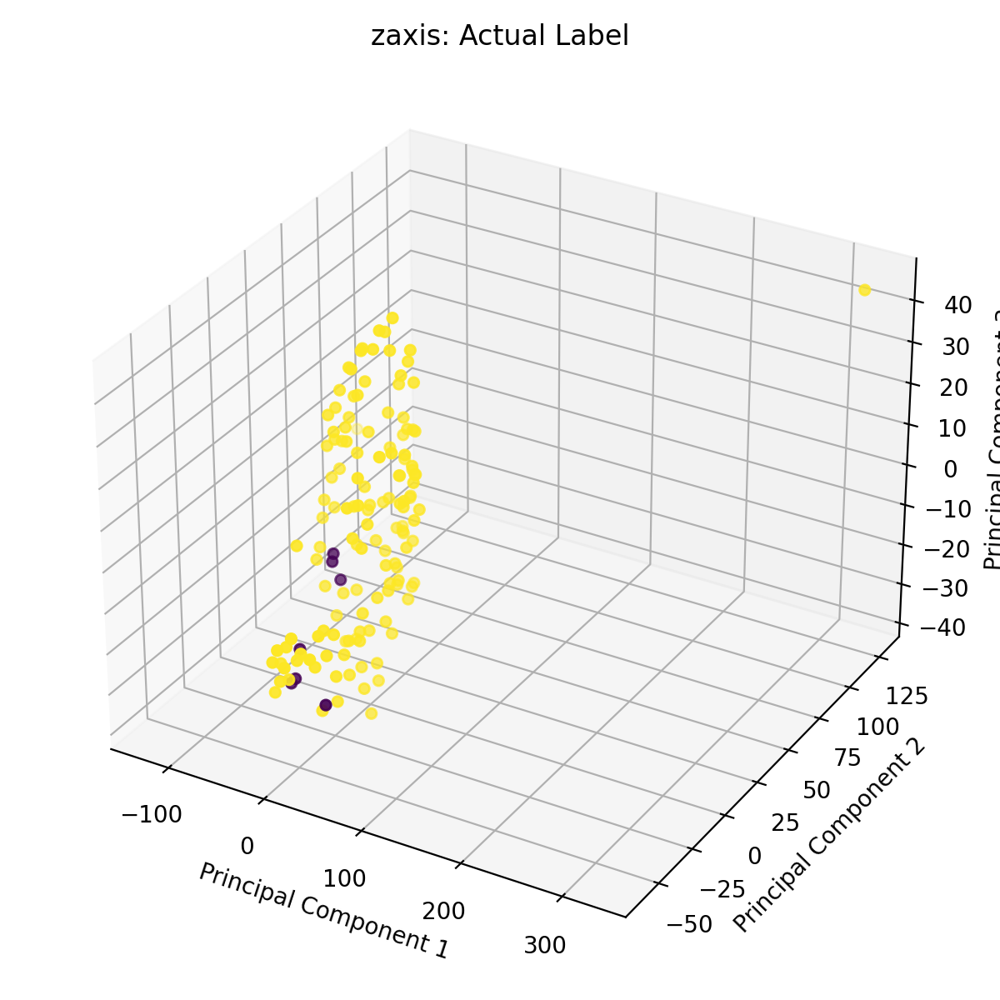




zaxis: OP02


<IPython.core.display.Javascript object>


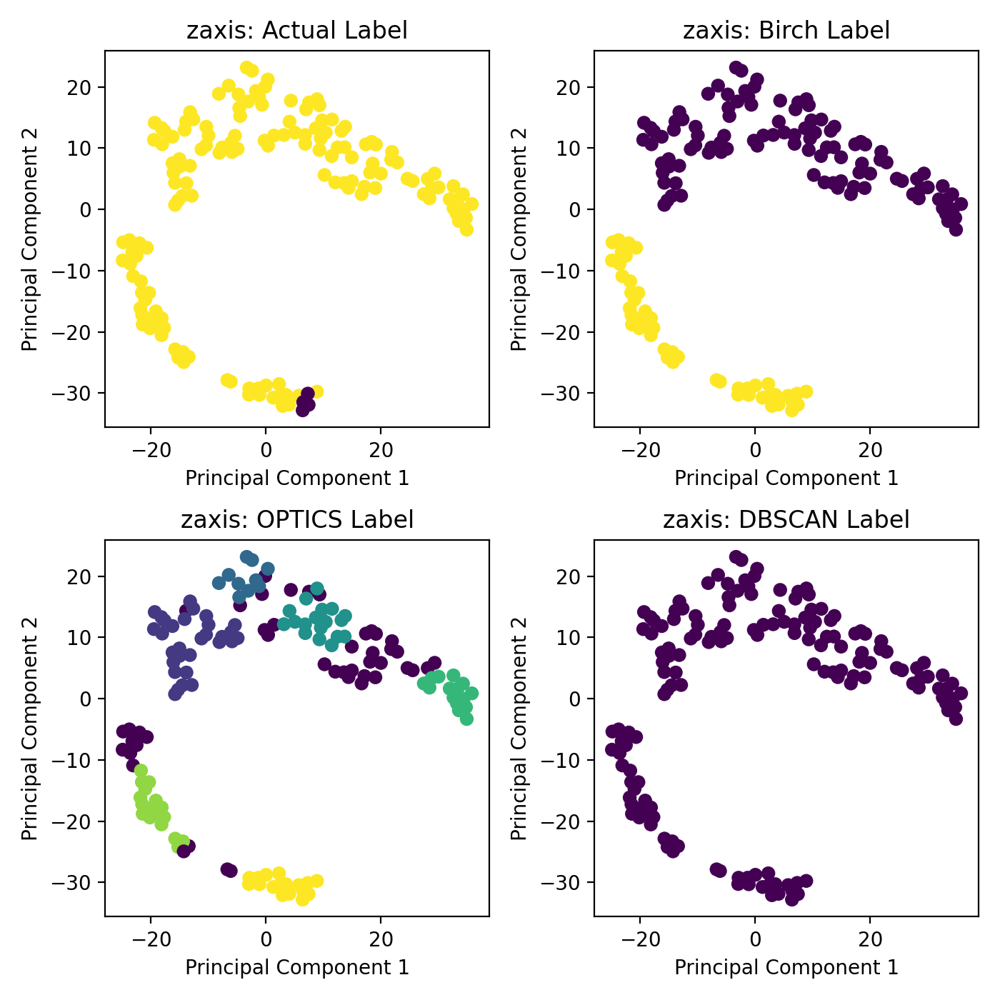

<IPython.core.display.Javascript object>


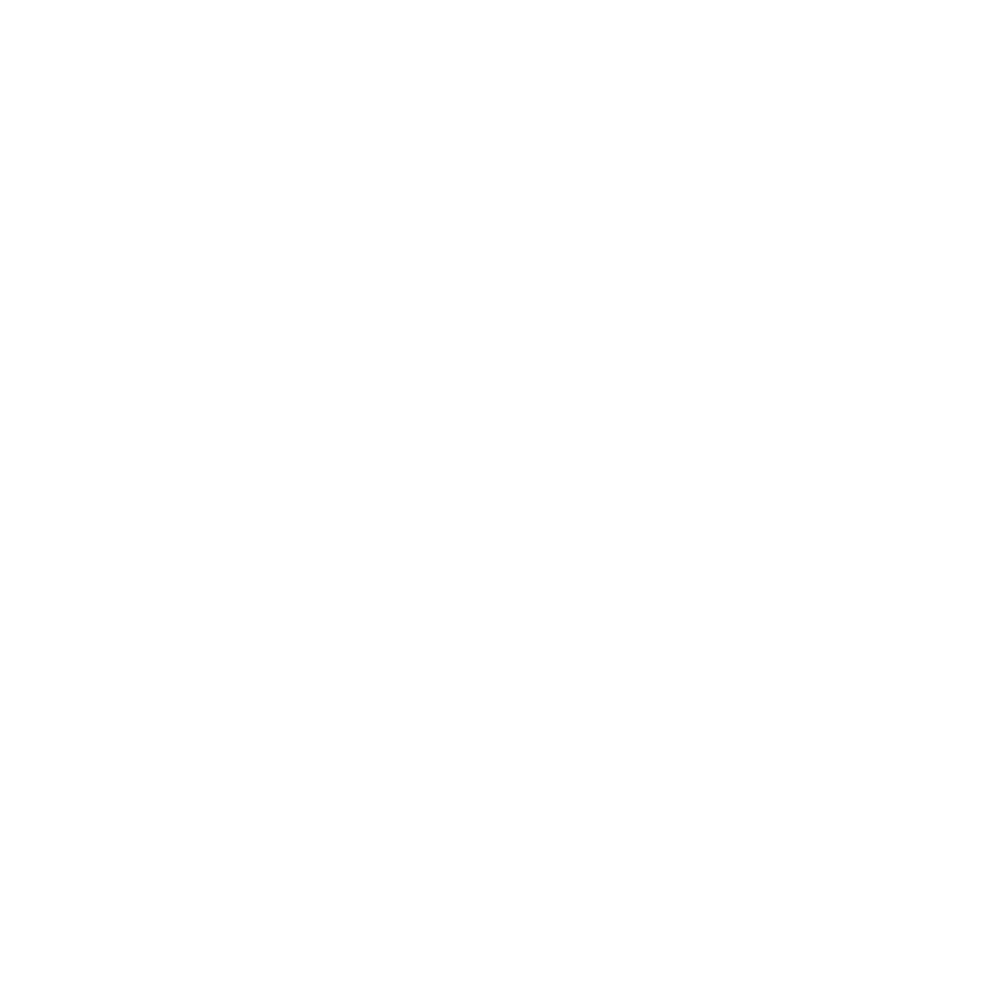




zaxis: OP03


<IPython.core.display.Javascript object>


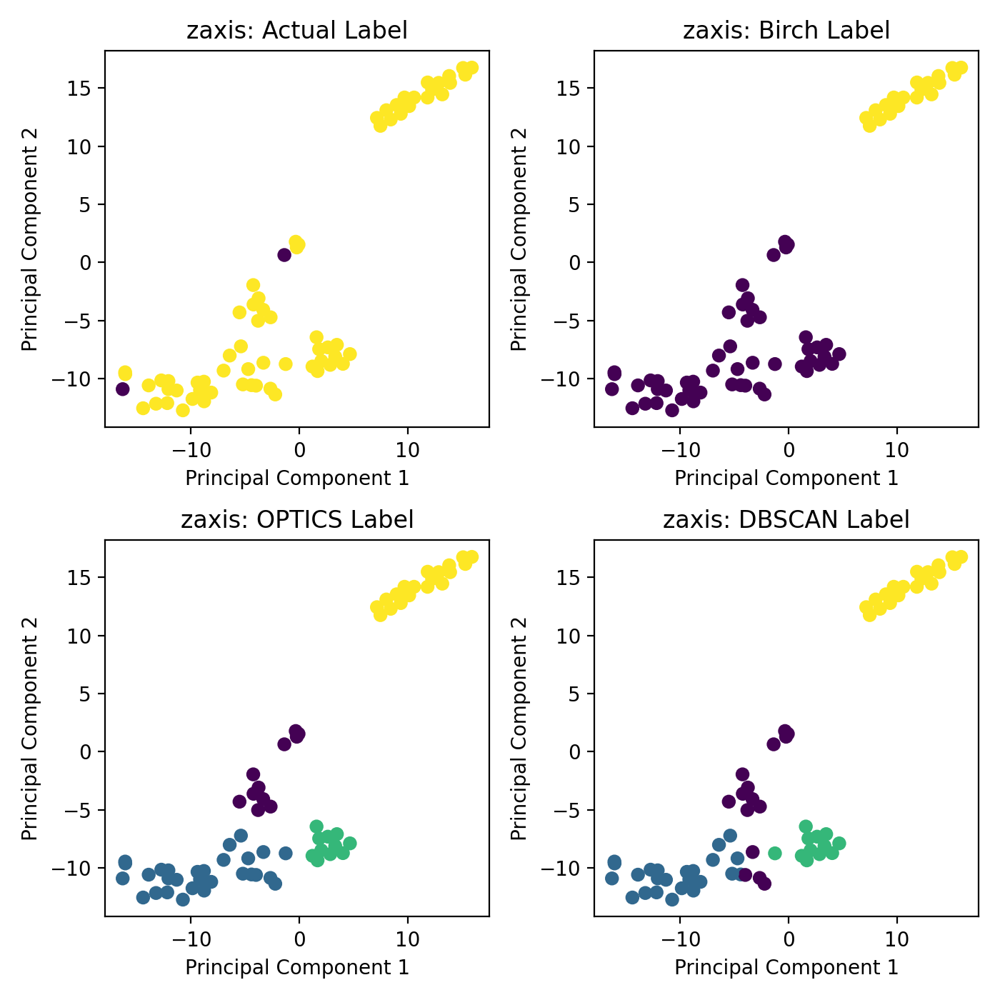

<IPython.core.display.Javascript object>


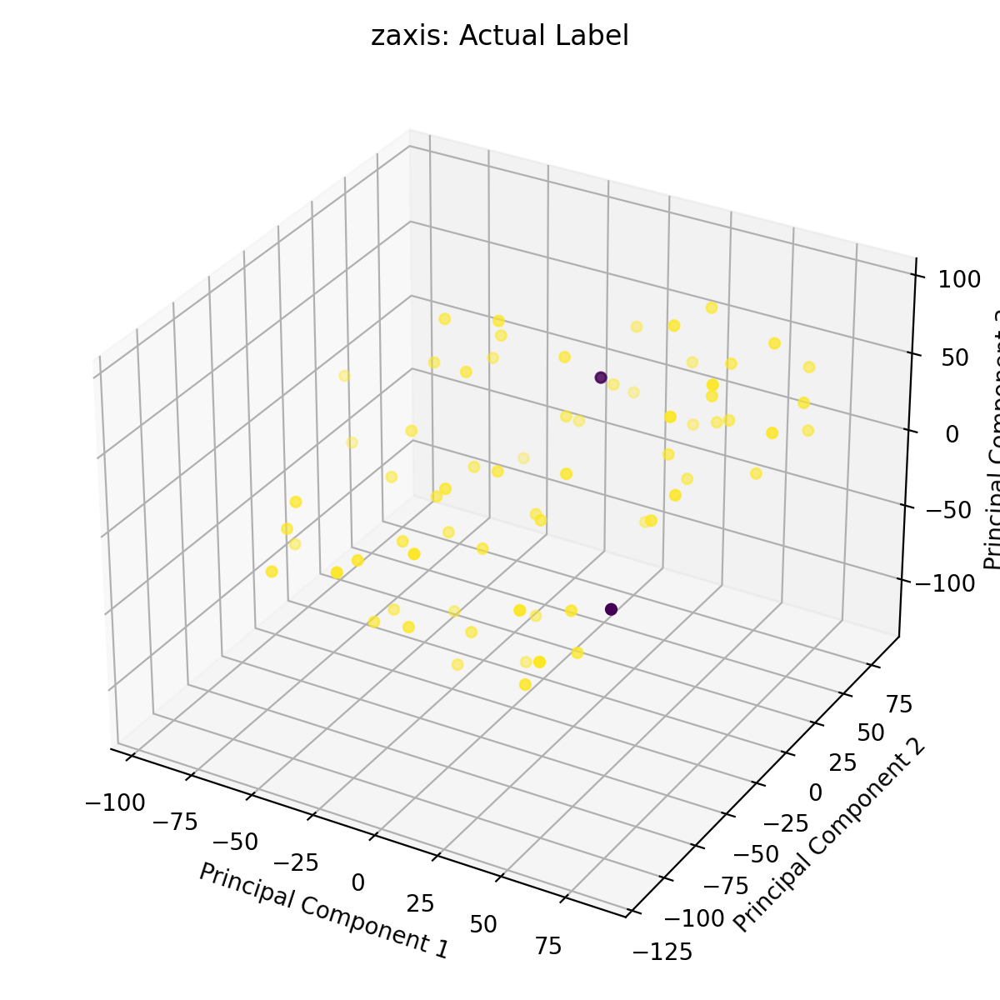




zaxis: OP04


<IPython.core.display.Javascript object>


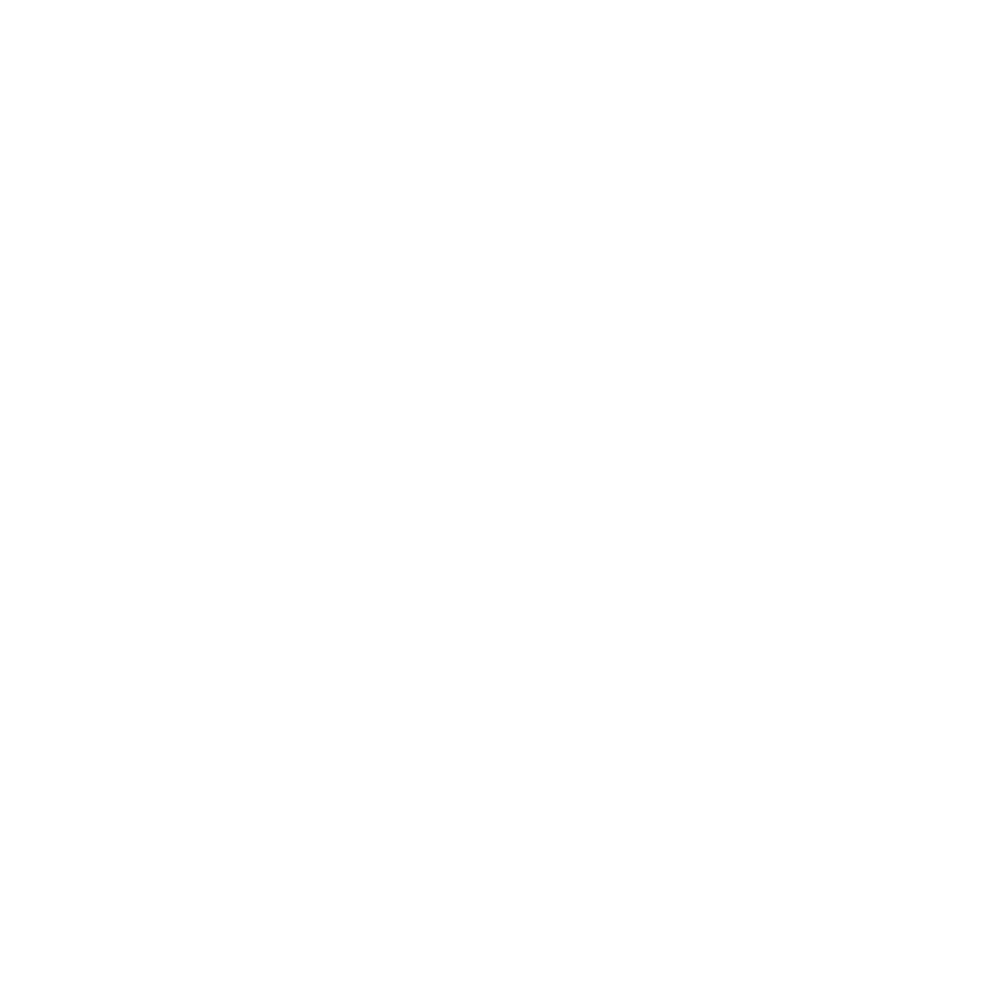

<IPython.core.display.Javascript object>


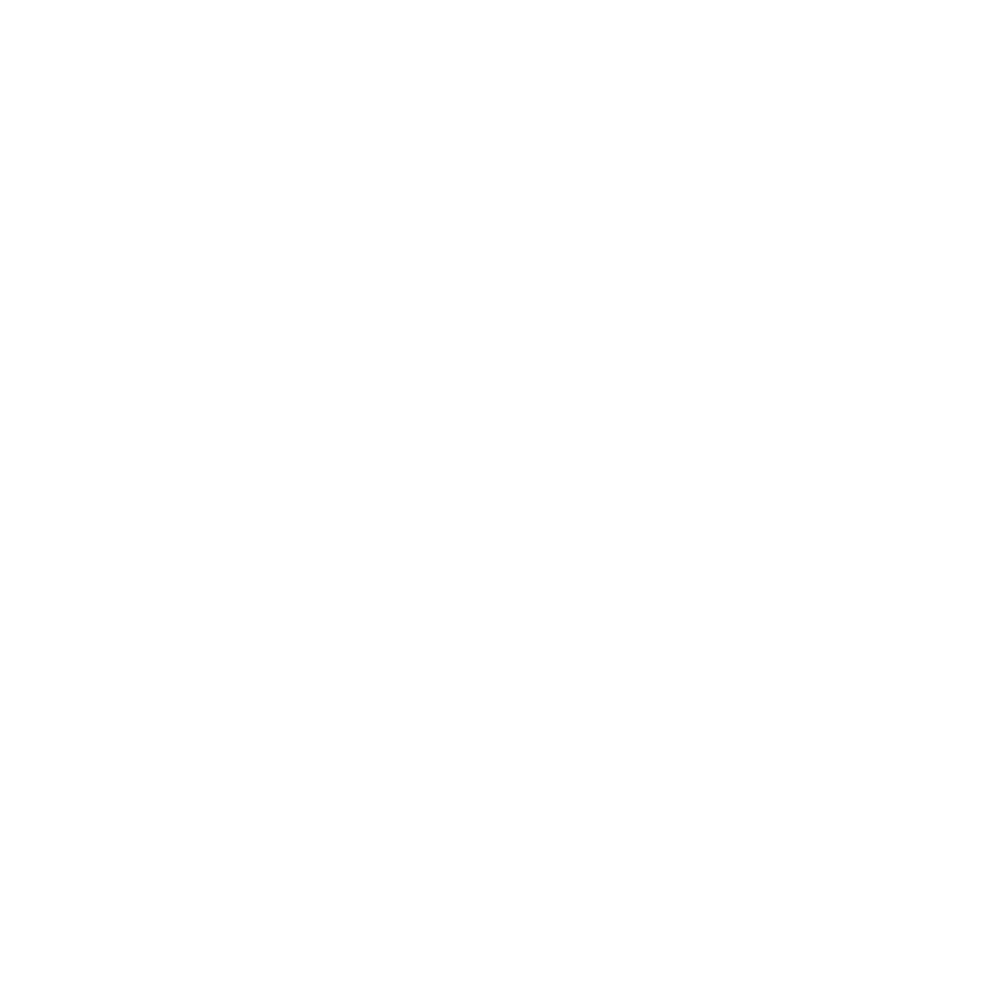




zaxis: OP05


<IPython.core.display.Javascript object>


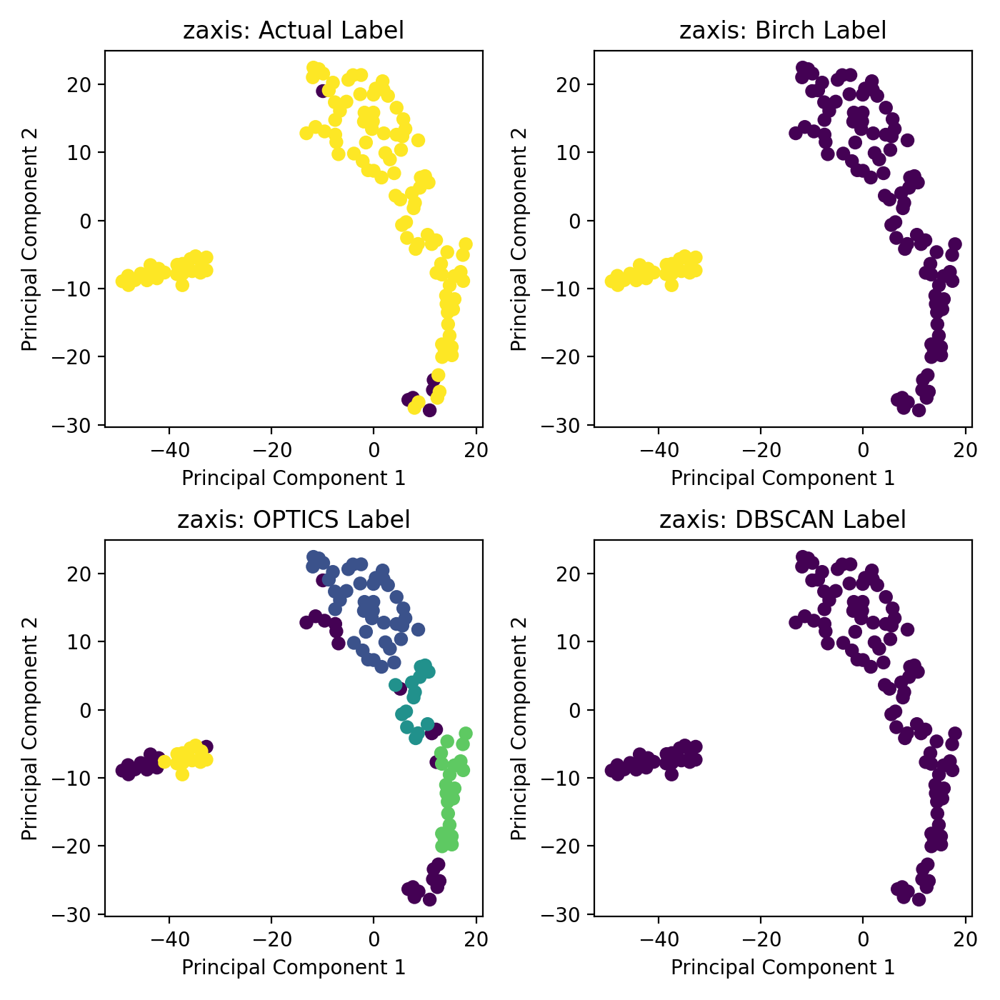

<IPython.core.display.Javascript object>


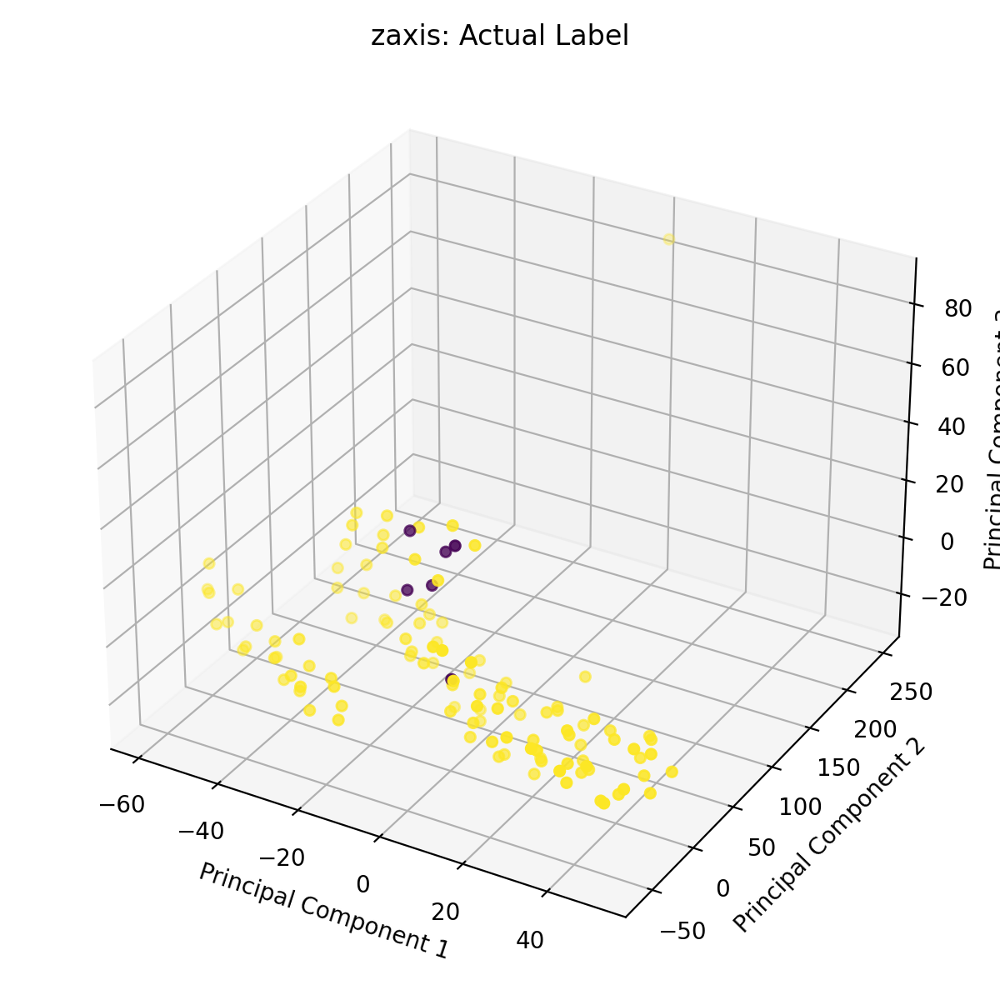




zaxis: OP06


<IPython.core.display.Javascript object>


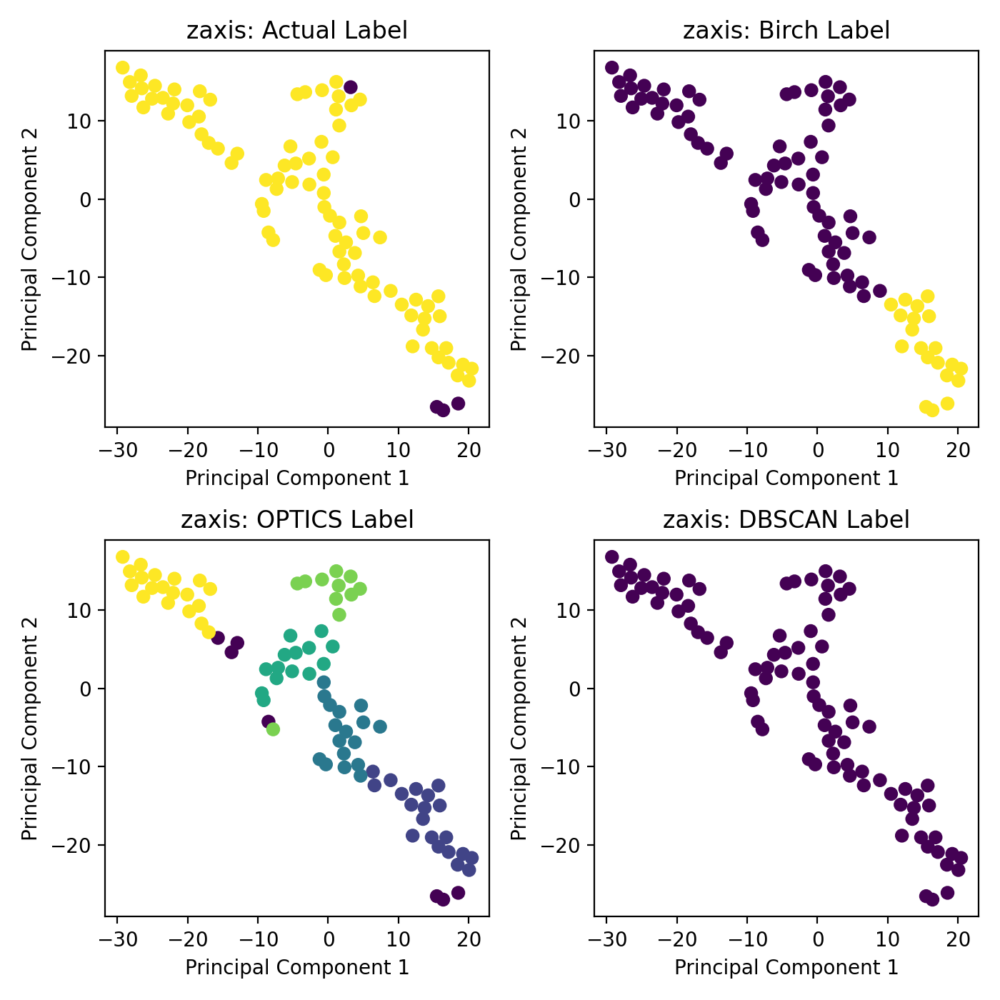

<IPython.core.display.Javascript object>


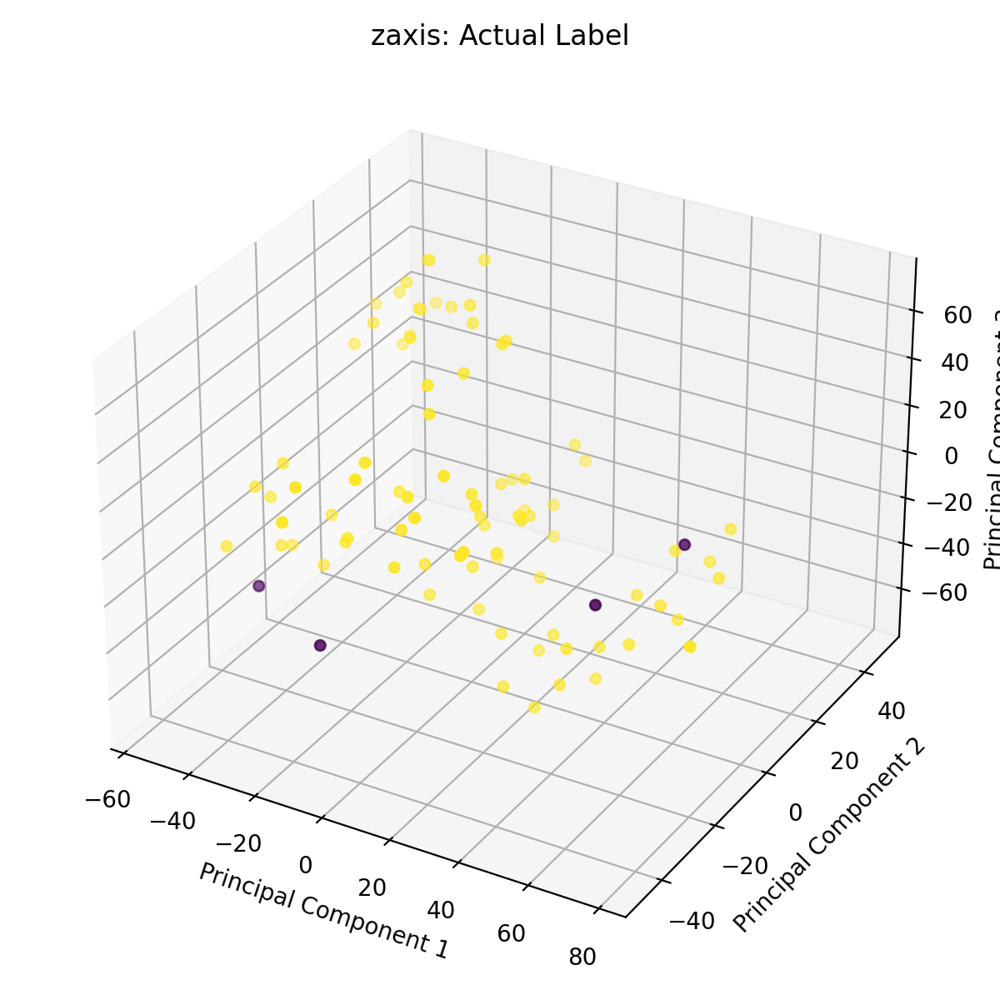




zaxis: OP07


<IPython.core.display.Javascript object>


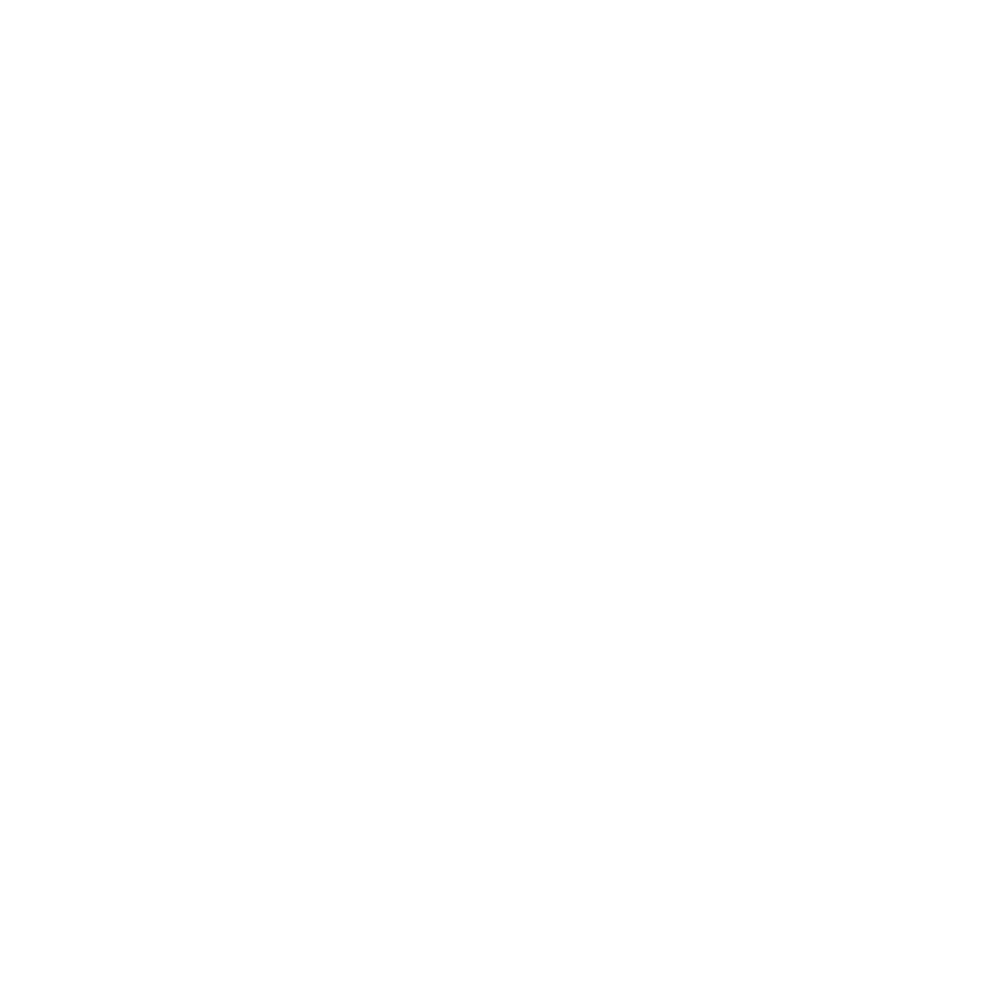

<IPython.core.display.Javascript object>


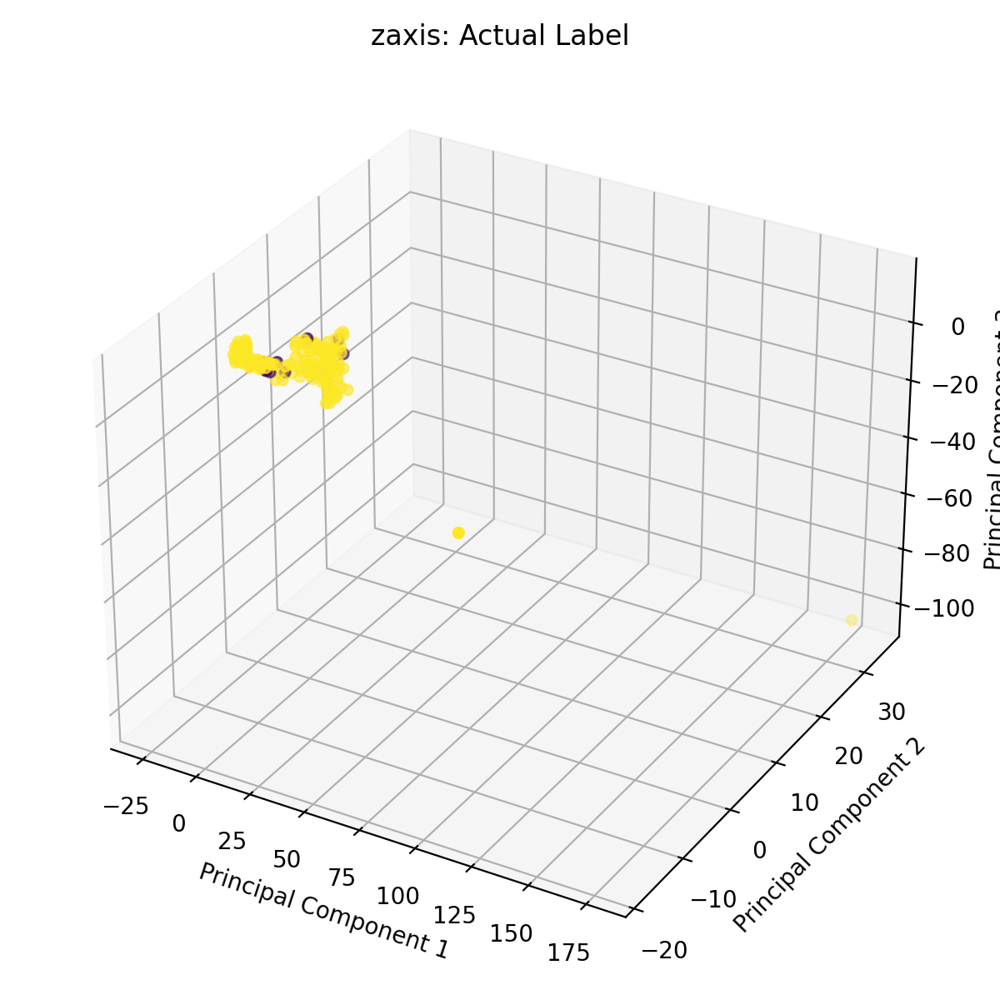




zaxis: OP08


<IPython.core.display.Javascript object>


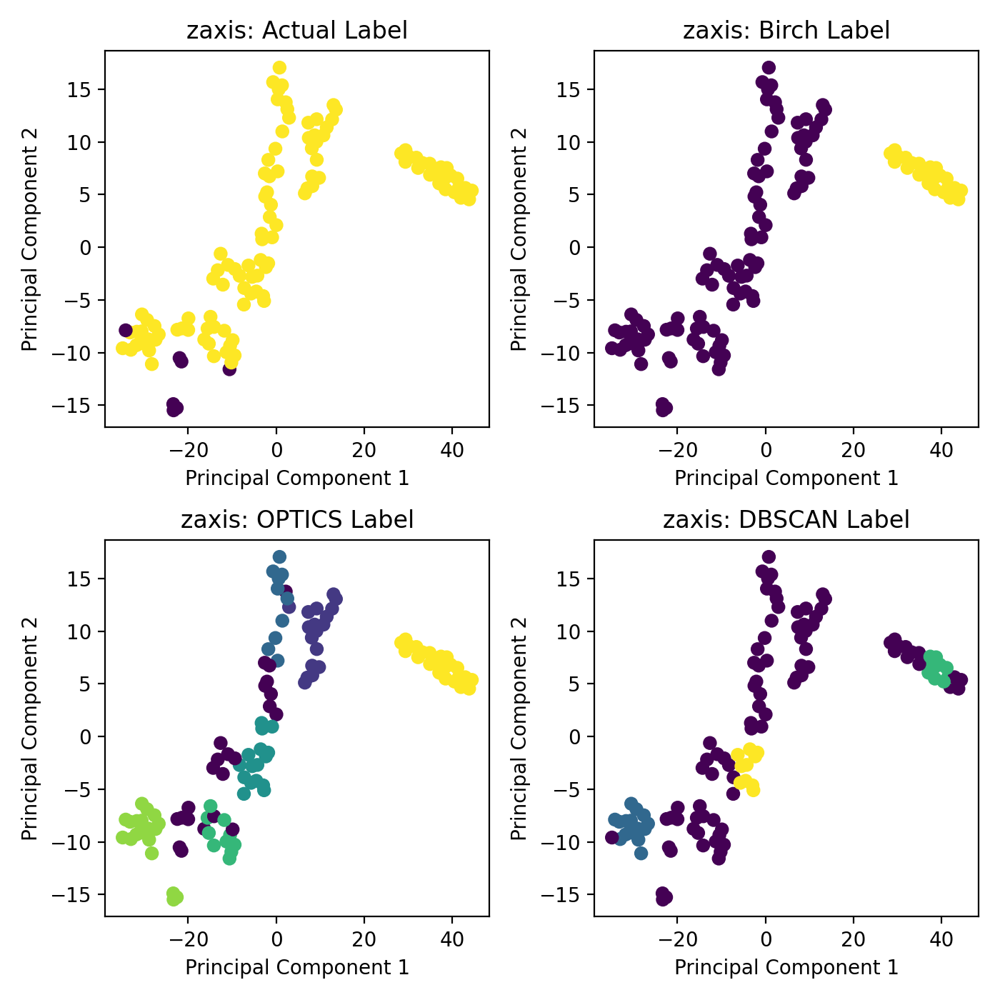

<IPython.core.display.Javascript object>


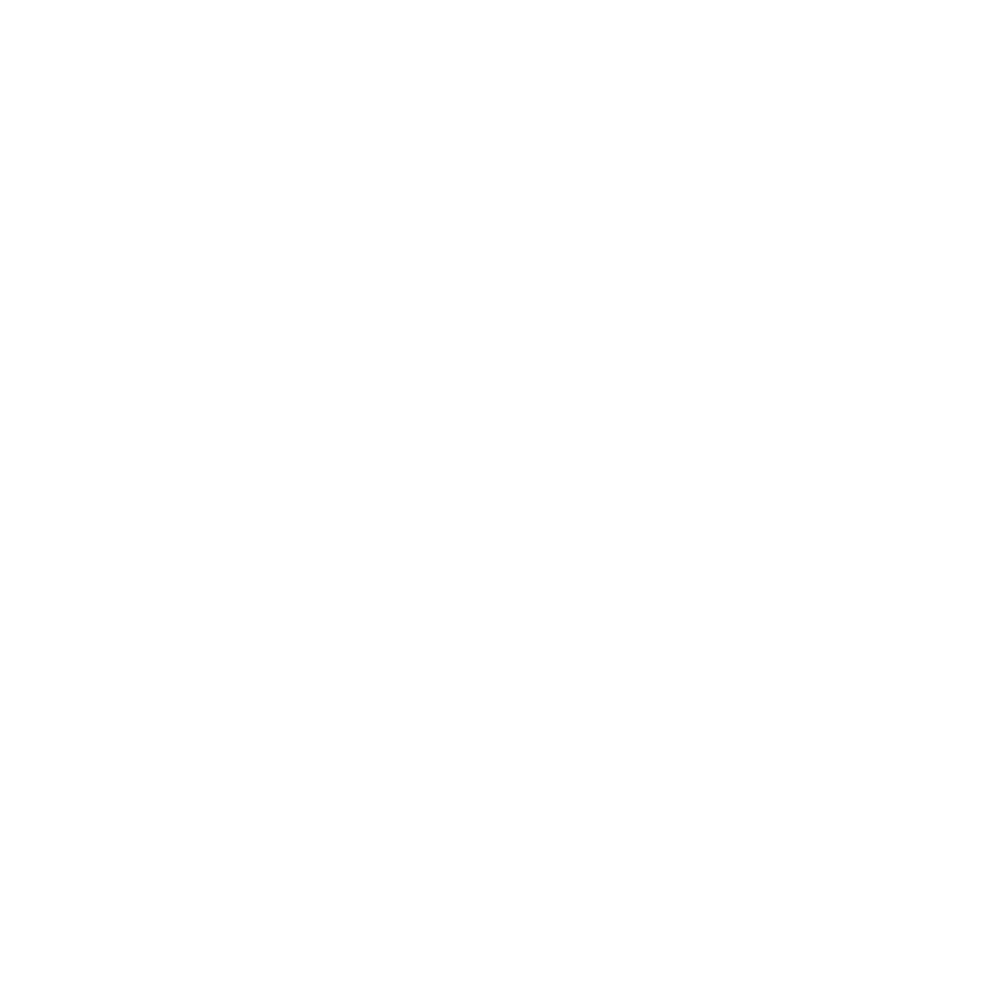




zaxis: OP09


<IPython.core.display.Javascript object>


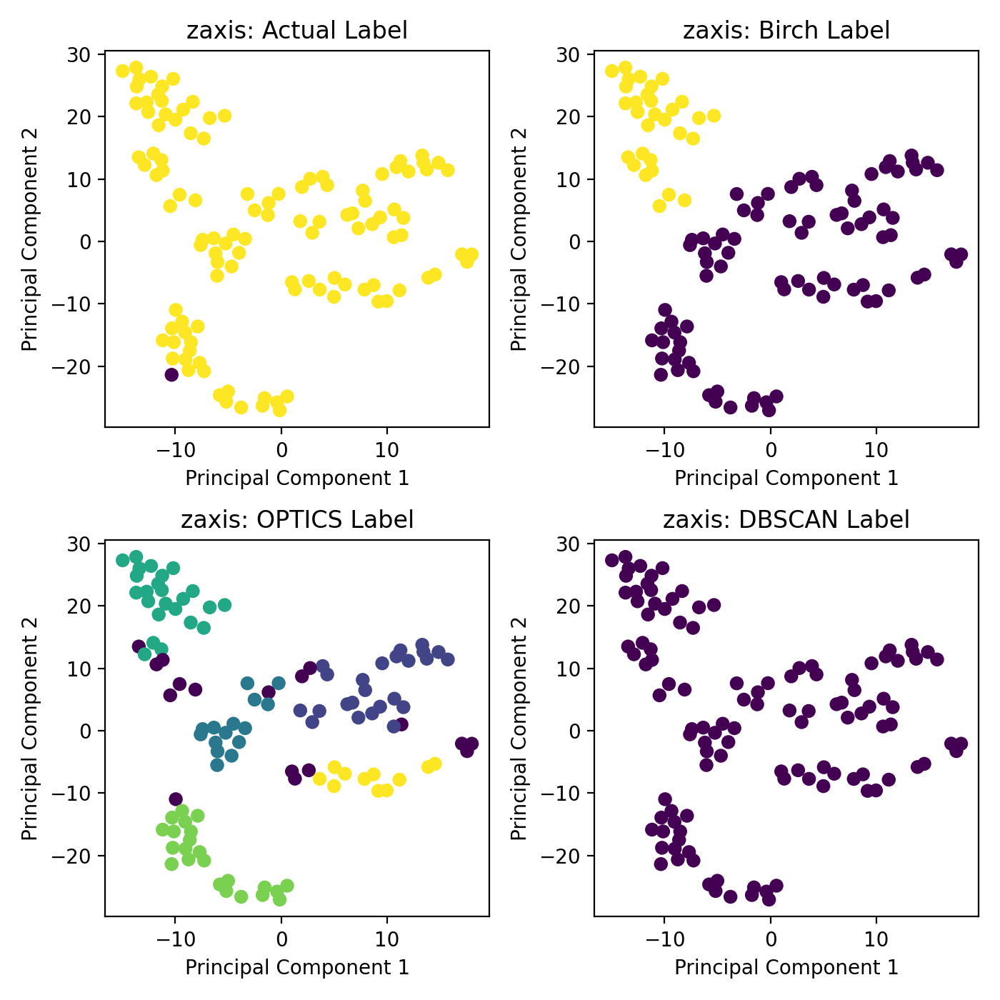

<IPython.core.display.Javascript object>


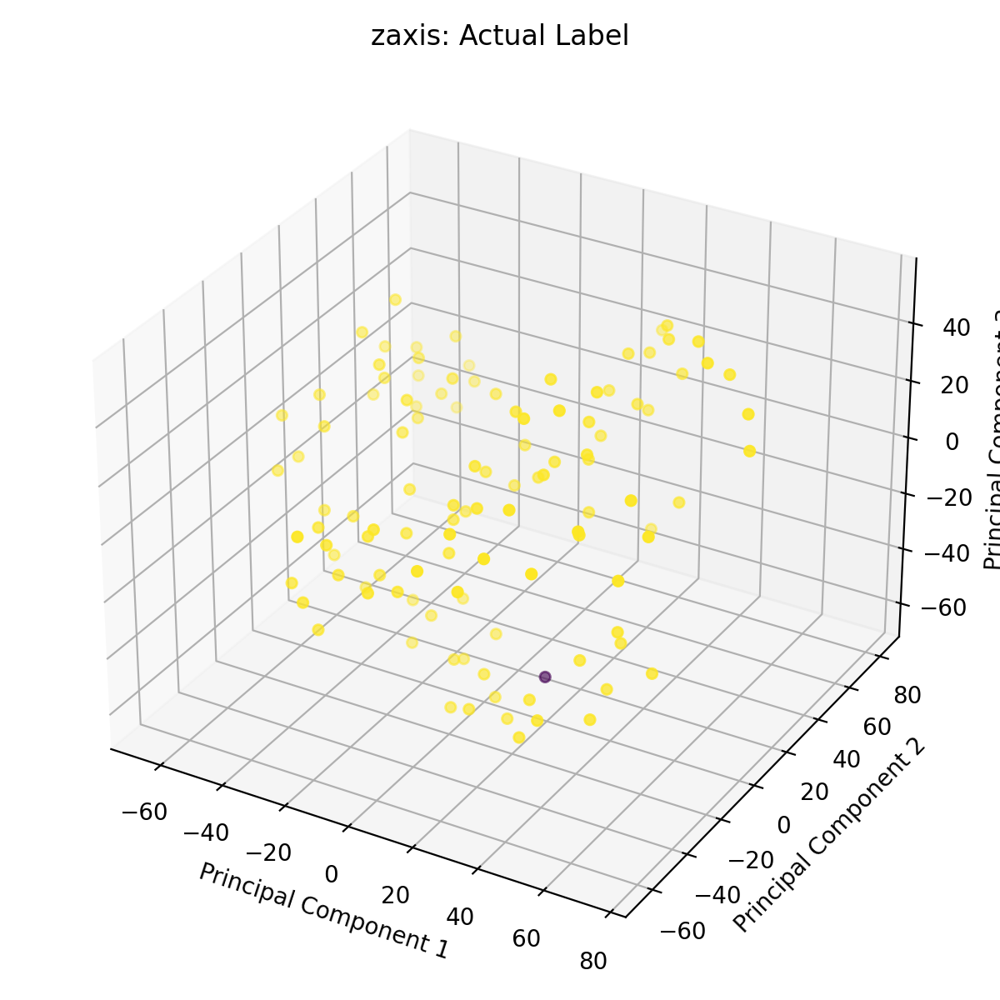




zaxis: OP10


<IPython.core.display.Javascript object>


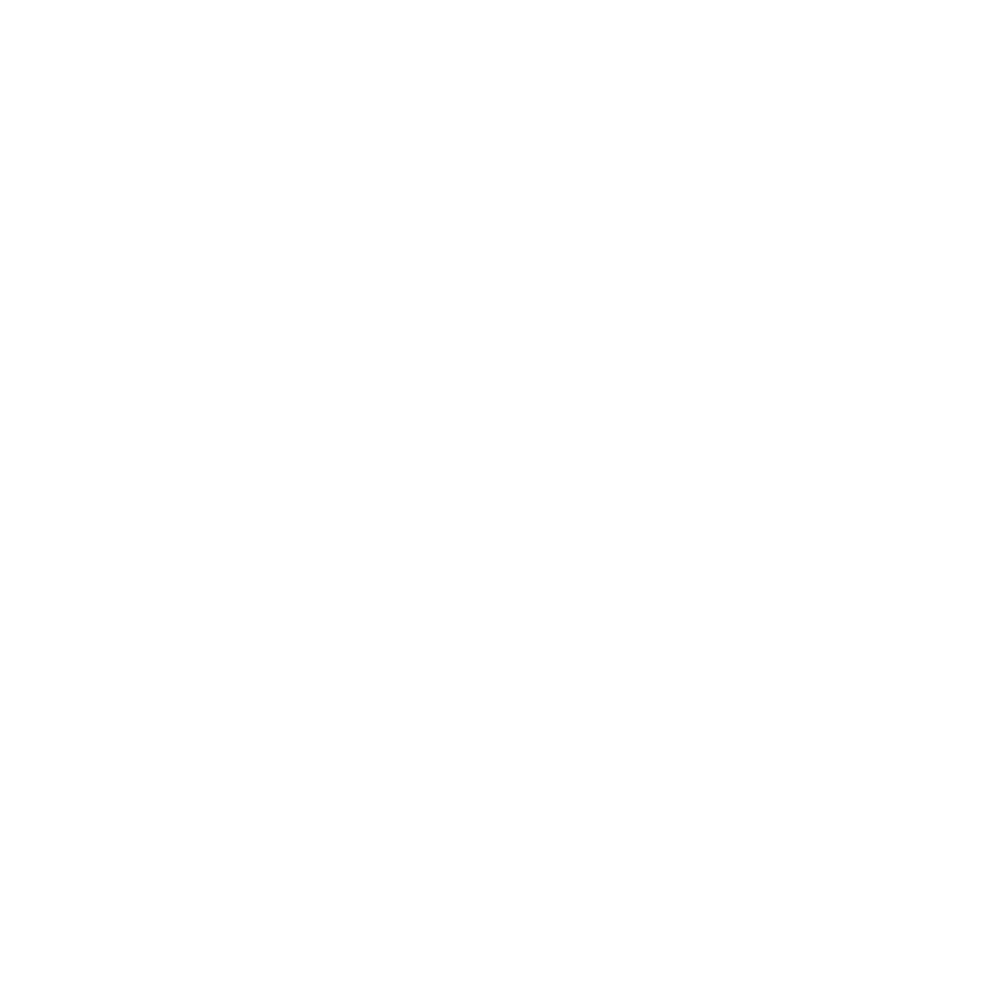

<IPython.core.display.Javascript object>


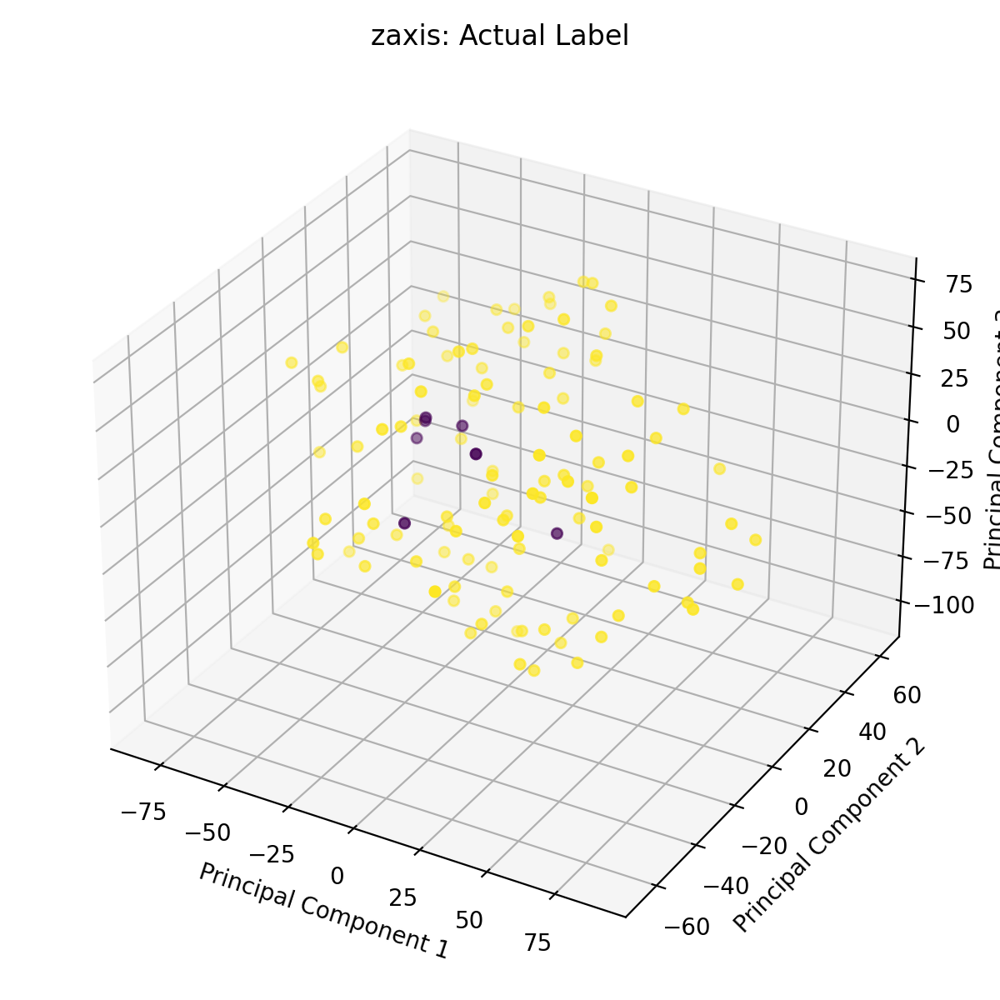




zaxis: OP11


<IPython.core.display.Javascript object>


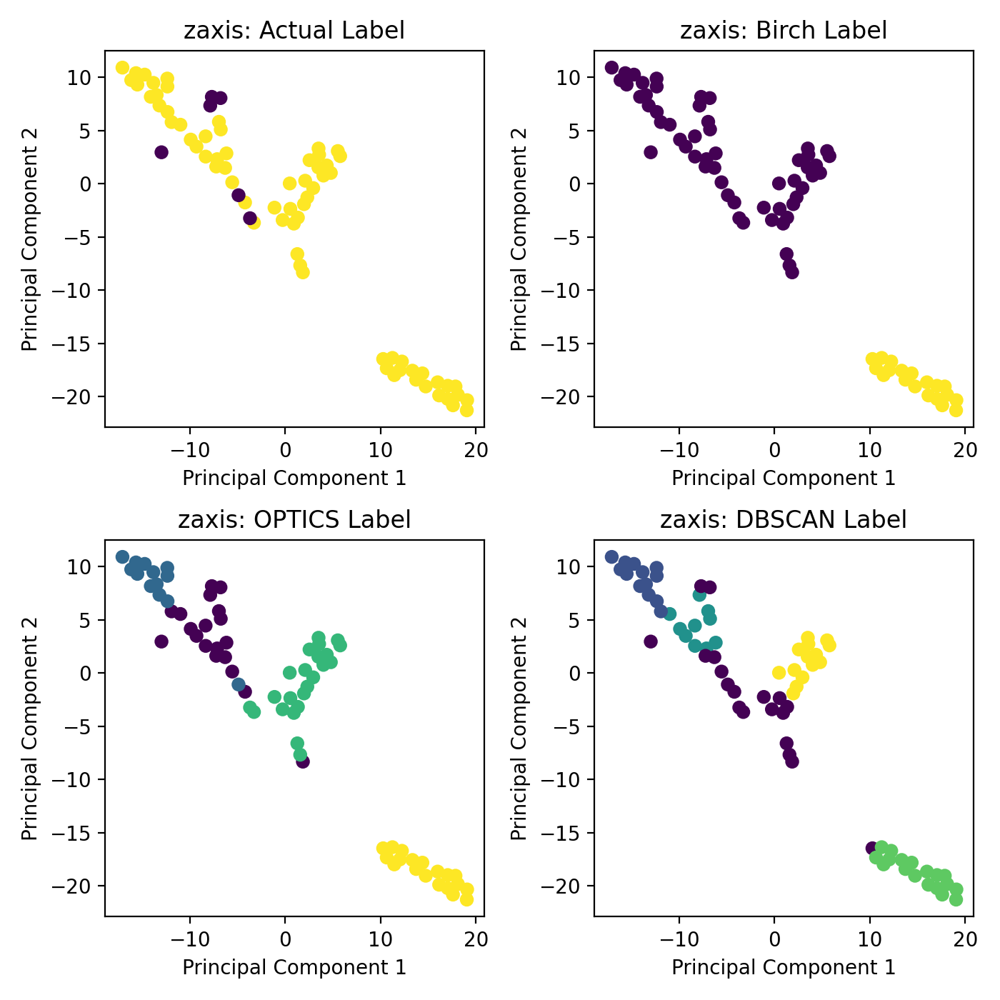

<IPython.core.display.Javascript object>


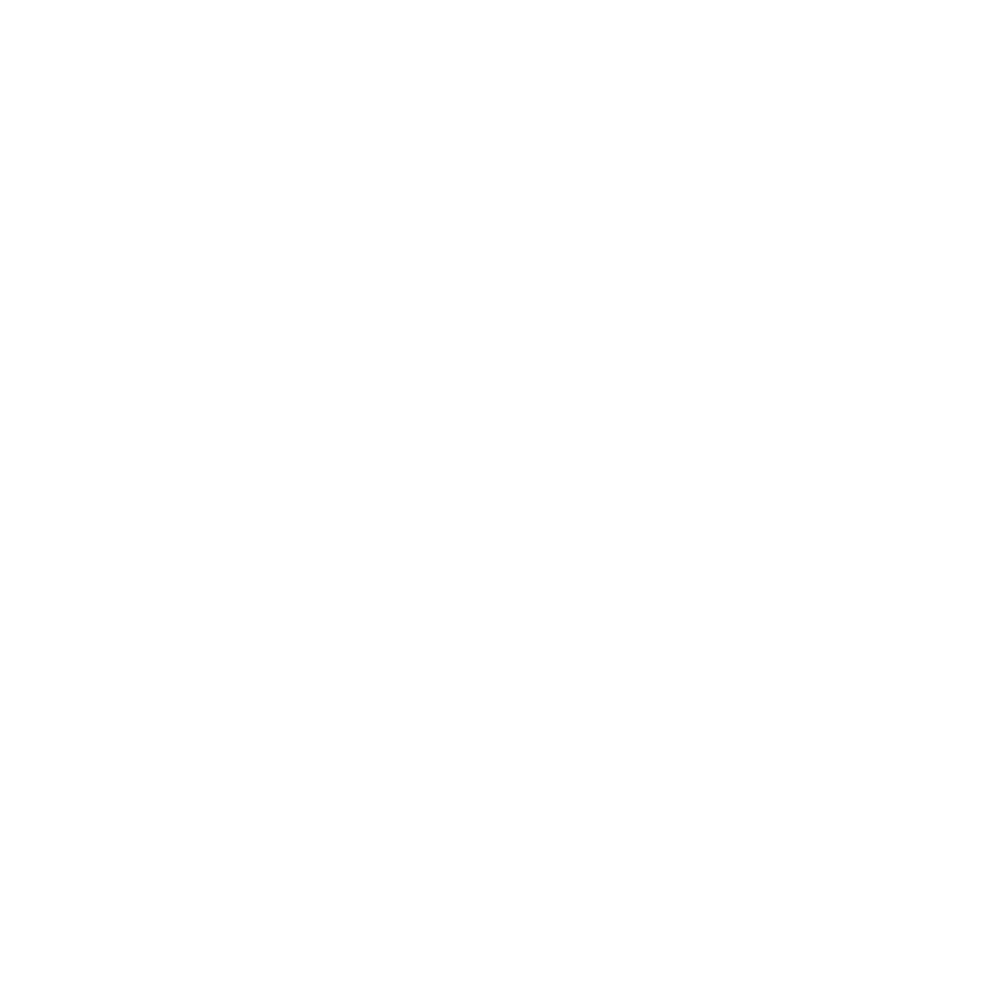




zaxis: OP12


<IPython.core.display.Javascript object>


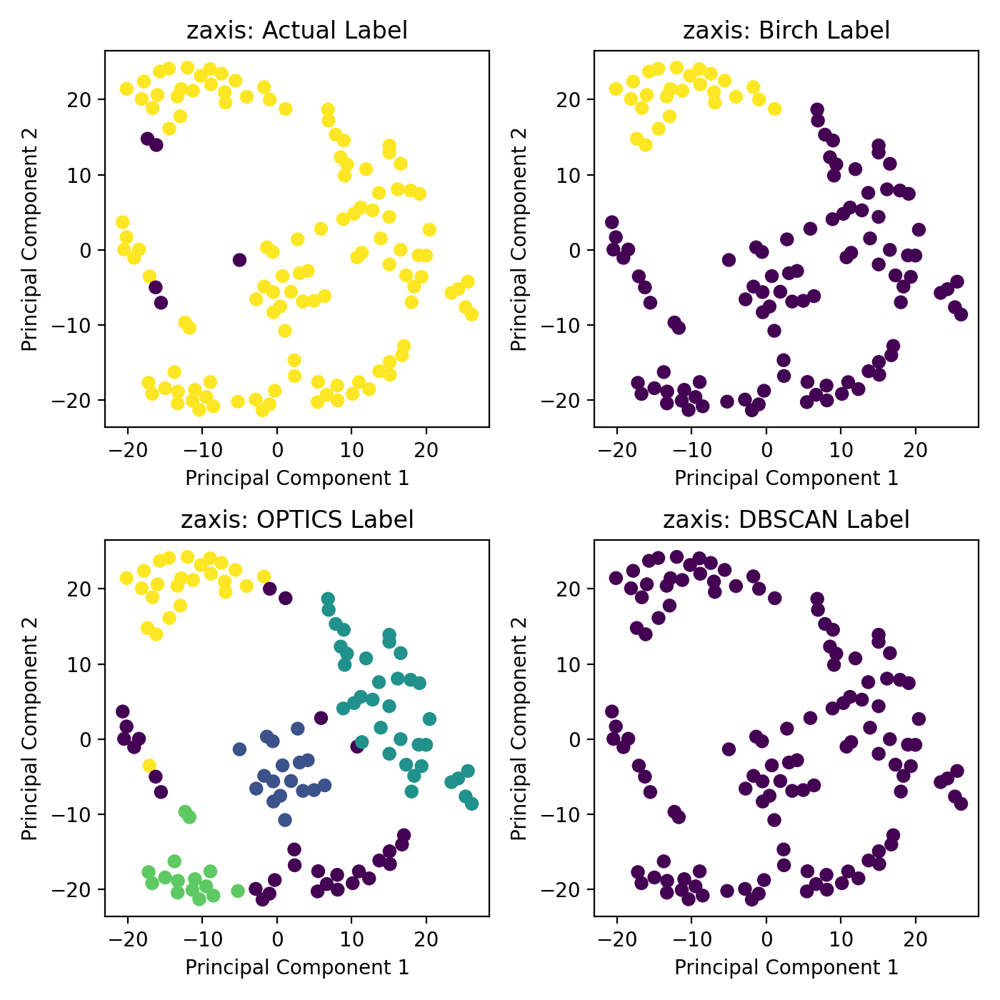

<IPython.core.display.Javascript object>


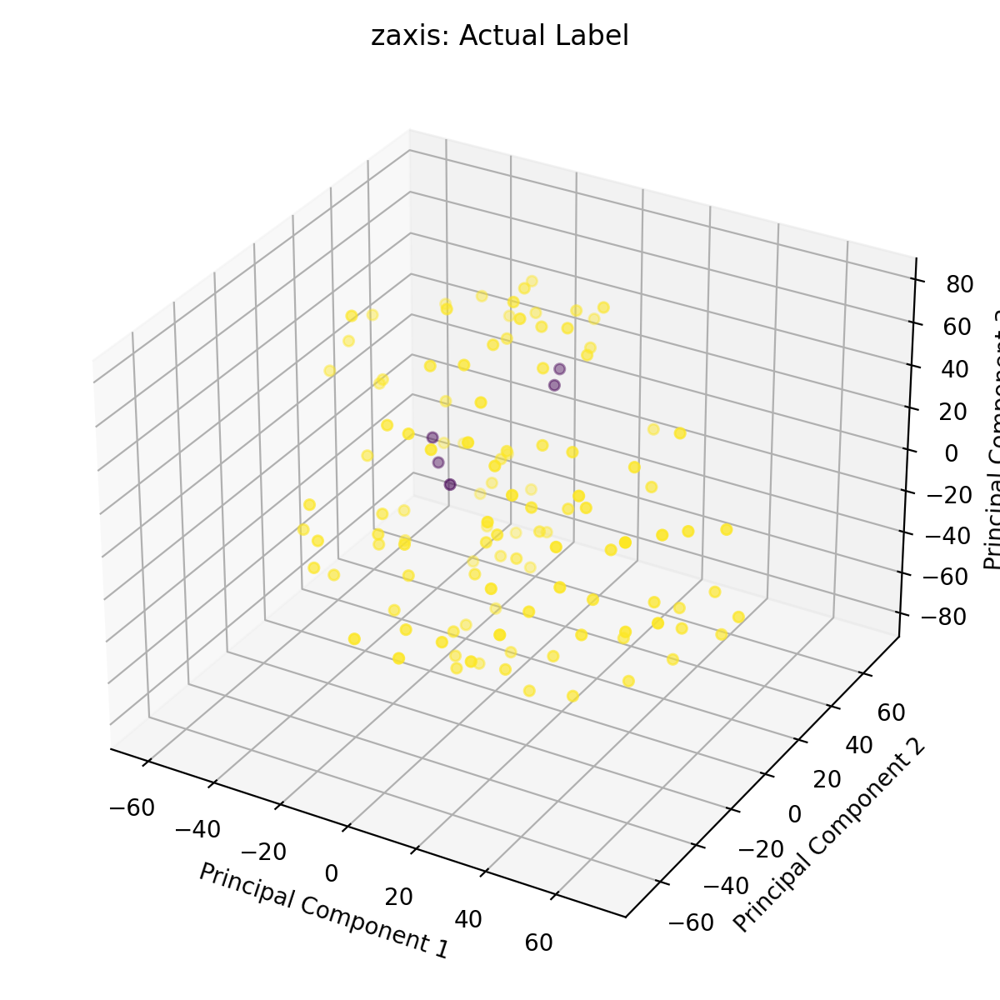




zaxis: OP13


<IPython.core.display.Javascript object>


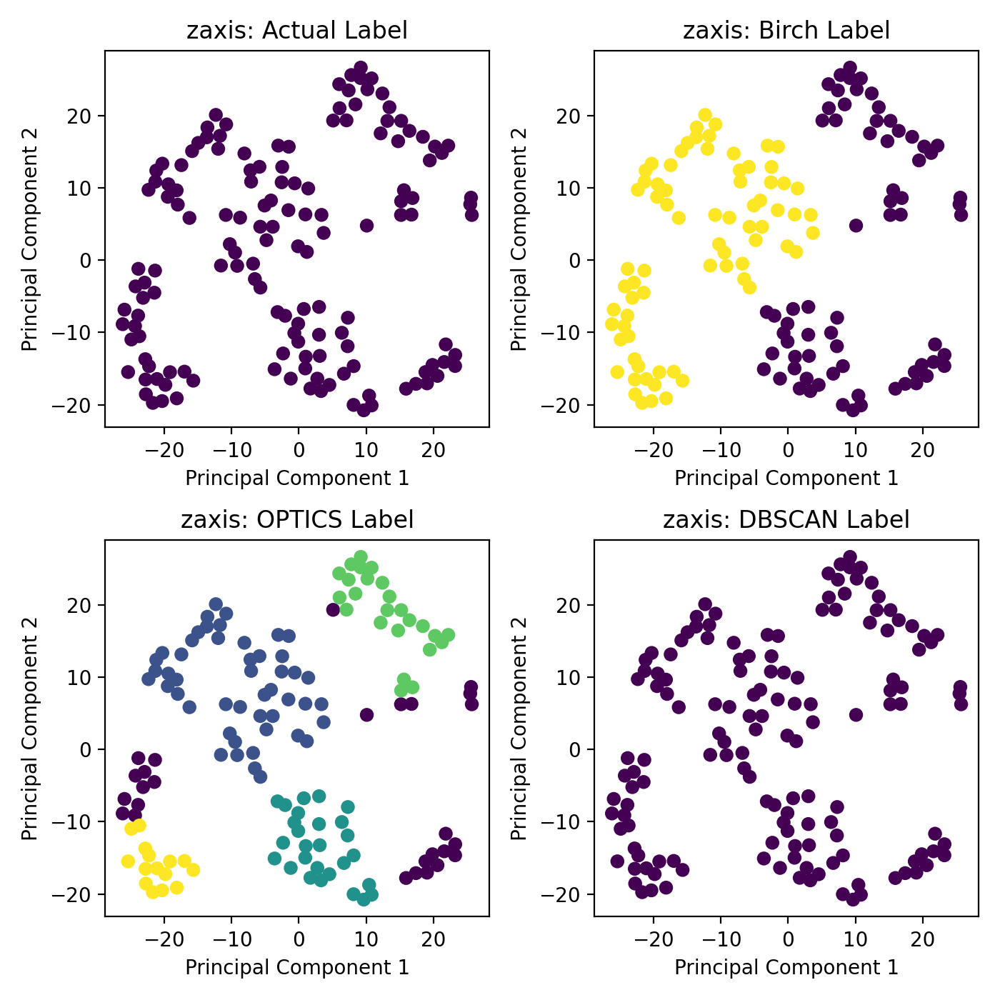

<IPython.core.display.Javascript object>


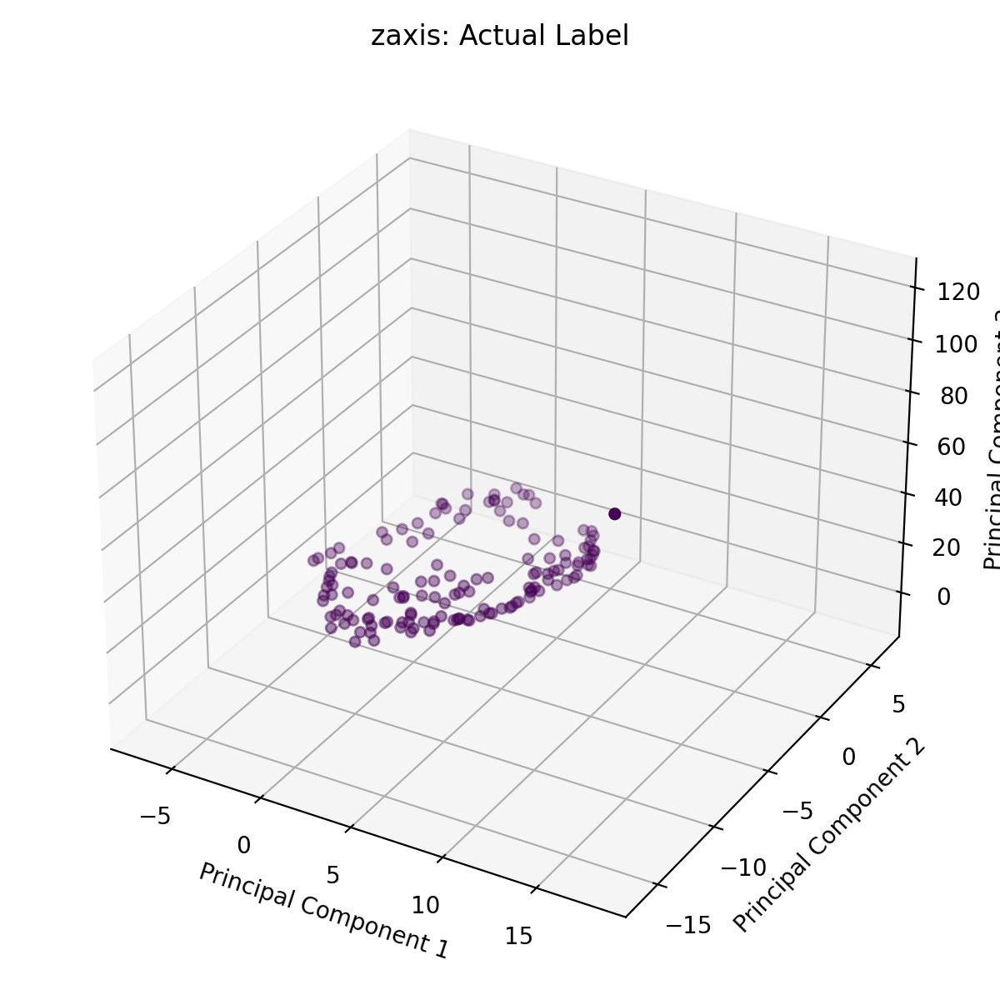




zaxis: OP14


<IPython.core.display.Javascript object>


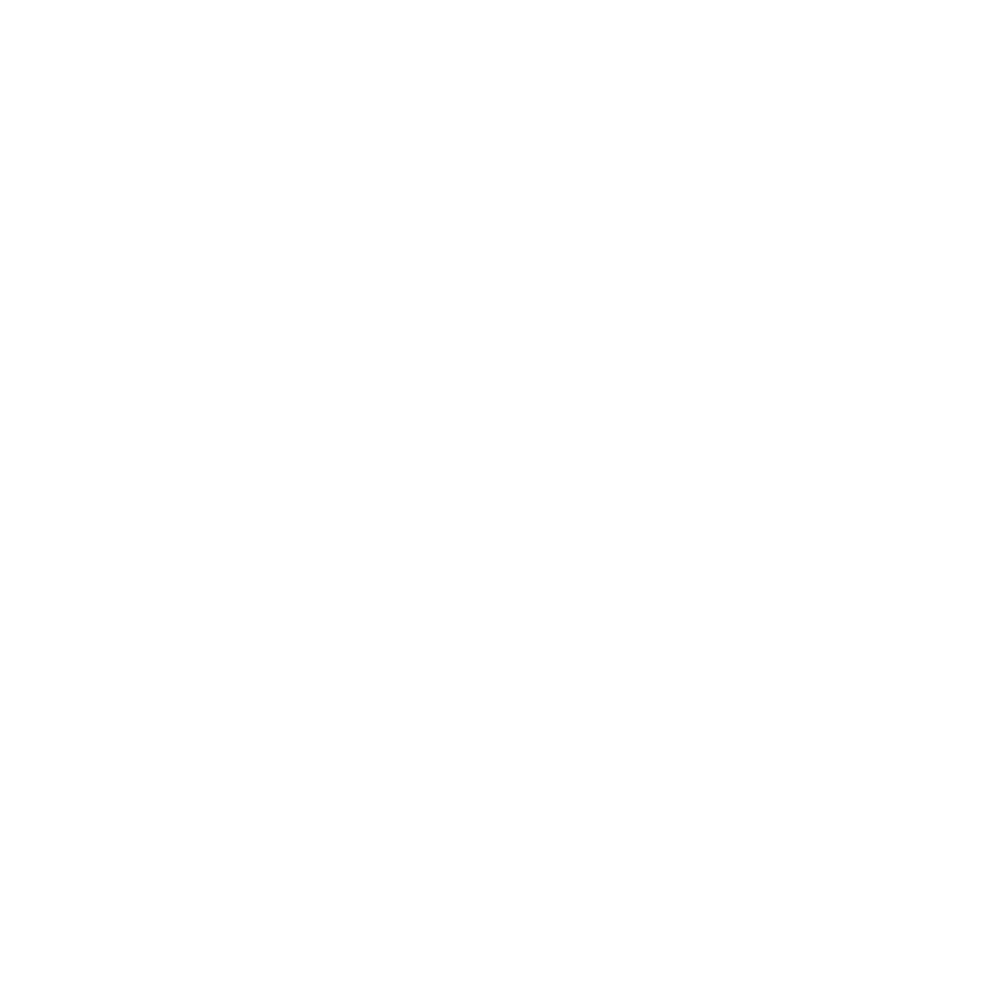

<IPython.core.display.Javascript object>


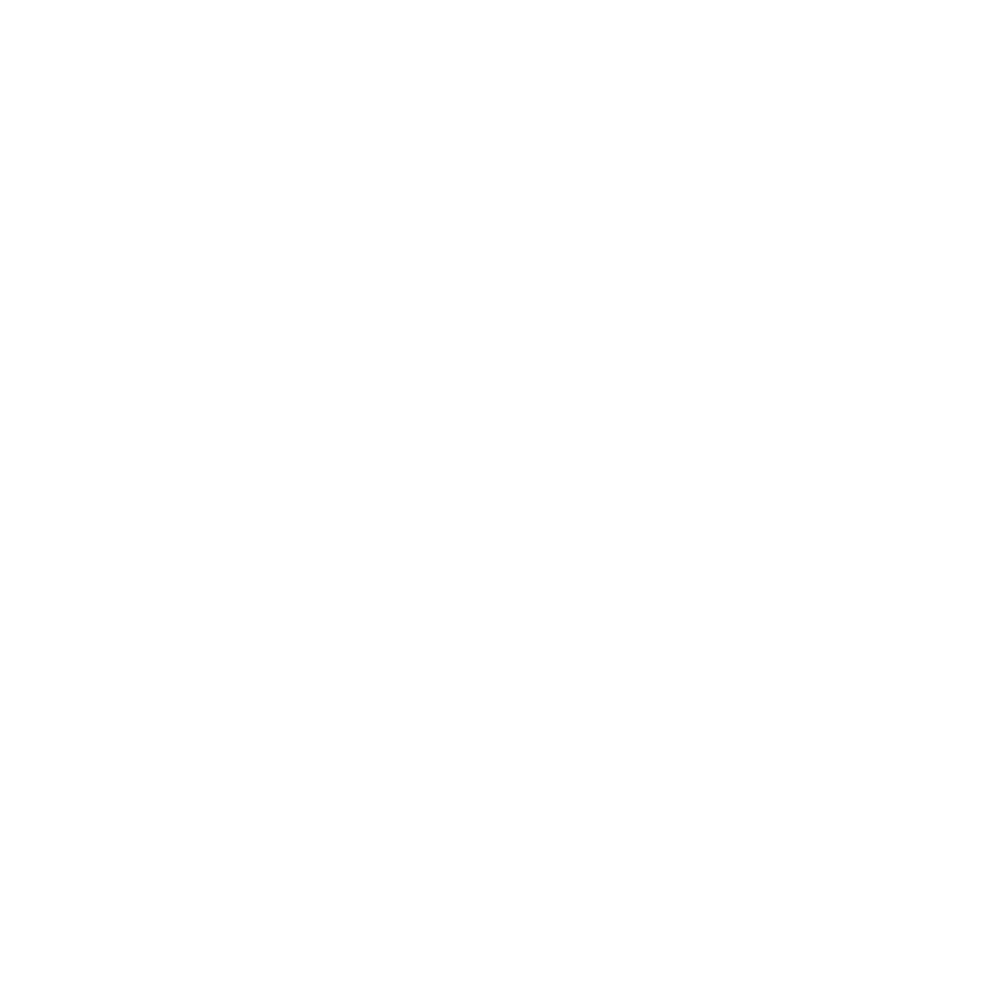

In [12]:
master_file  = "./file_list.log"    
axis_names   = ['xaxis', 'yaxis', 'zaxis']

axis_df_list    = []
process_df_list = []

process_list      = []
dist_process_list = []

for i, axis_name in enumerate(axis_names):
    filename    = "final_df_"+axis_name+"_process.h5"
    axis_df_list += [data_processing(master_file, axis_name, filename, skip=1)]
    if int(len(process_list))==0:
        process_list += sorted(list(set(axis_df_list[-1].Process.to_list())))
    if int(len(process_list))!=0:
        for process in process_list:
            print("====================================================================================")
            print(f'{axis_name}: {process}')
            process_df_list += [axis_df_list[-1][axis_df_list[-1].Process==process]]
            dist_process_list += [get_euclidean_data(process_df_list[-1])]
            tsne_func(process_df_list[-1], dist_process_list[-1], axis_name, pc_count=2, perplexity=10)
            tsne_func(process_df_list[-1], dist_process_list[-1], axis_name, pc_count=3, perplexity=10)
            print("\n\n")

# [No Frequency Filtering] Clustering Plots per Axis per Drill Type

xaxis: Step_Drill


<IPython.core.display.Javascript object>


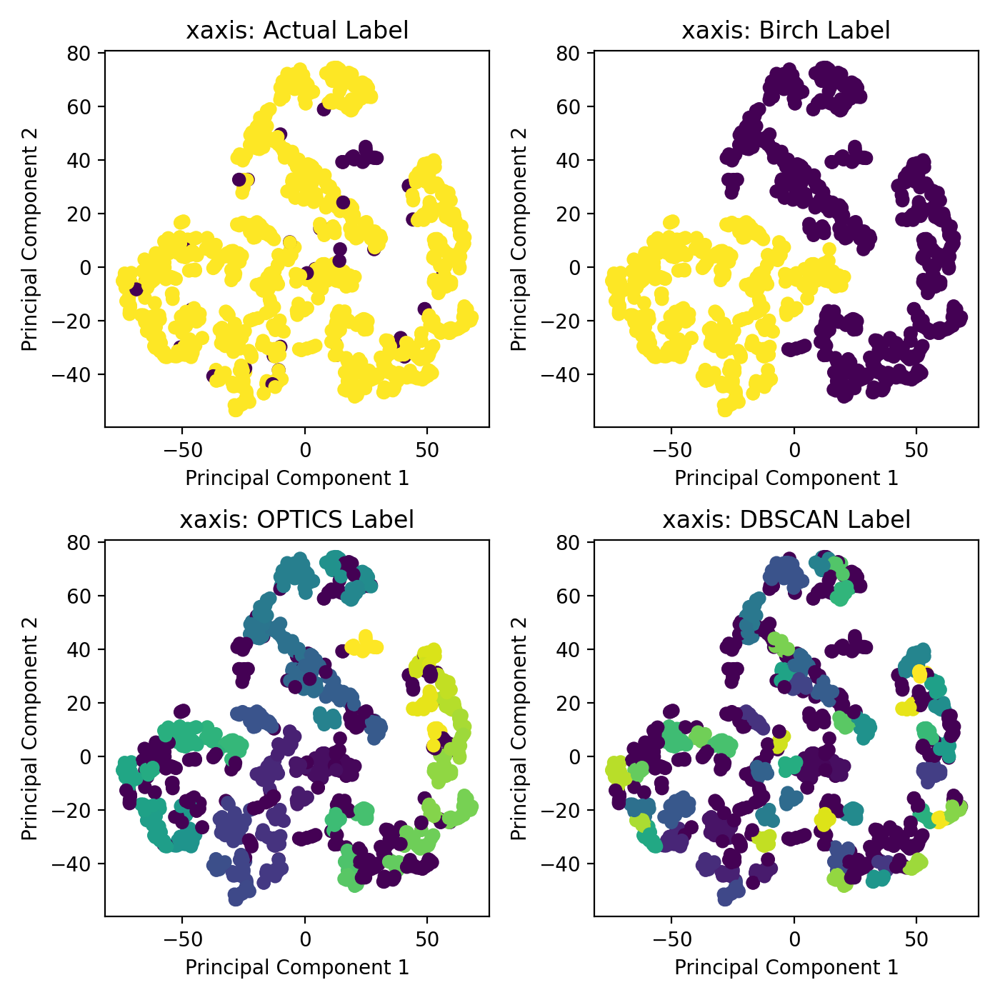

<IPython.core.display.Javascript object>


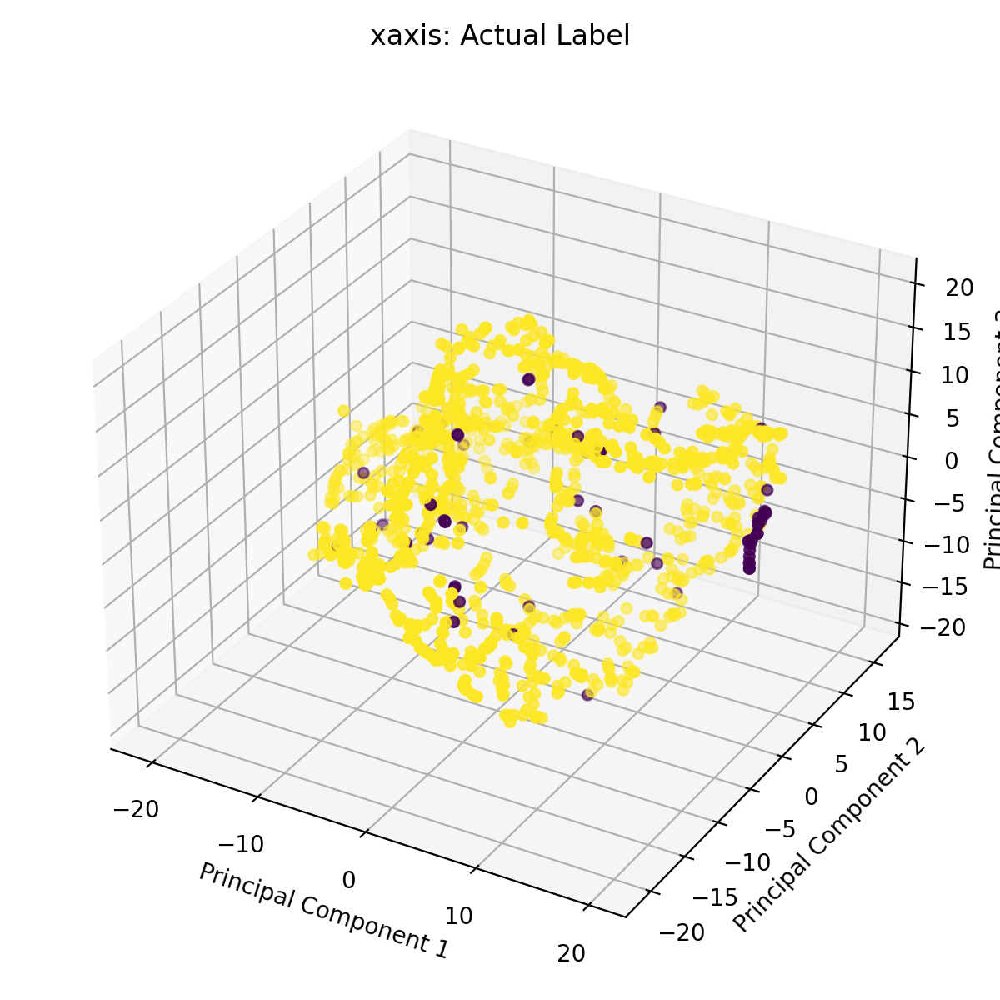




xaxis: Drill


<IPython.core.display.Javascript object>


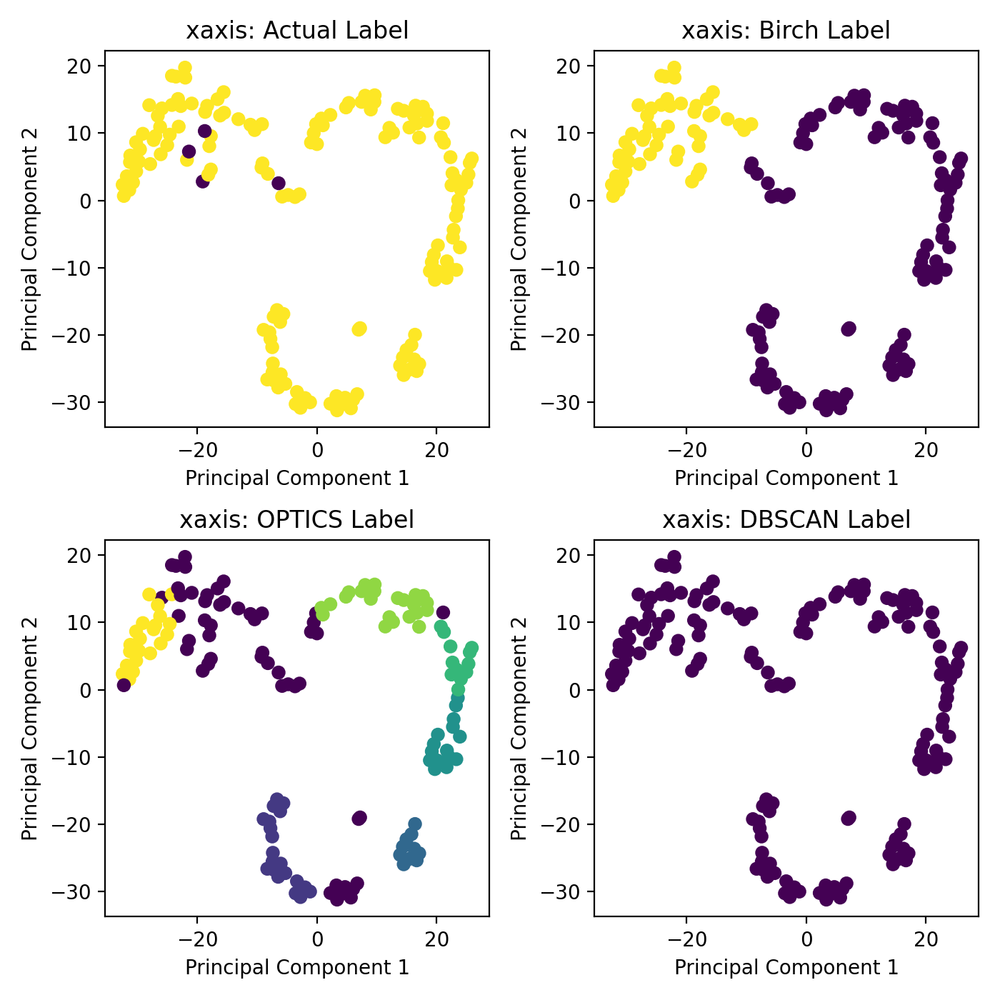

<IPython.core.display.Javascript object>


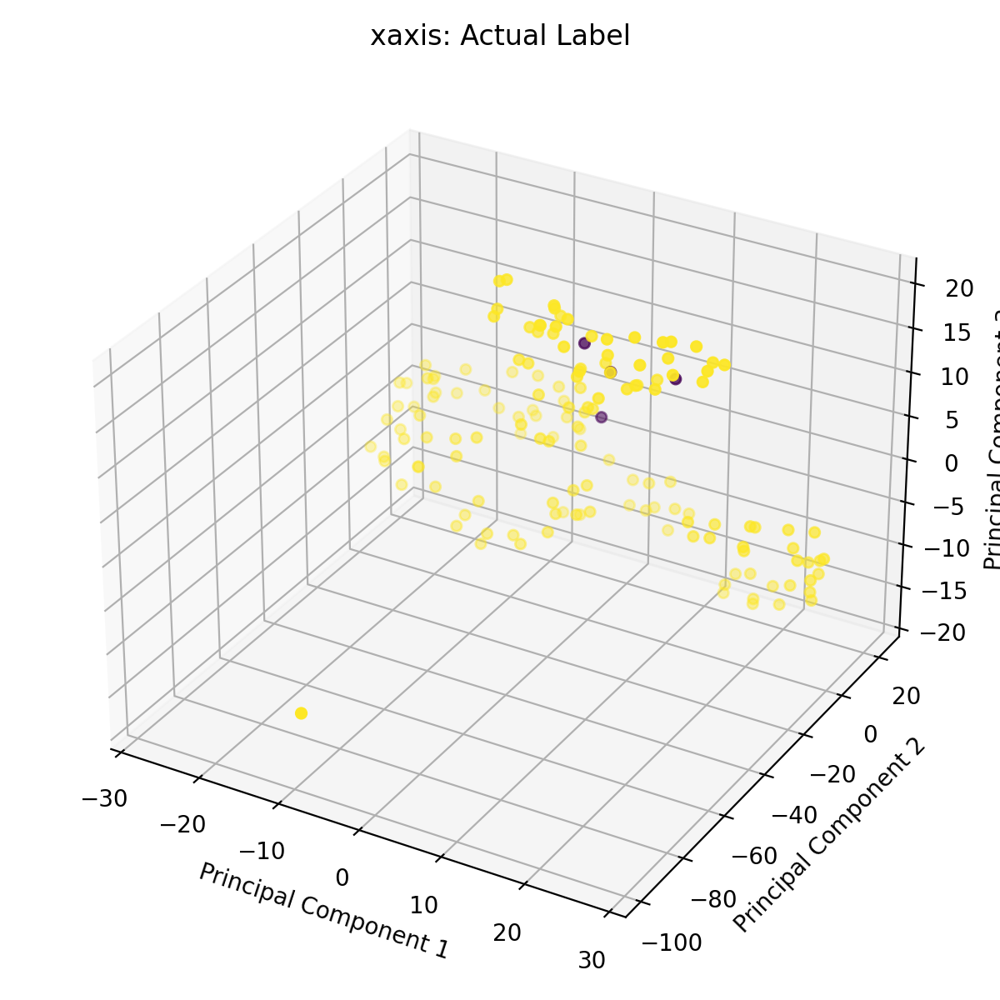




xaxis: Straight_Flute


<IPython.core.display.Javascript object>


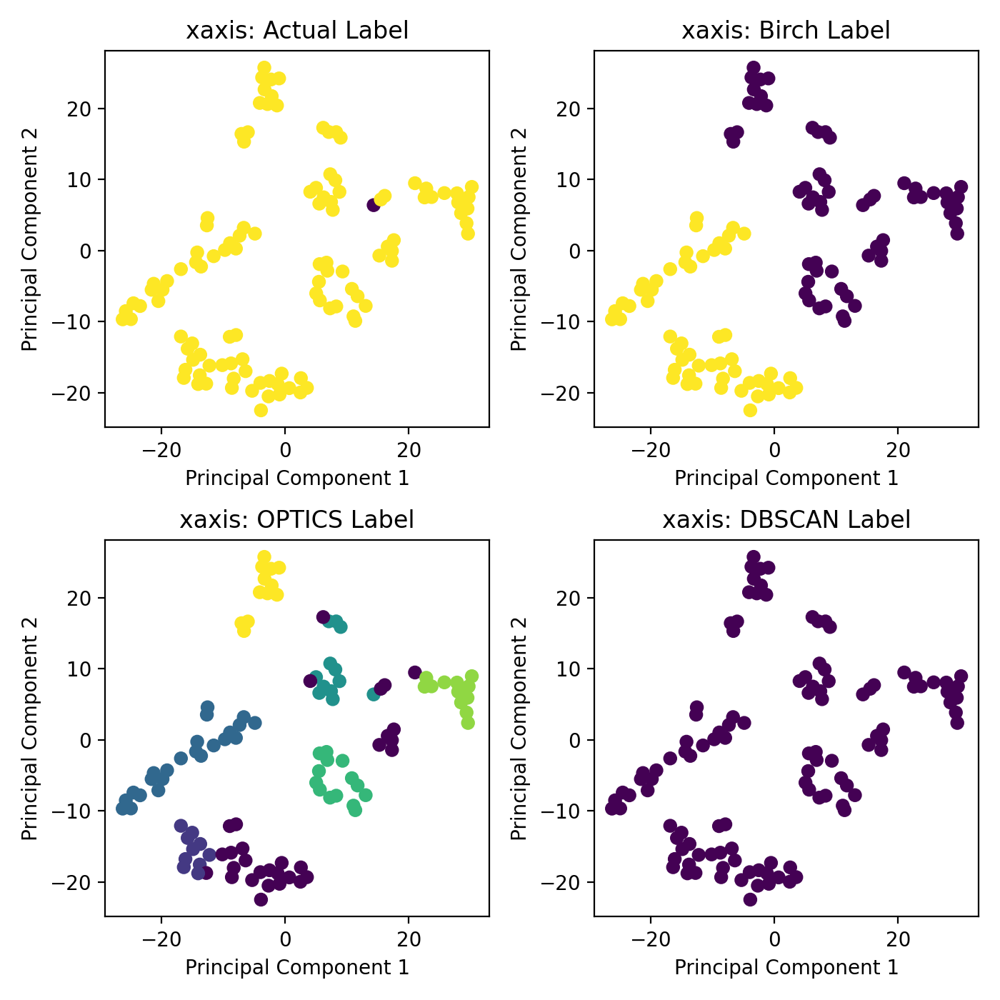

<IPython.core.display.Javascript object>


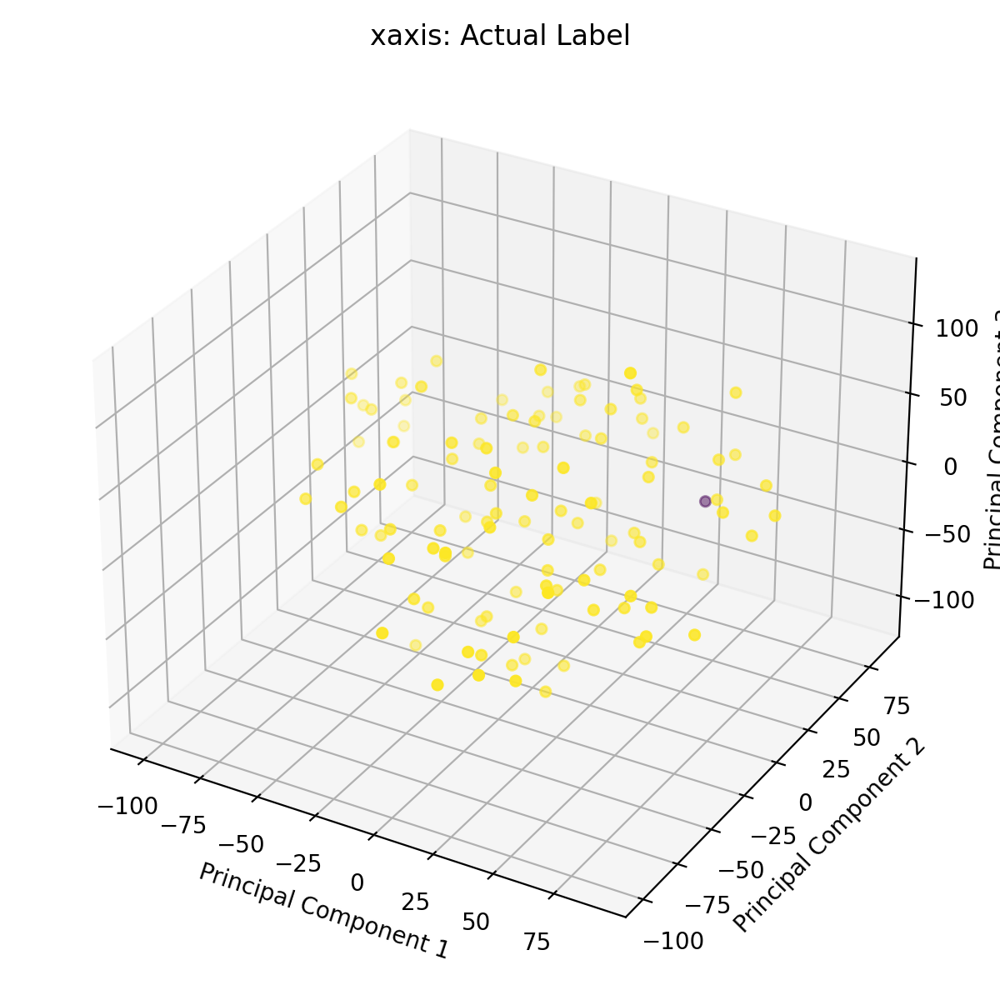




xaxis: T-Slot_Cutter


<IPython.core.display.Javascript object>


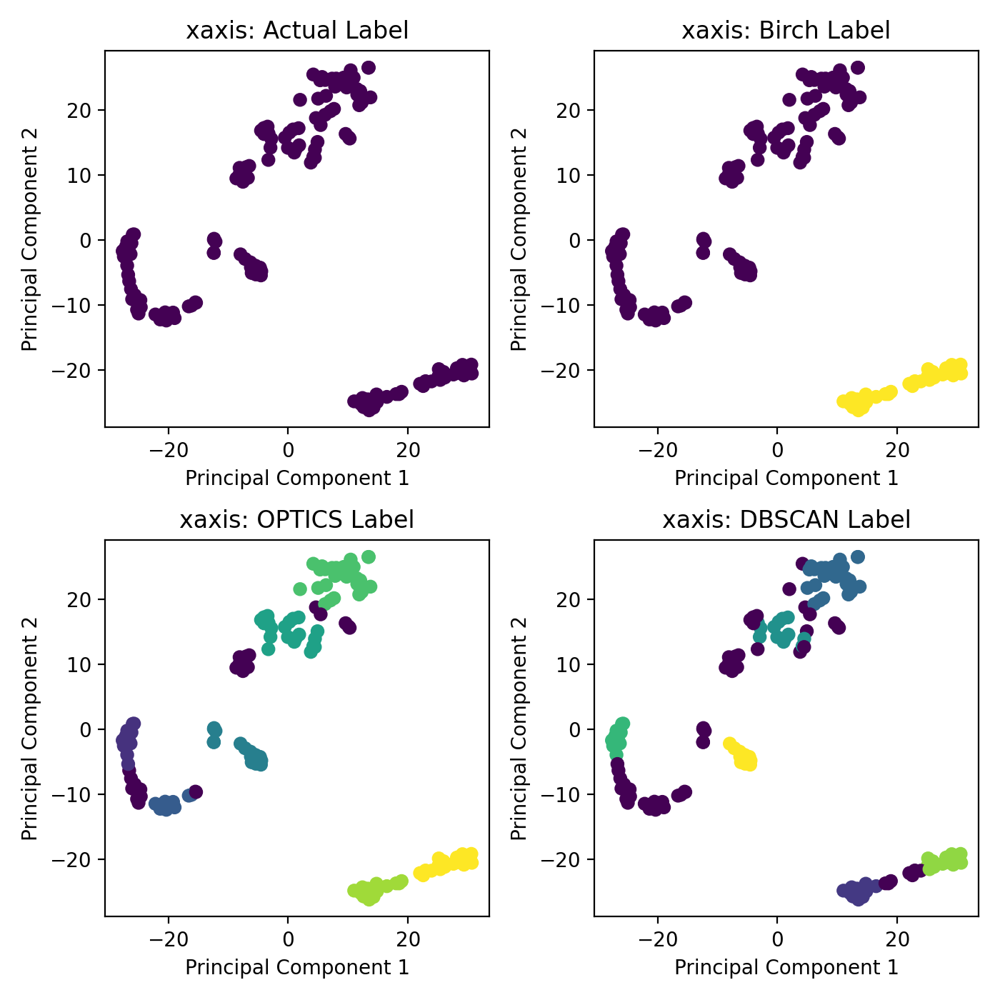

<IPython.core.display.Javascript object>


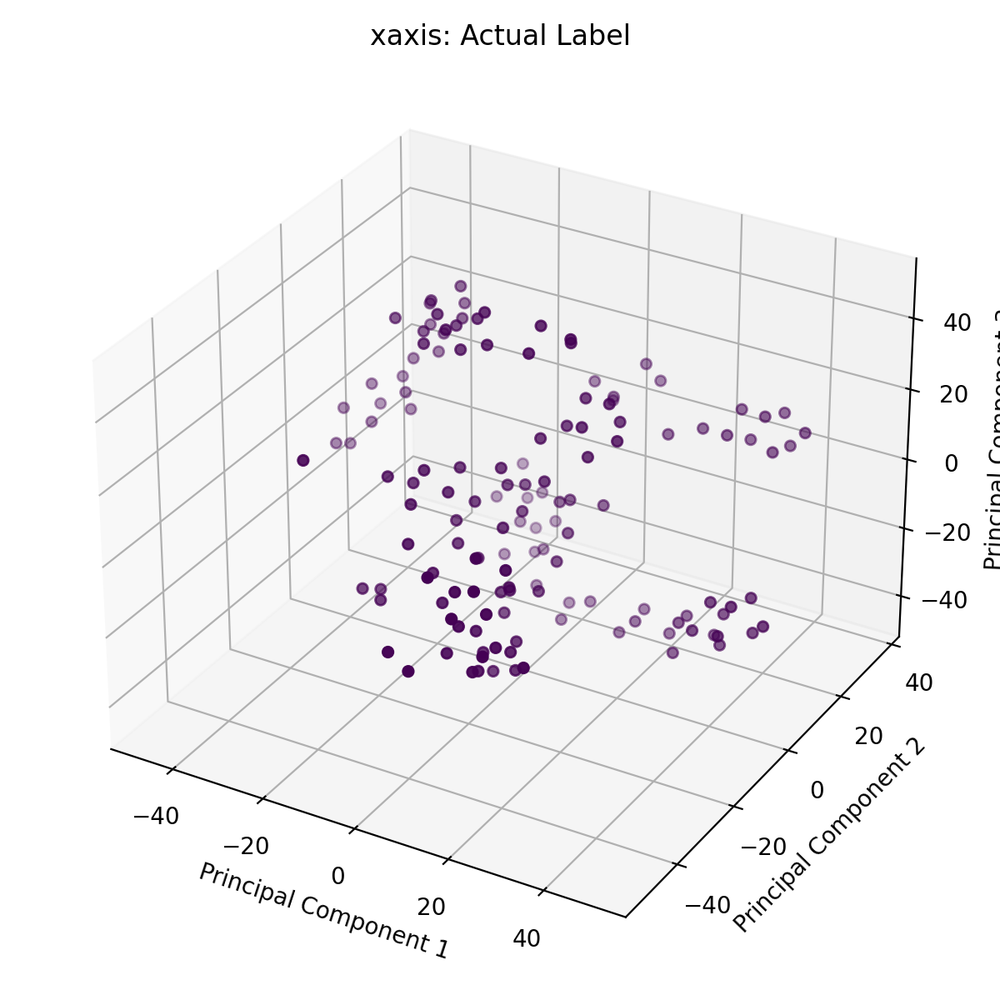




yaxis: Step_Drill


<IPython.core.display.Javascript object>


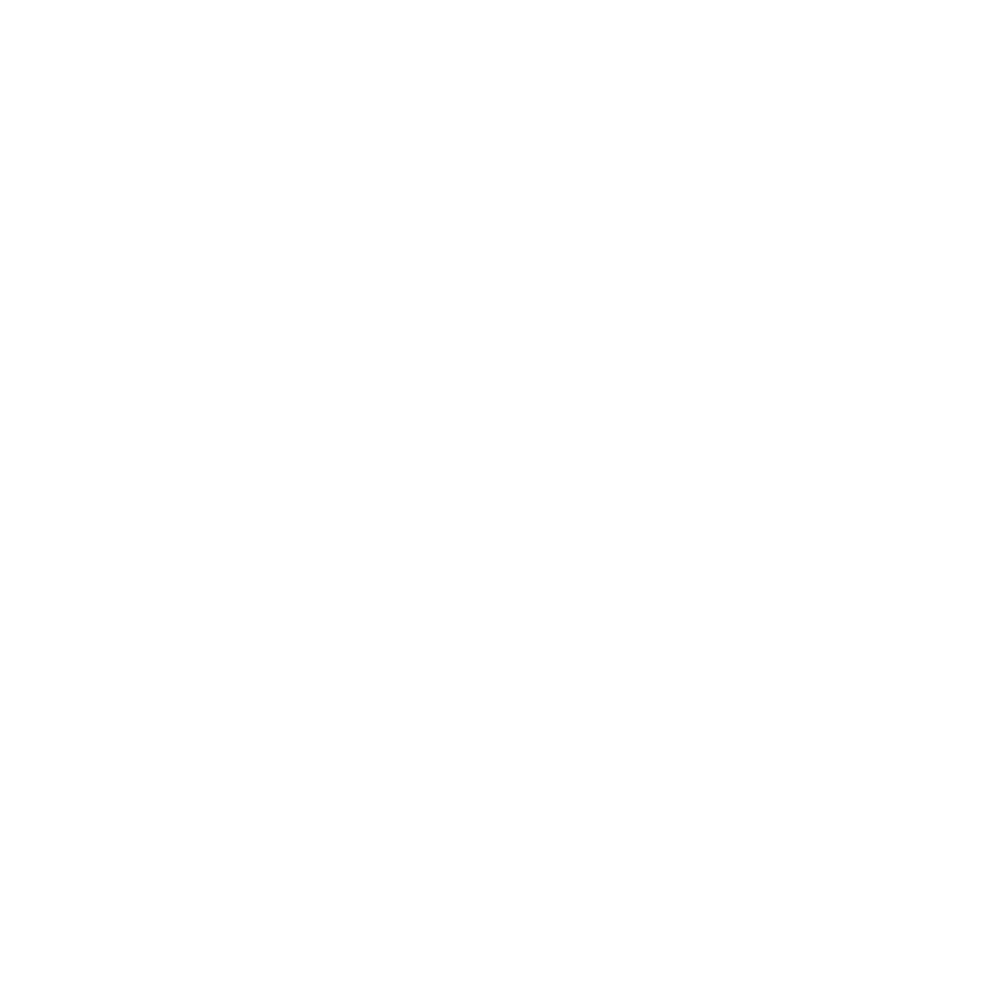

<IPython.core.display.Javascript object>


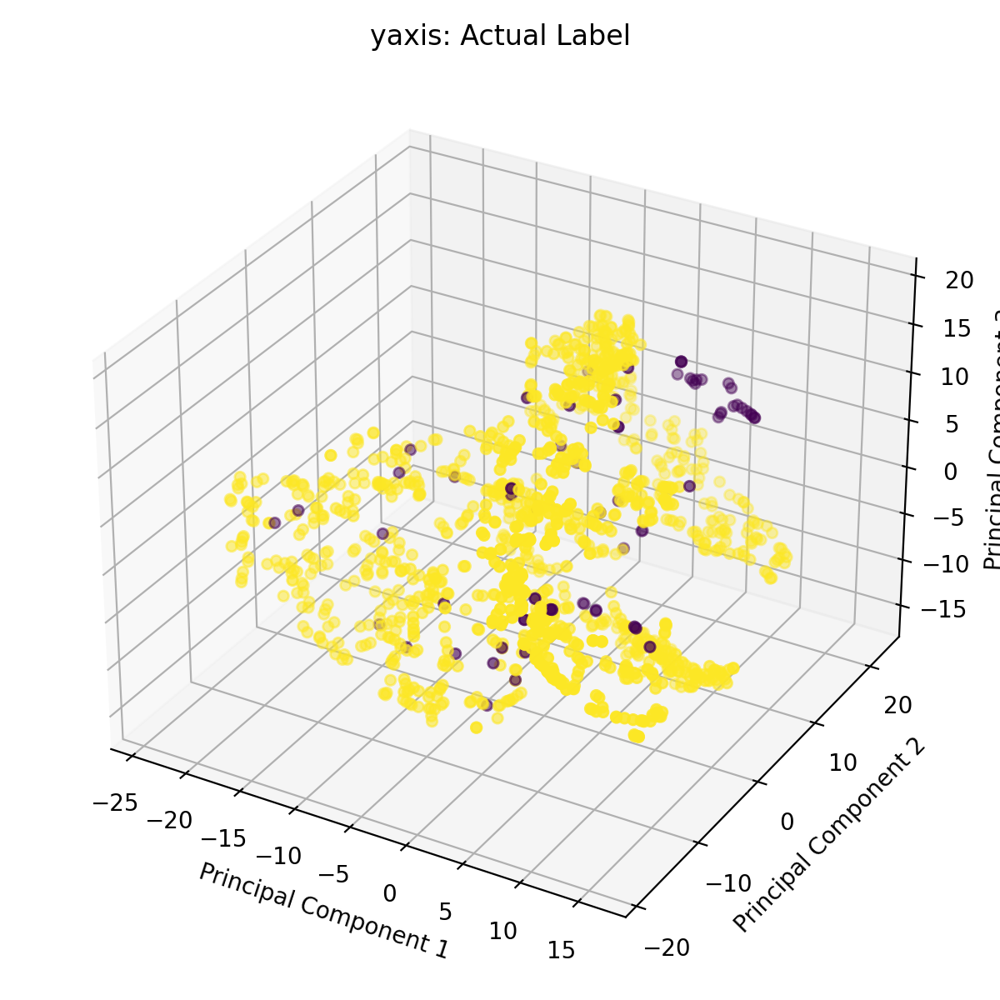




yaxis: Drill


<IPython.core.display.Javascript object>


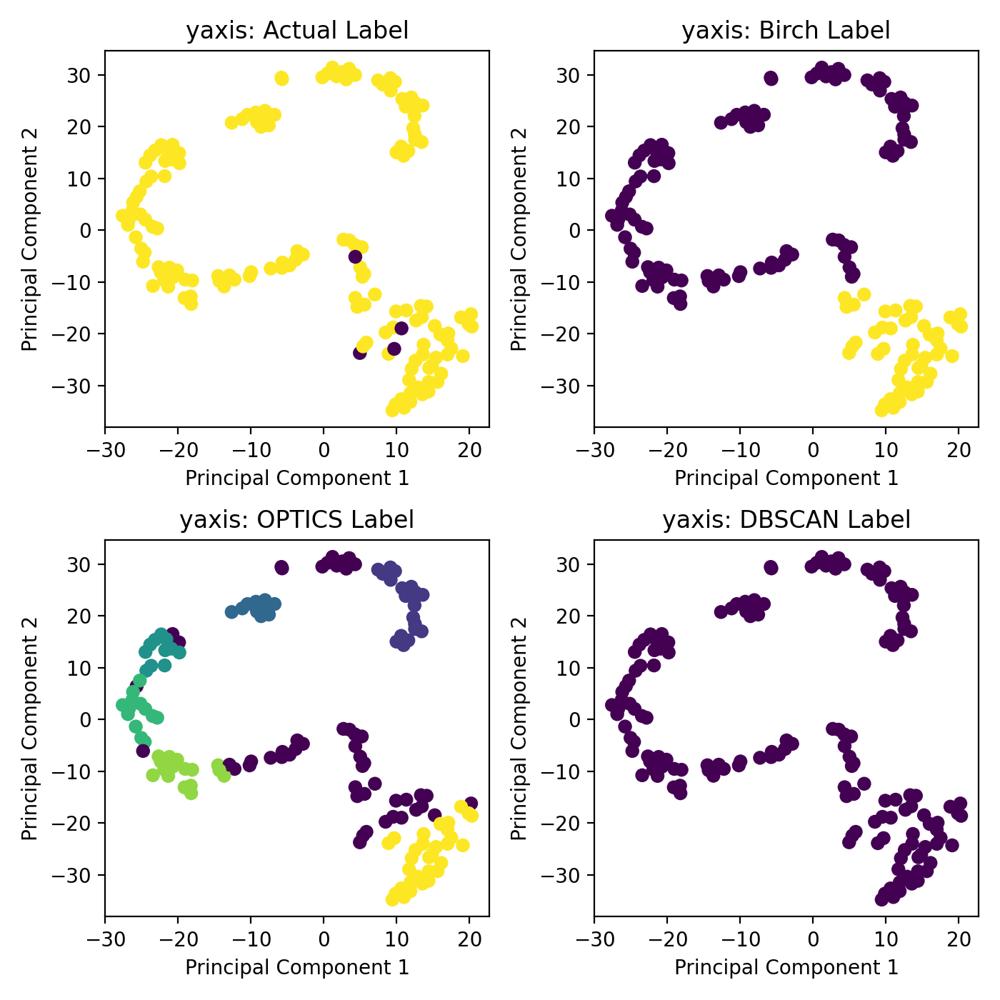

<IPython.core.display.Javascript object>


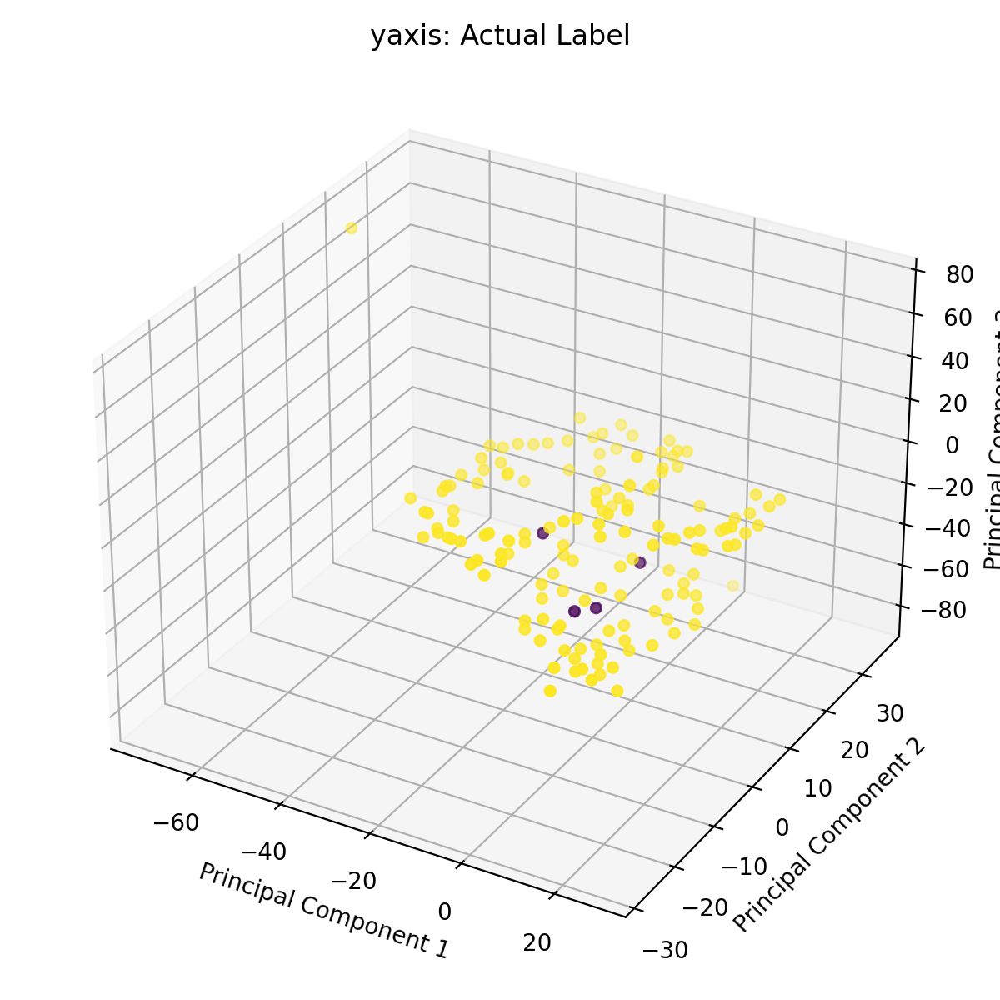




yaxis: Straight_Flute


<IPython.core.display.Javascript object>


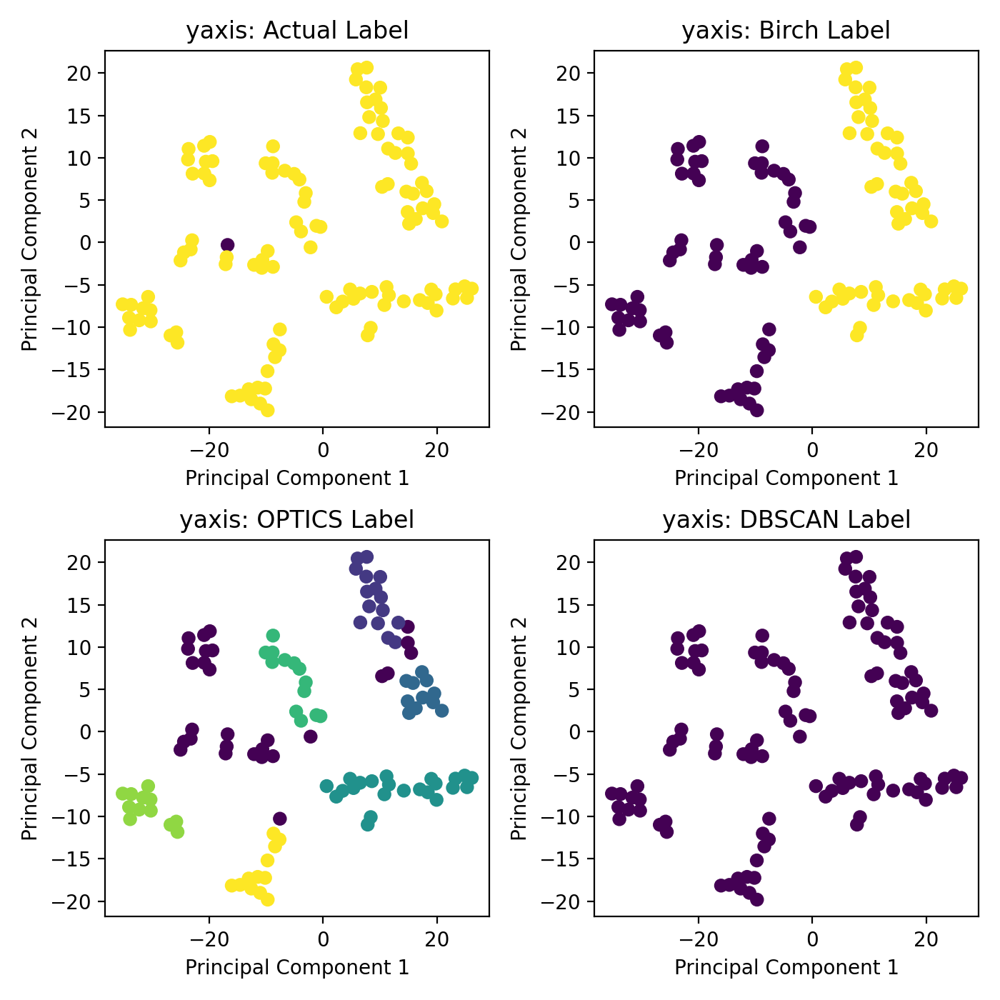

<IPython.core.display.Javascript object>


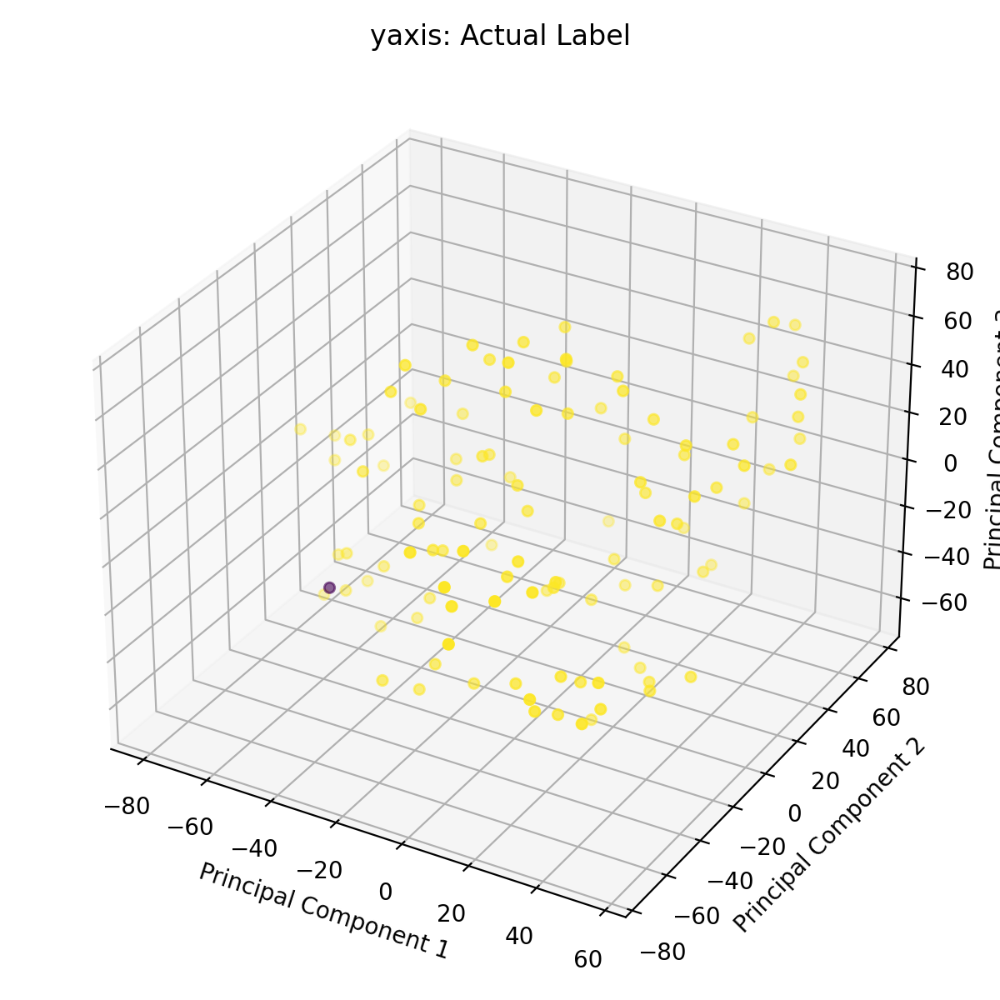




yaxis: T-Slot_Cutter


<IPython.core.display.Javascript object>


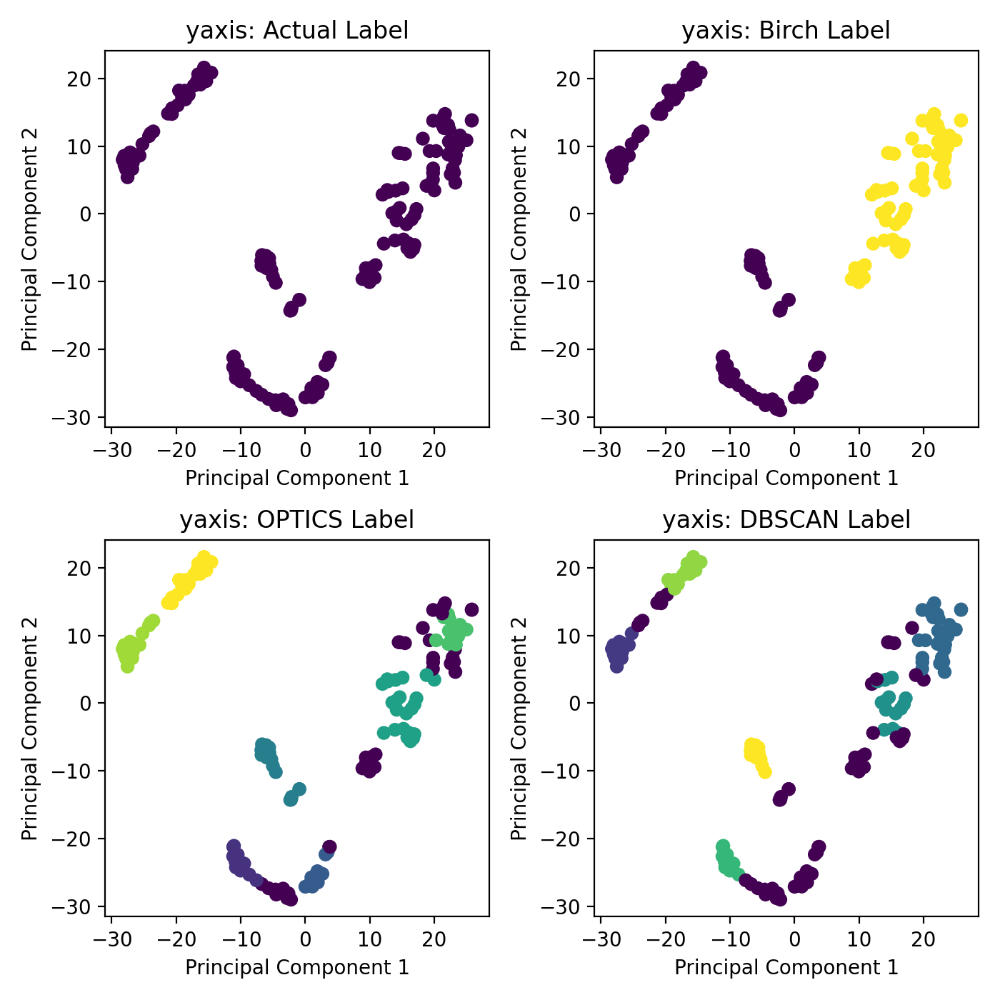

<IPython.core.display.Javascript object>


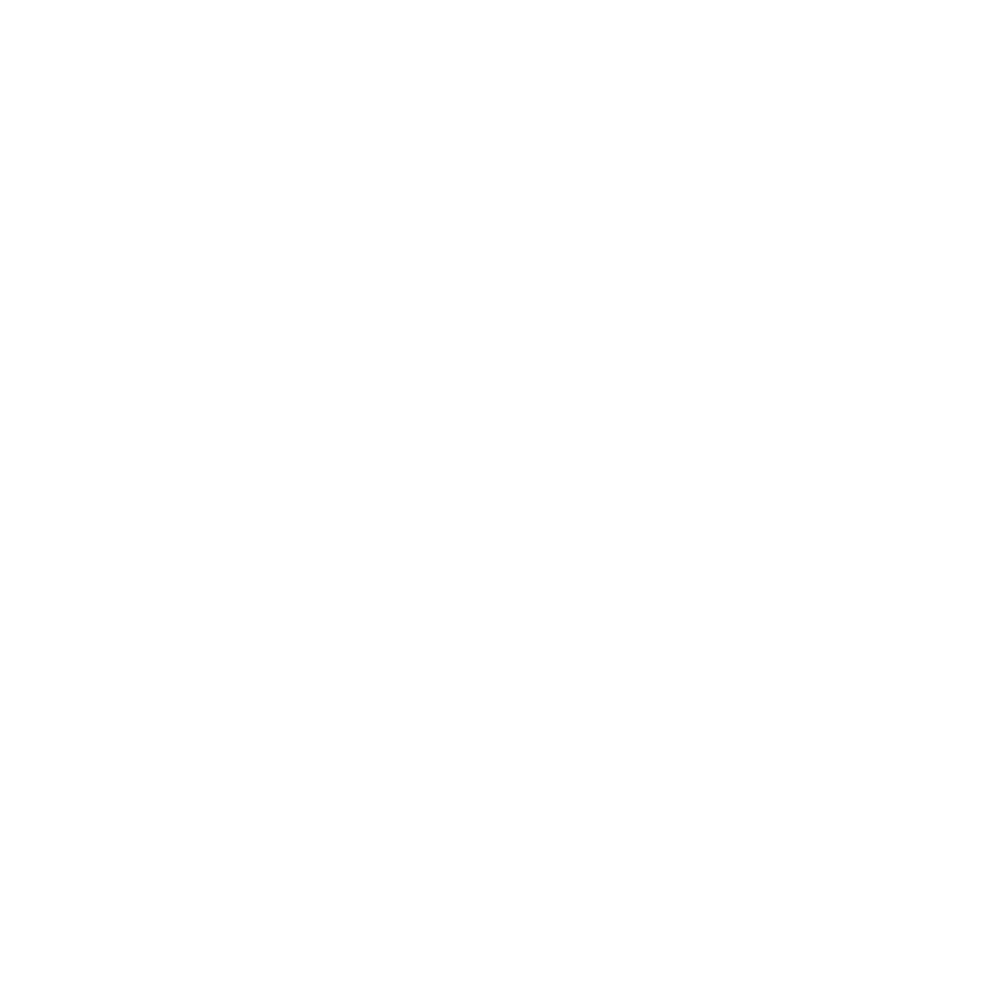




zaxis: Step_Drill


<IPython.core.display.Javascript object>


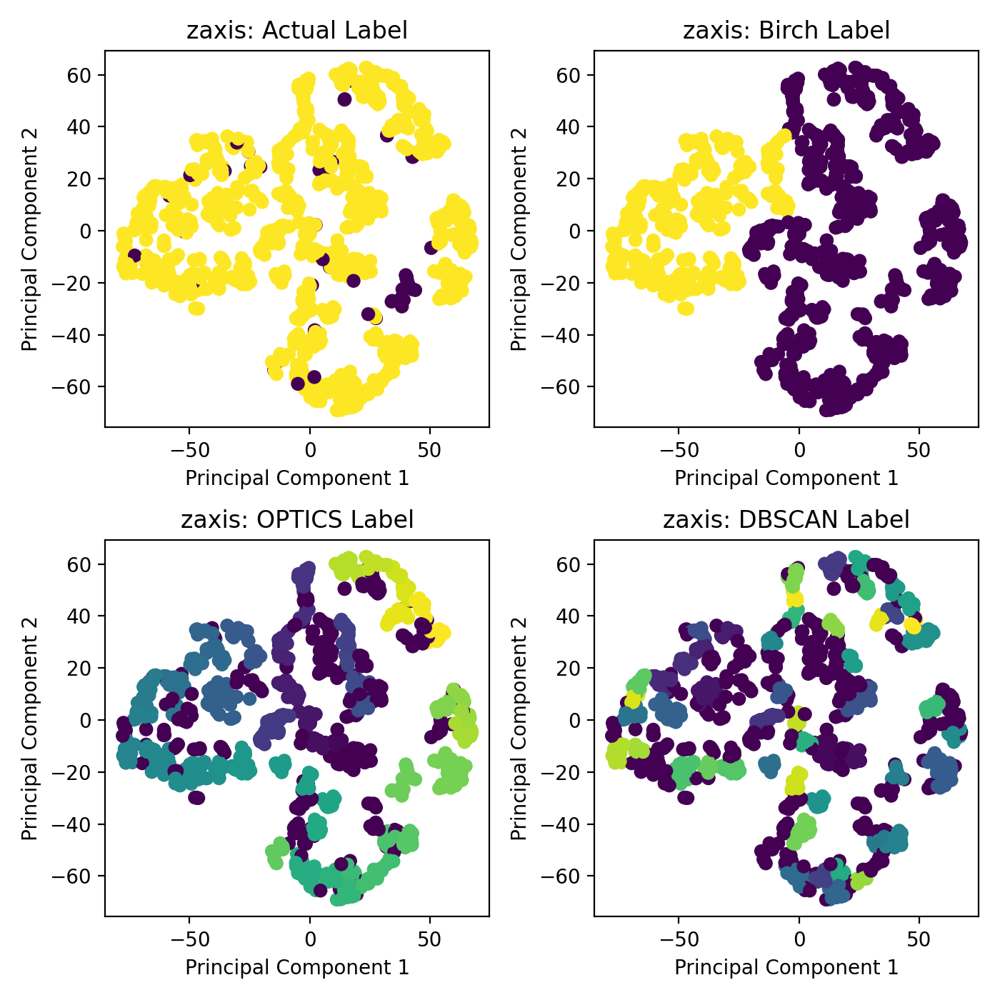

<IPython.core.display.Javascript object>


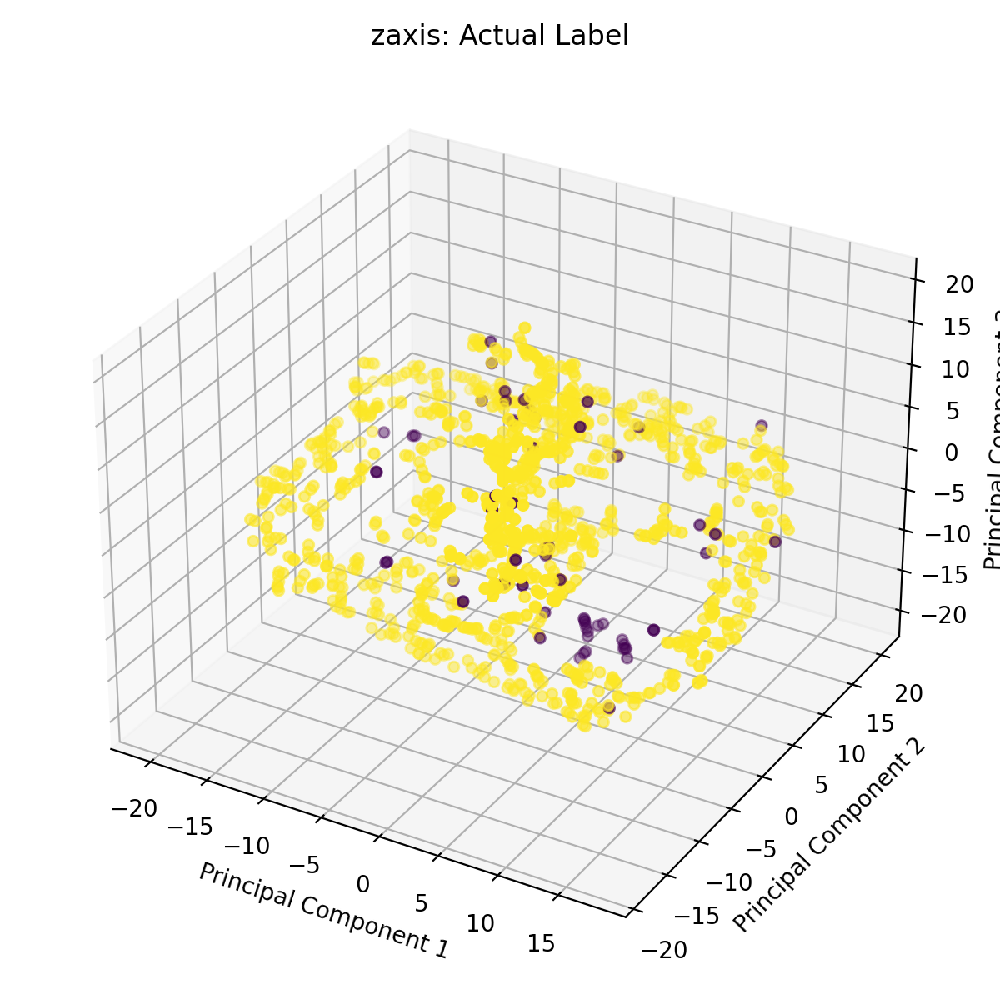




zaxis: Drill


<IPython.core.display.Javascript object>


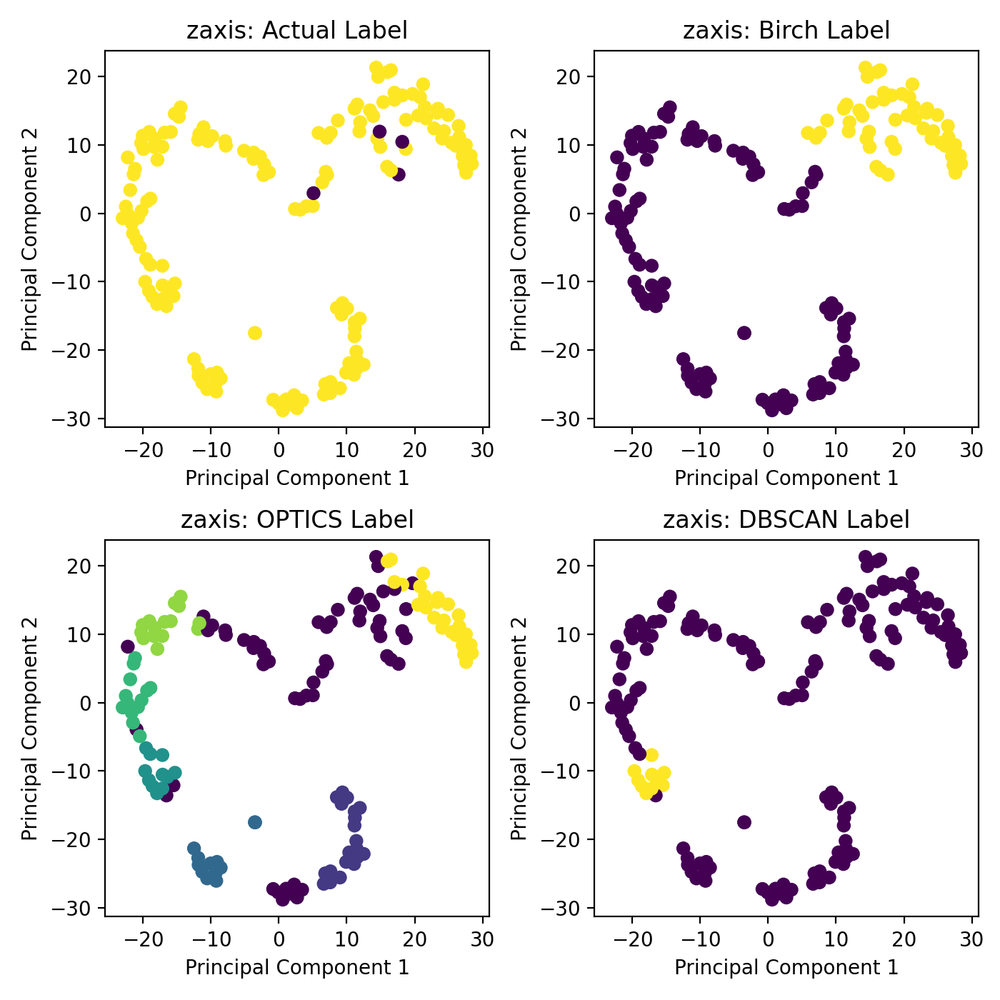

<IPython.core.display.Javascript object>


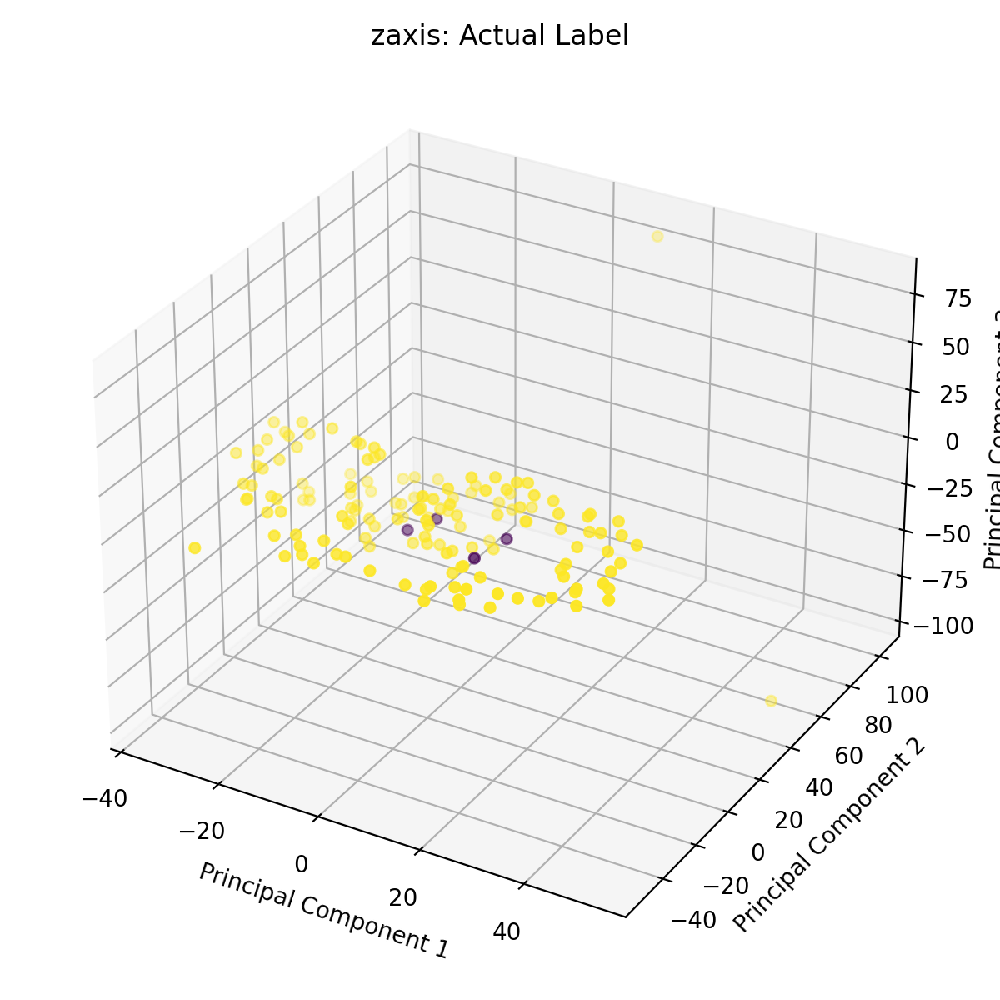




zaxis: Straight_Flute


<IPython.core.display.Javascript object>


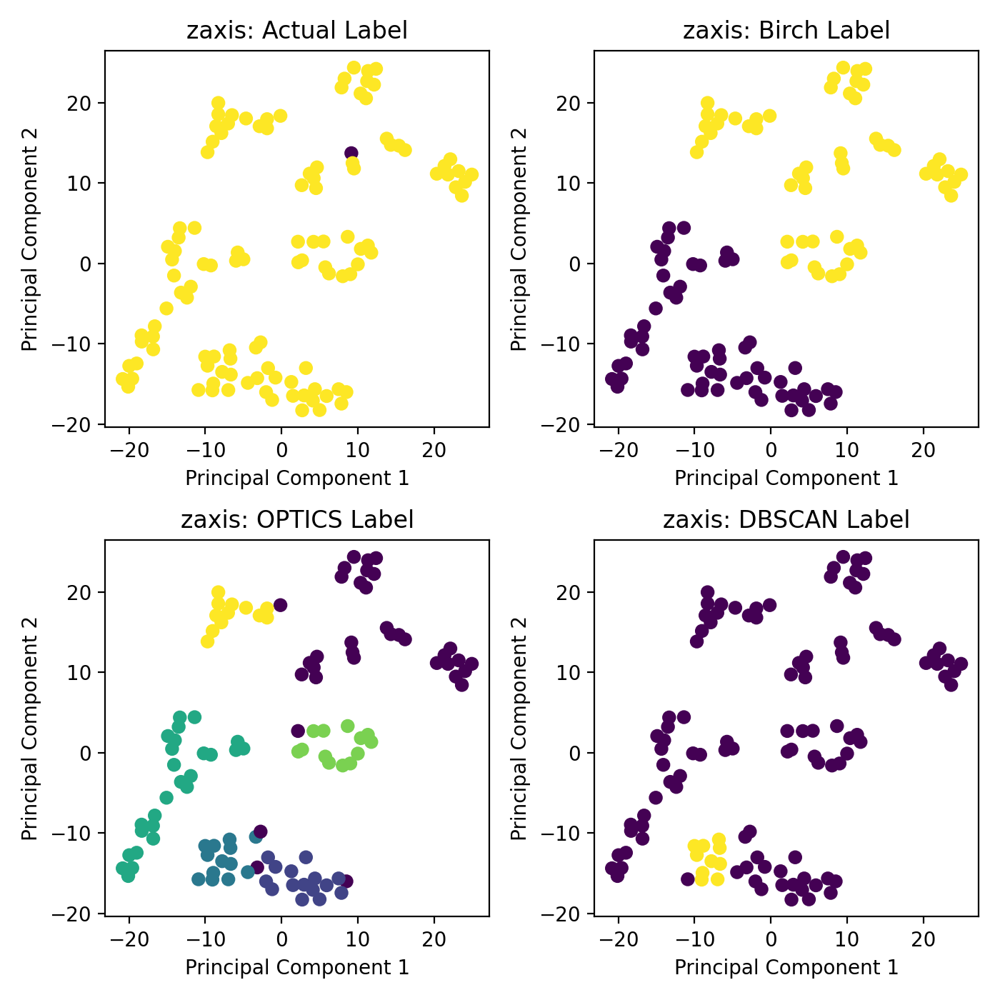

<IPython.core.display.Javascript object>


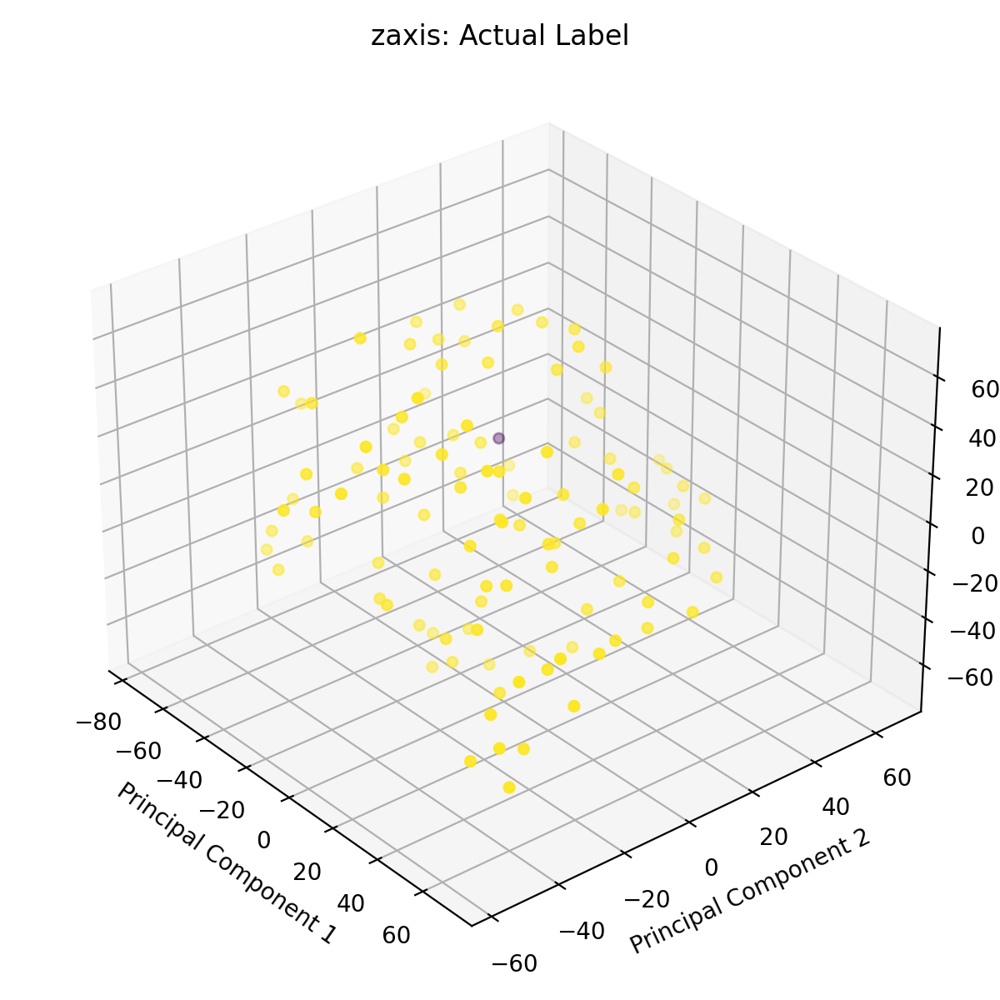




zaxis: T-Slot_Cutter


<IPython.core.display.Javascript object>


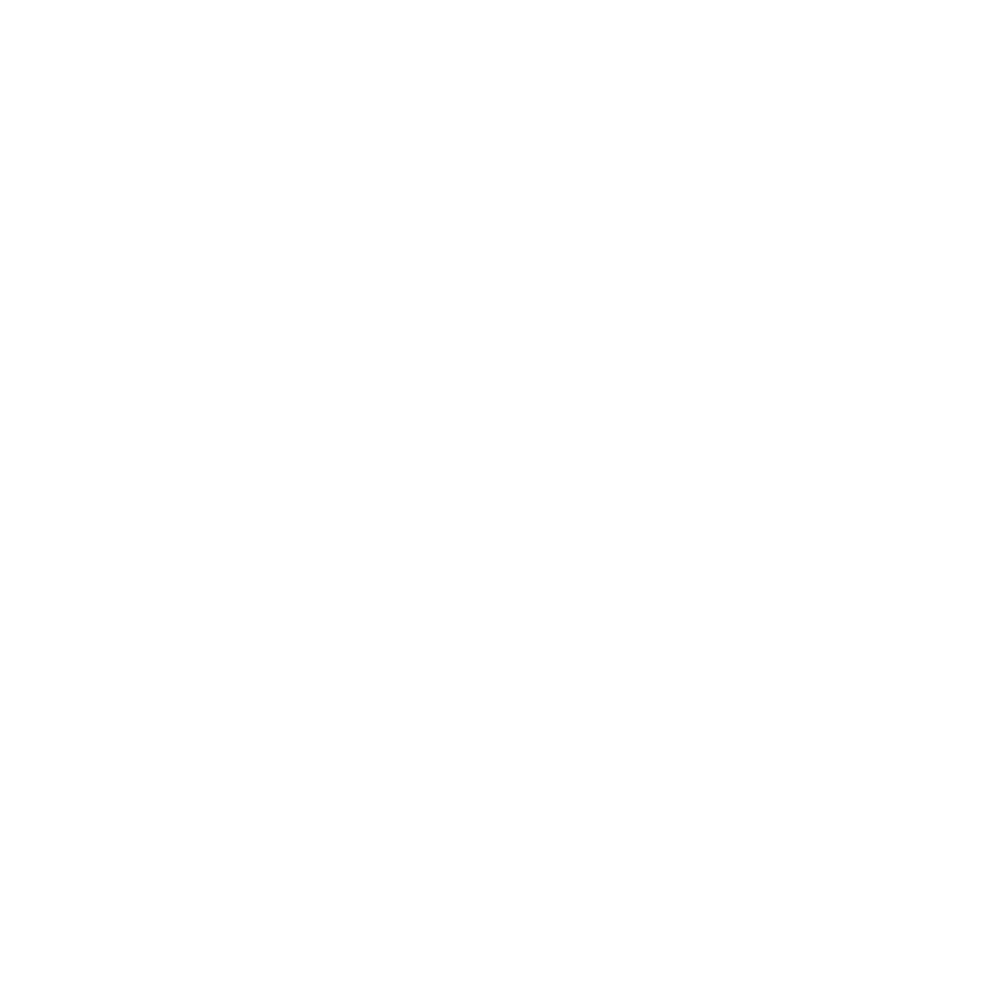

<IPython.core.display.Javascript object>


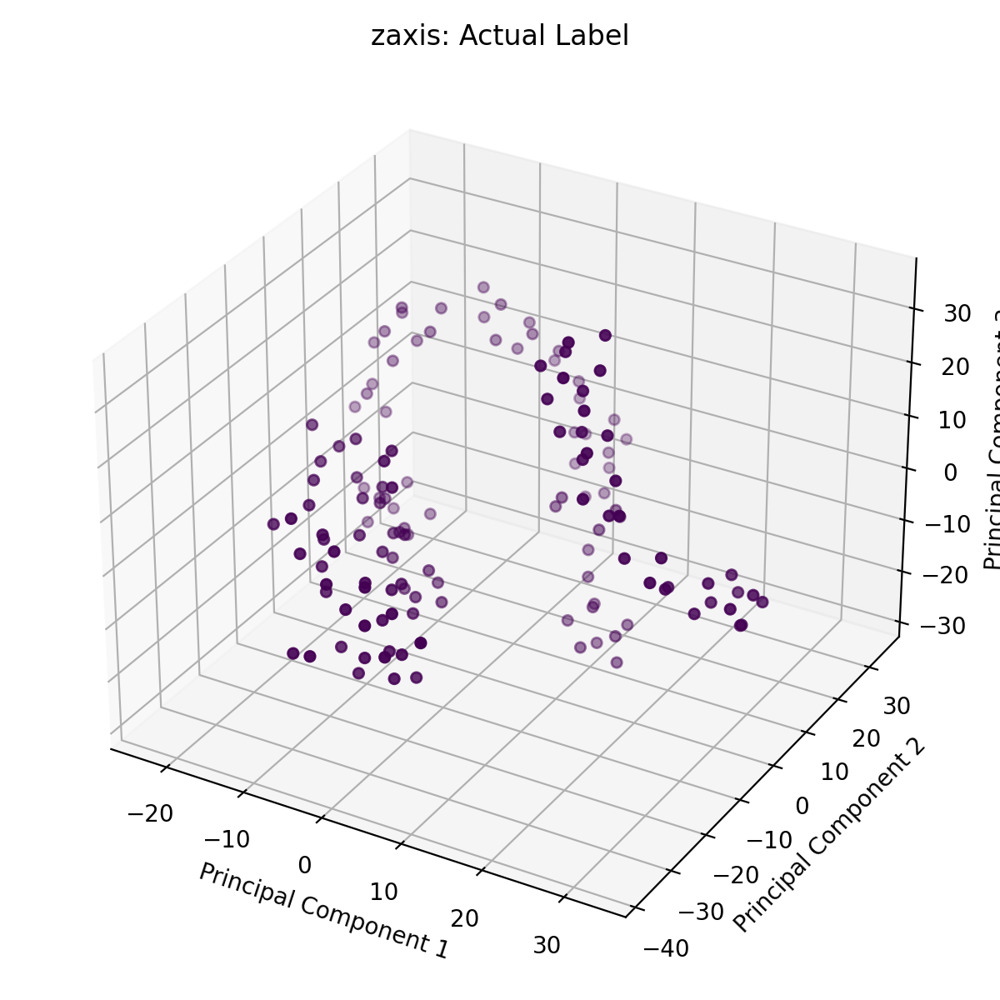

In [13]:
master_file  = "./file_list.log"    
axis_names   = ['xaxis', 'yaxis', 'zaxis']

drill_dict = {'Step_Drill'    : ['OP00', 'OP01', 'OP03', 'OP04', 'OP05', 'OP06', 'OP07', 'OP08', 'OP10', 'OP11', 'OP12', 'OP14'],
              'Drill'         : ['OP02'],
              'T-Slot_Cutter' : ['OP13'],
              'Straight_Flute': ['OP09']
             }
drill_list = ['Step_Drill', 'Drill', 'Straight_Flute', 'T-Slot_Cutter']
drill_df_list = []
dist_drill_list = []

for i, axis_name in enumerate(axis_names):
    filename    = "final_df_"+axis_name+"_process.h5"
    drill_df = data_processing(master_file, axis_name, filename, skip=1)
    
    for j, drill in enumerate(drill_list):
        print("====================================================================================")
        print(f'{axis_name}: {drill}')
        drill_df_list += [drill_df[drill_df.Process.isin(drill_dict[drill])]]
        dist_drill_list     += [get_euclidean_data(drill_df_list[j])]
        tsne_func(drill_df_list[-1], dist_drill_list[-1], axis_name, pc_count=2, perplexity=10)
        tsne_func(drill_df_list[-1], dist_drill_list[-1], axis_name, pc_count=3, perplexity=10)
        print("\n\n")

# [Axis vs Axis per Drill Type] PairPlot & BoxPlot

xaxis: Step_Drill		 (1294, 317444)
xaxis: Drill		 (152, 317444)
xaxis: Straight_Flute		 (114, 317444)
xaxis: T-Slot_Cutter		 (142, 317444)
yaxis: Step_Drill		 (1294, 317444)
yaxis: Drill		 (152, 317444)
yaxis: Straight_Flute		 (114, 317444)
yaxis: T-Slot_Cutter		 (142, 317444)
zaxis: Step_Drill		 (1294, 317444)
zaxis: Drill		 (152, 317444)
zaxis: Straight_Flute		 (114, 317444)
zaxis: T-Slot_Cutter		 (142, 317444)


: Flattening Time-Series Data…: 0it [00:00, ?it/s]


Step_Drill: xaxis



: Adding gb_list for Hue…:  16%|█▎      | 205/1294 [01:16<06:43,  2.70it/s]


: Adding gb_list for Hue…:  32%|██▌     | 411/1294 [02:32<05:26,  2.70it/s]


: Adding gb_list for Hue…:  48%|███▊    | 617/1294 [03:47<04:06,  2.74it/s]


: Adding gb_list for Hue…:  64%|█████   | 823/1294 [05:04<02:53,  2.72it/s]


: Adding gb_list for Hue…:  80%|█████▌ | 1029/1294 [06:20<01:36,  2.73it/s]


: Adding gb_list for Hue…:  95%|██████▋| 1235/1294 [07:36<00:21,  2.75it/s]


: Adding gb_list for Hue…: 100%|███████| 1294/1294 [07:58<00:00,  2.70it/s]


temp: (410767360,), df_idx: 0, gb_list: 410767360

Step_Drill: yaxis
temp: (410767360,), df_idx: 4, gb_list: 410767360

Step_Drill: zaxis
temp: (410767360,), df_idx: 8, gb_list: 410767360

Time for plotting pairplot & boxplot...


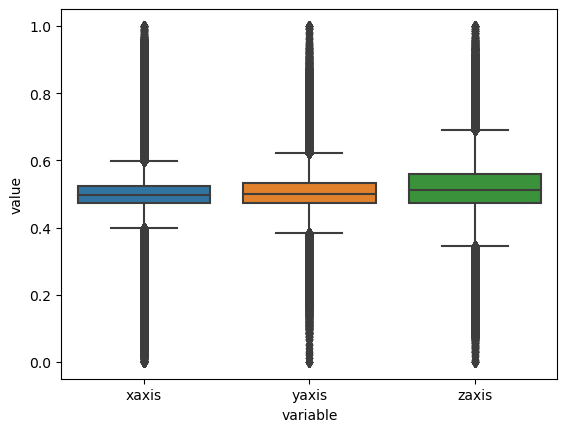

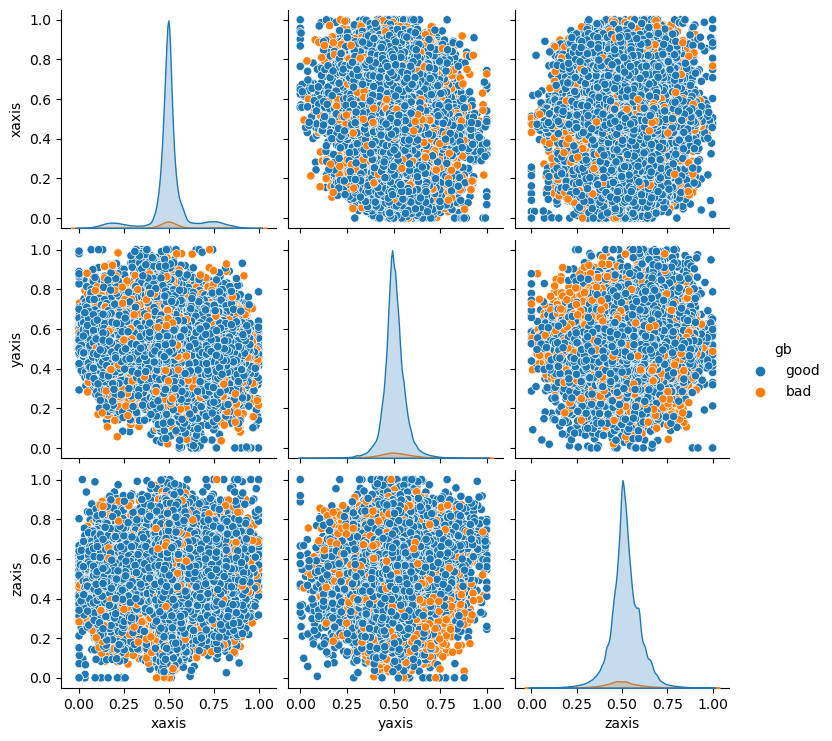

: Flattening Time-Series Data…: 1it [11:52, 712.58s/it]


Drill: xaxis



: Adding gb_list for Hue…: 100%|█████████| 152/152 [00:06<00:00, 25.24it/s]


temp: (48250880,), df_idx: 1, gb_list: 48250880

Drill: yaxis
temp: (48250880,), df_idx: 5, gb_list: 48250880

Drill: zaxis
temp: (48250880,), df_idx: 9, gb_list: 48250880

Time for plotting pairplot & boxplot...


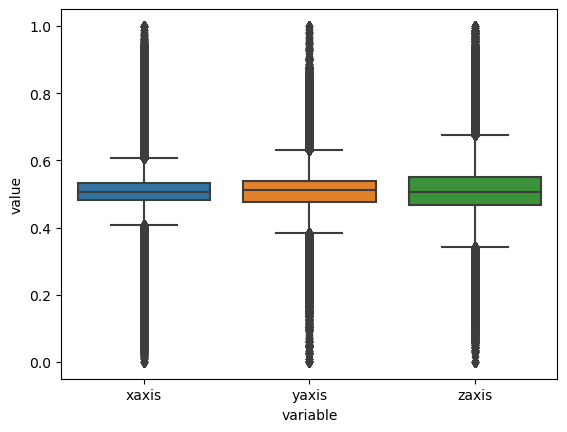

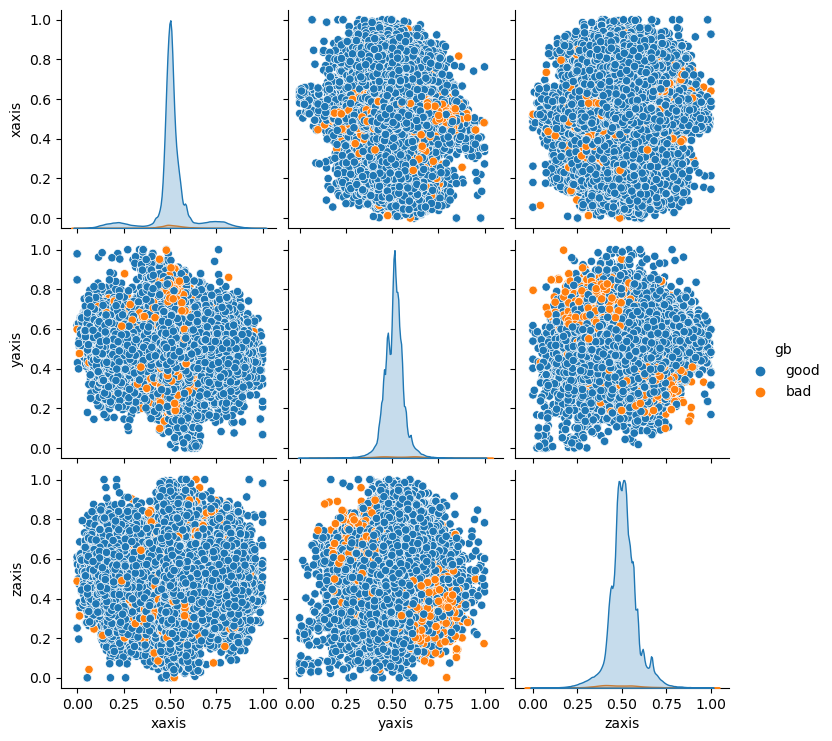

: Flattening Time-Series Data…: 2it [14:33, 387.83s/it]


Straight_Flute: xaxis



: Adding gb_list for Hue…: 100%|█████████| 114/114 [00:03<00:00, 29.18it/s]


temp: (36188160,), df_idx: 2, gb_list: 36188160

Straight_Flute: yaxis
temp: (36188160,), df_idx: 6, gb_list: 36188160

Straight_Flute: zaxis
temp: (36188160,), df_idx: 10, gb_list: 36188160

Time for plotting pairplot & boxplot...


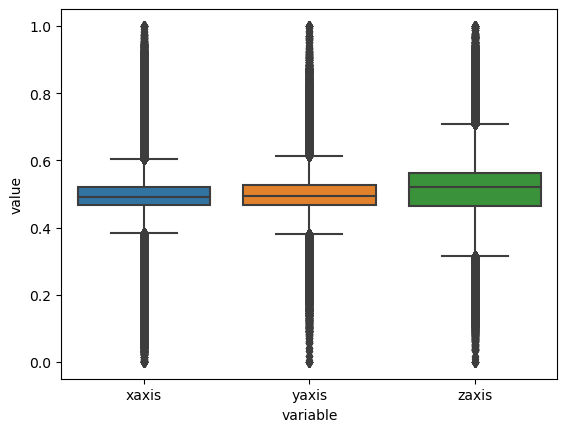

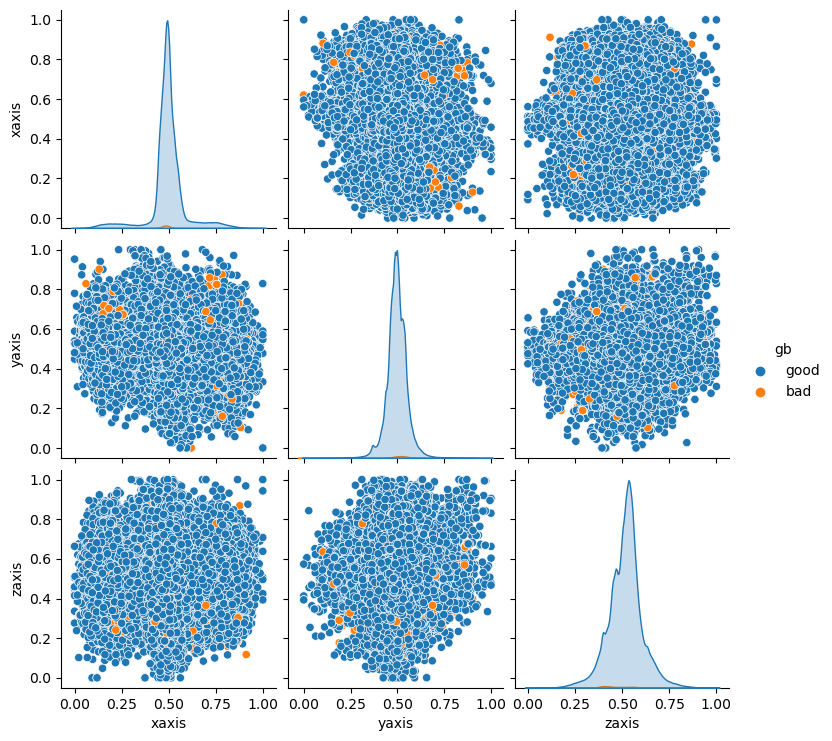

: Flattening Time-Series Data…: 3it [17:06, 280.69s/it]


T-Slot_Cutter: xaxis



: Adding gb_list for Hue…: 100%|█████████| 142/142 [00:05<00:00, 25.02it/s]


temp: (45076480,), df_idx: 3, gb_list: 45076480

T-Slot_Cutter: yaxis
temp: (45076480,), df_idx: 7, gb_list: 45076480

T-Slot_Cutter: zaxis
temp: (45076480,), df_idx: 11, gb_list: 45076480

Time for plotting pairplot & boxplot...


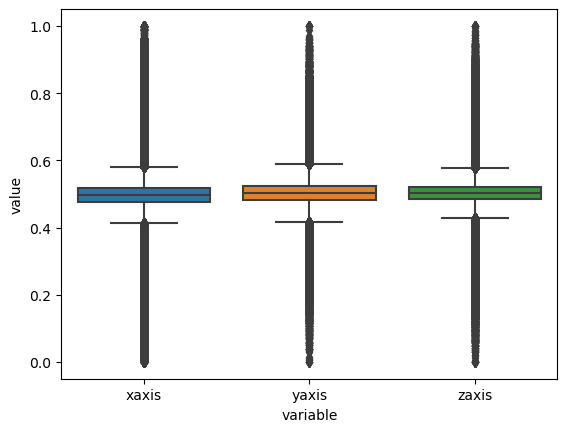

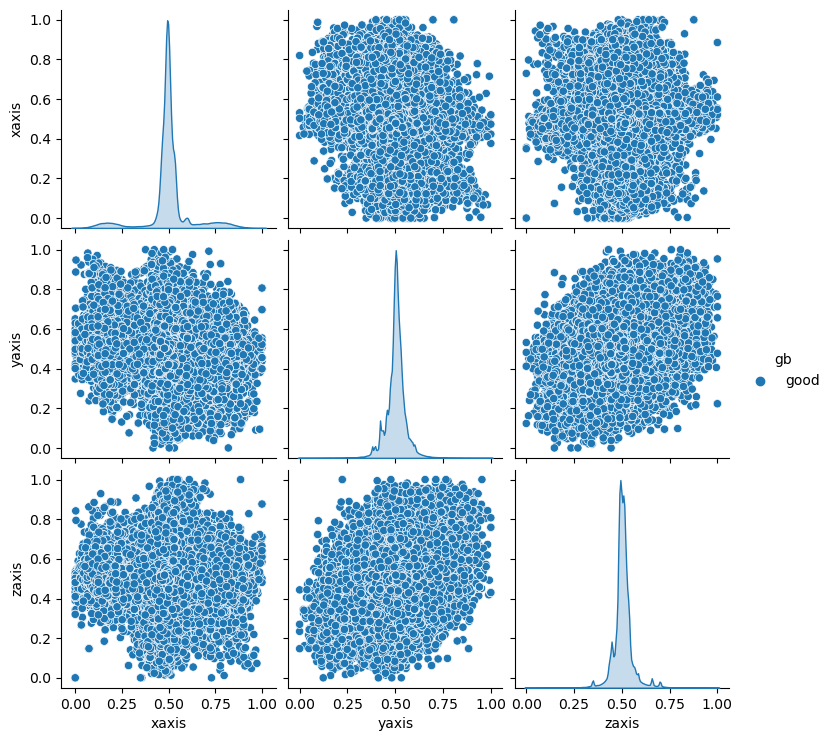

: Flattening Time-Series Data…: 4it [19:43, 295.76s/it]


In [2]:
master_file  = "./file_list.log"    
axis_names   = ['xaxis', 'yaxis', 'zaxis']

drill_dict = {'Step_Drill'    : ['OP00', 'OP01', 'OP03', 'OP04', 'OP05', 'OP06', 'OP07', 'OP08', 'OP10', 'OP11', 'OP12', 'OP14'],
              'Drill'         : ['OP02'],
              'T-Slot_Cutter' : ['OP13'],
              'Straight_Flute': ['OP09']
             }
drill_list = ['Step_Drill', 'Drill', 'Straight_Flute', 'T-Slot_Cutter']
drill_df_list = []
dist_drill_list = []

for i, axis_name in enumerate(axis_names):
    filename    = "final_df_"+axis_name+"_process.h5"
    drill_df = data_processing(master_file, axis_name, filename, skip=1)
    
    for j, drill in enumerate(drill_list):
        drill_df_list += [drill_df[drill_df.Process.isin(drill_dict[drill])]]
        dist_drill_list     += [get_euclidean_data(drill_df_list[j])]
        print(f'{axis_names[i]}: {drill_list[j]}\t\t {drill_df_list[i*int(len(drill_list))+j].shape}')

        
        
sample_size = 1000000        
        

    
for j, drill in tqdm(enumerate(drill_list), desc=": Flattening Time-Series Data…", ascii=False, ncols=75):
    flatten_list = []
    df = pd.DataFrame()
    gb_list = []
    
    for i, axis_name in enumerate(axis_names):
        print(f'\n{drill_list[j]}: {axis_name}')
        idx = j+i*int(len(drill_list))
        
        temp = drill_df_list[idx].iloc[0:,4:].copy()
        temp = temp.to_numpy().flatten()
        
        flatten_list += [temp]
        
        if int(len(gb_list))==0:
            for i in tqdm(range(drill_df_list[idx].shape[0]), desc=": Adding gb_list for Hue…", ascii=False, ncols=75):
                addition = [drill_df_list[idx].label.iloc[i]]*drill_df_list[idx].iloc[0:,4:].shape[1]
                gb_list += addition
                #print(f'{i} => addition: {int(len(addition))}, gb_list: {int(len(gb_list))}')
        print(f'temp: {temp.shape}, df_idx: {idx}, gb_list: {int(len(gb_list))}')
        #print(f'temp: {temp.shape}, df_idx: {idx}')
            
    
    final_dict = {axis_name: flatten for axis_name, flatten in zip(axis_names, flatten_list)}
    df = pd.DataFrame.from_dict(final_dict)
    
    print("\nTime for plotting pairplot & boxplot...")
    sns.boxplot(x="variable", y="value", data=pd.melt(df.sample(sample_size)))
    
    final_dict.update({"gb":gb_list})
    df = pd.DataFrame.from_dict(final_dict)
    sns.pairplot(df.sample(sample_size), hue ='gb')
    #sns.pairplot(df)
    
    plt.show()

# Conclusions made on the observed pairplots & boxplots:
- <font color="blue"><b>Step_Drill (1M/411M sample size)</b></font>
  - Boxplots:
    - All 3 axis have comparable median and average at 0.5. Z axis has broader interquartile range (i.e. broader distribution)
  - KDEplot:
    - All 3 axes have centered normal distribution at 0.5 for both good and bad data
    - X axis is of trimodal normal distribution
    - X & Y axes have comparable SD
    - Z axis has largest distribution among the 3 axes
  - Pairplots:
    - Good data are evenly distributed across the whole spectrum of 3 axes. Bad data are primarily concentrated on the outlier points
      - XY: (lo X, lo Y), (lo X, hi Y), (hi X, lo Y), (hi X, hi Y)
      - XZ: (lo X, lo Y), (lo X, hi Y), (hi X, lo Y), (hi X, hi Y)
      - YZ: (lo Y, hi Z), (hi Y, lo Z)
- <font color="blue"><b>Drill (1M/48M sample size)</b></font>
  - Boxplots:
    - All 3 axes have comparable interquartile range.
  - KDEplots:
    - Same observation as Step_Drill.
  - Pairplots:
    - XY: (mid X, lo Y), (mid X, hi Y)
    - XZ: (mid X, lo Y), (mid X, hi Y) => sporadic
    - YZ: (lo  Y, hi Z), (hi  Y, lo Z) => tight concentration (tighter than Step_Drill)
- <font color="blue"><b>Straight_Flute (1M/36M sample size)</b></font>
  - Boxplots:
    - Same observation as Step_Drill
  - KDEplots:
    - Same observation as Step_Drill
  - Pairplots:
    - XY: (lo X, hi Y), (hi X, hi Y)
    - XZ: lo Z => Spreaded across X
    - YZ: Sporadic
- <font color="blue"><b>T-Slot_Cutter (1M/45M sample size)</b></font>
  - Boxplots:
    - Same observation as Drill
  - KDEplots:
    - Same observation as Step_Drill
  - Pairplots:
    - No bad data for comparison

# 3D Plot XYZ per Drill Type:


<IPython.core.display.Javascript object>


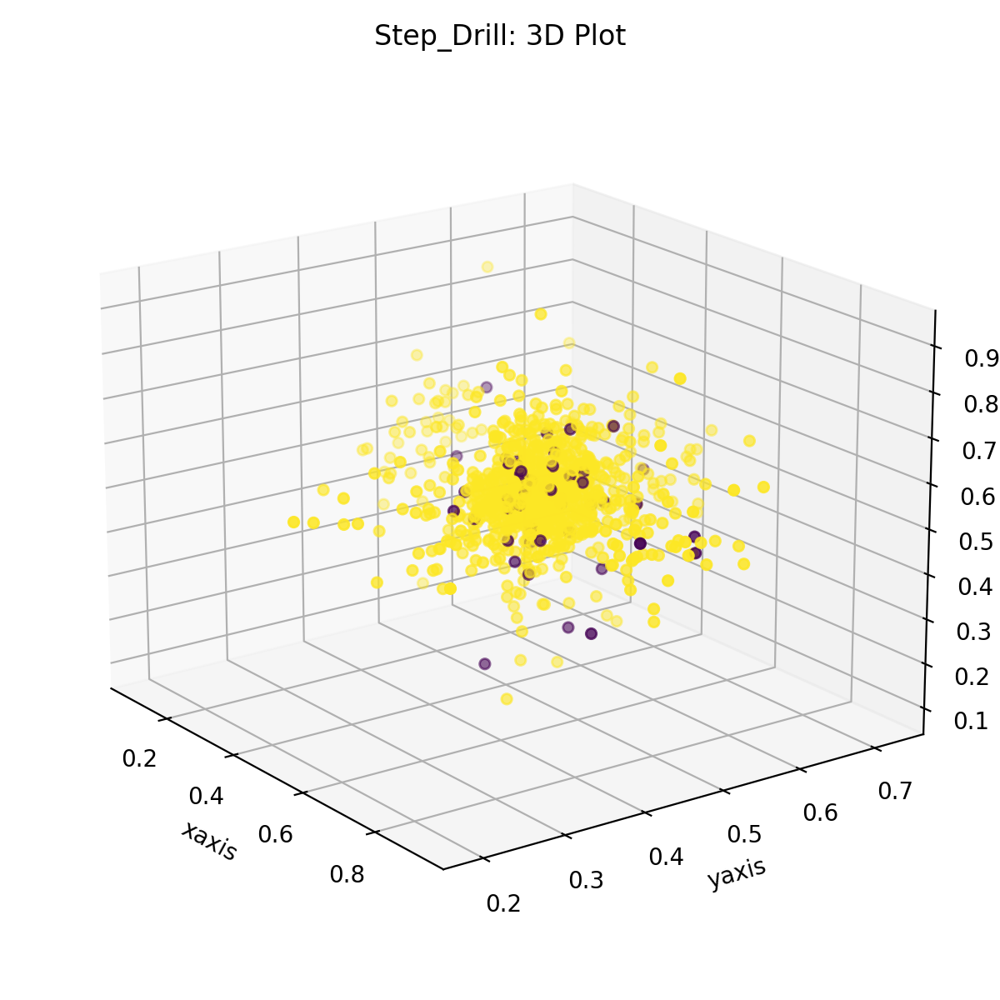

<IPython.core.display.Javascript object>


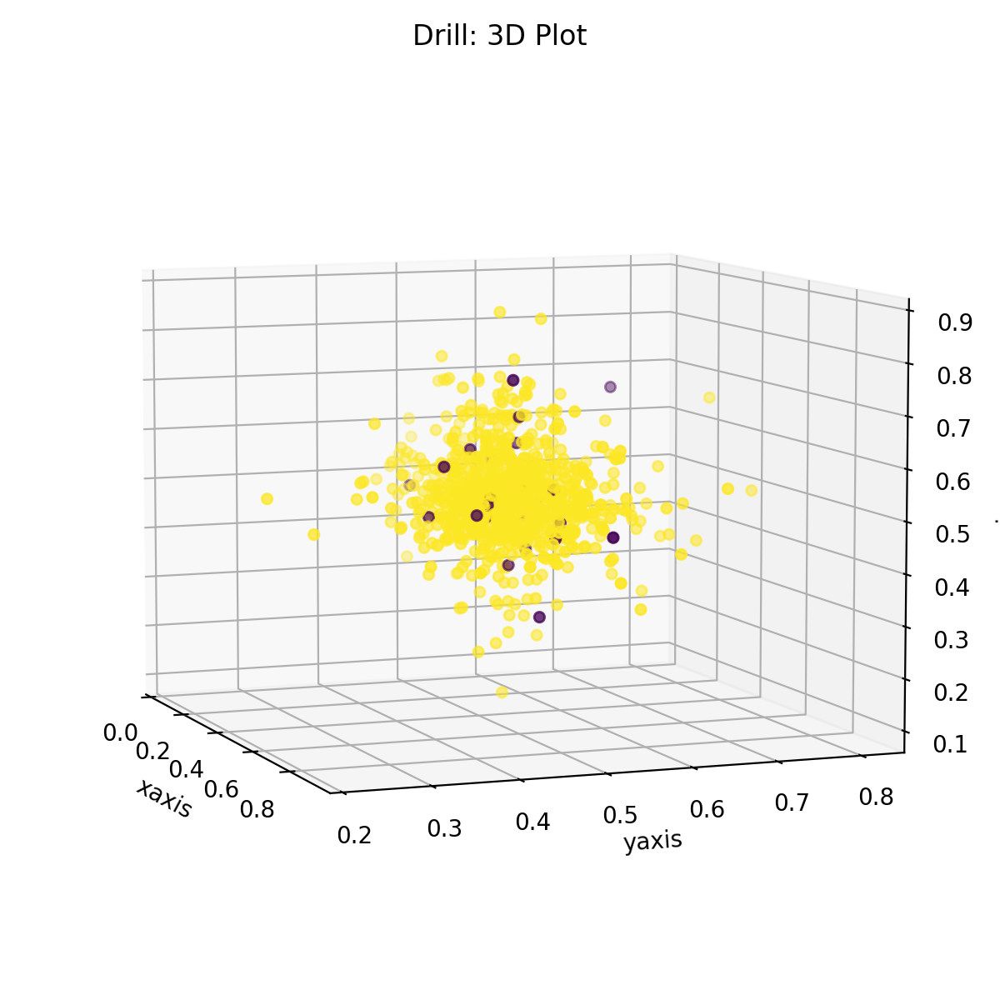

<IPython.core.display.Javascript object>


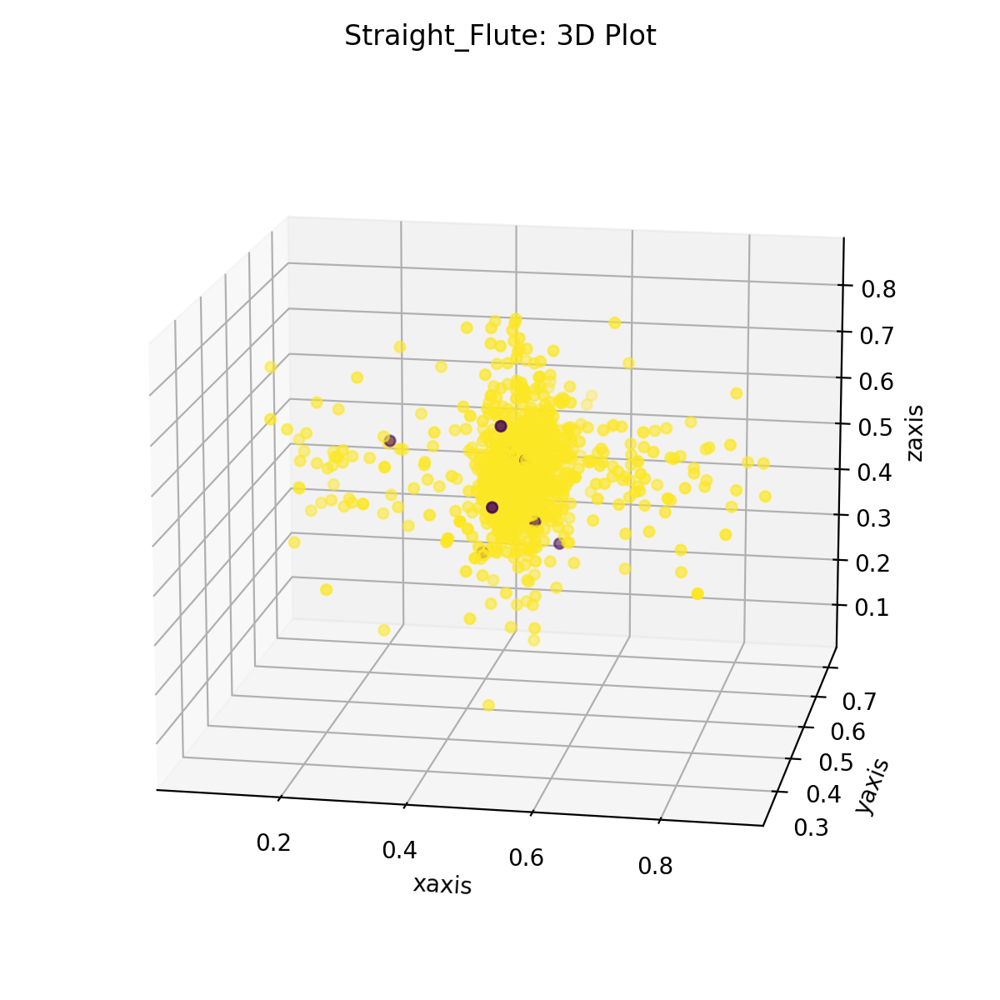

<IPython.core.display.Javascript object>


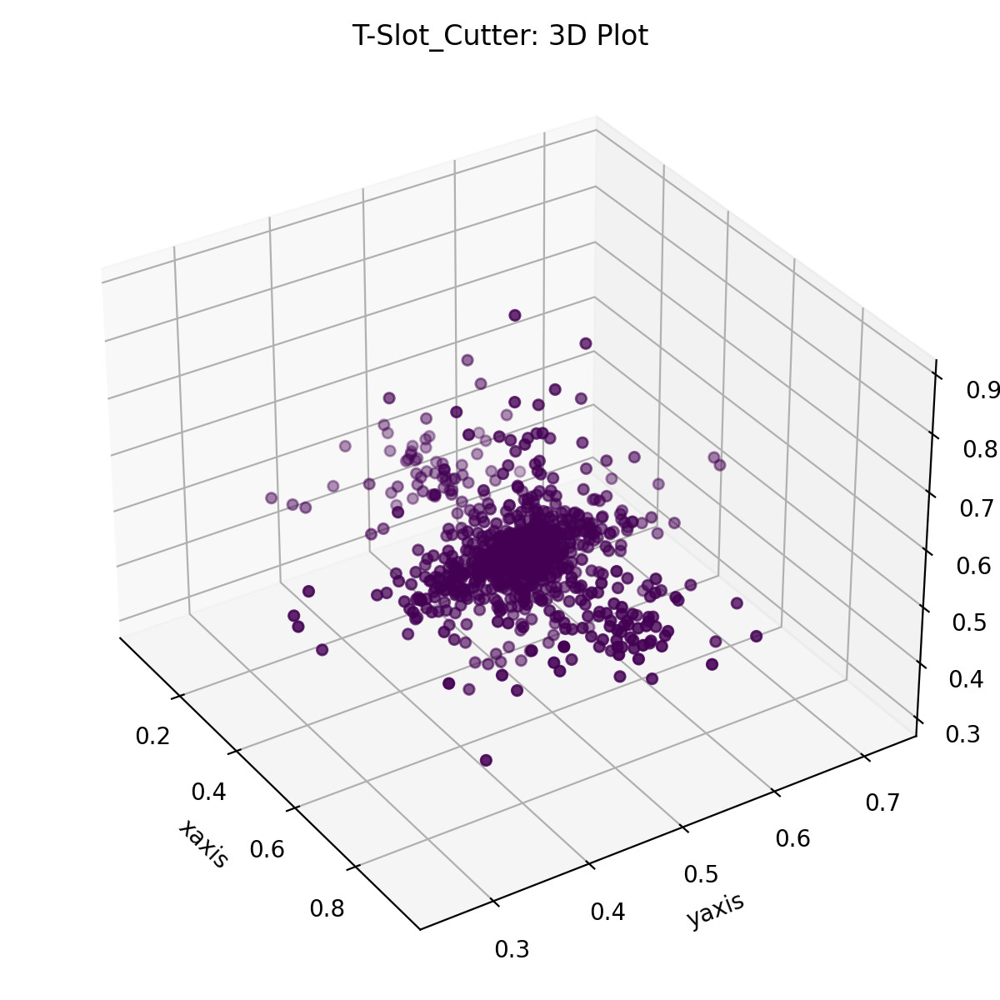

In [14]:
drill_df_list = []
drill_df_list += [pd.read_hdf(    "norm_Step_Drill.h5",'stage')]
drill_df_list += [pd.read_hdf(         "norm_Drill.h5",'stage')]
drill_df_list += [pd.read_hdf("norm_Straight_Flute.h5",'stage')]
drill_df_list += [pd.read_hdf( "norm_T-Slot_Cutter.h5",'stage')]
drill_df_list

sample_size = 1000
axis_names   = ['xaxis', 'yaxis', 'zaxis']
drill_list = ['Step_Drill', 'Drill', 'Straight_Flute', 'T-Slot_Cutter']
#i = 1

for i in range(int(len(drill_list))):
    cmap = []
    for val in drill_df_list[i].sample(sample_size).gb.to_list(): 
        cmap += [1] if val=='good' else [0]

    fig = plt.figure(figsize=(6,6))
    ax = plt.axes(projection ='3d')
    ax.scatter(drill_df_list[i].sample(sample_size).xaxis, drill_df_list[i].sample(sample_size).yaxis, drill_df_list[i].sample(sample_size).zaxis, c=cmap)
    #ax.plot_wireframe(drill_df_list[i].sample(sample_size).xaxis, drill_df_list[i].sample(sample_size).yaxis, drill_df_list[i].sample(sample_size).zaxis, c=cmap)
    ax.set_xlabel(axis_names[0])
    ax.set_ylabel(axis_names[1])
    ax.set_zlabel(axis_names[2])
    ax.set_title(drill_list[i]+": 3D Plot")
    fig.tight_layout()
    plt.show()


# Data Preparation for XGBOOST => [Part 1]
- Dataset standardization (minmaxscaling)
- Dataset shape transformation

![dataset_notation1](dataset_notation1.jpg)

In [3]:
# drill_dict = {'Step_Drill'    : ['OP00', 'OP01', 'OP03', 'OP04', 'OP05', 'OP06', 'OP07', 'OP08', 'OP10', 'OP11', 'OP12', 'OP14'],
#               'Drill'         : ['OP02'],
#               'T-Slot_Cutter' : ['OP13'],
#               'Straight_Flute': ['OP09']
#              }
# axis_names   = ['xaxis', 'yaxis', 'zaxis']
# ref_drill_type = "Step_Drill"

# input_df = pd.DataFrame()

# for axis in axis_names:
#     print(f'{axis}: Start...')
#     temp = pd.read_hdf("final_df_"+axis+"_process.h5",'stage')
#     temp = temp[temp.Process.isin(drill_dict[ref_drill_type])]
#     print(f'{axis}: Done Reading...')
#     input_df = pd.concat([input_df, temp], axis=0)
#     print(f'{axis}: Done Concatenating...')
#     del temp
    
# input_df.to_hdf("input_df_Step_Drill.h5", key='stage', mode='w')
# print('Done saving input_df_Step_Drill.h5')


def onehot_encoding(x):
    return [1, 0] if x=='good' else [0, 1]


input_df   = pd.read_hdf("input_df_Step_Drill.h5",'stage')
input_df['label'] = input_df.label.apply(onehot_encoding)
print('Done performing onehot_encoding transformation on input_df[\'label\']')

input_df

Done performing onehot_encoding transformation on input_df['label']


,Machine,Process,axis,label,0,1,2,3,4,5,...,317430,317431,317432,317433,317434,317435,317436,317437,317438,317439
M01_Feb_2021_OP00_009_good,M01,OP00,xaxis,"[1, 0]",0.491250,0.496179,0.492236,0.494208,0.491250,0.493222,...,0.490264,0.490757,0.490757,0.491250,0.490264,0.490264,0.494701,0.493222,0.495440,0.494208
M01_Feb_2021_OP00_008_good,M01,OP00,xaxis,"[1, 0]",0.489961,0.486533,0.490695,0.487512,0.486533,0.488981,...,0.643487,0.689030,0.645935,0.693683,0.595250,0.667973,0.624878,0.639814,0.654995,0.658913
M01_Feb_2021_OP00_007_good,M01,OP00,xaxis,"[1, 0]",0.471729,0.474036,0.470805,0.474036,0.475421,0.475421,...,0.470805,0.472652,0.468036,0.473113,0.471267,0.473575,0.471729,0.472652,0.468959,0.468036
M01_Feb_2021_OP00_006_good,M01,OP00,xaxis,"[1, 0]",0.481500,0.479065,0.480039,0.481013,0.477118,0.477605,...,0.159688,0.154090,0.070351,0.118306,0.153603,0.160175,0.108812,0.161149,0.154090,0.170156
M01_Feb_2021_OP00_005_good,M01,OP00,xaxis,"[1, 0]",0.473849,0.470475,0.471439,0.469993,0.474813,0.473849,...,0.474331,0.471921,0.473849,0.471921,0.473849,0.472403,0.473849,0.473849,0.474813,0.471439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M03_Aug_2019_OP05_004_good,M03,OP05,zaxis,"[1, 0]",0.498559,0.496254,0.501441,0.493948,0.499712,0.499712,...,0.499712,0.502594,0.507205,0.489337,0.501441,0.499712,0.492795,0.488184,0.492795,0.488184
M03_Aug_2019_OP05_003_good,M03,OP05,zaxis,"[1, 0]",0.497406,0.502594,0.498559,0.498559,0.508357,0.503746,...,0.483573,0.495101,0.498559,0.498559,0.496254,0.500865,0.490490,0.511816,0.506052,0.512968
M03_Aug_2019_OP05_002_good,M03,OP05,zaxis,"[1, 0]",0.502029,0.502029,0.502029,0.500290,0.504348,0.497971,...,0.564638,0.393623,0.507826,0.331594,0.400580,0.543188,0.464928,0.477681,0.404058,0.562319
M03_Aug_2019_OP05_001_good,M03,OP05,zaxis,"[1, 0]",0.380487,0.381544,0.382337,0.383395,0.381015,0.378900,...,0.384981,0.394765,0.387626,0.374669,0.391327,0.397409,0.385510,0.374669,0.382866,0.384981


# Data Preparation for XGBOOST ==> [Part 2]
- Dataset split

<code>
Whole      dataset: 95%    good +  5%    bad => 3687 good samples + 195 bad samples
Training   dataset: 70% of good + 70% of bad => 2580 good samples + 136 bad samples 
Validation dataset: 20% of good + 20% of bad =>  737 good samples +  39 bad samples
Test       dataset: 10% of good + 10% of bad =>  370 good samples +  20 bad samples

In [4]:
def dataset_split(dataset, good_idx, bad_idx):
    ans = []
    for count in range(int(len(good_idx))):
        ans += [dataset[good_idx[count]]]
    for count in range(int(len(bad_idx))):
        ans += [dataset[bad_idx[count]]]
    return ans


x_dataset = input_df.iloc[:, 4:].to_numpy()
y_dataset = input_df['label'].to_numpy()
print(f'Done gathering x_dataset ({x_dataset.shape}) and y_dataset ({y_dataset.shape})')


train_ratio = 0.7
val_ratio   = 0.2
test_ratio  = 0.1

good_idx, bad_idx = [], []
for idx, label in enumerate(y_dataset):
    if label == [1,0]: good_idx += [idx]
    if label == [0,1]:  bad_idx += [idx]

good_count, bad_count = int(len(good_idx)), int(len(bad_idx))

train_good, train_bad = int(train_ratio*good_count), int(train_ratio*bad_count)
val_good,     val_bad = int(  val_ratio*good_count), int(  val_ratio*bad_count)
test_good, test_bad = good_count-train_good-val_good, bad_count-train_bad-val_bad
print("\nDone counting good data and bad data...")
print(f'train_good={train_good}, train_bad={train_bad}')
print(f'val_good  ={val_good},   val_bad  ={val_bad}')
print(f'test_good ={test_good},  test_bad ={test_bad}')


x_train = np.asarray(dataset_split(x_dataset,                    good_idx[:train_good],                  bad_idx[:train_bad]))
x_val   = np.asarray(dataset_split(x_dataset, good_idx[train_good:train_good+val_good], bad_idx[train_bad:train_bad+val_bad]))
x_test  = np.asarray(dataset_split(x_dataset,           good_idx[train_good+val_good:],          bad_idx[train_bad+val_bad:]))

y_train = np.asarray(dataset_split(y_dataset,                    good_idx[:train_good],                  bad_idx[:train_bad]))
y_val   = np.asarray(dataset_split(y_dataset, good_idx[train_good:train_good+val_good], bad_idx[train_bad:train_bad+val_bad]))
y_test  = np.asarray(dataset_split(y_dataset,           good_idx[train_good+val_good:],          bad_idx[train_bad+val_bad:]))

print(f'\nDone splitting training, validation, and test datasets')
print(f'x_train ({x_train.shape}), y_train ({y_train.shape})')
print(f'x_val   ({  x_val.shape}), y_val   ( { y_val.shape})')
print(f'x_test  ({ x_test.shape}), y_test  ( {y_test.shape})')

Done gathering x_dataset ((3882, 317440)) and y_dataset ((3882,))

Done counting good data and bad data...
train_good=2580, train_bad=136
val_good  =737,   val_bad  =39
test_good =370,  test_bad =20

Done splitting training, validation, and test datasets
x_train ((2716, 317440)), y_train ((2716, 2))
x_val   ((776, 317440)), y_val   ( (776, 2))
x_test  ((390, 317440)), y_test  ( (390, 2))


# XGBOOST Training
- Training with x_train & y_train
- Evaluate accuracy score with x_test & y_test [prior to hyperparameter tuning]

In [5]:
start = time.time()

xgb_model = xgb.XGBClassifier().fit(x_train, y_train)
xgb_y_train_pred = xgb_model.predict(x_train)
print(f'Train accuracy: {accuracy_score(xgb_y_train_pred, y_train):.10f}')

xgb_y_test_pred = xgb_model.predict(x_test)
print(f'Test accuracy: {accuracy_score(xgb_y_test_pred, y_test):.10f}')

end = time.time()
print(f'Time Elapsed: {end-start:.2f} seconds')

Train accuracy: 1.0000000000
Test accuracy: 0.9538461538
Time Elapsed: 873.36 seconds


              precision    recall  f1-score   support

           0       1.00      0.10      0.18        20
           1       0.95      1.00      0.98       370

    accuracy                           0.95       390
   macro avg       0.98      0.55      0.58       390
weighted avg       0.96      0.95      0.94       390



<IPython.core.display.Javascript object>


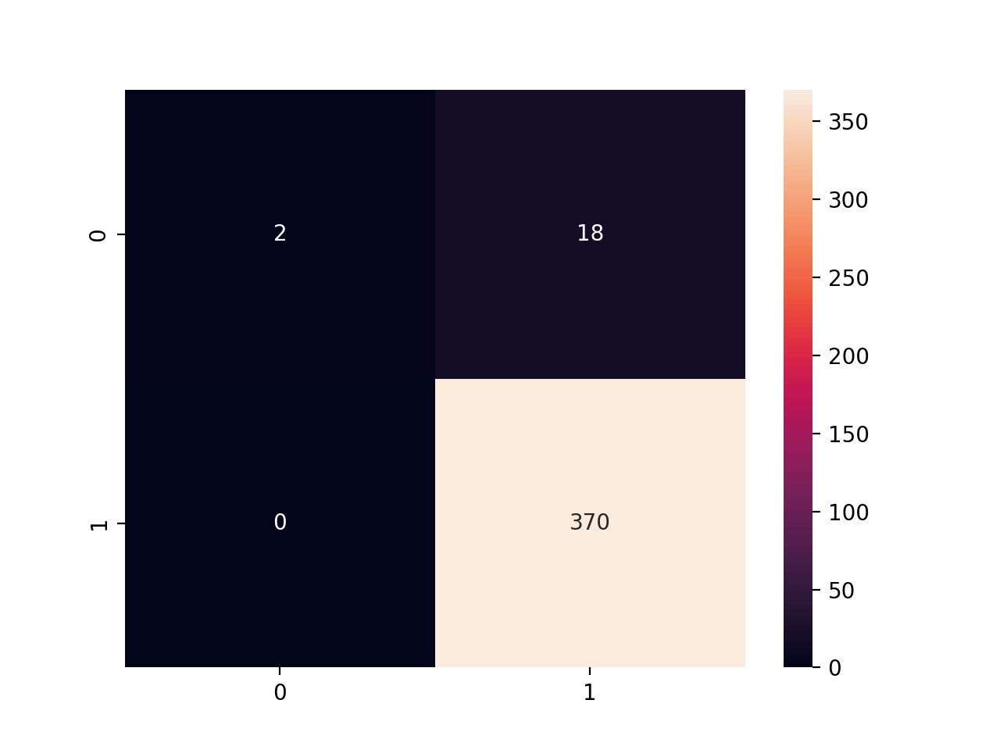

<Axes: >

In [24]:
xgb_y_test_pred_decode, y_test_decode = [], []

for val in xgb_y_test_pred.tolist():
    xgb_y_test_pred_decode += [1] if val==[1.0, 0.0] else [0]
    
for val in y_test.tolist():
    y_test_decode += [1] if val==[1.0, 0.0] else [0]
    
print(classification_report(y_true=y_test_decode, y_pred=xgb_y_test_pred_decode))

cmatrix = confusion_matrix(y_true=y_test_decode, y_pred=xgb_y_test_pred_decode)
sns.heatmap(cmatrix, annot=True, fmt="d")

# Stacking Resolution


In [12]:
import pandas as pd
import numpy as np
from tqdm import tqdm


def populate_each_sampleID(df, num_repeat, groupby_colname):
    temp         = df.groupby(df[groupby_colname]).apply(pd.DataFrame.to_numpy)
    sampleID     = temp.index.tolist()
    num_sampleID = len(sampleID)
    max_sequence = 0
    sampleID_dict= {sampleID[i]:temp[i].tolist() for i in range(num_sampleID)}

    for i in range(num_sampleID):
        max_sequence = max(max_sequence, len(temp[i].tolist()))

    for i in tqdm(range(num_sampleID), desc="Populating_each_sample_ID…", ascii=False, ncols=75):
        n = len(sampleID_dict[i])
        sampleID_dict[i] += sampleID_dict[i][-num_repeat:]*((max_sequence-n)//num_repeat) + sampleID_dict[i][-num_repeat:-num_repeat + (max_sequence-n)%num_repeat]

    for i in range(num_sampleID):
        n = len(sampleID_dict[i])

    final_list = []
    for i in range(num_sampleID):
        final_list += sampleID_dict[i]

    final_ndarray = np.array(final_list)

    del temp, sampleID, sampleID_dict, final_list
    
    return pd.DataFrame(data=final_ndarray, columns=df.columns)


df = pd.read_csv('temp.csv')
print(f'df_before:\n===================\n{df}\n')

df = populate_each_sampleID(df, 3, 'sampleID')
print(f'df_after:\n====================\n{df}\n')

df_before:
    col1  col2  sampleID
0      1     1         0
1      2     2         0
2      3     3         0
3      4     4         0
4      5     5         0
5      6     6         0
6      7     7         0
7      1     1         1
8      2     2         1
9      3     3         1
10     4     4         1
11     5     5         1
12     6     6         1
13     7     7         1
14     8     8         1
15     9     9         1
16    10    10         1
17     1     1         2
18     2     2         2
19     3     3         2
20     4     4         2
21     5     5         2



Populating_each_sample_ID…: 100%|█████████| 3/3 [00:00<00:00, 41527.76it/s]

df_after:
    col1  col2  sampleID
0      1     1         0
1      2     2         0
2      3     3         0
3      4     4         0
4      5     5         0
5      6     6         0
6      7     7         0
7      5     5         0
8      6     6         0
9      7     7         0
10     1     1         1
11     2     2         1
12     3     3         1
13     4     4         1
14     5     5         1
15     6     6         1
16     7     7         1
17     8     8         1
18     9     9         1
19    10    10         1
20     1     1         2
21     2     2         2
22     3     3         2
23     4     4         2
24     5     5         2
25     3     3         2
26     4     4         2
27     5     5         2
28     3     3         2
29     4     4         2



In [13]:
features = np.stack(
                list(
                    df.groupby(df.sampleID).apply(
                        pd.DataFrame.to_numpy
                    )
                ),
                axis=0,
            )
features

array([[[ 1,  1,  0],
        [ 2,  2,  0],
        [ 3,  3,  0],
        [ 4,  4,  0],
        [ 5,  5,  0],
        [ 6,  6,  0],
        [ 7,  7,  0],
        [ 5,  5,  0],
        [ 6,  6,  0],
        [ 7,  7,  0]],

       [[ 1,  1,  1],
        [ 2,  2,  1],
        [ 3,  3,  1],
        [ 4,  4,  1],
        [ 5,  5,  1],
        [ 6,  6,  1],
        [ 7,  7,  1],
        [ 8,  8,  1],
        [ 9,  9,  1],
        [10, 10,  1]],

       [[ 1,  1,  2],
        [ 2,  2,  2],
        [ 3,  3,  2],
        [ 4,  4,  2],
        [ 5,  5,  2],
        [ 3,  3,  2],
        [ 4,  4,  2],
        [ 5,  5,  2],
        [ 3,  3,  2],
        [ 4,  4,  2]]])

In [30]:
len_per_sampleID = [features[i].shape[0] for i in range(len(features))]
assert len(set(len_per_sampleID))==1, "The sequence length of each sampleID is not uniform. Please debug populate_each_sample_ID() function..."

In [2]:
import pandas as pd
import numpy as np
from tqdm import tqdm


df = pd.read_csv('temp.csv')
print(f'df_before:\n===================\n{df}\n')

df_before:
    col1  col2  sampleID
0      1     1         0
1      2     2         0
2      3     3         0
3      4     4         0
4      5     5         0
5      6     6         0
6      7     7         0
7      1     1         1
8      2     2         1
9      3     3         1
10     4     4         1
11     5     5         1
12     6     6         1
13     7     7         1
14     8     8         1
15     9     9         1
16    10    10         1
17     1     1         2
18     2     2         2
19     3     3         2
20     4     4         2
21     5     5         2



In [39]:
example_id_column = 'sampleID'
max_sequence_len = 10
df_list = []
num_repeat = 4

for i in range(len(df[example_id_column].unique().tolist())):
    df_list += [df[df[example_id_column]==i].reset_index(drop=True)]

for i in range(len(df_list)):
    n = df_list[i].shape[0]
    repeat_times   = (max_sequence_len-n) // num_repeat
    extra_elements = (max_sequence_len-n) %  num_repeat
    print(f'{i}: {repeat_times}\t{extra_elements}')
    
    df_list[i] = pd.concat([df_list[i]]+[df_list[2][-num_repeat:]]*repeat_times+[df_list[i][-num_repeat:-num_repeat+extra_elements]], axis=0, ignore_index=True)
    
temp = pd.DataFrame()
for i in range(len(df_list)):
    temp = pd.concat([temp,df_list[i]], ignore_index=True)


0: 0	3
1: 0	0
2: 1	1


In [41]:
temp

,col1,col2,sampleID
0,1,1,0
1,2,2,0
2,3,3,0
3,4,4,0
4,5,5,0
5,6,6,0
6,7,7,0
7,4,4,0
8,5,5,0
9,6,6,0
